In [1]:
import pickle
import numpy as np
from sklearn.preprocessing import OneHotEncoder
X,y_hr,y_participant,y_activity = pickle.load(open('../data/heart_rate_tabular_data_ppg_dalia.p','rb'))
activity_dict1 = {'No Label':-1,'Sitting':0,'Stairs':1,'Soccer':2,
                'Cycling':3,'Driving':4,'Lunch':-1,'Walking':5,
                'Working':-1}
X = X[:,:,1:].reshape(-1,3,256)
X = X/np.max(X)
y_activity = np.array([activity_dict1[a] for a in y_activity])
y_activity = OneHotEncoder().fit_transform(y_activity.reshape(-1,1)).todense()

activity_dict_reverse = {activity_dict1[key]:key for key in activity_dict1.keys()}

In [5]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.autograd import grad
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from torchvision import datasets, transforms
import numpy as np
from matplotlib.patches import Rectangle
from torchsummary import summary
import pylab as plt
batch_size = 500
n_epochs = 3000
n_classes = 6
latent_size = 100
learning_rate = 1e-4
beta1 = .5
beta2 = .9
alpha = .58
use_cuda = torch.cuda.is_available()
device = torch.device('cuda' if use_cuda else 'cpu')

In [6]:
from torch.utils.data import TensorDataset, DataLoader
tensor_x = torch.Tensor(X) # transform to torch tensor
tensor_y = torch.Tensor(y_activity)
dataset = TensorDataset(tensor_x,tensor_y) # create your datset
dataloader = DataLoader(dataset,batch_size=batch_size,shuffle=True)


def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)
        


In [7]:
class D(nn.Module):
    def __init__(self, num_classes=6,in_channels=3,
                 out_channels = [50,100,200,50],kernel_size=20,
                 pool_size=2):
        super(D, self).__init__()
        self.ngpu = torch.cuda.device_count()
        self.in_channels = in_channels
        self.out_channels = out_channels

        # Convolution 1
        self.conv1 = nn.Sequential(
            nn.Conv1d(self.in_channels,self.out_channels[0], kernel_size, 1, 1, bias=False),
#             nn.LeakyReLU(0.2, inplace=True),
            nn.ReLU(),
            nn.Dropout(0.2, inplace=False),
            nn.MaxPool1d(pool_size*2,pool_size,1),
            nn.BatchNorm1d(self.out_channels[0])
        )
        # Convolution 2
        self.conv2 = nn.Sequential(
            nn.Conv1d(self.out_channels[0],self.out_channels[1],kernel_size, 1, 1, bias=False),
            nn.ReLU(),
            nn.MaxPool1d(pool_size*2,pool_size,1),
            nn.Dropout(0.2, inplace=False),
            nn.BatchNorm1d(self.out_channels[1])
        )
        # Convolution 3
        self.conv3 = nn.Sequential(
            nn.Conv1d(self.out_channels[1],self.out_channels[2],kernel_size, 1, 1, bias=False),
            nn.ReLU(),
            nn.MaxPool1d(pool_size*2,pool_size,1),
            nn.Dropout(0.2, inplace=False),
            nn.BatchNorm1d(self.out_channels[2])
        )
        # Convolution 4
        self.conv4 = nn.Sequential(
            nn.Conv1d(self.out_channels[2],self.out_channels[3],kernel_size//2, 1, 1, bias=False),
            nn.ReLU(),
            nn.Dropout(0.2, inplace=False),
            nn.MaxPool1d(pool_size*2,pool_size,1)
        )
        
        self.flattten = nn.Flatten()
        self.discriminatior_output = nn.Sequential(
            nn.Linear(250,20),
            nn.ReLU(),
#             nn.Linear(200,20),
#             nn.ReLU(),
            nn.Linear(20,1),
            nn.Sigmoid()            
        )
        self.auxillary_output = nn.Sequential(
            nn.Linear(250,20),
            nn.ReLU(),
#             nn.Linear(200,20),
#             nn.ReLU(),
            nn.Linear(20,num_classes),
            nn.Sigmoid()
#             nn.Softmax()           
        )
        
        
    def forward(self, data):
        data = self.conv1(data)
        data = self.conv2(data)
        data = self.conv3(data)
        data = self.conv4(data)
        data = self.flattten(data)
#         return data
        real_fake = self.discriminatior_output(data).view(-1, 1).squeeze(1)
        classes = self.auxillary_output(data)
            
        return real_fake,classes



In [8]:
class G(nn.Module):
    def __init__(self,
                 latent_size = 100,
                 num_classes = 6,
                 out_channels = 3,
                 out_timesteps = 256):
        super(G, self).__init__()
        self.ngpu = torch.cuda.device_count()
        self.latent_size = latent_size
        self.out_channels = out_channels
        self.out_timesteps = out_timesteps
        self.latent_size = latent_size
        self.num_classes = num_classes
        self.label_to_noise = nn.Sequential(
            nn.Linear(self.num_classes,self.latent_size//4),
            nn.ReLU(),
            nn.Linear(self.latent_size//4,self.latent_size//2),
            nn.ReLU(),
            nn.Linear(self.latent_size//2,self.latent_size)
        )
        self.flatten = nn.Flatten()
        self.dense_network = nn.Sequential(
            nn.Linear(self.latent_size*2,self.latent_size*4),
            nn.ReLU(),
            nn.Linear(self.latent_size*4,self.latent_size*8),
            nn.ReLU(),
            nn.Linear(self.latent_size*8,self.out_channels*self.out_timesteps)            
        )
        self.generator_main = torch.nn.Sequential(
            nn.ConvTranspose1d(100,100,10,1,1,groups=2),
            nn.ReLU(),
            nn.ConvTranspose1d(100,200,10,1,1,groups=100),
            nn.ConvTranspose1d(200,256,10,1,1,groups=2),
            nn.Linear(23,3)            
        )
        
    def forward(self, labels,noise):
        labels = labels.view(-1,self.num_classes)
        noise1 = self.label_to_noise(labels).view(-1,self.latent_size,1)
        noise = noise.view(-1,self.latent_size,1)
        noise = torch.cat((noise,noise1),-1).view(-1,self.latent_size,2)
        noise = self.generator_main(noise).view(-1,self.out_channels,self.out_timesteps)
#         noise = self.flatten(noise)
#         noise = self.dense_network(noise).view(-1,self.out_channels,self.out_timesteps)
#         print(noise.shape)
        return noise



In [9]:
dmodel = D().to(device)
dmodel = torch.nn.DataParallel(dmodel)
gmodel = G().to(device)
gmodel = torch.nn.DataParallel(gmodel)
dmodel.apply(weights_init)
gmodel.apply(weights_init)
# print(summary(gmodel,[(1,6),(1,100)]))
# print(summary(dmodel,(3,256)))
doptimizer = optim.Adam(dmodel.parameters(), lr=learning_rate, betas=(beta1, beta2))
goptimizer = optim.Adam(gmodel.parameters(), lr=learning_rate, betas=(beta1, beta2))
adversarial_loss = torch.nn.BCELoss()
auxiliary_loss = torch.nn.CrossEntropyLoss()
if use_cuda:
    adversarial_loss.cuda()
    auxiliary_loss.cuda()

[[4203   47    0  124  197    0]
 [ 553 1472   15 1083  104   19]
 [1119  251   25  686  172   59]
 [ 259  634   21 2491   30   43]
 [4817  264   10  738  998   14]
 [1487 1632   24 1359  140   54]]


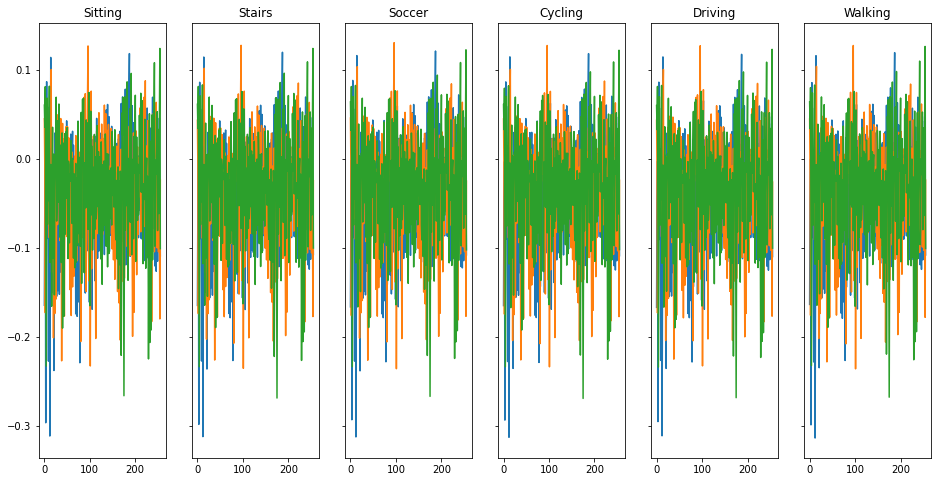

[[3961   85   16   41  450   18]
 [  32 2541   34   57  310  272]
 [  49  272  678  225  965  123]
 [  14   17   43 2990  410    4]
 [1164  387   80  151 5022   37]
 [ 382 3009   50   22  683  550]]


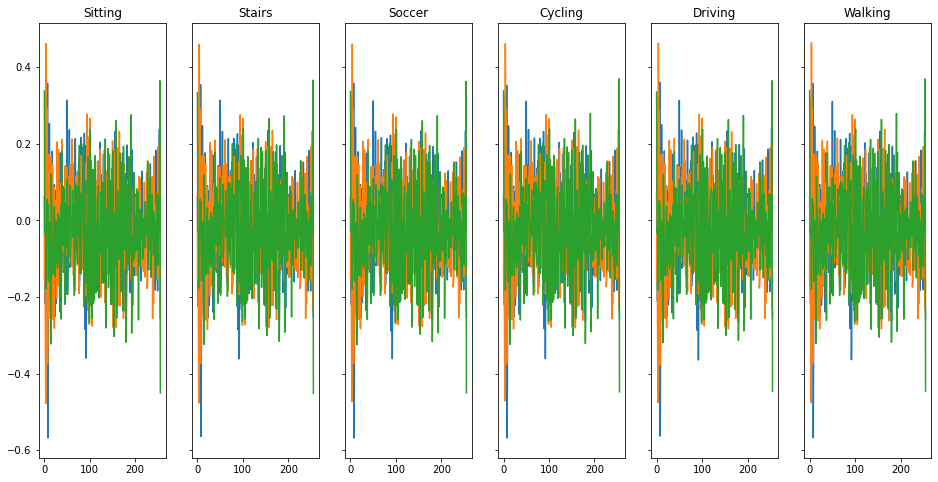

[[4114   57   42   10  317   31]
 [   4 2460   37   20   86  639]
 [  86  200 1258  147  433  188]
 [  33   18   65 3046  310    6]
 [ 613  174  278  139 5518  119]
 [ 159 2699  149    2  299 1388]]


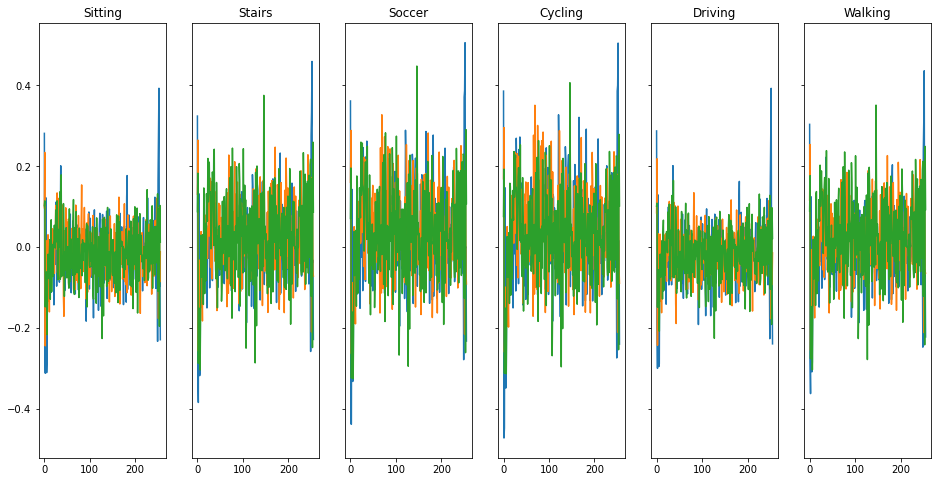

[[4064   30   13   17  404   43]
 [   5 1800   42   25   85 1289]
 [  39   83 1173  165  482  370]
 [   2    9   45 3165  244   13]
 [ 385   73  219  177 5848  139]
 [ 137 1948   72    8  253 2278]]


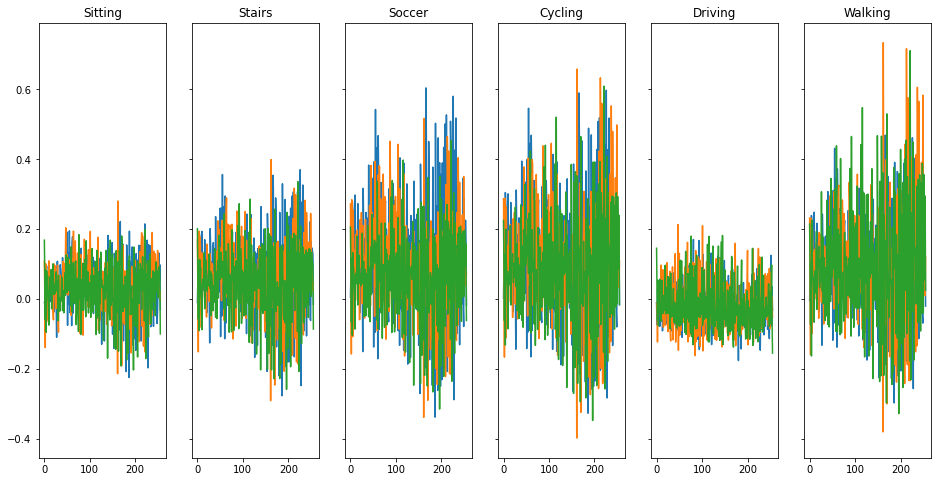

[[4064    0   14    3  405   85]
 [   2   64   28   23   73 3056]
 [  41    3 1198  137  473  460]
 [   7    0   41 3153  250   27]
 [ 384    4  231  166 5858  198]
 [  86   68   88    5  228 4221]]


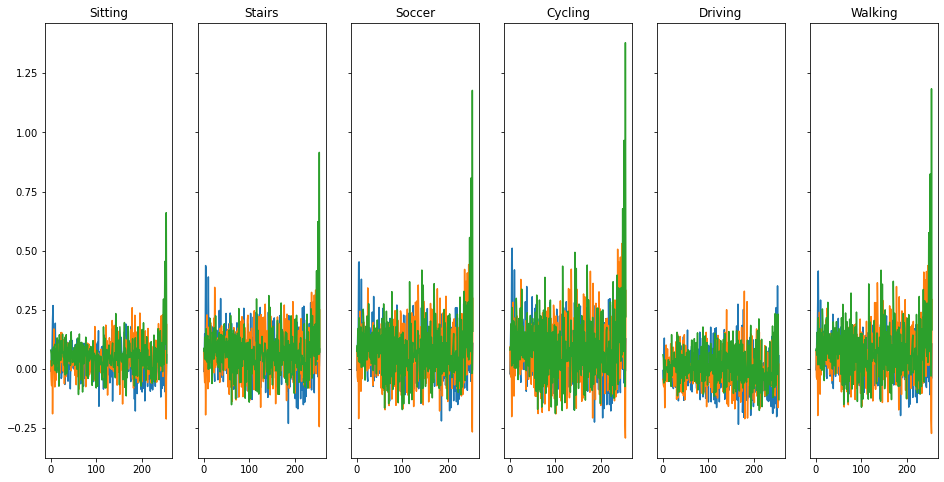

[[4077    1   36    4  394   59]
 [   5  144   28   12   90 2967]
 [  17   29 1319  111  533  303]
 [   5    5   37 3183  206   42]
 [ 381   25  275  105 5848  207]
 [  95   90   88    3  288 4132]]


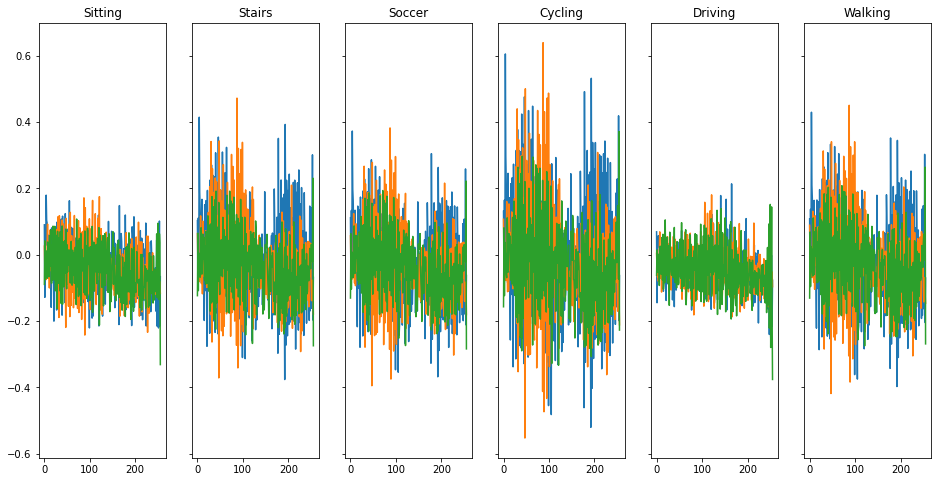

[[4044    7   40    0  436   44]
 [   3  101   34   10   90 3008]
 [   3   28 1509   64  509  199]
 [   0    2   42 3215  195   24]
 [ 240   14  287   66 6097  137]
 [  55   40   94    4  278 4225]]


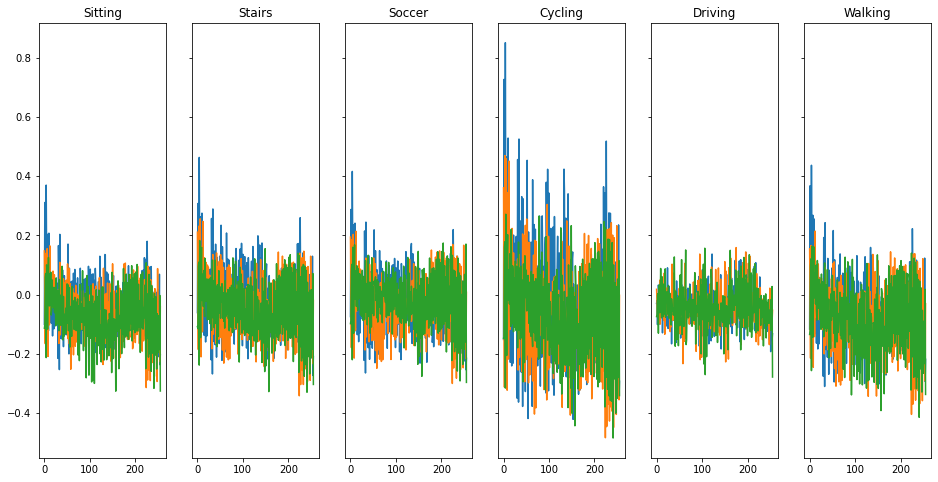

[[4078    2   51    1  390   49]
 [   4  411   82   11   78 2660]
 [  24    9 1563   49  367  300]
 [   1    7   66 3218  169   17]
 [ 274   15  375   63 5928  186]
 [  59  407   87    4  172 3967]]


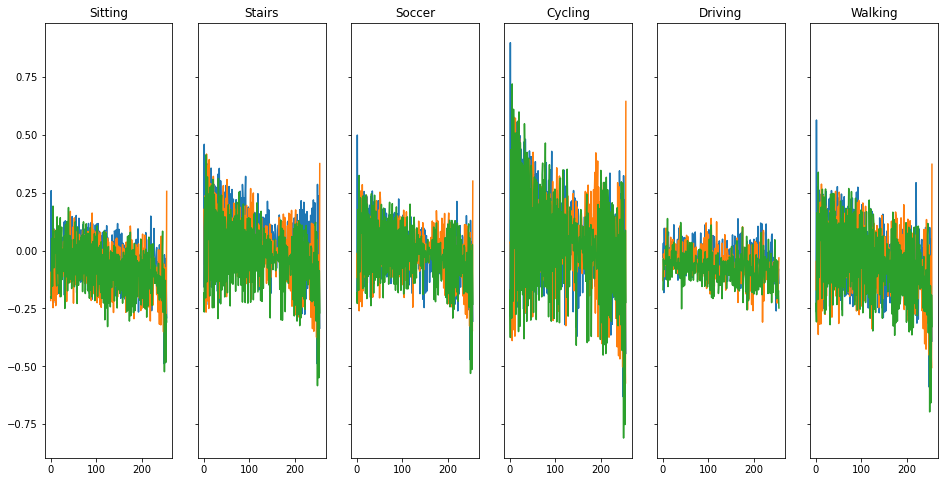

[[4052    0   88    0  383   48]
 [  15   35   25   10   78 3083]
 [  24   23 1611  100  369  185]
 [   7    0   88 3182  166   35]
 [ 299   13  389   49 5910  181]
 [ 117    9  111    1  270 4188]]


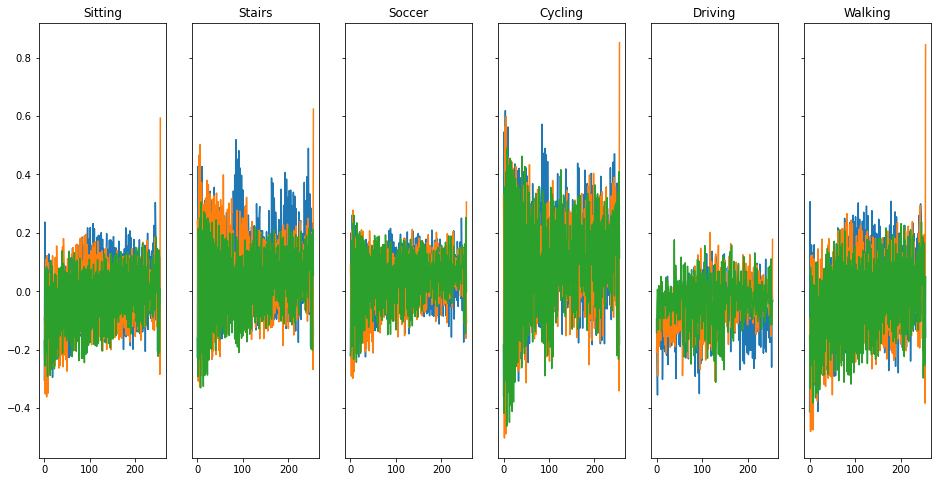

[[3869    0   72    0  576   54]
 [   3    5   20    8   67 3143]
 [  58    7 1406   87  450  304]
 [   6    0   52 3190  188   42]
 [ 365    0  211   54 5998  213]
 [ 126    1  104    0  157 4308]]


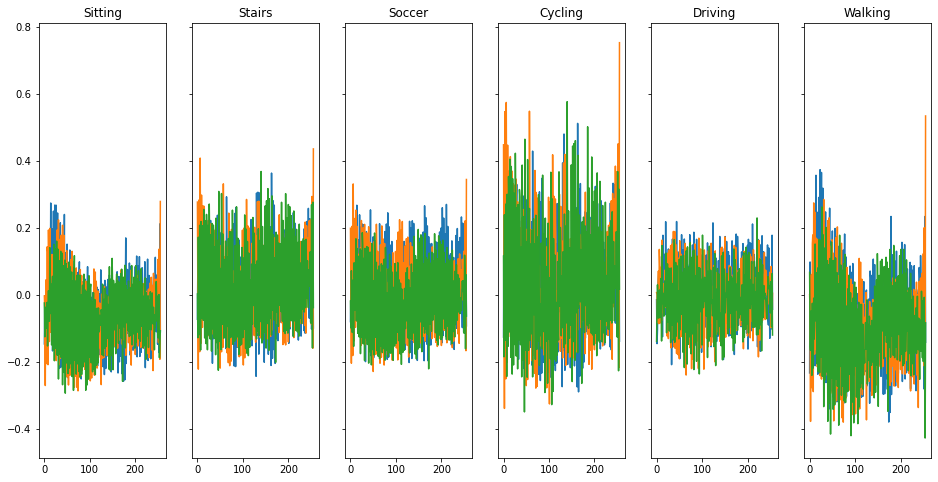

[[4031    0   46    2  424   68]
 [   0    0   29    9   68 3140]
 [  15    0 1361   69  617  250]
 [   0    0   50 3201  213   14]
 [ 304    0  312  122 5925  178]
 [  40    0  104    6  238 4308]]


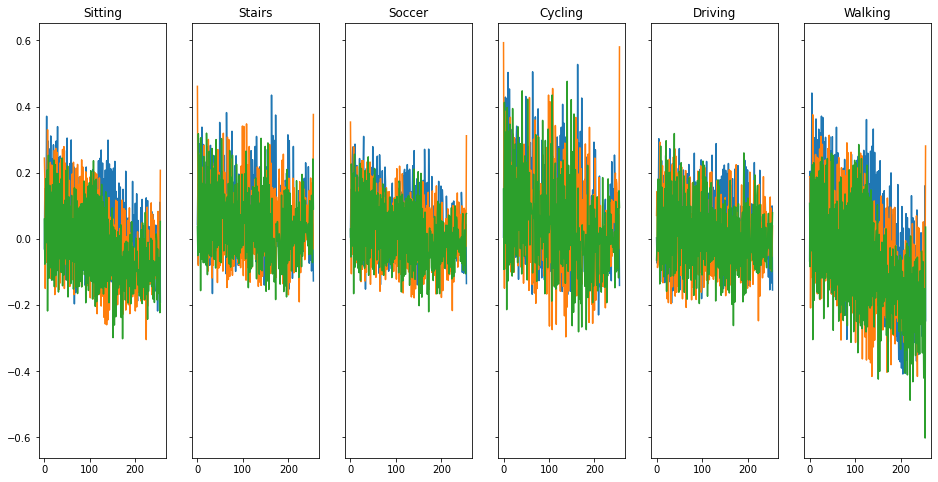

[[3758    0   35    0  732   46]
 [  29    0   23   11   80 3103]
 [ 172    0 1212  131  399  398]
 [   7    0   63 3126  254   28]
 [ 361    0  330   33 5923  194]
 [ 223    0   44    3  129 4297]]


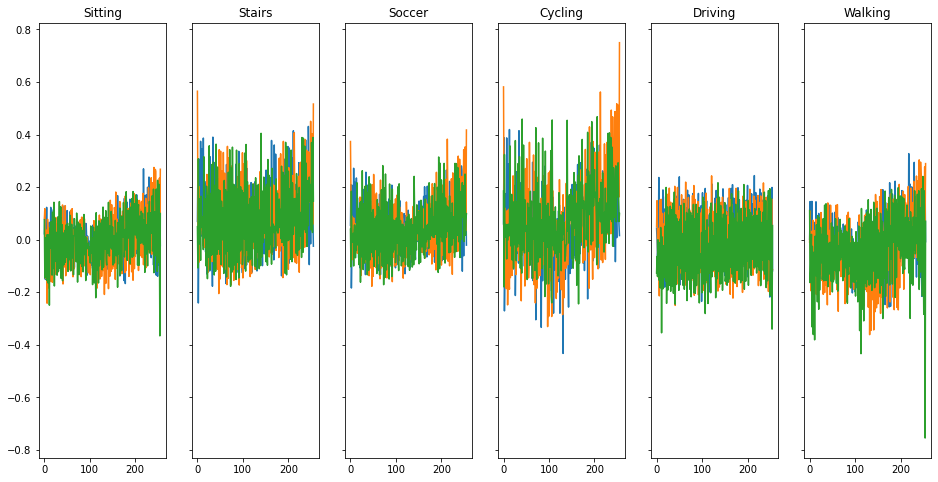

[[4044    0   55    0  427   45]
 [   6    0   20    5   74 3141]
 [  20    0 1651   51  364  226]
 [   1    0   73 3199  184   21]
 [ 321    0  329   66 5953  172]
 [  87    0  114    1  138 4356]]


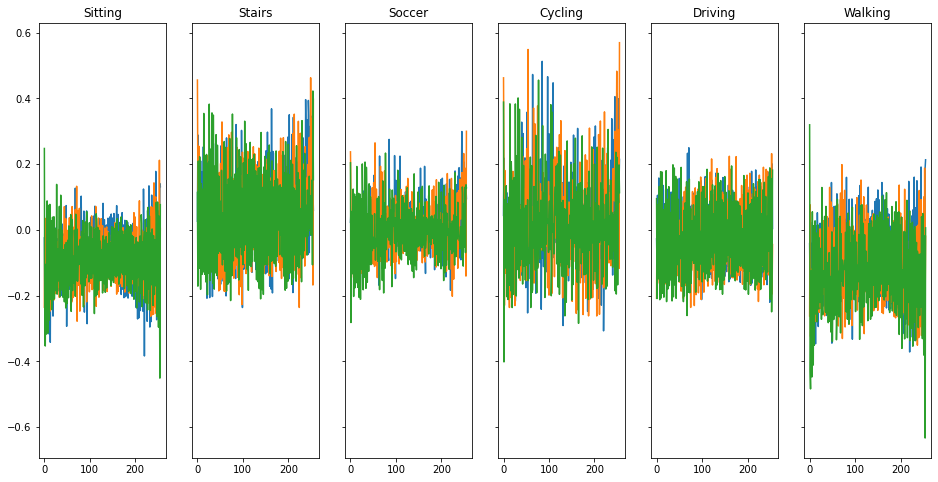

[[4037    0   37    6  431   60]
 [  15    0   10    3   56 3162]
 [  20    0 1503   38  429  322]
 [   0    0   57 3179  203   39]
 [ 374    0  332  124 5760  251]
 [ 145    0   81    3  156 4311]]


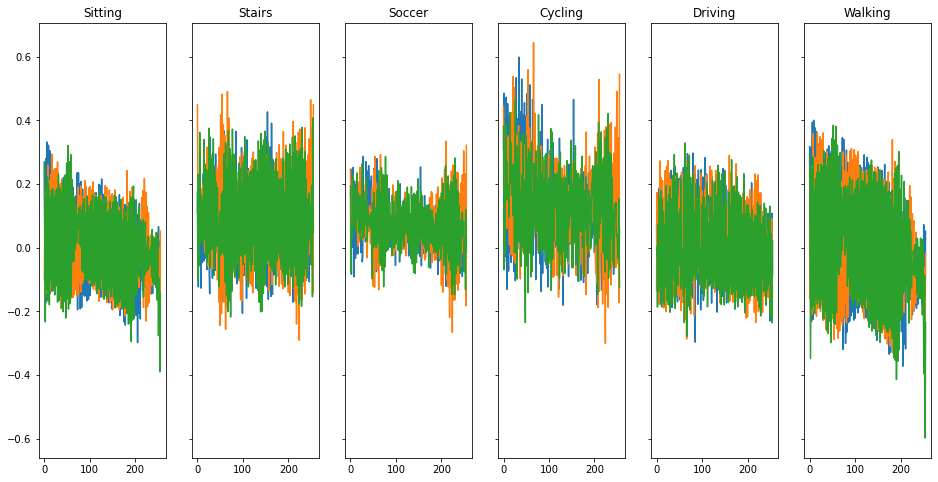

[[3985    0   26    0  498   62]
 [   8    0   23    8   76 3131]
 [   9    0 1538   53  475  237]
 [   0    0   61 3215  175   27]
 [ 294    0  308   18 6038  183]
 [  87    0   84    1  199 4325]]


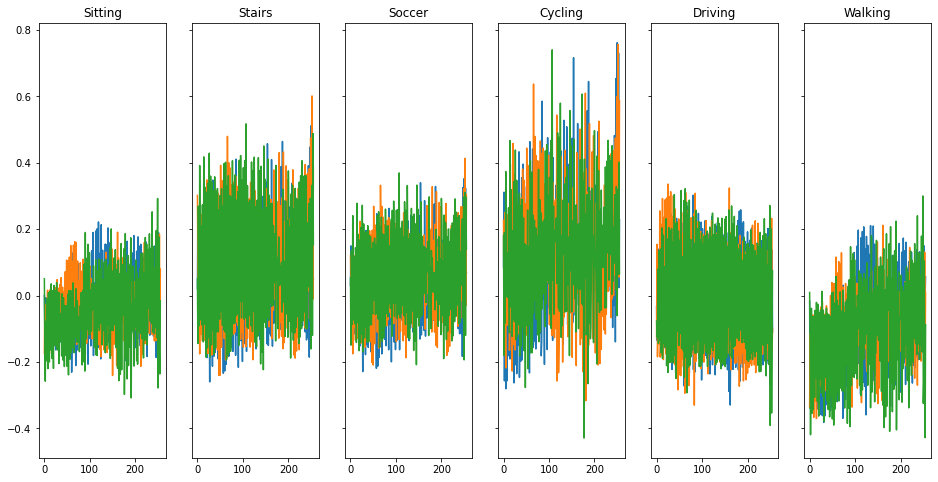

[[4035    0   28    1  439   68]
 [   0    0   44    9   63 3130]
 [  22    0 1524   54  461  251]
 [   1    0   49 3216  193   19]
 [ 231    0  221   42 6158  189]
 [  67    0   73    1  187 4368]]


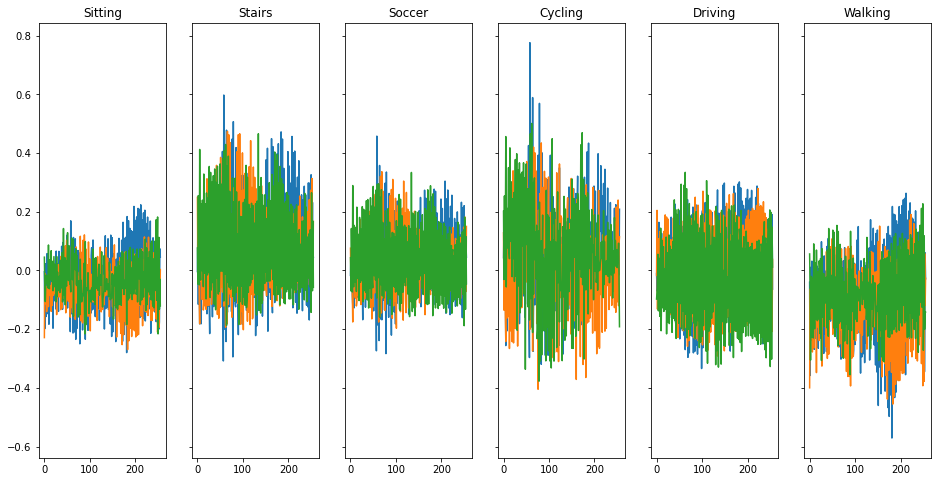

[[4038    0   26    1  460   46]
 [  13    0   23   11   91 3108]
 [  20    0 1406   59  501  326]
 [   0    0   40 3233  183   22]
 [ 317    0  272   62 6045  145]
 [ 103    0   47    1  190 4355]]


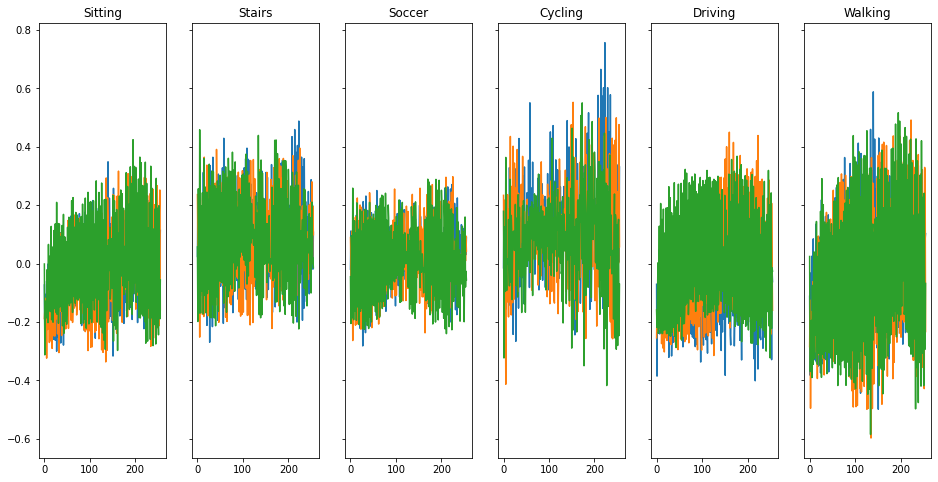

[[4078    0   29    2  377   85]
 [   3    0   55   11   61 3116]
 [  33    0 1637   35  381  226]
 [   0    0   71 3218  172   17]
 [ 323    0  327   39 5955  197]
 [  56    0  105    3  147 4385]]


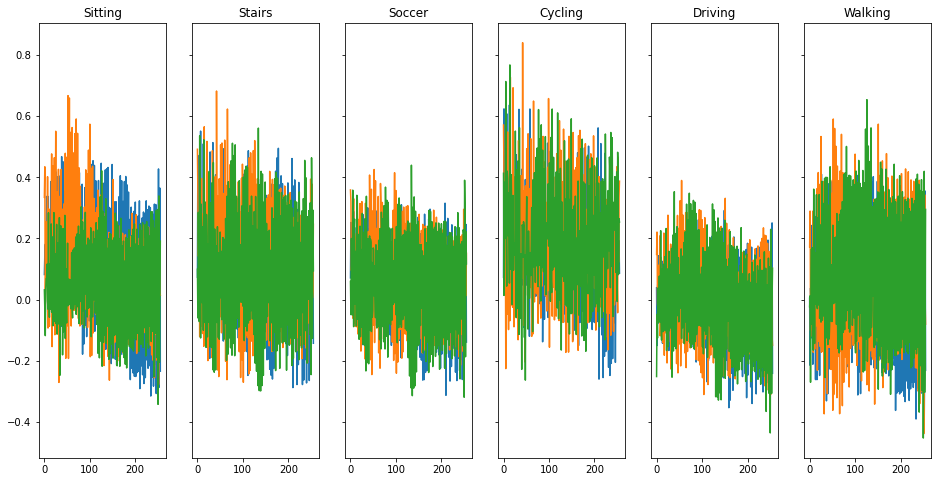

[[4108    0   67    2  345   49]
 [   9    0   20    8   67 3142]
 [   7    0 1648   49  399  209]
 [   1    0   51 3241  173   12]
 [ 332    0  376   39 5913  181]
 [ 122    0  116    1  164 4293]]


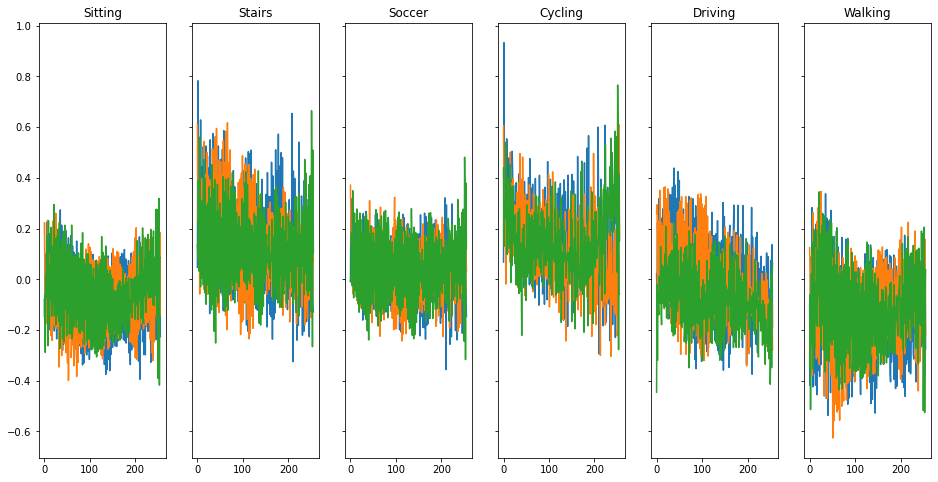

[[3984    0   19    1  505   62]
 [   7    0   24   12   49 3154]
 [  38    0 1549   45  356  324]
 [   0    0   52 3237  168   21]
 [ 228    0  304   67 6021  221]
 [  88    0   93    2  140 4373]]


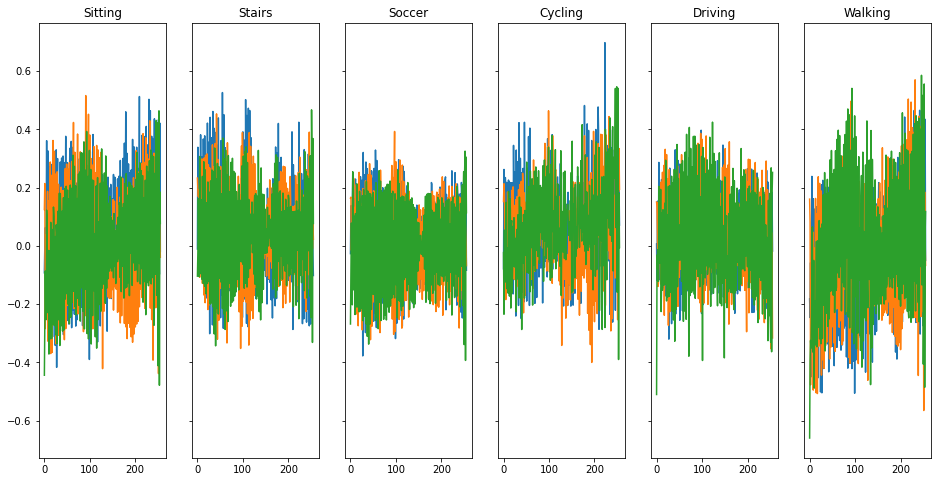

[[4111    0   45    0  363   52]
 [   7    0   40   17   71 3111]
 [  52    0 1435   61  528  236]
 [   0    0   31 3243  191   13]
 [ 267    0  290   57 6040  187]
 [  81    0   39    2  222 4352]]


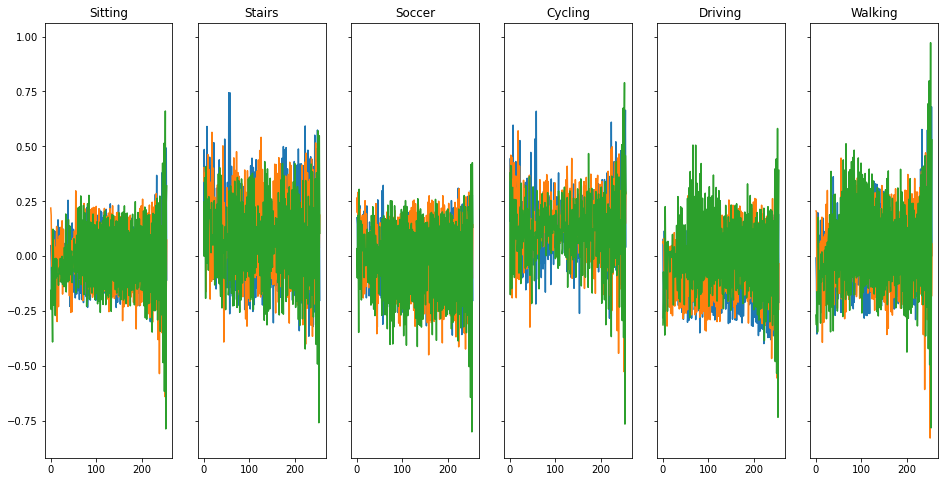

[[4080    0   56    0  356   79]
 [   3    0   10   16   59 3158]
 [  33    0 1512   62  420  285]
 [   0    0   62 3209  185   22]
 [ 292    0  298   19 6057  175]
 [  72    0   57    1  167 4399]]


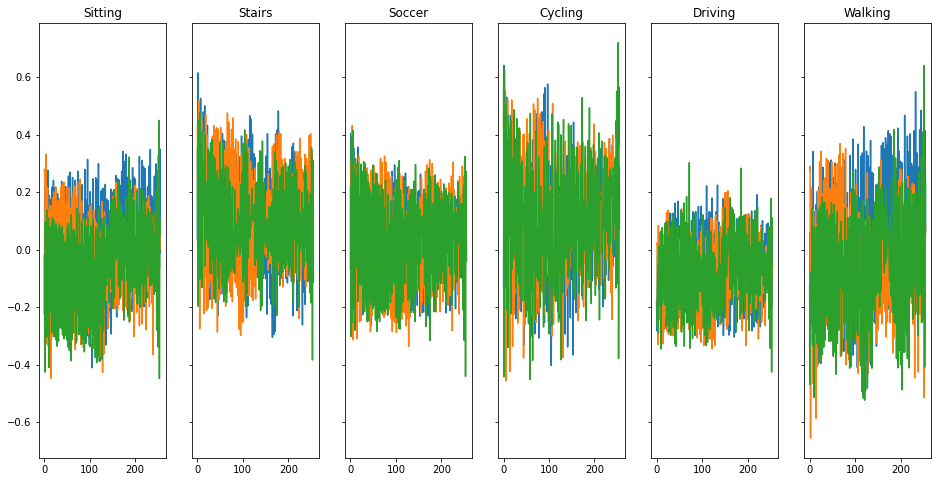

[[4063    0   19    0  428   61]
 [   0    0   16    7   67 3156]
 [  15    0 1444   71  561  221]
 [   0    0   25 3273  156   24]
 [ 265    0  263   61 6081  171]
 [  45    0   83    0  235 4333]]


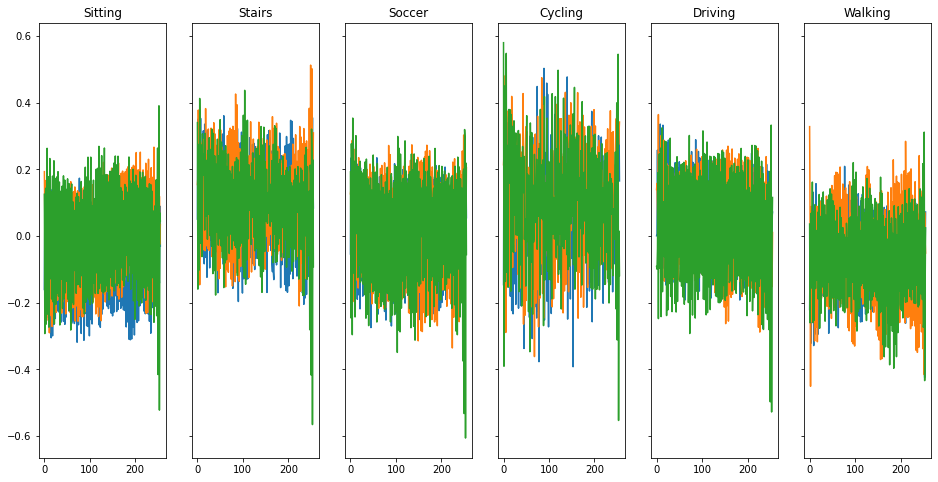

[[4049    0   61    0  404   57]
 [   4    0   35    5   57 3145]
 [  26    0 1707   43  324  212]
 [   0    0   48 3225  160   45]
 [ 260    0  372   37 6049  123]
 [  54    0   88    1  206 4347]]


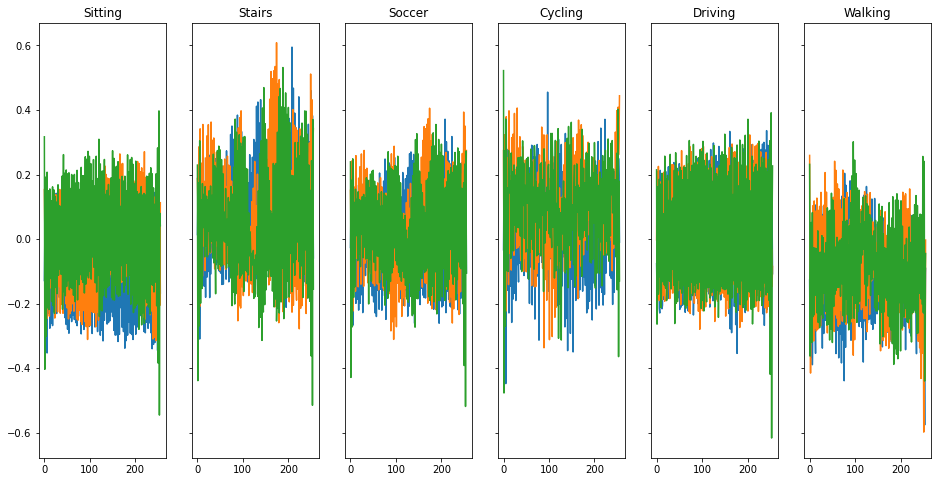

[[4066    0   24    0  422   59]
 [   2    0   14    3   57 3170]
 [  31    0 1454   56  477  294]
 [   0    0   42 3231  180   25]
 [ 268    0  224   24 6164  161]
 [  49    0   51    0  174 4422]]


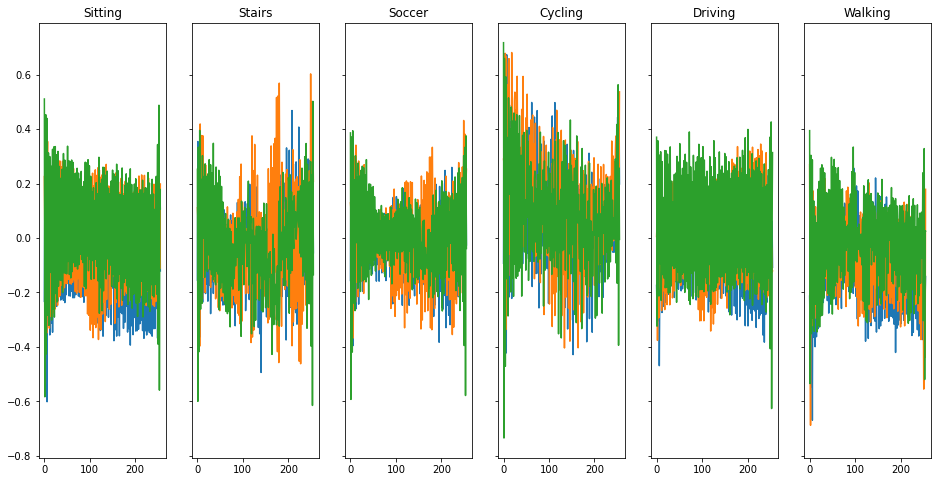

[[4118    0   29    0  381   43]
 [  10    0   35    6   58 3137]
 [  20    0 1602   43  468  179]
 [   0    0   43 3242  174   19]
 [ 355    0  331   31 5985  139]
 [  74    0   59    2  144 4417]]


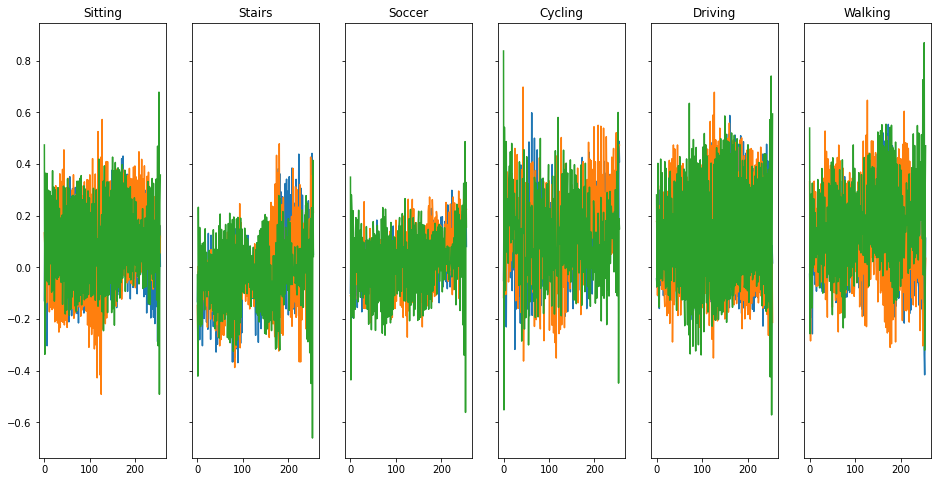

[[4184    0   24    0  311   52]
 [   3    0   57    7   81 3098]
 [  24    0 1639   60  489  100]
 [   0    0   53 3254  148   23]
 [ 509    0  251   26 5959   96]
 [  69    0  125    0  194 4308]]


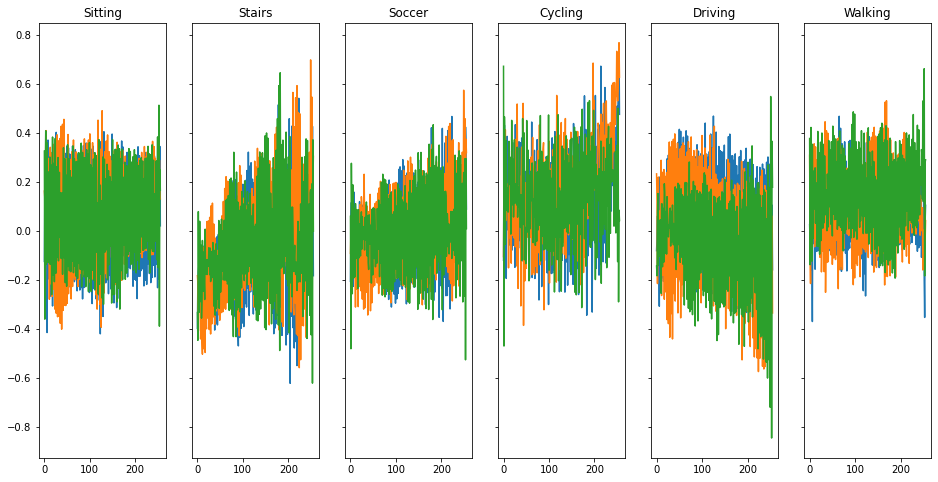

[[4055    0   19    0  445   52]
 [   6    0   37    3   95 3105]
 [  28    0 1559   29  545  151]
 [   6    0   74 3133  203   62]
 [ 299    0  279   26 6127  110]
 [  52    0   74    1  327 4242]]


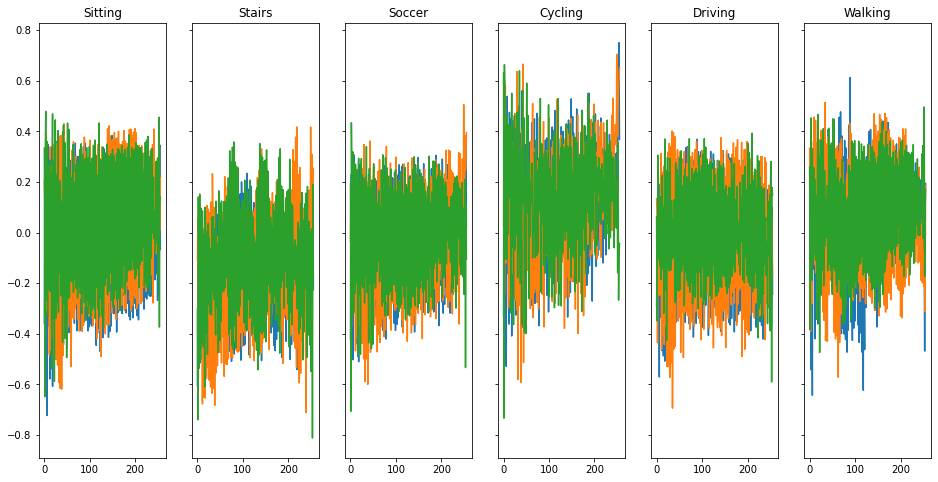

[[4054    0   60    0  414   43]
 [   3    0   30   10   64 3139]
 [  10    0 1708   54  400  140]
 [   0    0   42 3227  189   20]
 [ 280    0  302   29 6079  151]
 [  52    0  130    2  198 4314]]


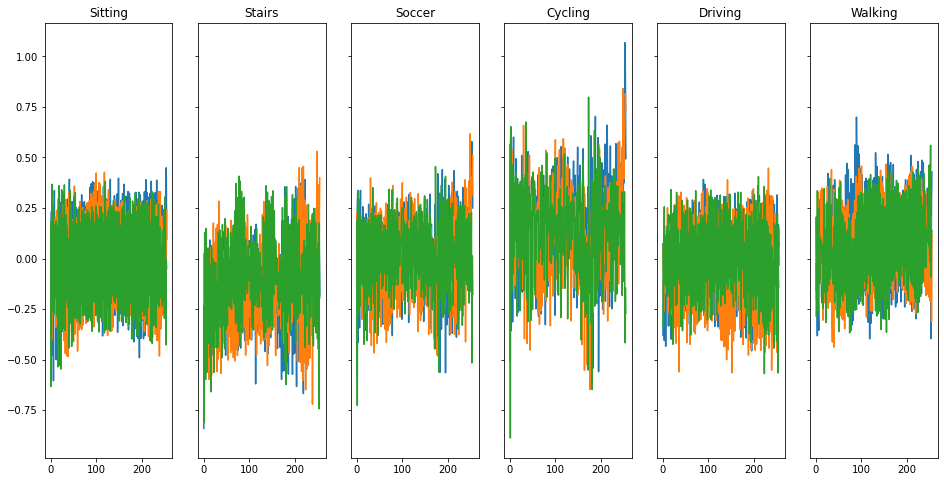

[[3946    0   56    0  519   50]
 [   1    0   36    7   58 3144]
 [   2    0 1606   49  428  227]
 [   0    0   49 3194  204   31]
 [ 189    0  378   40 6046  188]
 [  36    0   73    0  232 4355]]


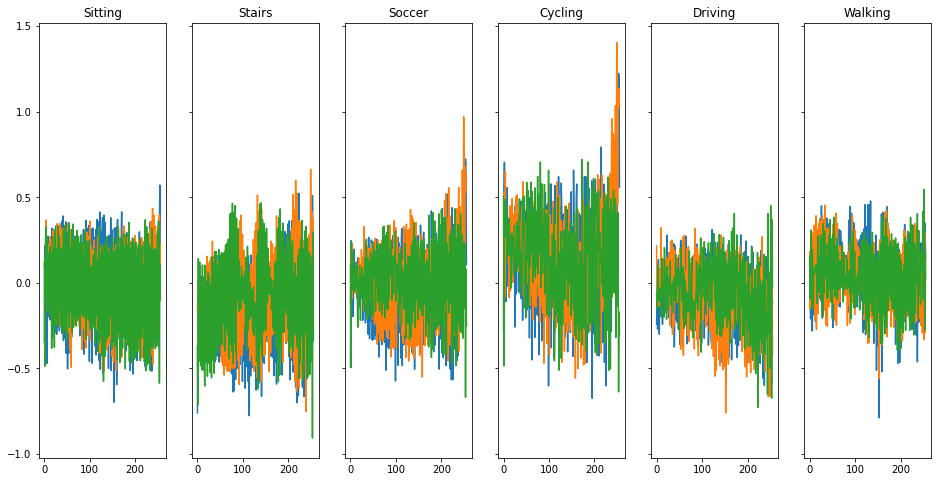

[[3874    0   55    0  595   47]
 [  19    0   18    6   56 3147]
 [  42    0 1653   81  340  196]
 [   0    0   36 3248  163   31]
 [ 225    0  322   51 6096  147]
 [  77    0   87    3  138 4391]]


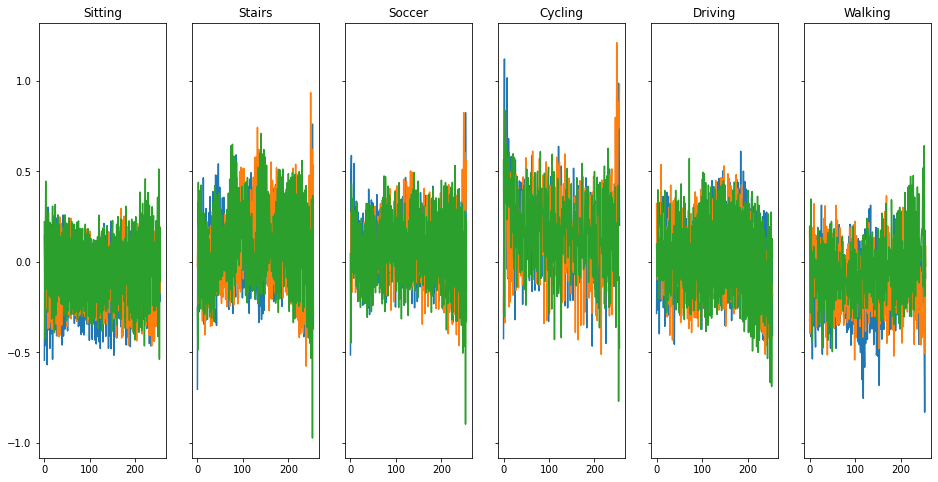

[[4038    0   46    1  433   53]
 [   0    0   12   11   41 3182]
 [  15    0 1549   63  399  286]
 [   0    0   24 3261  168   25]
 [ 235    0  264   81 6039  222]
 [  44    0   81    1  126 4444]]


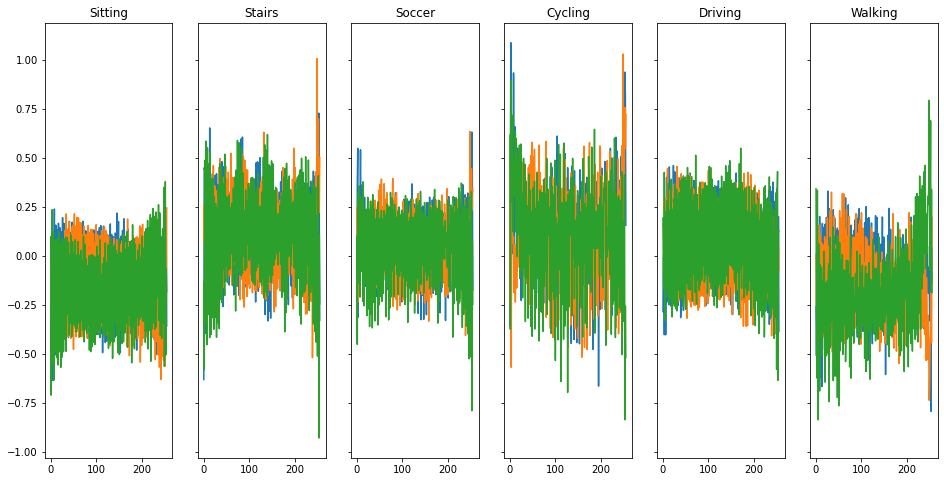

[[4086    0   36    0  387   62]
 [   3    0   31    9   52 3151]
 [  31    0 1597   53  413  218]
 [   0    0   33 3272  157   16]
 [ 185    0  276   36 6180  164]
 [  33    0   60    1  147 4455]]


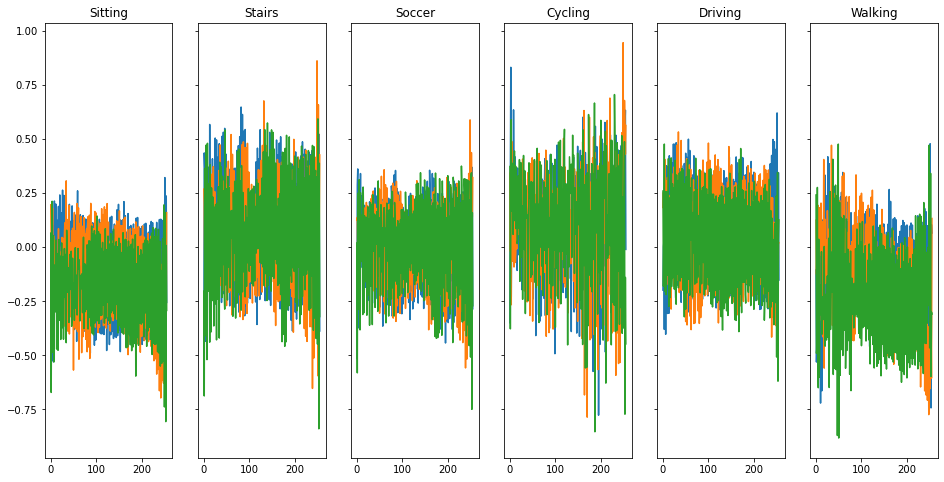

[[4066    0   39    0  389   77]
 [   1    0   22    3   72 3148]
 [  45    0 1641   42  419  165]
 [   0    0   28 3222  203   25]
 [ 174    0  239   12 6297  119]
 [  33    0   91    0  185 4387]]


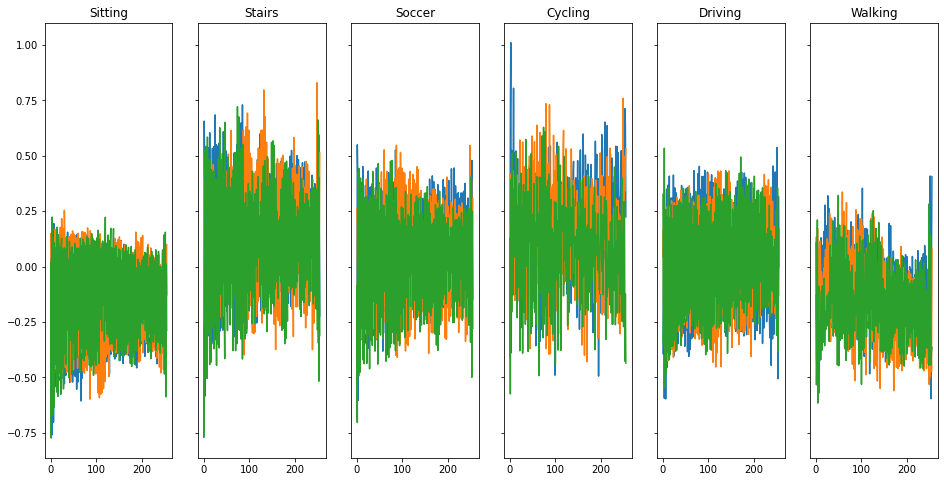

[[4045    0   29    0  456   41]
 [   4    0   13   10   52 3167]
 [  41    0 1570   59  402  240]
 [   0    0   36 3263  157   22]
 [ 215    0  267   57 6166  136]
 [  86    0   84    1  166 4359]]


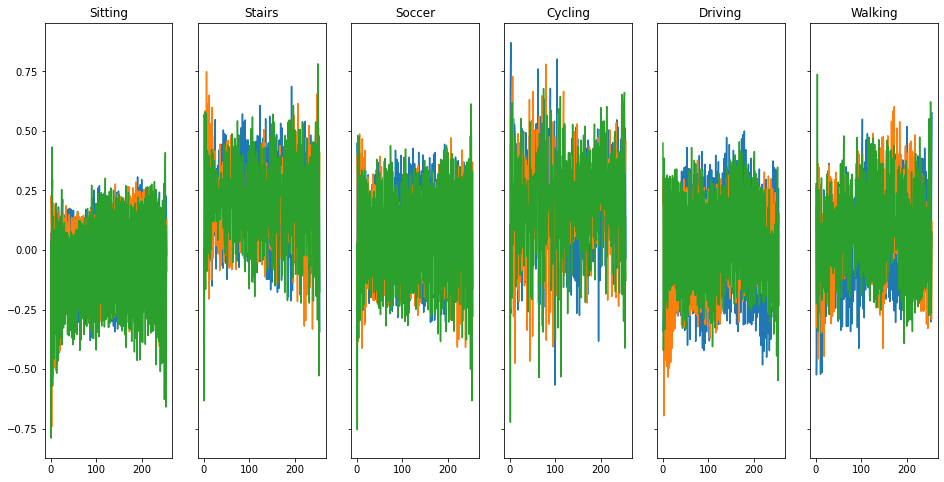

[[4077    0   65    0  376   53]
 [   2    0   43   12   67 3122]
 [  21    0 1692   46  390  163]
 [   3    0   39 3252  169   15]
 [ 217    0  361   29 6114  120]
 [  36    0   95    0  174 4391]]


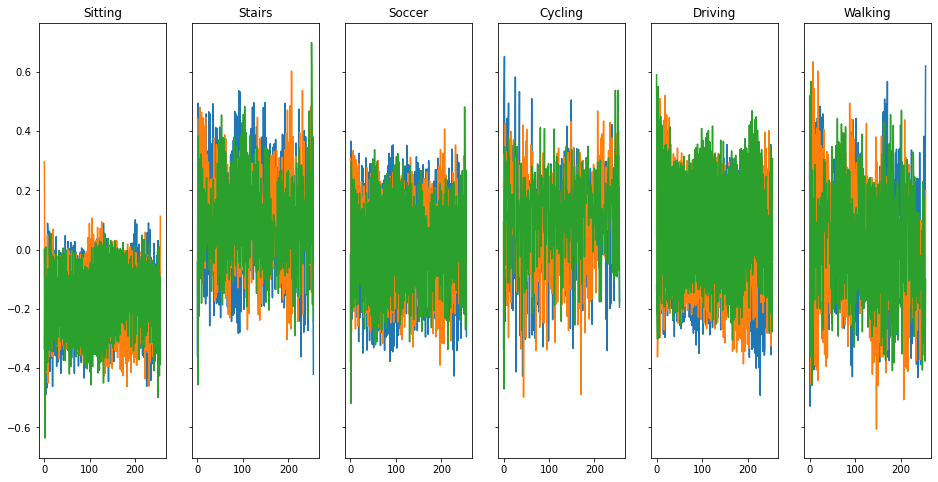

[[4063    0   39    0  398   71]
 [   0    0   28   18   79 3121]
 [  16    0 1598   65  441  192]
 [   0    0   36 3262  167   13]
 [ 222    0  259   41 6197  122]
 [  49    0   86   12  155 4394]]


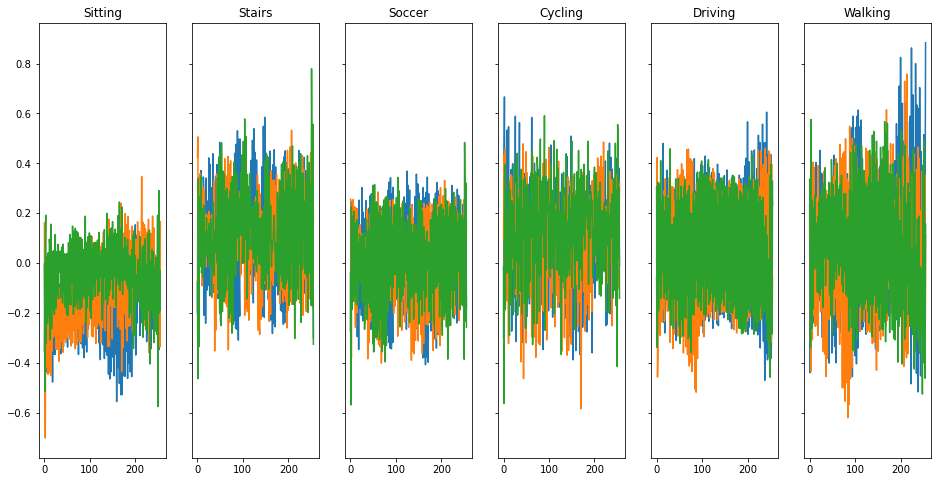

[[3957    0   77    0  477   60]
 [   1    0   23    8   67 3147]
 [  11    0 1606   53  445  197]
 [   1    0   41 3247  166   23]
 [ 260    0  227   39 6147  168]
 [  54    0  101    2  162 4377]]


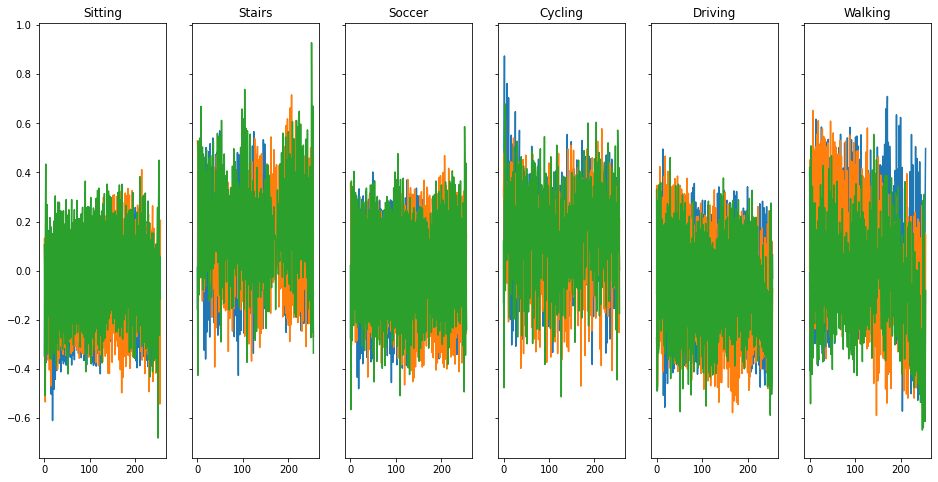

[[4007    0   15    0  491   58]
 [   6    0   21    9   54 3156]
 [  25    0 1477   45  516  249]
 [   0    0   37 3231  183   27]
 [ 287    0  215   33 6141  165]
 [ 119    0   59    0  169 4349]]


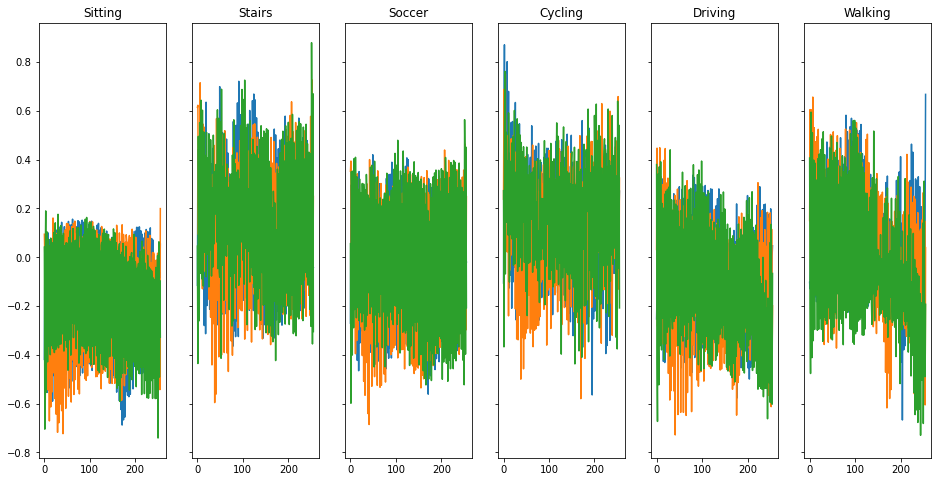

[[3437    0   74    0  931  129]
 [   2    0   11    6   58 3169]
 [   4    0 1333   30  545  400]
 [   2    0   47 3151  238   40]
 [ 155    0  206   12 6092  376]
 [  69    0   46    0  196 4385]]


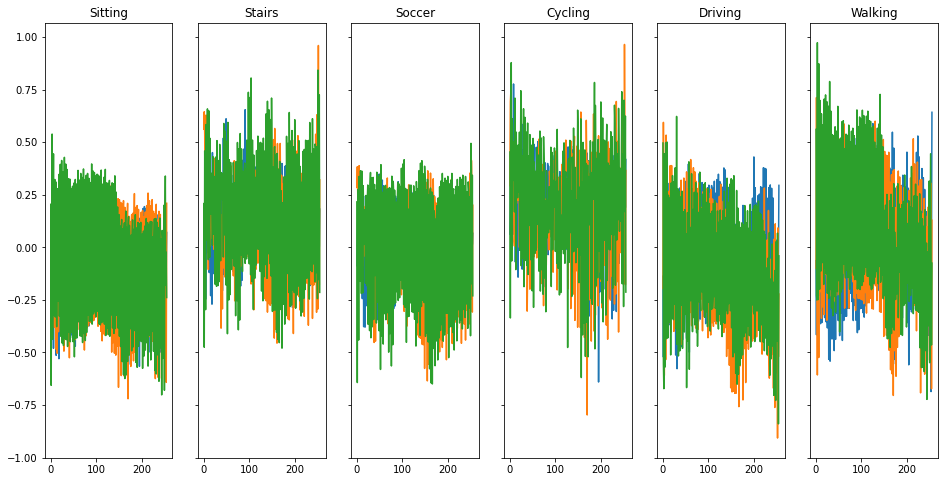

[[3985    0   34    0  450  102]
 [   1    0   66    8   66 3105]
 [  31    0 1673   45  398  165]
 [   0    0   30 3245  185   18]
 [ 247    0  312   44 6094  144]
 [  70    0   76    1  140 4409]]


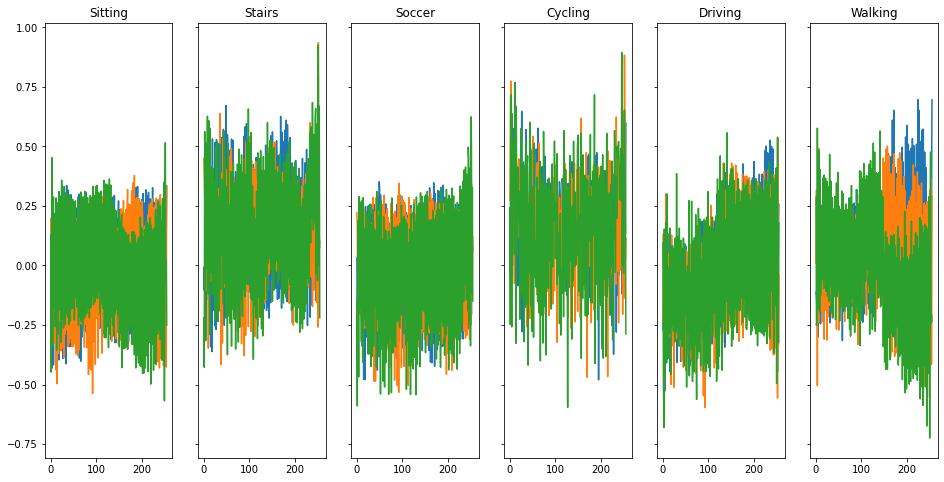

[[4033    0   38    0  424   76]
 [   4    0   23   12   56 3151]
 [  29    0 1605   75  333  270]
 [   0    0   39 3213  196   30]
 [ 297    0  306   35 5989  214]
 [  66    0   71    1  149 4409]]


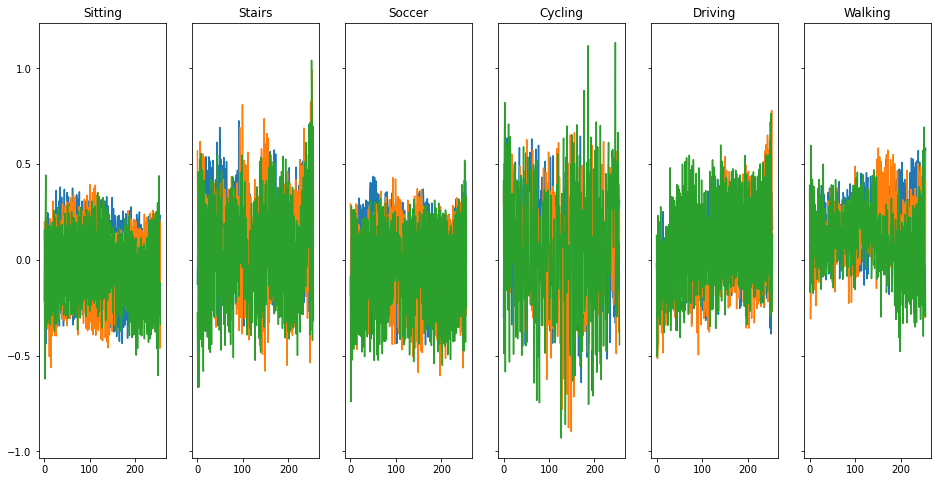

[[4047    0   41    1  432   50]
 [   1    0   10    4   46 3185]
 [  13    0 1581   66  430  222]
 [   0    0   33 3214  201   30]
 [ 196    0  219   22 6254  150]
 [  51    0   72    0  163 4410]]


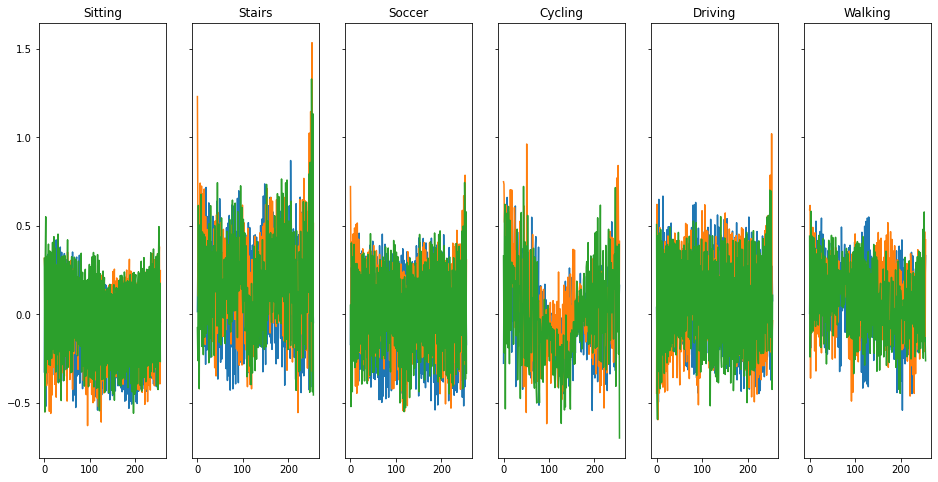

[[4017    0   49    1  448   56]
 [   1    0   16    4   59 3166]
 [  14    0 1471   53  476  298]
 [   1    0   36 3201  205   35]
 [ 231    0  215   23 6179  193]
 [  45    0   65    0  249 4337]]


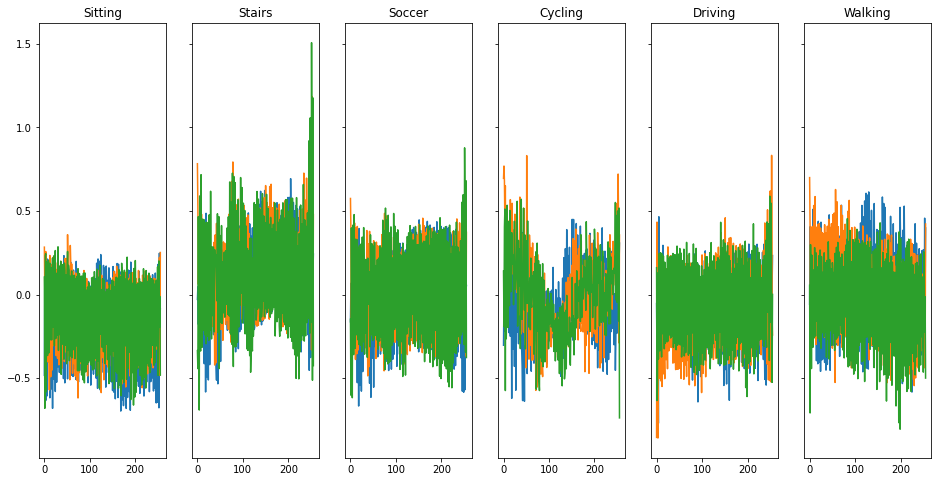

[[4089    0   63    0  382   37]
 [   4    0   33    4   63 3142]
 [  32    0 1680   46  400  154]
 [   0    0   49 3218  195   16]
 [ 228    0  308   27 6160  118]
 [  65    0   99    1  175 4356]]


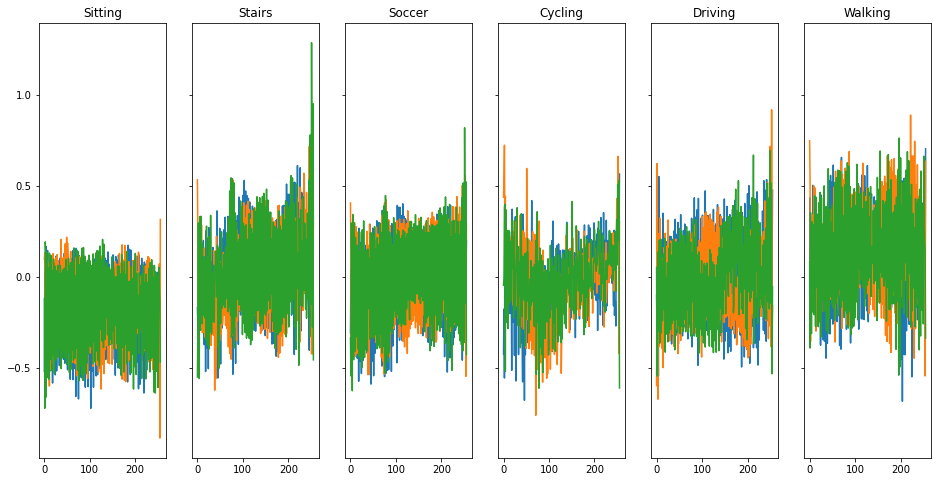

[[4092    0   54    0  365   60]
 [   0    0   45    6   53 3142]
 [  40    0 1642   46  346  238]
 [   0    0   56 3207  197   18]
 [ 311    0  343   53 5965  169]
 [  65    0   64    0  135 4432]]


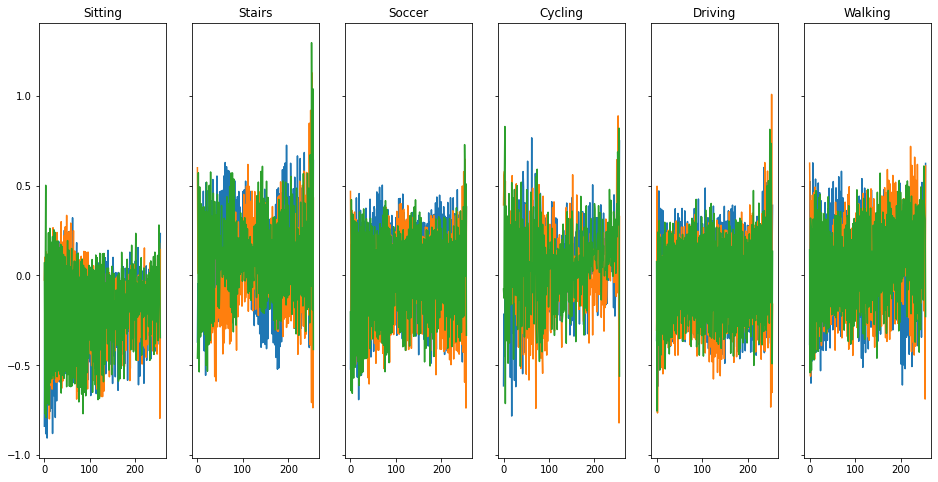

[[3998    0   23    0  509   41]
 [   2    0   34    5   64 3141]
 [  44    0 1563   56  476  173]
 [   0    0   55 3209  190   24]
 [ 190    0  236   16 6230  169]
 [  67    0   79    2  181 4367]]


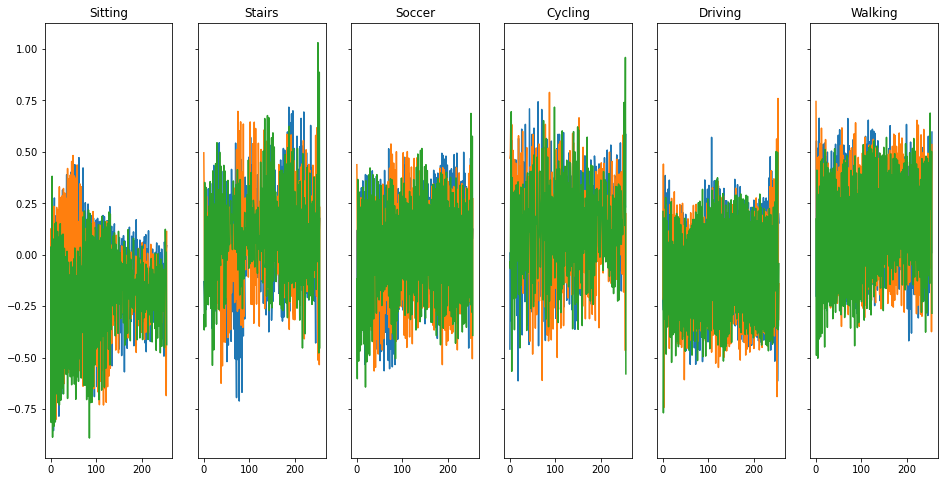

[[4097    0   20    0  405   49]
 [   5    0   58   14   78 3091]
 [  21    0 1551   63  470  207]
 [   0    0   32 3254  165   27]
 [ 251    0  201  104 6163  122]
 [  62    0  108    1  228 4297]]


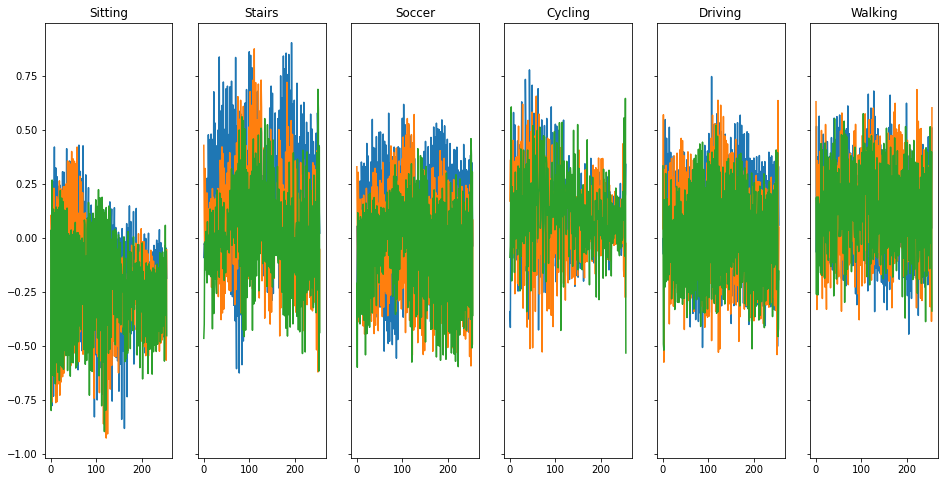

[[4034    0   32    2  456   47]
 [   3    0   23   14   67 3139]
 [  22    0 1576   46  431  237]
 [   0    0   31 3235  178   34]
 [ 228    0  167   40 6250  156]
 [  52    0   84    0  203 4357]]


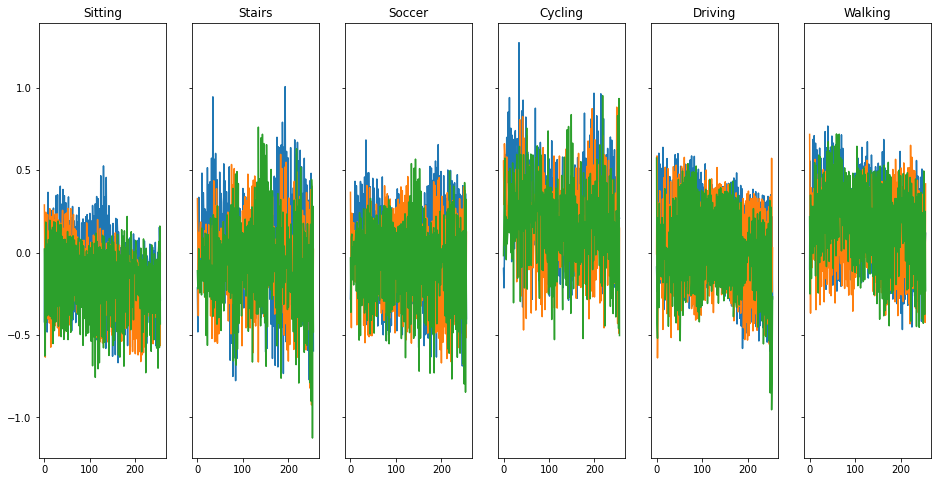

[[4046    0   56    0  409   60]
 [   2    0   32    8   49 3155]
 [  33    0 1728   40  304  207]
 [   0    0   60 3222  168   28]
 [ 203    0  319   51 6149  119]
 [  25    0   80    3  145 4443]]


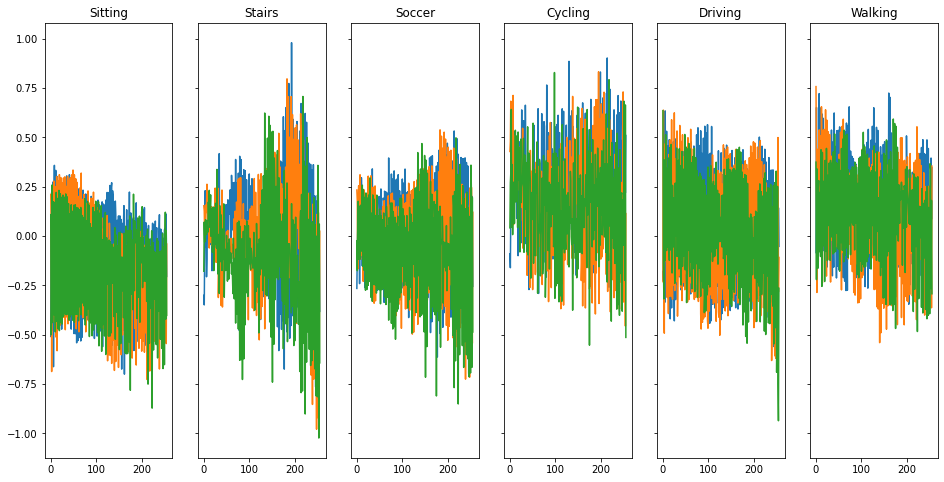

[[3997    0   15    0  500   59]
 [   0    0   14   13   48 3171]
 [   6    0 1475   64  427  340]
 [   0    0   45 3253  149   31]
 [ 195    0  216   68 6147  215]
 [  21    0   71    3  188 4413]]


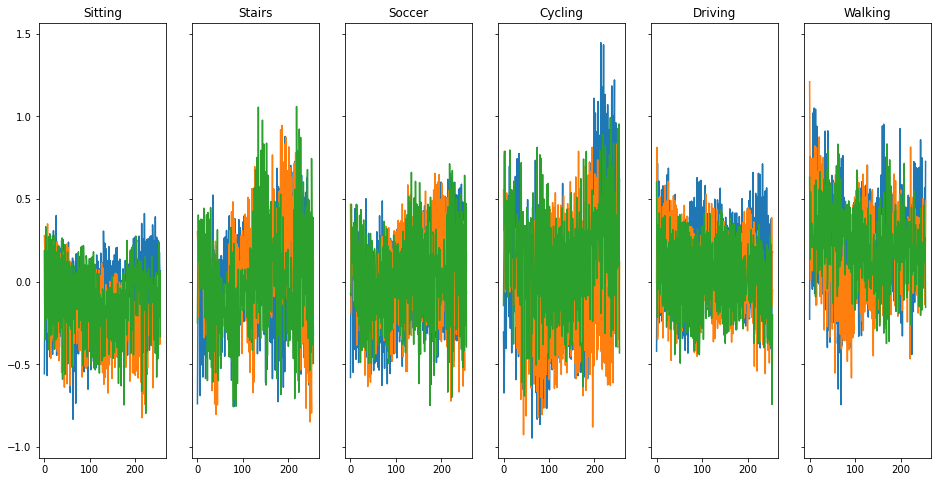

[[3952    0   63    0  508   48]
 [   4    0   22    2   63 3155]
 [  16    0 1593   40  450  213]
 [   0    0   57 3134  260   27]
 [ 246    0  253   16 6209  117]
 [  53    0   73    1  166 4403]]


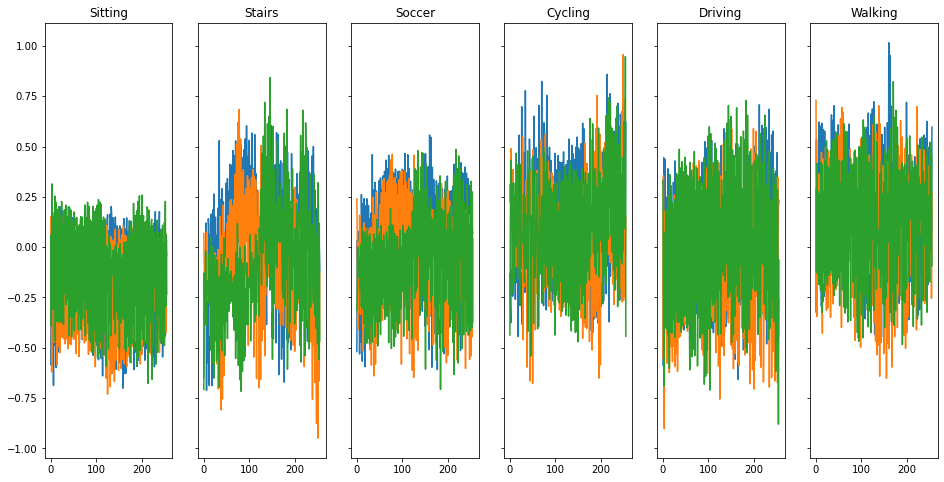

[[3769    0   47    2  678   75]
 [   2    0   51   47  137 3009]
 [  15    0 1189   86  650  372]
 [   0    0   88 2822  449  119]
 [ 227    0  213   33 6166  202]
 [  49    0   50   36  404 4157]]


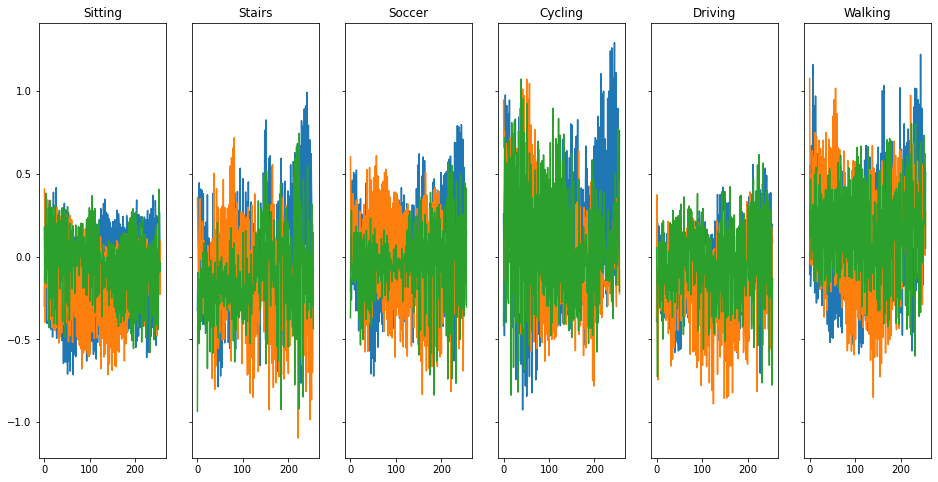

[[4141    0   38    0  343   49]
 [   4    0   25   13   62 3142]
 [  31    0 1720   47  354  160]
 [   0    0   53 3223  187   15]
 [ 305    0  287   19 6117  113]
 [  39    0   71    2  159 4425]]


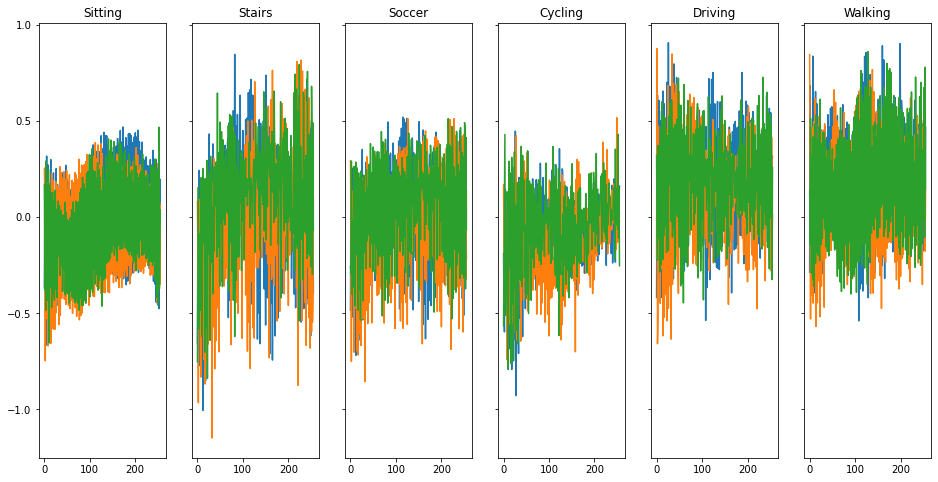

[[4057    0   32    0  435   47]
 [   2    0   38   10   52 3144]
 [  13    0 1653   41  446  159]
 [   0    0   58 3209  184   27]
 [ 256    0  283   19 6154  129]
 [  43    0  102    0  154 4397]]


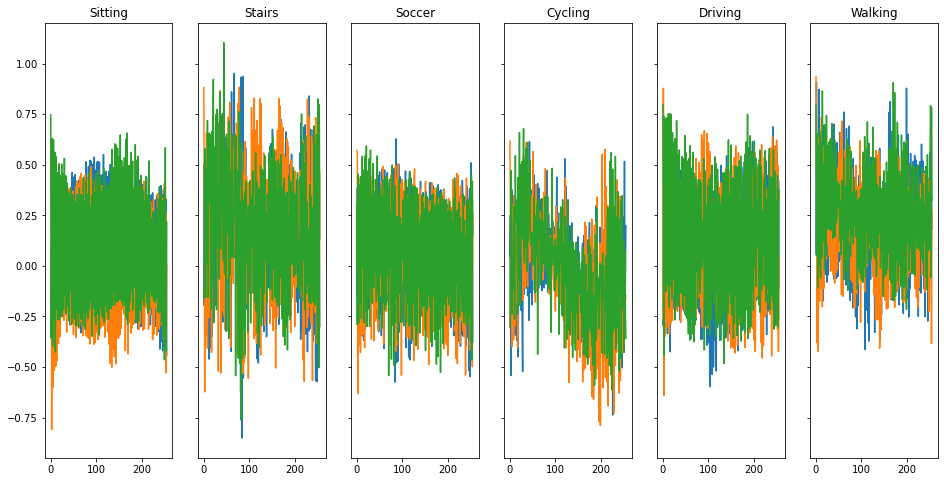

[[4090    0   69    0  370   42]
 [   2    0   40    7   63 3134]
 [  18    0 1739   41  387  127]
 [   2    0   53 3224  165   34]
 [ 276    0  283   19 6179   84]
 [  43    0   92    2  180 4379]]


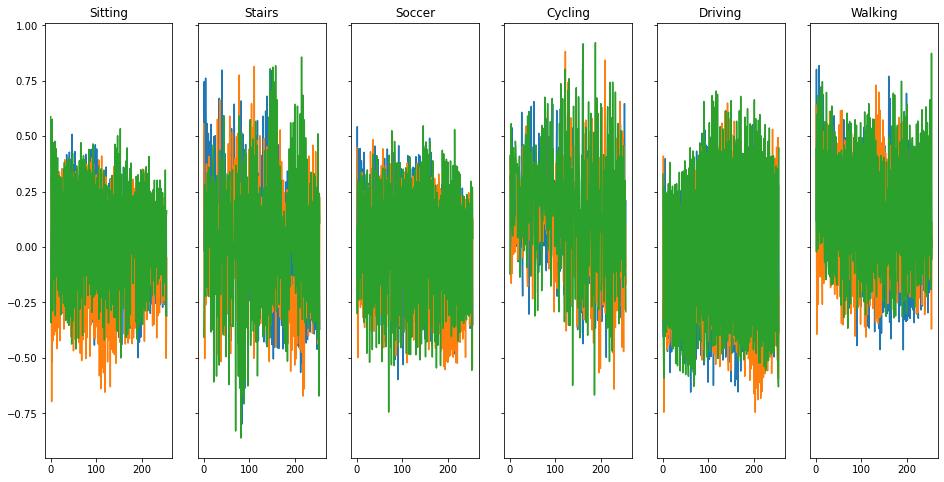

[[3097    0   66    1  551  856]
 [   0    0   37    8   60 3141]
 [   3    0 1596   38  402  273]
 [   0    0   78 3185  186   29]
 [ 362    0  249   33 5957  240]
 [  12    0   58    2  215 4409]]


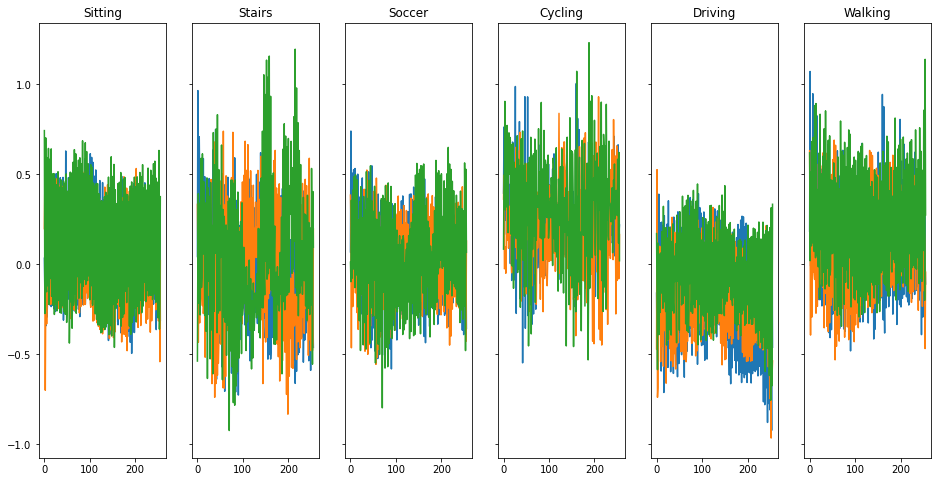

[[4019    0   34    0  461   57]
 [   6    0   34    6   67 3133]
 [   7    0 1547   60  474  224]
 [   0    0   50 3185  212   31]
 [ 300    0  212   18 6170  141]
 [  55    0   71    2  234 4334]]


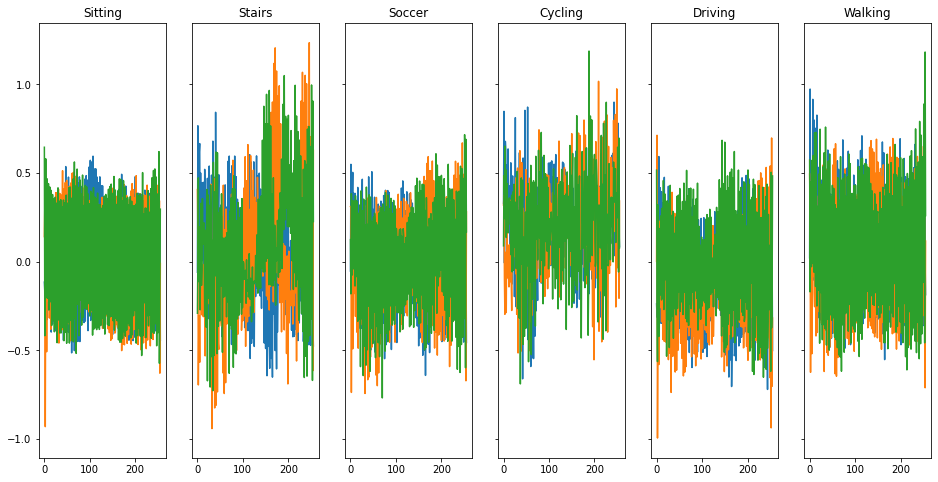

[[4059    0   62    0  408   42]
 [   1    0   38   10   57 3140]
 [  11    0 1721   51  340  189]
 [   0    0   55 3232  170   21]
 [ 284    0  308   22 6079  148]
 [  49    0   88    0  145 4414]]


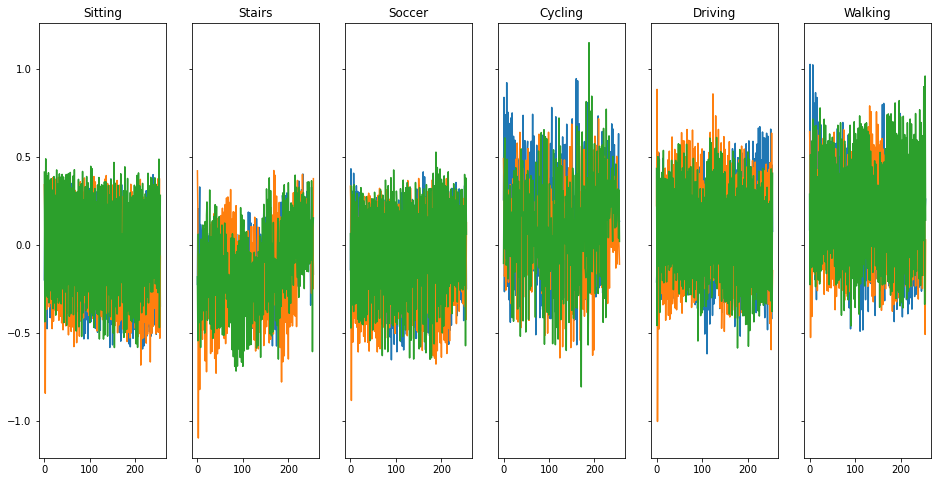

[[4058    0   30    0  412   71]
 [   1    0   41   10   64 3130]
 [  52    0 1634   28  408  190]
 [   1    0   44 3185  216   32]
 [ 278    0  225   12 6199  127]
 [  48    0   72    0  169 4407]]


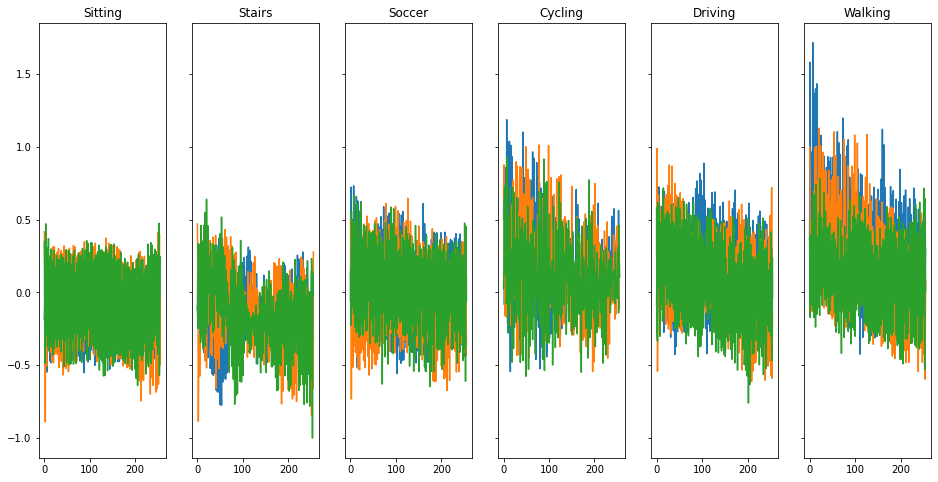

[[4018    0   64    0  437   52]
 [   1    0   58    9   61 3117]
 [  15    0 1737   59  315  186]
 [   1    0   88 3178  187   24]
 [ 232    0  315   17 6144  133]
 [  49    0   90    2  149 4406]]


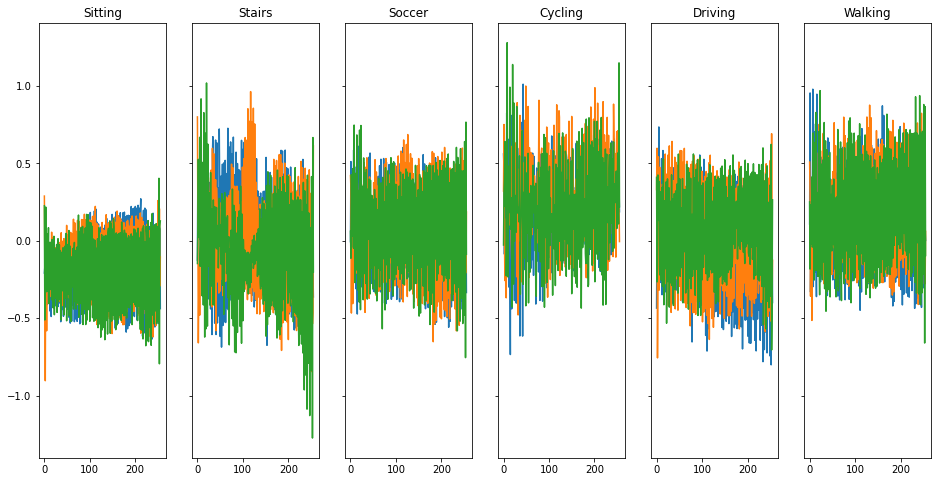

[[4057    0   46    0  419   49]
 [  12    0   24    3   68 3139]
 [   3    0 1658   64  405  182]
 [   0    0   33 3207  202   36]
 [ 263    0  188   21 6247  122]
 [  48    0  111    0  185 4352]]


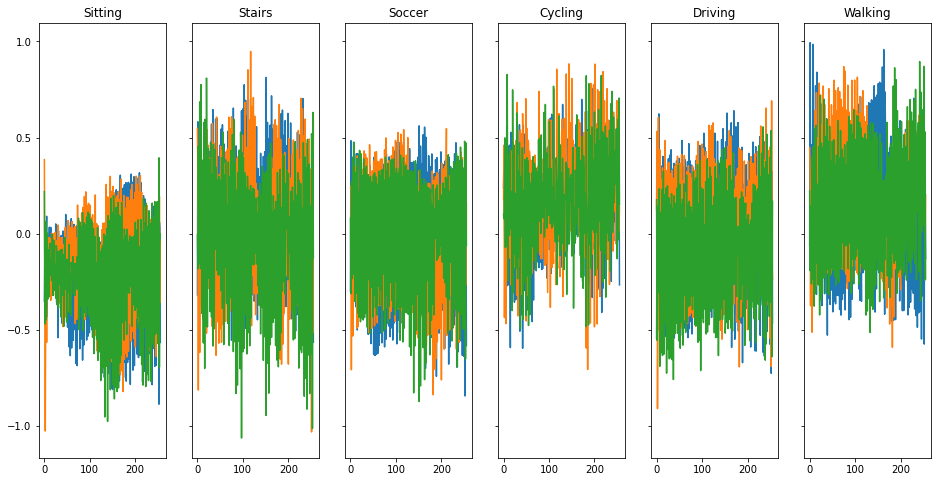

[[3988    0   40    0  487   56]
 [   7    0   25    4   44 3166]
 [   4    0 1595   37  388  288]
 [   0    0   43 3200  186   49]
 [ 263    0  181   17 6124  256]
 [  71    0   57    0  151 4417]]


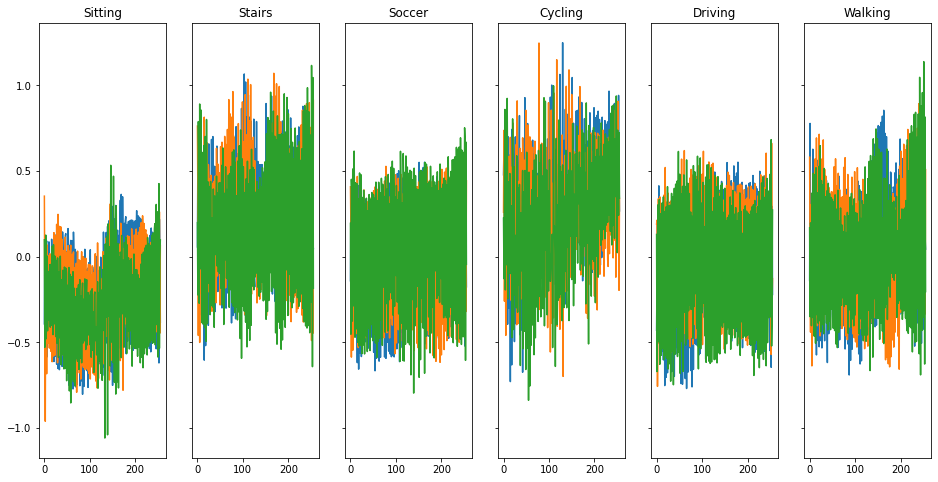

[[4035    0   38    0  449   49]
 [   3    0   26    4   64 3149]
 [  35    0 1711   43  368  155]
 [   0    0   45 3239  169   25]
 [ 215    0  208   24 6289  105]
 [  36    0   88    0  146 4426]]


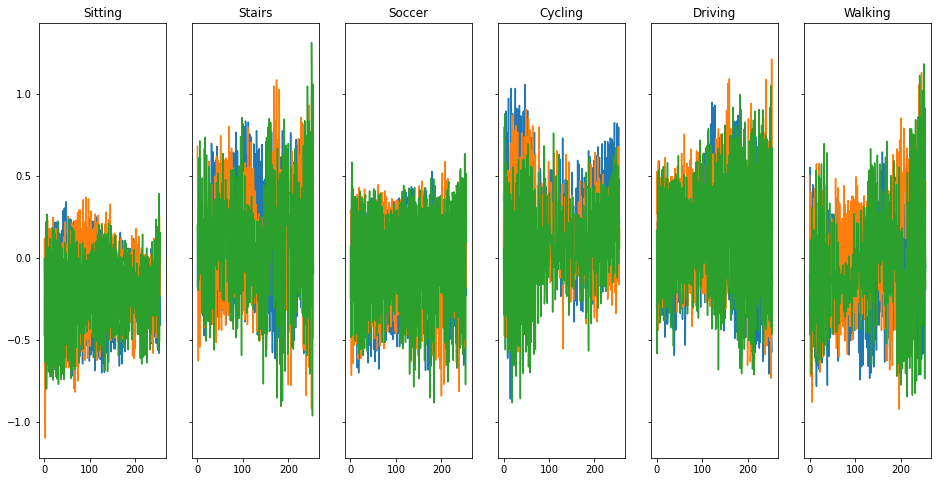

[[4027    0   40    0  460   44]
 [   6    0   27    3   77 3133]
 [  12    0 1605   28  441  226]
 [   0    0   75 3154  226   23]
 [ 225    0  186   14 6307  109]
 [  43    0   62    1  205 4385]]


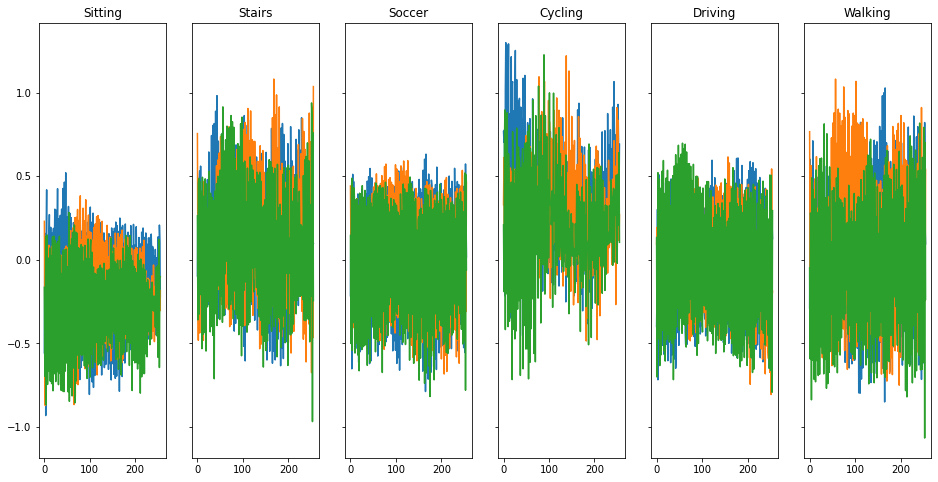

[[4044    0   59    0  403   65]
 [   2    0   18    6   43 3177]
 [  23    0 1661   48  312  268]
 [   1    0  134 3157  163   23]
 [ 275    0  285   16 6012  253]
 [  47    0   51    1  106 4491]]


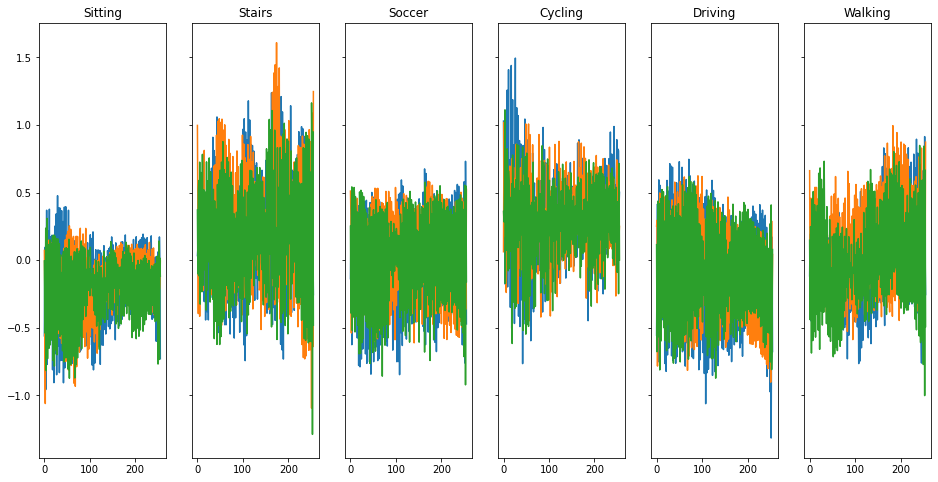

[[4050    0   60    0  426   35]
 [   5    0   31   11   65 3134]
 [  61    0 1762   56  293  140]
 [   1    0   59 3245  137   36]
 [ 235    0  328   34 6091  153]
 [  45    0  109    0  199 4343]]


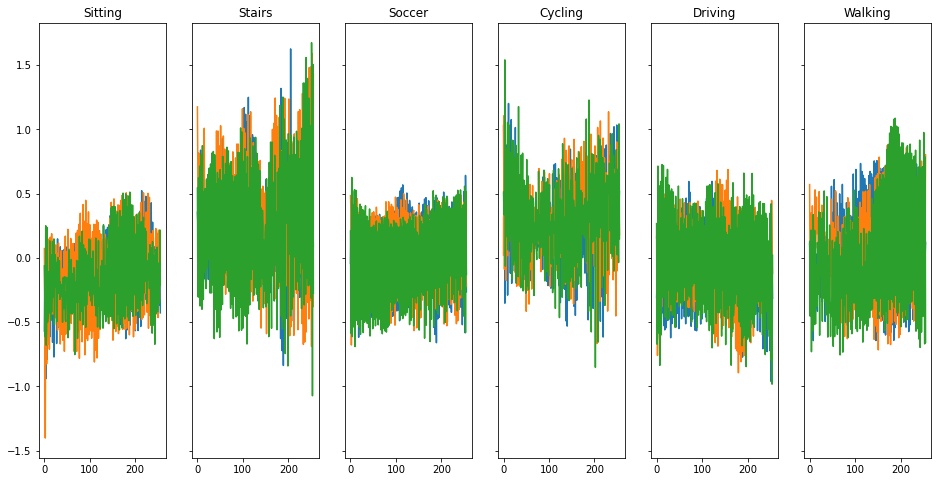

[[4135    0   33    0  369   34]
 [   0    0   19    1   78 3148]
 [   7    0 1665   25  460  155]
 [   1    0   66 3194  161   56]
 [ 331    0  179   11 6189  131]
 [  43    0   67    0  194 4392]]


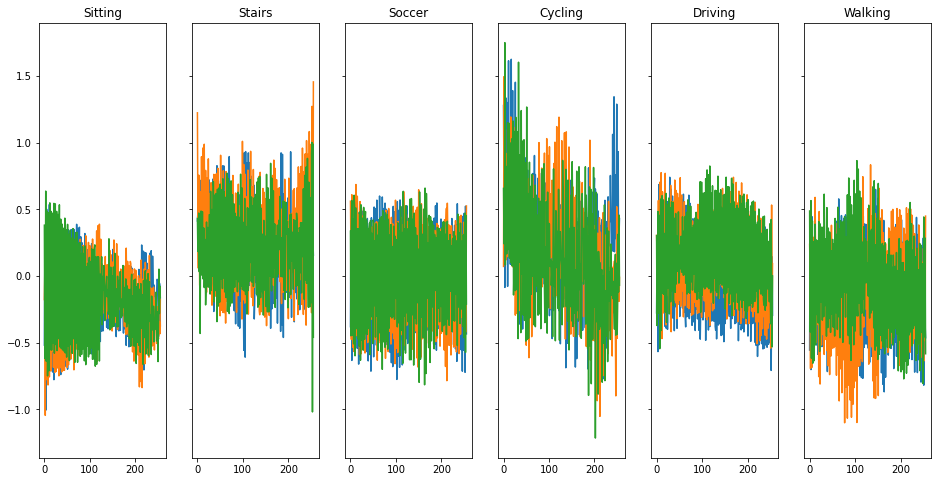

[[4016    0   46    1  467   41]
 [   1    0   24    5   66 3150]
 [  21    0 1658   43  444  146]
 [   0    0   37 3226  196   19]
 [ 193    0  248   27 6288   85]
 [  37    0   60    1  182 4416]]


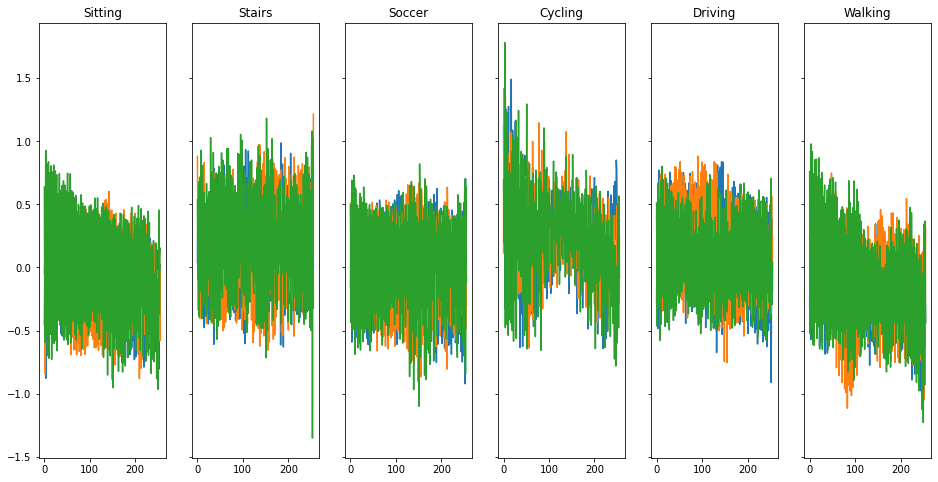

[[4028    0   46    1  441   55]
 [   2    0   22    6   57 3159]
 [   4    0 1645   37  424  202]
 [   0    0   58 3193  198   29]
 [ 292    0  218   11 6190  130]
 [  50    0   60    1  158 4427]]


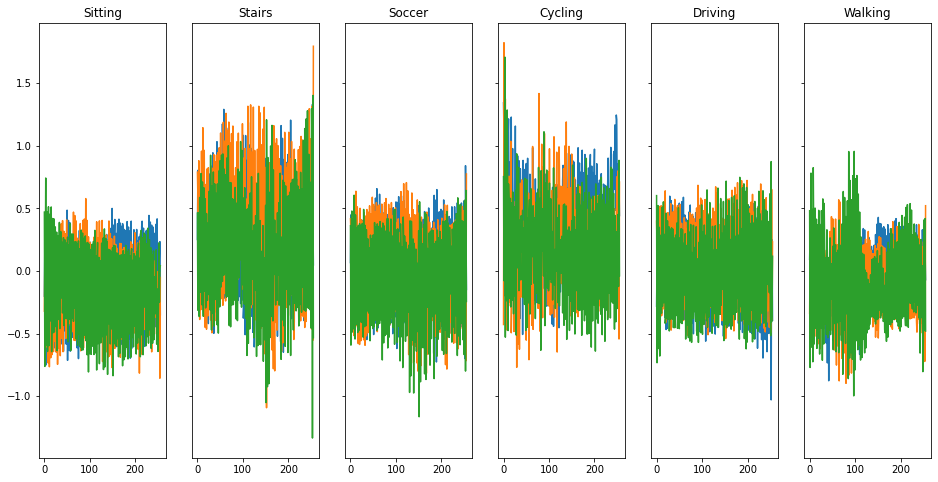

[[4056    0   59    3  414   39]
 [   4    0   38    9   74 3121]
 [   4    0 1727   53  421  107]
 [   0    0   35 3218  186   39]
 [ 346    0  302   45 6085   63]
 [  63    0  144    2  163 4324]]


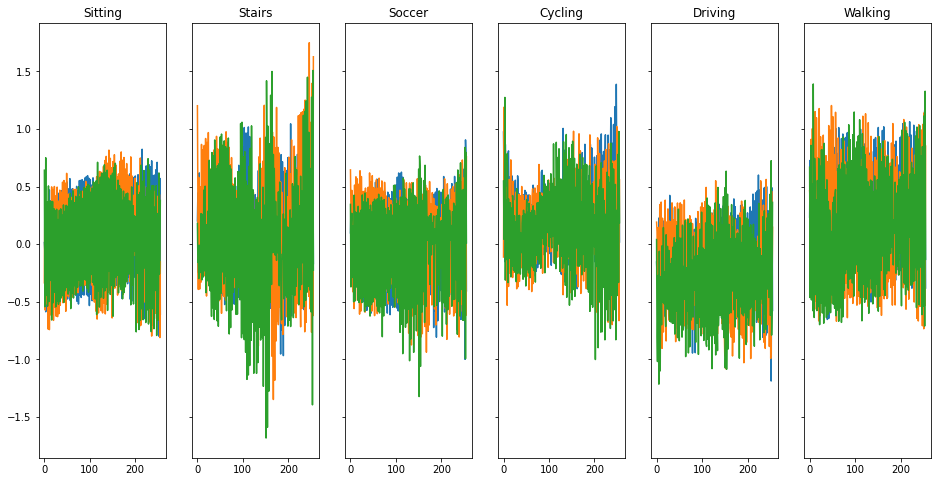

[[4041    0   40    0  433   57]
 [   0    0   39    7   63 3137]
 [  36    0 1743   55  270  208]
 [   5    0   59 3216  182   16]
 [ 329    0  228   35 6118  131]
 [  57    0   74    1  153 4411]]


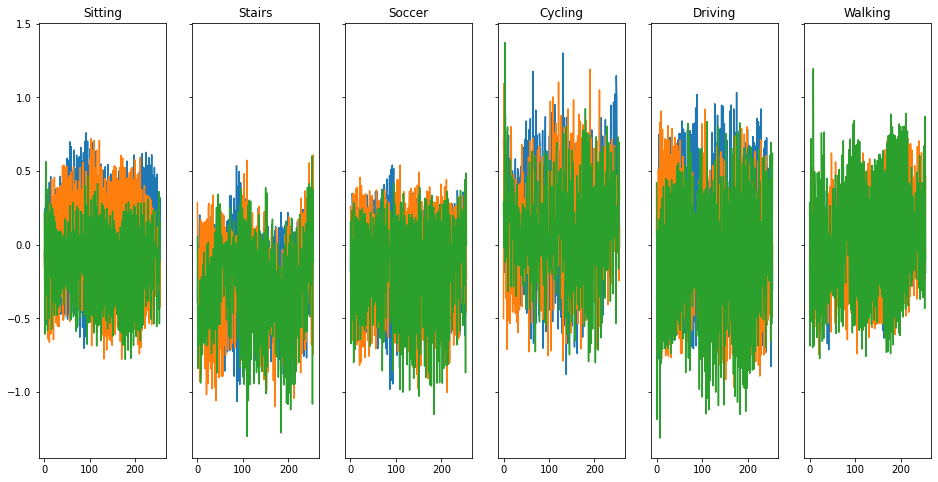

[[4011    0   61    0  431   68]
 [   4    0   23    3   77 3139]
 [  14    0 1615   39  431  213]
 [   1    0   67 3183  204   23]
 [ 290    0  226   14 6178  133]
 [  72    0   80    1  232 4311]]


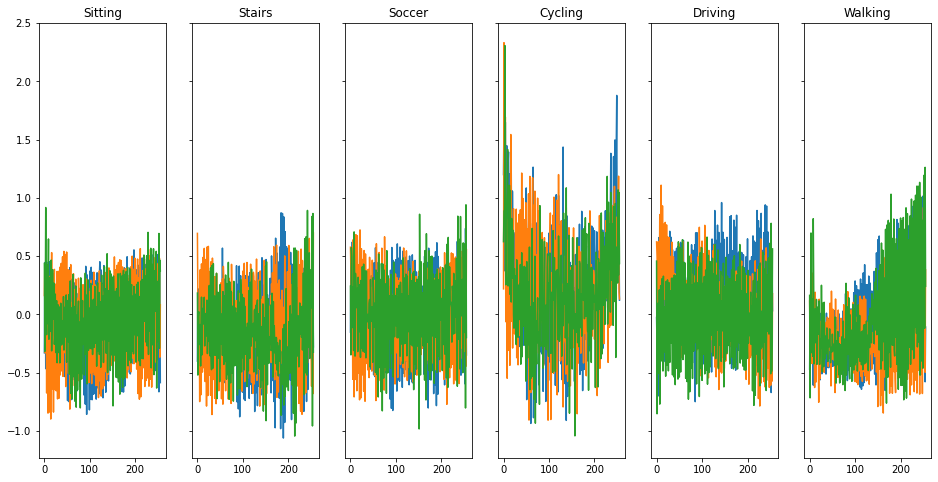

[[4011    0   52    0  455   53]
 [   0    0   30    6   62 3148]
 [   9    0 1728   28  381  166]
 [   0    0   64 3227  166   21]
 [ 249    0  196   13 6134  249]
 [  37    0   95    3  125 4436]]


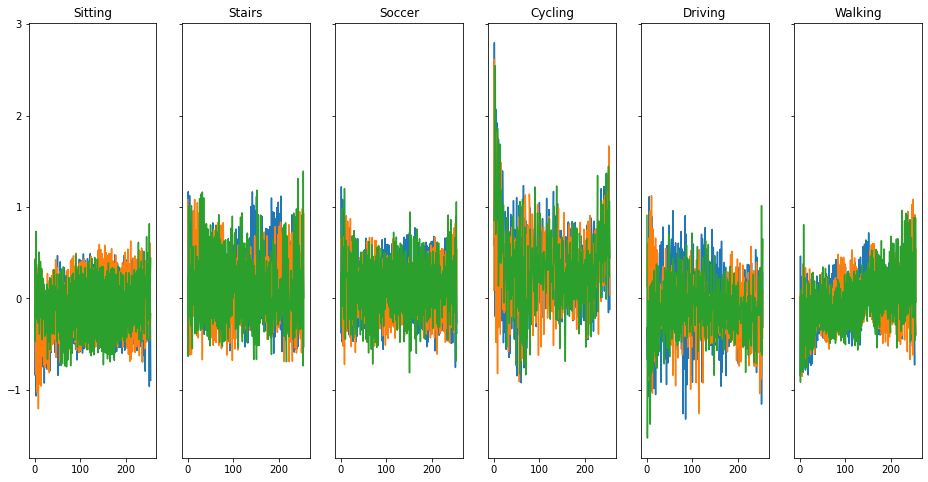

[[4003    0   38    1  496   33]
 [   3    0   42   10   81 3110]
 [  12    0 1621   45  473  161]
 [   0    0   39 3196  231   12]
 [ 239    0  191   18 6311   82]
 [  60    0  108    2  271 4255]]


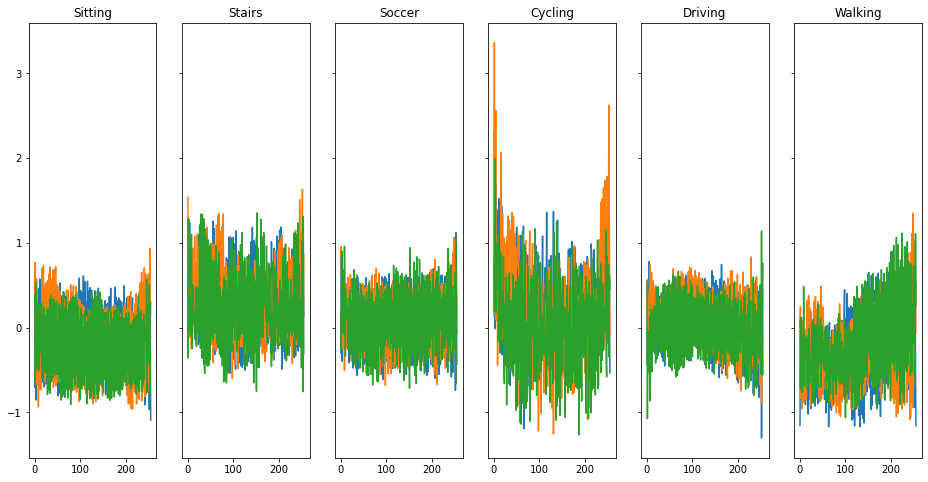

[[4000    0   44    0  470   57]
 [   2    0   23    6   68 3147]
 [  12    0 1680   36  405  179]
 [   0    0   58 3254  147   19]
 [ 227    0  210   25 6254  125]
 [  36    0   76    1  230 4353]]


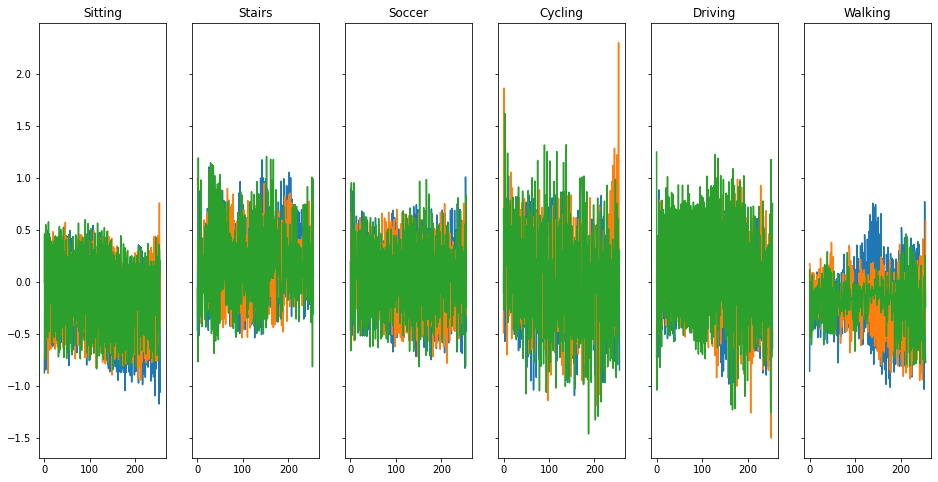

[[4065    0   36    0  422   48]
 [   3    0   29    7   77 3130]
 [  20    0 1657   21  434  180]
 [   1    0   72 3234  146   25]
 [ 218    0  224   33 6268   98]
 [  47    0   74    5  244 4326]]


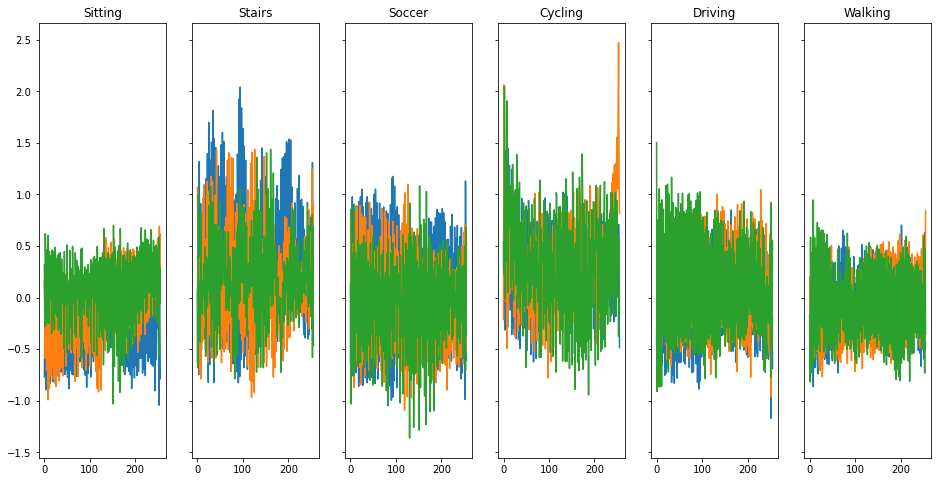

[[4031    0   15    1  483   41]
 [   6    0   28   13  126 3073]
 [  18    1 1449  131  585  128]
 [   0    0   32 3266  156   24]
 [ 336    0  188   29 6206   82]
 [  82    0  109    2  341 4162]]


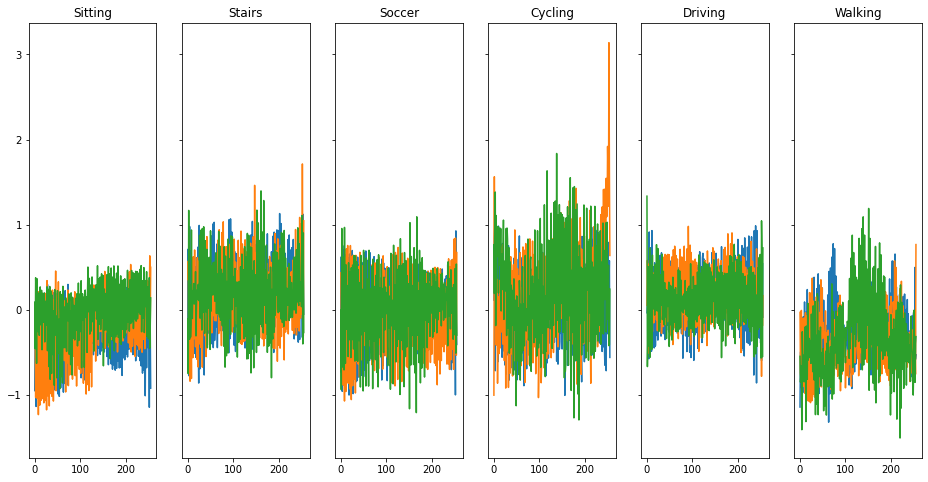

[[4049    0   51    0  420   51]
 [   5    0   28    9   61 3143]
 [  24    0 1712   74  331  171]
 [   0    0   37 3252  158   31]
 [ 296    0  283   29 6091  142]
 [  47    0   98    3  134 4414]]


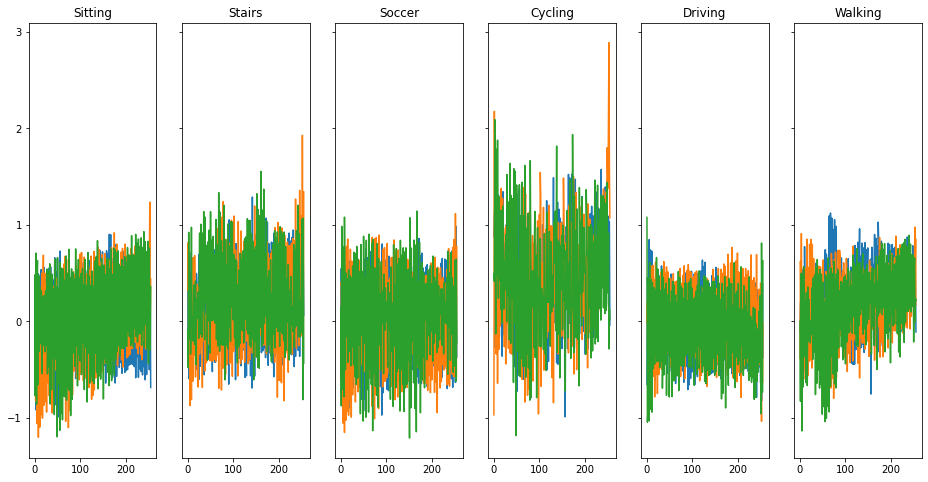

[[4098    0   34    0  389   50]
 [   6    0   28    6   63 3143]
 [  27    0 1663   48  383  191]
 [   0    0   29 3284  149   16]
 [ 277    0  210   41 6198  115]
 [  50    0   75    5  124 4442]]


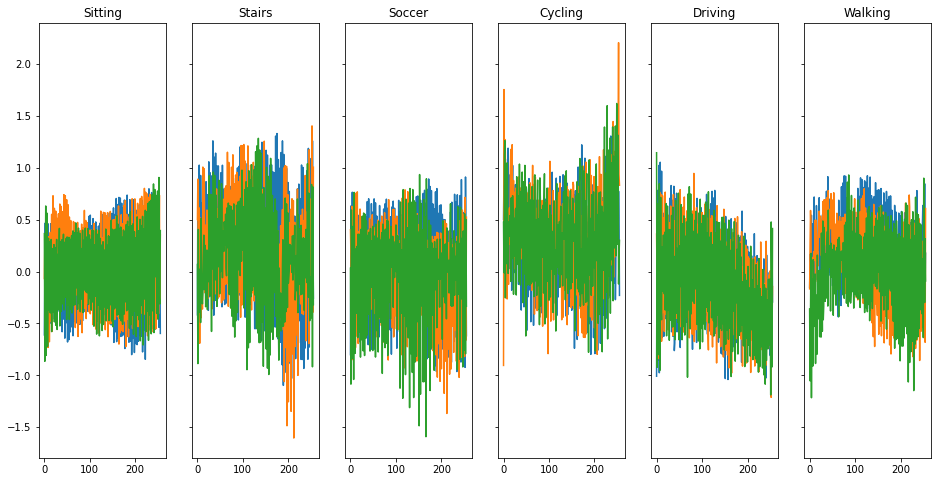

[[4131    0   72    0  312   56]
 [   2    0   39   11   64 3130]
 [  30    0 1800   54  290  138]
 [   1    0   37 3247  179   14]
 [ 323    0  253   23 6140  102]
 [  33    0   88    3  106 4466]]


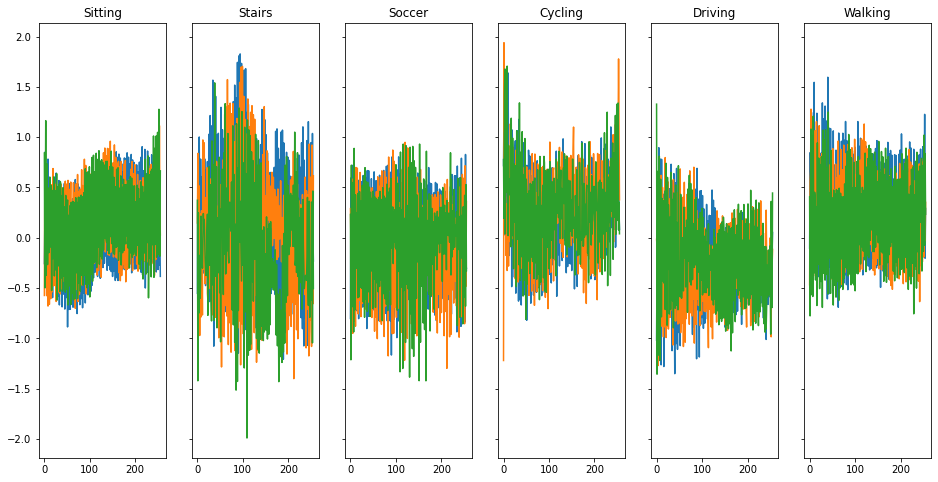

[[4063    0   63    1  408   36]
 [   1    0   30    8   44 3163]
 [  28    0 1845   51  278  110]
 [   4    0   40 3273  144   17]
 [ 258    0  365   23 6118   77]
 [  39    0  110    2  104 4441]]


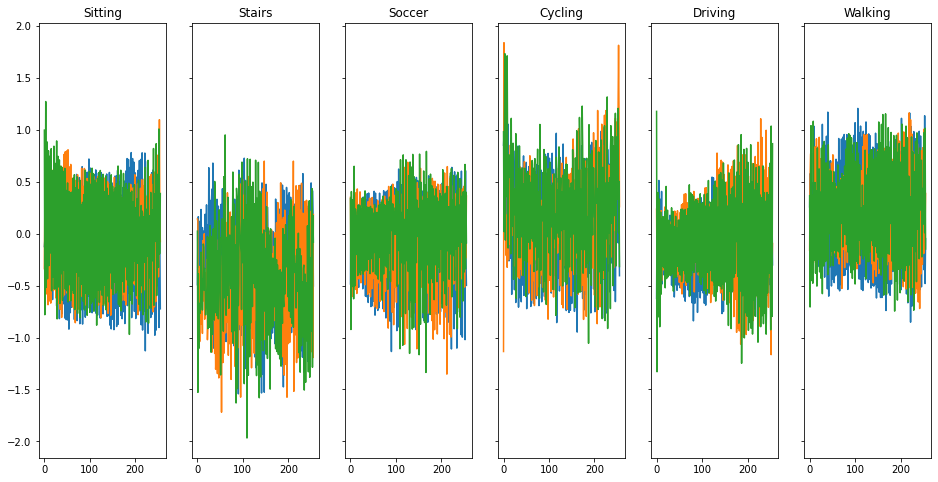

[[4050    0   46    0  433   42]
 [   2    0   42   19   50 3133]
 [  33    0 1762   62  323  132]
 [   0    0   46 3267  150   15]
 [ 229    0  267   37 6191  117]
 [  57    0   75    5  101 4458]]


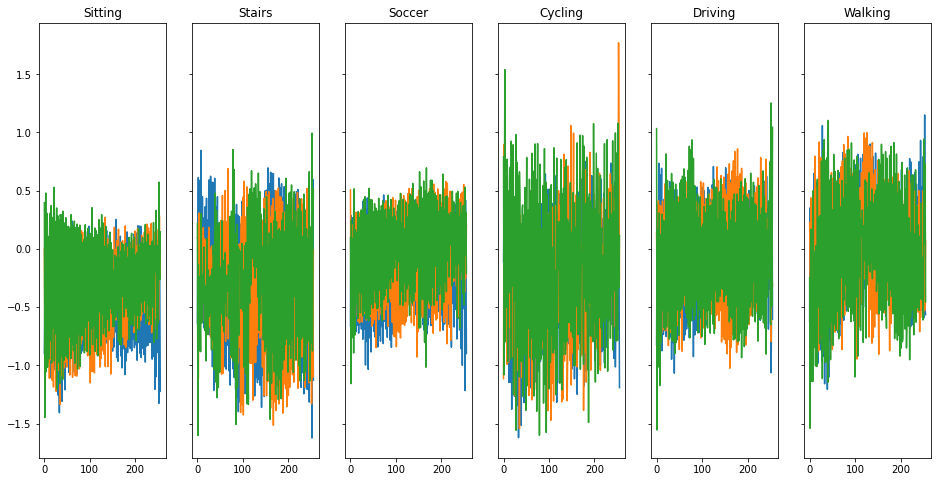

[[4000    0   84    0  433   54]
 [   1    0   45   11   60 3129]
 [  19    0 1766   48  356  123]
 [   0    0   36 3249  174   19]
 [ 262    0  269   18 6197   95]
 [  26    0  120    2  139 4409]]


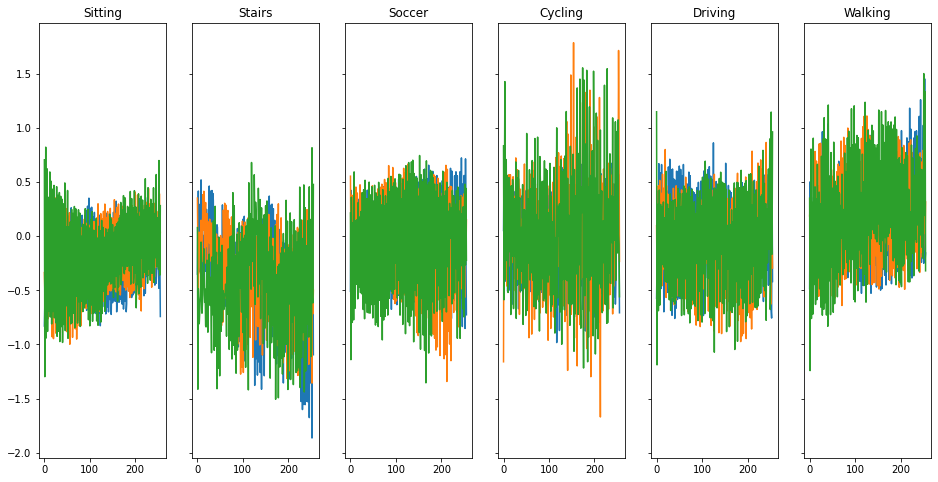

[[4186    0   31    0  323   31]
 [   8    0   42    9   58 3129]
 [  58    0 1814   36  300  104]
 [   0    0   45 3261  149   23]
 [ 344    0  245   17 6152   83]
 [  81    0   98    1  117 4399]]


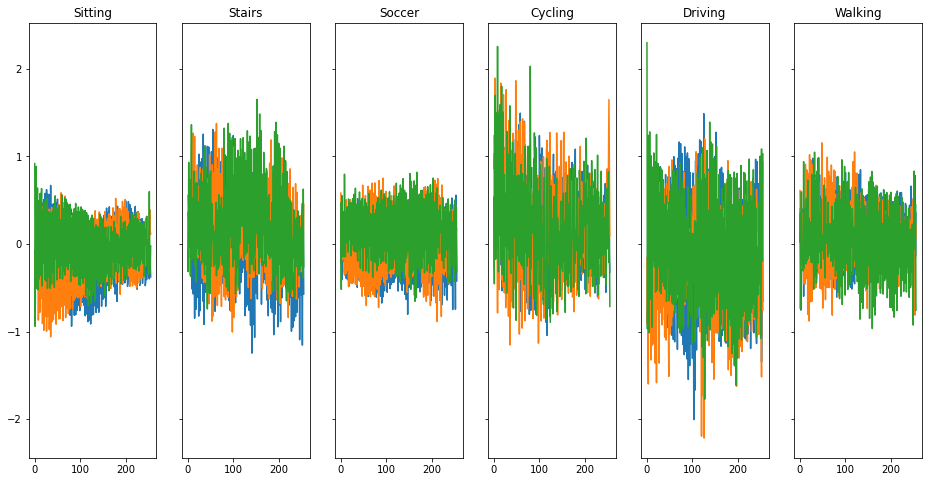

[[4185    0   37    0  313   36]
 [   3    0   22   13   63 3145]
 [  31    0 1736   54  392   99]
 [   1    0   39 3282  135   21]
 [ 290    0  241   41 6203   66]
 [  67    0   74    0  173 4382]]


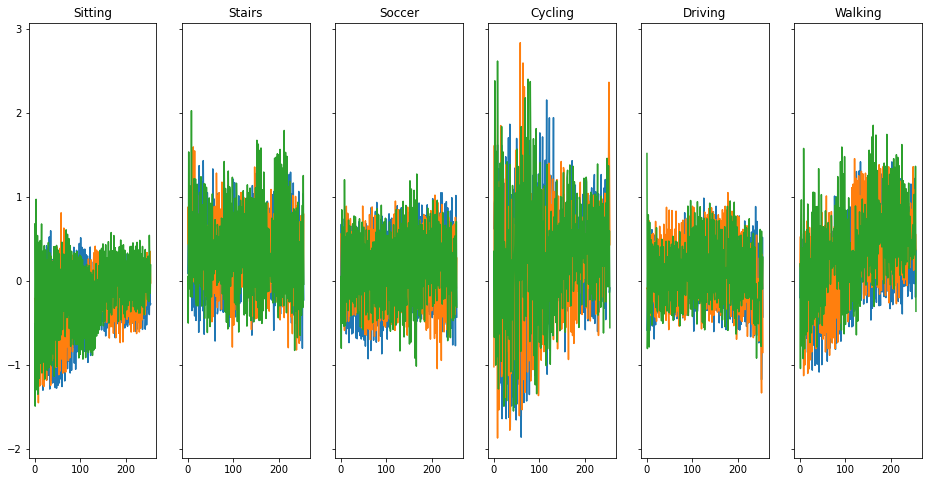

[[4150    0   29    0  354   38]
 [   3    0   21    4   69 3149]
 [  27    0 1805   52  279  149]
 [   0    0   46 3283  126   23]
 [ 219    0  251   23 6269   79]
 [  42    0  105    2  138 4409]]


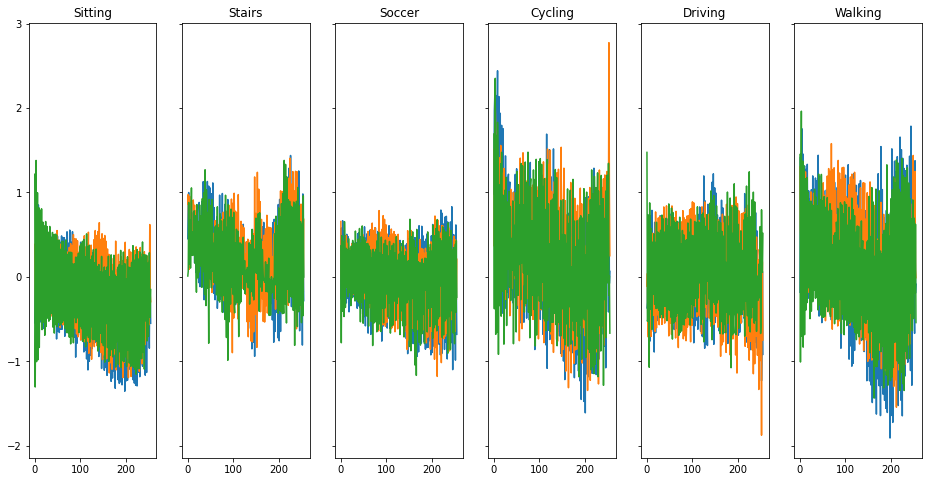

[[4143    0   52    0  344   32]
 [   6    0   26   13   70 3131]
 [  33    0 1754   50  336  139]
 [   0    0   38 3265  154   21]
 [ 268    0  250   23 6201   99]
 [  81    0   82    3  197 4333]]


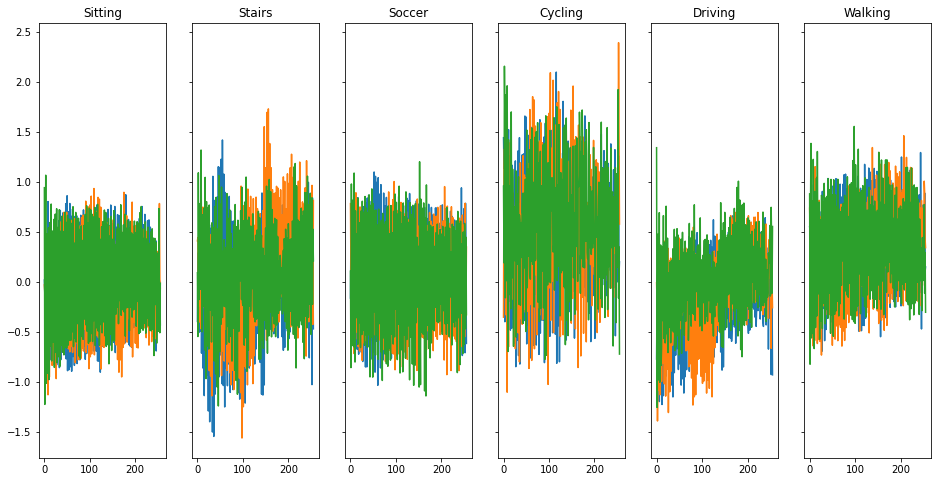

[[4185    0   37    0  315   34]
 [   4    0   30   10   64 3138]
 [  79    0 1829   39  259  106]
 [   0    0   59 3272  127   20]
 [ 249    0  268   33 6239   52]
 [  49    0  110    1  148 4388]]


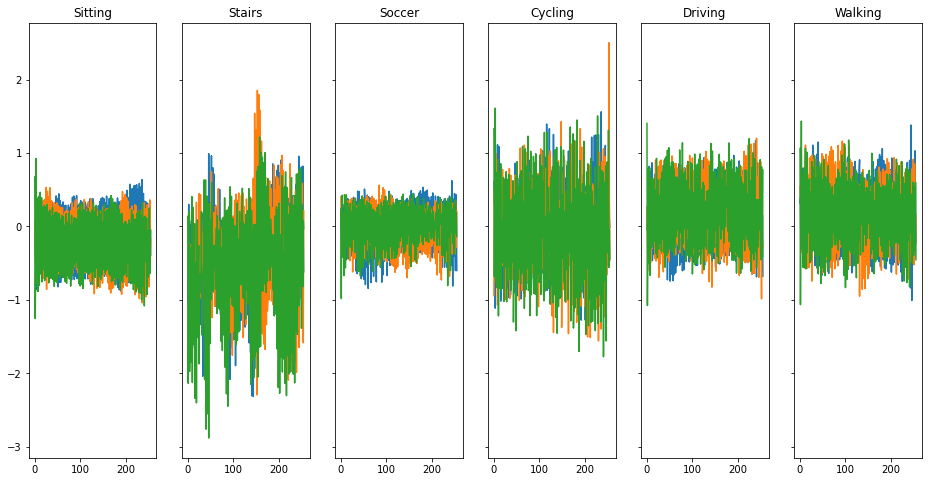

[[4065    0   54    1  417   34]
 [   6    1   30   14   58 3137]
 [  50    0 1849   51  229  133]
 [   0    0   37 3307  118   16]
 [ 254    0  291   36 6172   88]
 [  73    0  120    3  135 4365]]


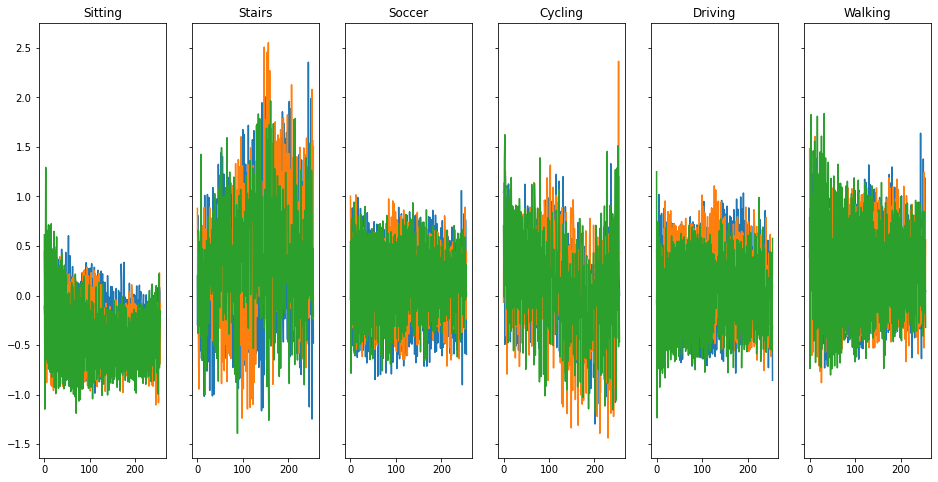

[[4131    0   41    0  357   42]
 [   2    0   28    7   35 3174]
 [  31    0 1774   31  295  181]
 [   0    0   50 3290  125   13]
 [ 246    0  273   27 6196   99]
 [  60    0   55    2   83 4496]]


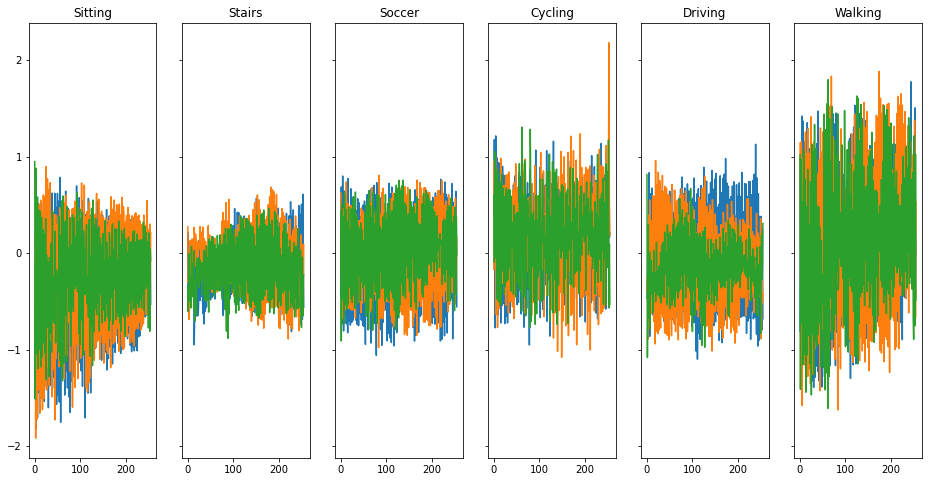

[[4182    0   48    0  305   36]
 [   2    0   51    9   55 3129]
 [  56    0 1835   45  278   98]
 [   1    0   43 3292  128   14]
 [ 242    0  238   29 6273   59]
 [  41    0   94    2  128 4431]]


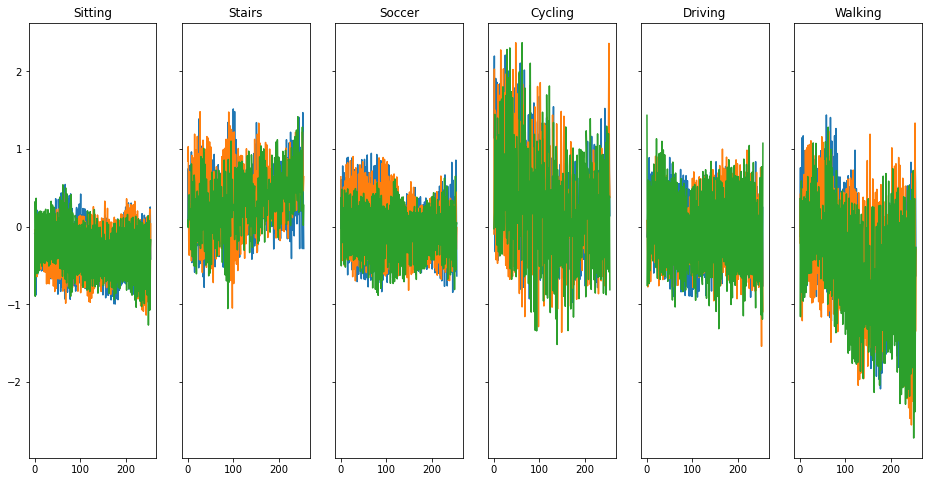

[[4094    0   75    0  364   38]
 [   4    0   17    3   55 3167]
 [  16    0 1833   35  285  143]
 [   0    0   43 3276  136   23]
 [ 201    0  271   15 6285   69]
 [  43    0   87    0  117 4449]]


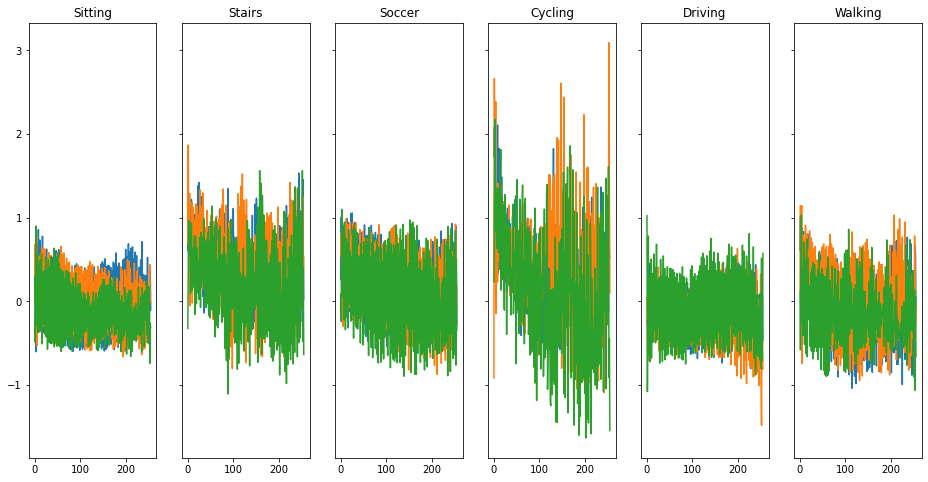

[[4169    0   51    0  308   43]
 [   2    0   33    5   42 3164]
 [  21    0 1880   33  260  118]
 [   0    0   41 3300  118   19]
 [ 231    0  287   21 6225   77]
 [  38    0  108    0   90 4460]]


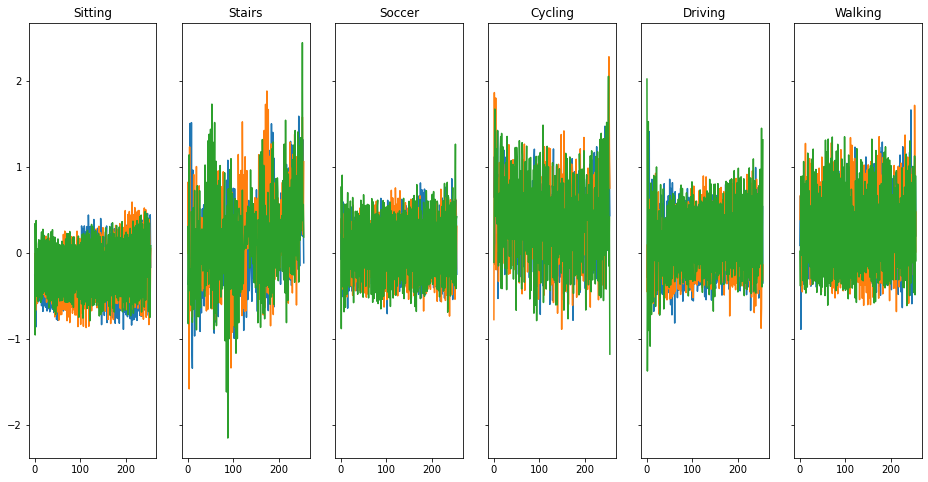

[[4189    0   37    0  308   37]
 [   2    0   45    8   50 3141]
 [  29    0 1882   25  291   85]
 [   0    0   38 3319  113    8]
 [ 268    0  270   22 6220   61]
 [  53    0   97    2   97 4447]]


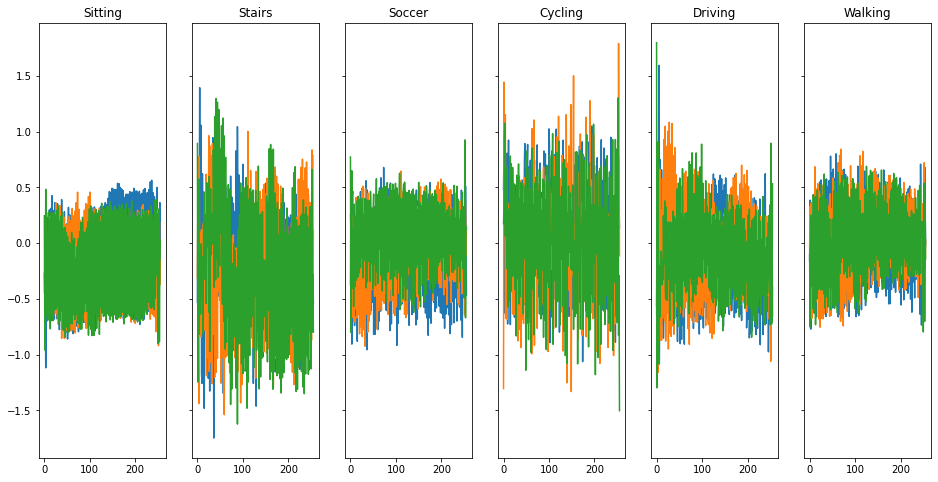

[[4134    0   47    0  354   36]
 [  13    1   43    8   46 3135]
 [  42    0 1837   26  297  110]
 [   0    0   36 3256  178    8]
 [ 204    0  252   13 6293   79]
 [  57    0   78    7  136 4418]]


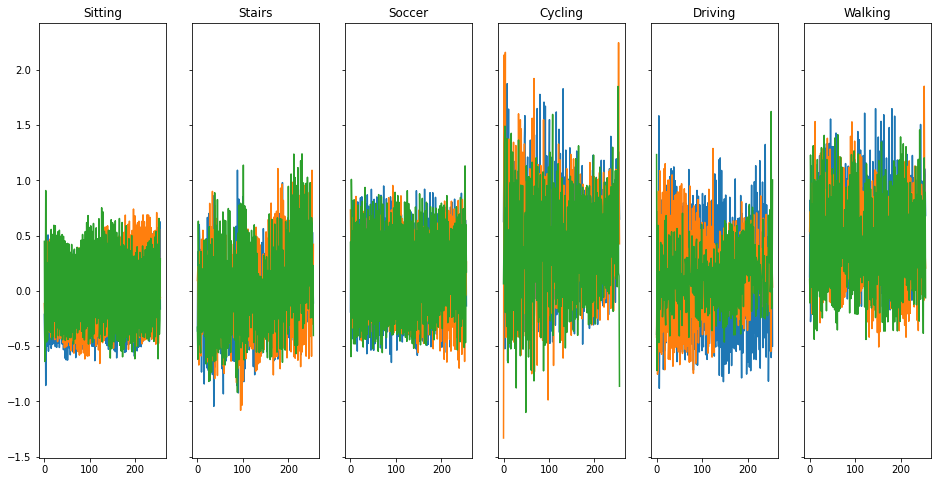

[[4100    0   52    0  391   28]
 [   4    0   36   13   54 3139]
 [  18    0 1795   43  325  131]
 [   1    0   36 3290  142    9]
 [ 171    0  278   31 6287   74]
 [  49    0   79    3  176 4389]]


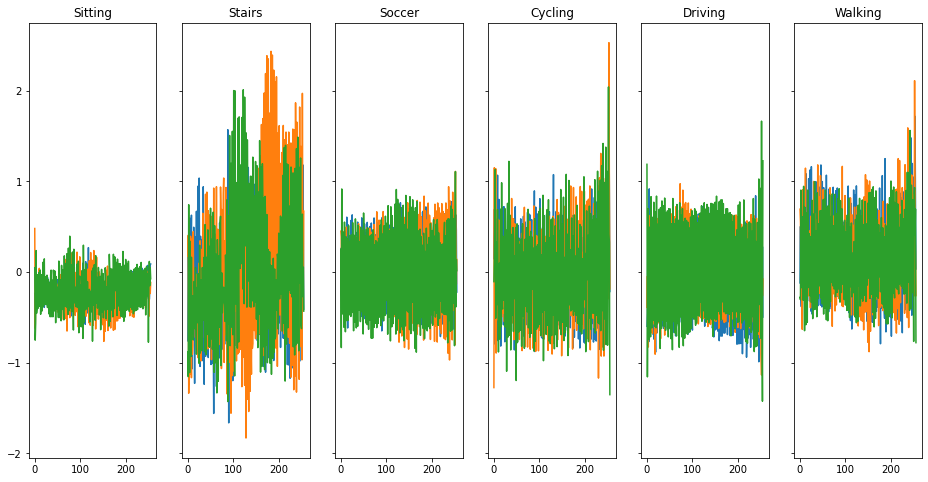

[[4083    0   71    0  370   47]
 [   4    0   61   11   42 3128]
 [  61    0 1904   32  211  104]
 [   8    0   48 3245  170    7]
 [ 261    0  339   13 6148   80]
 [  29    0   87    3   97 4480]]


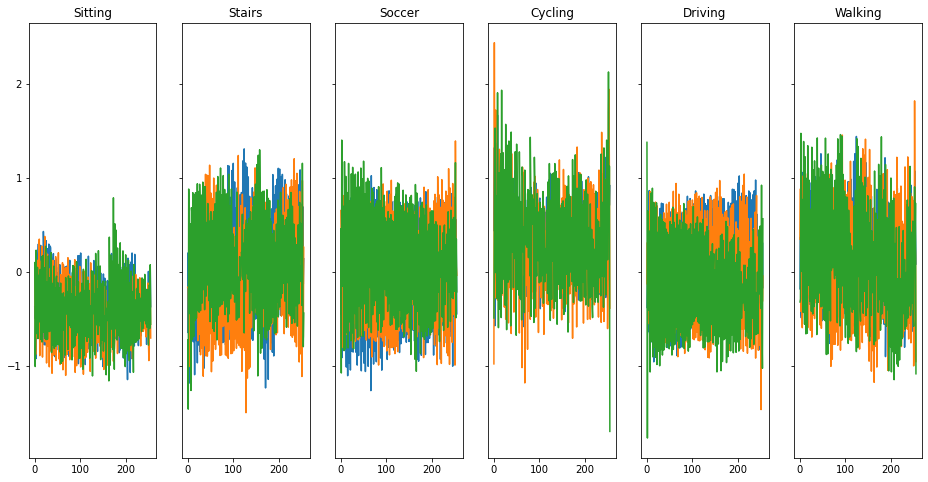

[[4176    0   54    0  304   37]
 [   2    0   29   10   37 3168]
 [  16    0 1841   48  286  121]
 [   0    0   35 3279  151   13]
 [ 262    0  277   41 6178   83]
 [  55    0   76    4   98 4463]]


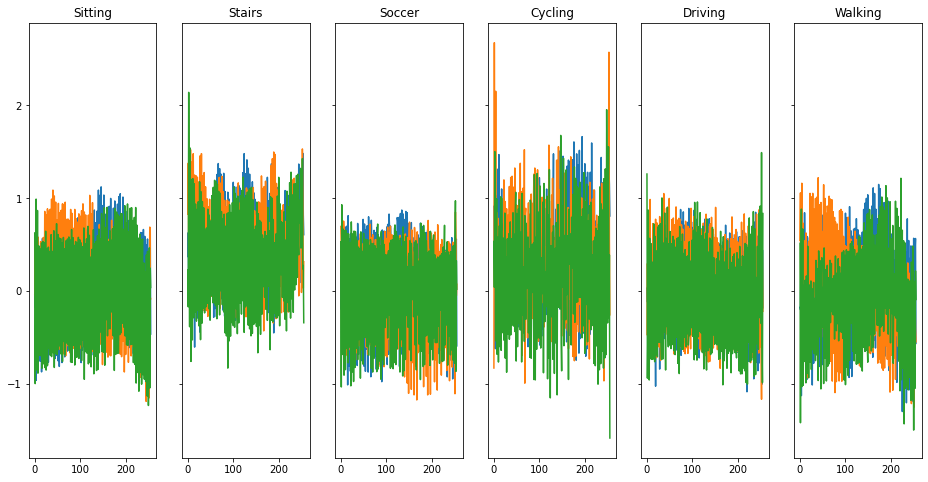

[[4154    0   68    0  311   38]
 [   1    0   48    8   37 3152]
 [  16    0 1924   37  213  122]
 [   0    0   41 3269  159    9]
 [ 227    0  330   26 6168   90]
 [  45    0   89    1   74 4487]]


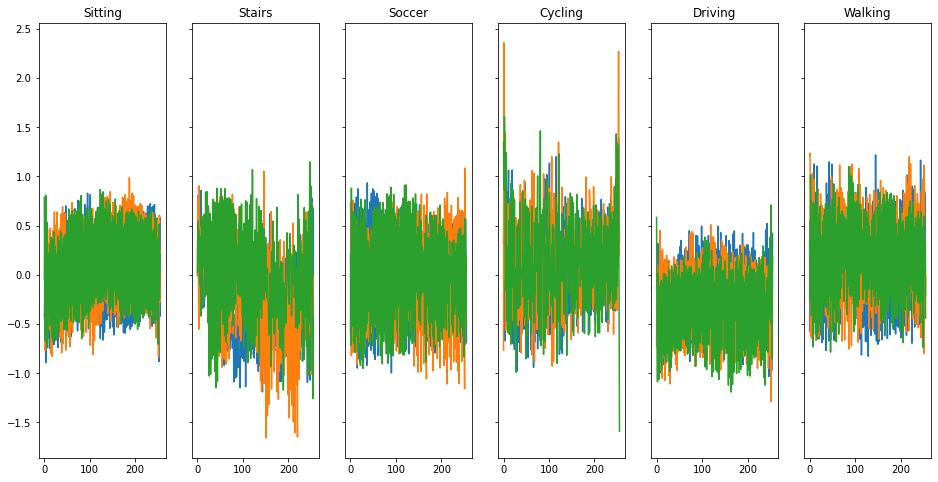

[[4159    0   47    0  312   53]
 [   3    0   22   10   36 3175]
 [  35    0 1850   25  289  113]
 [   1    0   39 3268  160   10]
 [ 254    0  233   52 6220   82]
 [  48    0   94    2  106 4446]]


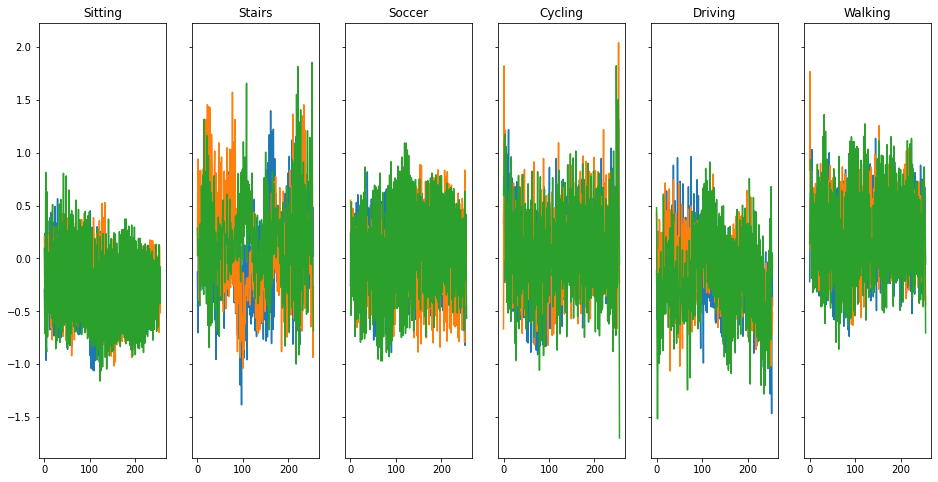

[[4198    0   66    0  267   40]
 [   1    2   65    6   38 3134]
 [  34    0 1976   33  174   95]
 [   0    0   34 3297  137   10]
 [ 279    0  304   22 6155   81]
 [  49    1   84    2   77 4483]]


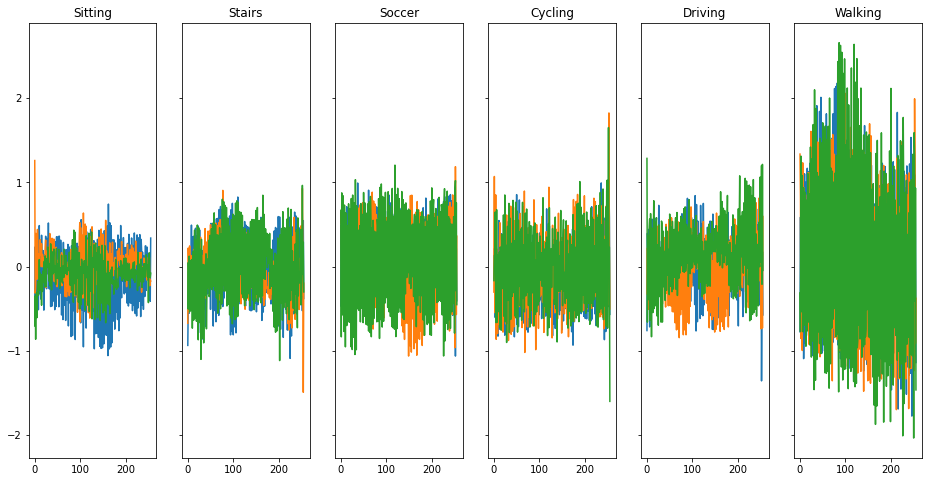

[[4214    0   39    0  285   33]
 [   5    2   34    6   48 3151]
 [  49    0 1913   31  249   70]
 [   0    0   30 3331  109    8]
 [ 226    0  183   24 6362   46]
 [  79    0  100    1  111 4405]]


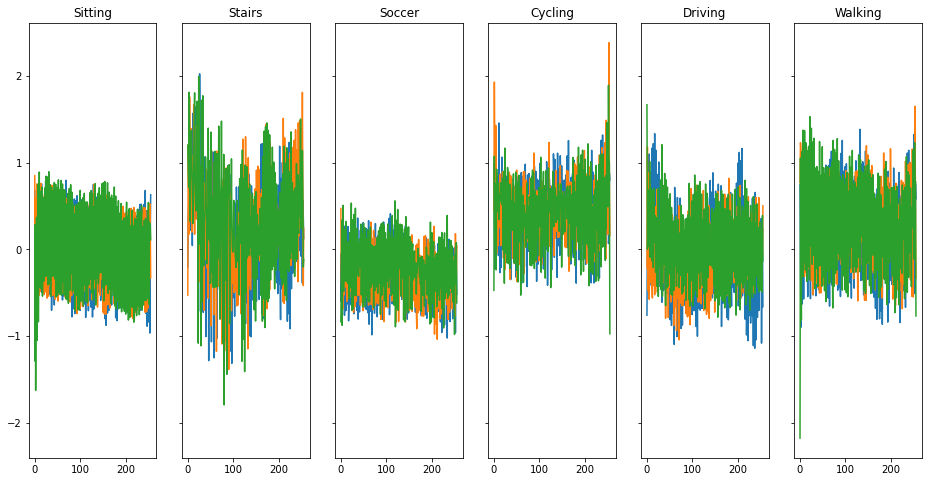

[[4167    0   47    0  318   39]
 [   2    0   14    7   39 3184]
 [  19    0 1885   21  288   99]
 [   1    0   31 3292  142   12]
 [ 242    0  231   18 6290   60]
 [  34    0   87    1   99 4475]]


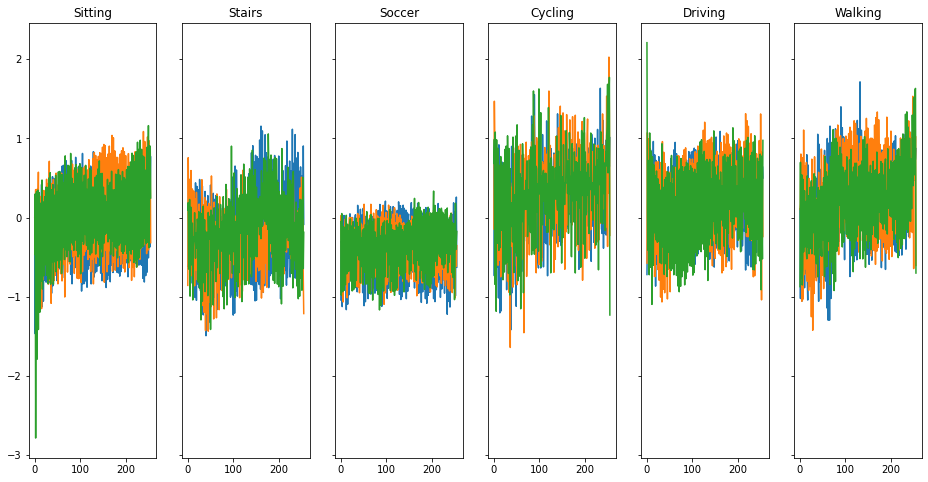

[[4147    0   24    0  353   47]
 [   4    0   36    8   30 3168]
 [  44    0 1813   26  318  111]
 [   1    0   38 3314  117    8]
 [ 201    0  171   15 6365   89]
 [  46    0   64    1   87 4498]]


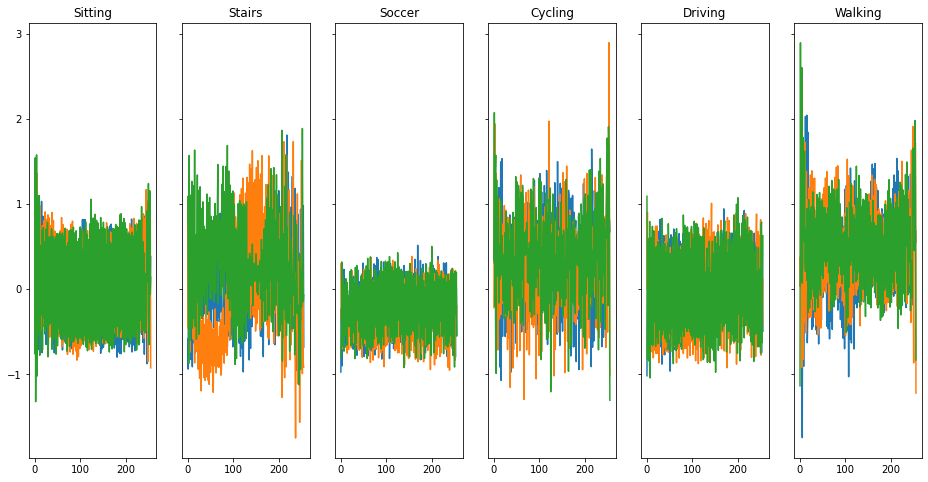

[[4089    1   36    0  403   42]
 [  13    1   33    7   54 3138]
 [  33    4 1924   32  229   90]
 [   0    0   35 3326  112    5]
 [ 206    1  180   25 6374   55]
 [  73    0   74    1   94 4454]]


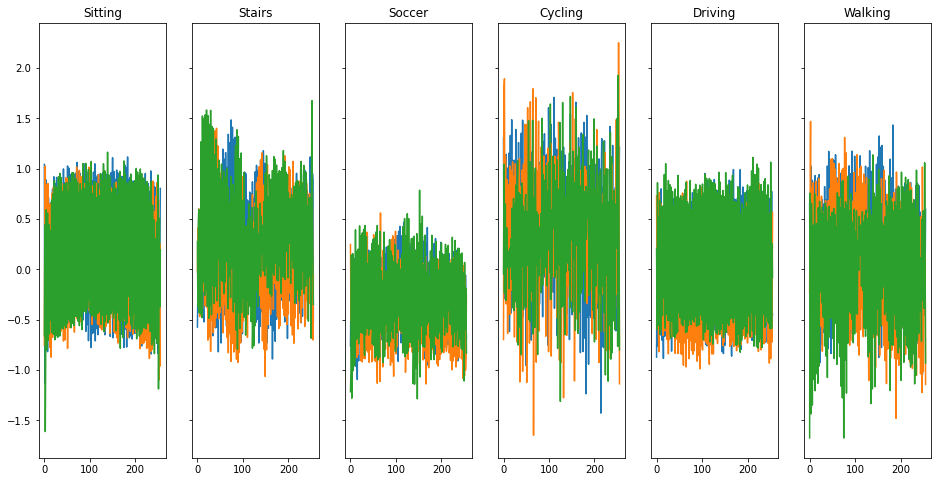

[[4192    0   34    0  310   35]
 [   2    4   21    4   39 3176]
 [  22    0 1937   28  239   86]
 [   0    0   31 3321  115   11]
 [ 193    0  189   18 6364   77]
 [  65    0   50    1   62 4518]]


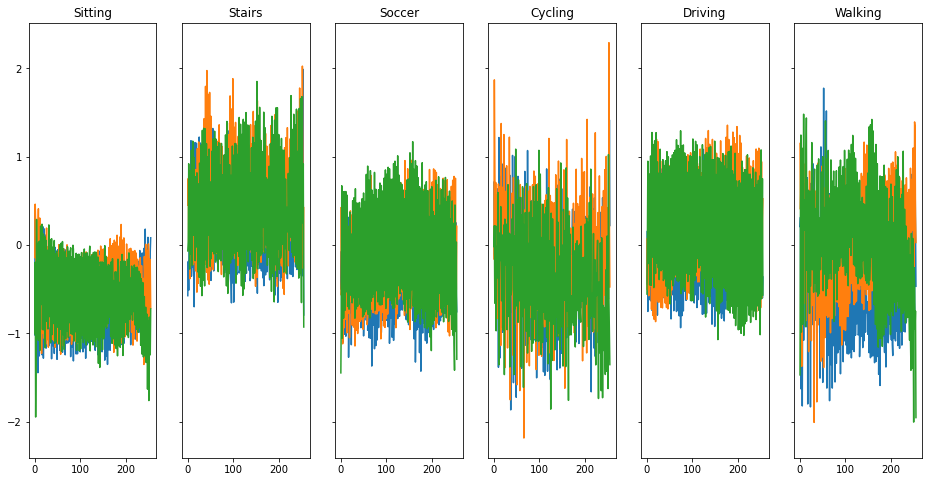

[[4249    0   45    0  244   33]
 [   3    1   23    4   50 3165]
 [  36    0 1941   20  239   76]
 [   0    1   30 3329  107   11]
 [ 262    0  194    9 6347   29]
 [  62    0   57    0  114 4463]]


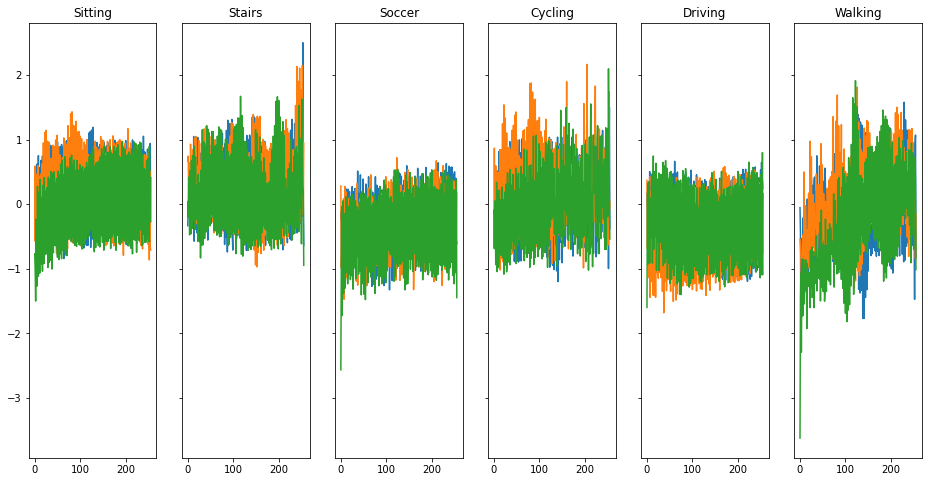

[[4214    0   50    0  273   34]
 [   1    1   40    5   30 3169]
 [  27    0 1942   24  243   76]
 [   0    0   20 3355   94    9]
 [ 208    0  216   13 6345   59]
 [  40    1   86    0   64 4505]]


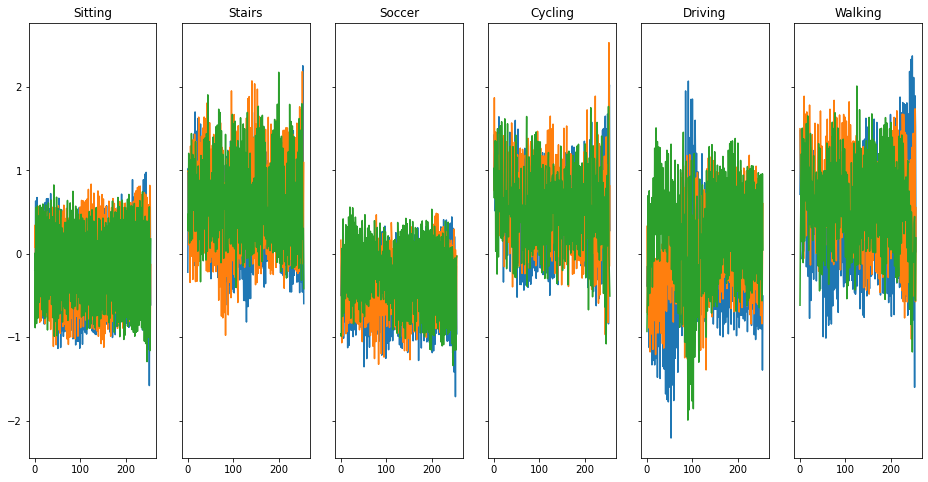

[[4210    0   54    0  254   53]
 [   2    0   26    9   39 3170]
 [  37    0 1918   34  239   84]
 [   0    0   22 3335  110   11]
 [ 199    0  203   15 6368   56]
 [  41    0   62    1   60 4532]]


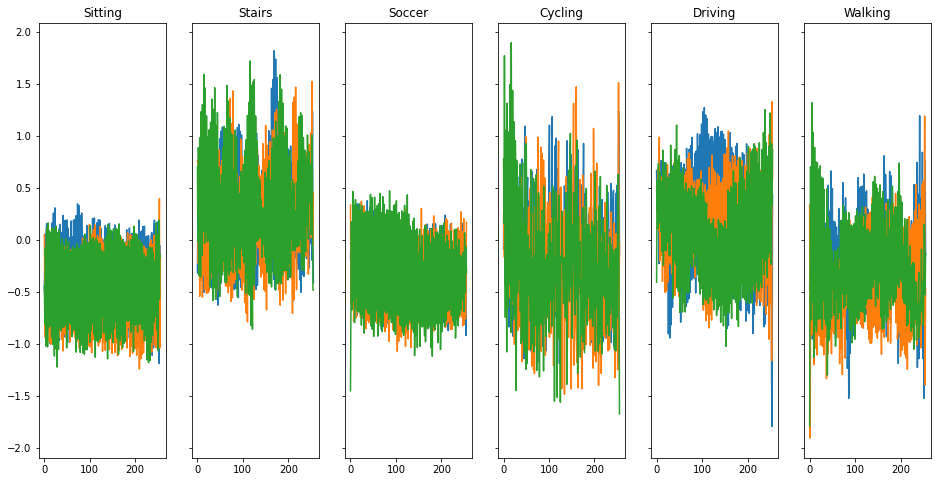

[[4248    0   33    0  251   39]
 [   3    0   23    6   51 3163]
 [  24    3 1970   37  190   88]
 [   0    1   25 3350   93    9]
 [ 204    0  179   26 6399   33]
 [  55    0   77    0  107 4457]]


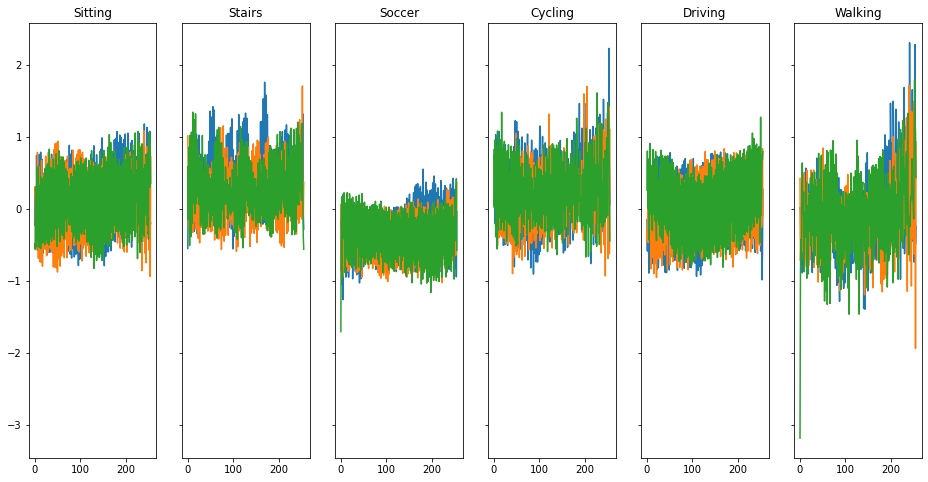

[[4231    0   53    0  249   38]
 [   3    0   25    9   36 3173]
 [  36    0 1941   17  230   88]
 [   0    0   35 3349   84   10]
 [ 206    0  189   13 6385   48]
 [  64    0   77    0   66 4489]]


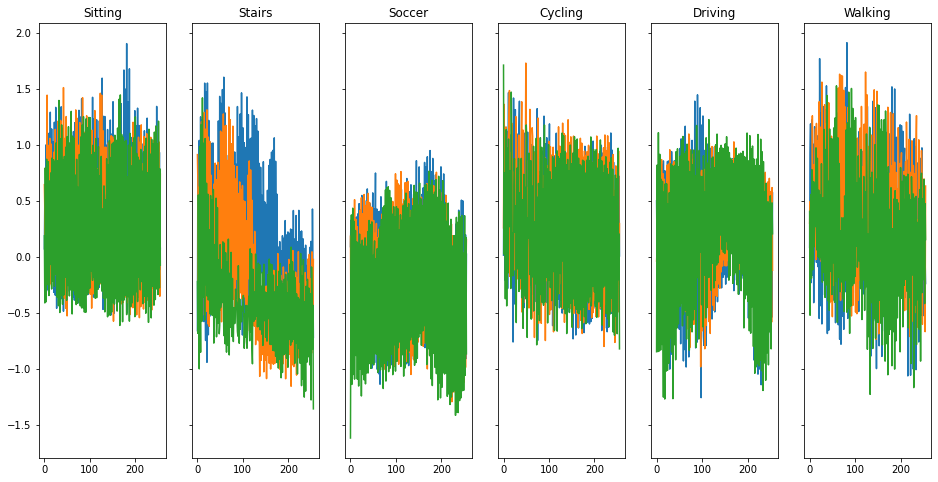

[[4277    0   28    0  228   38]
 [   6    0   19   12   41 3168]
 [  77    0 1889   28  225   93]
 [   0    0   22 3345  101   10]
 [ 389    0  181   19 6196   56]
 [  85    0   39    1   53 4518]]


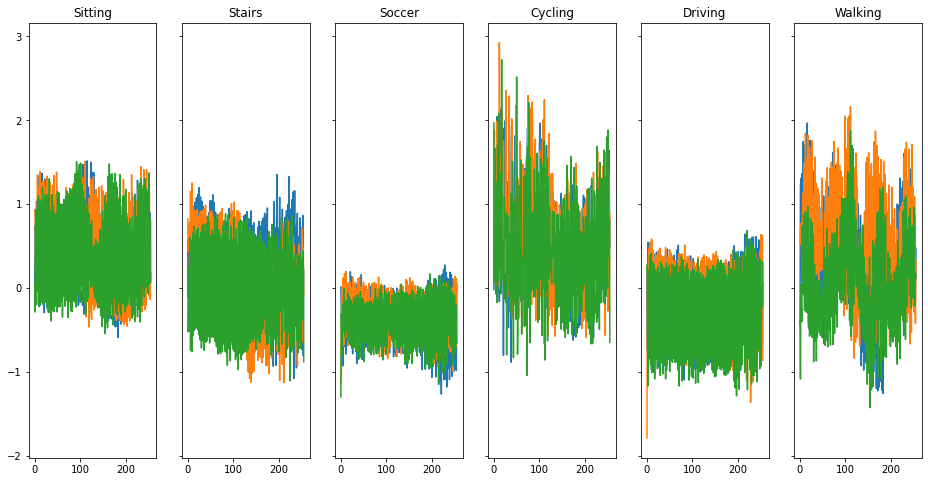

[[4265    0   43    0  222   41]
 [   0    4   42    4   43 3153]
 [  27    0 1998   18  215   54]
 [   0    1   38 3375   60    4]
 [ 220    0  188   19 6380   34]
 [  46    2   67    0   55 4526]]


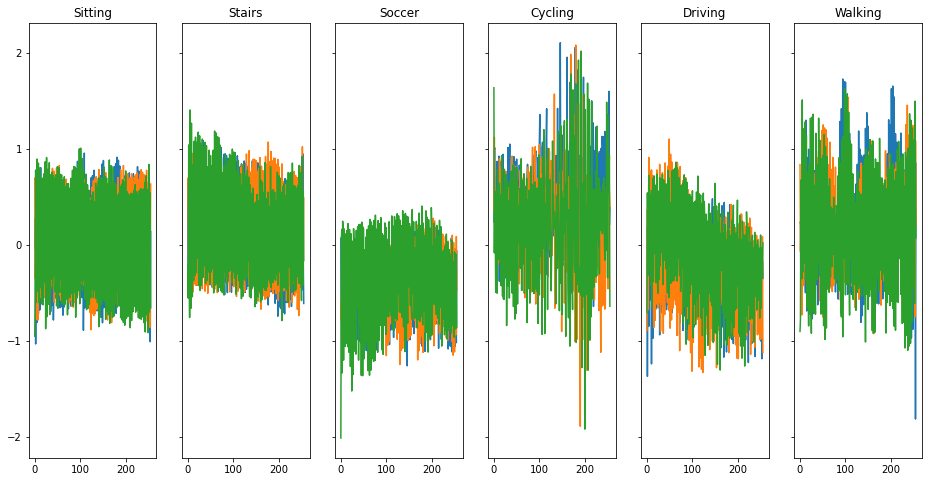

[[4263    0   27    0  245   36]
 [   2    1   20    4   44 3175]
 [  29    0 1941   31  234   77]
 [   0    0   26 3362   83    7]
 [ 198    0  169   16 6424   34]
 [  67    0   57    0   71 4501]]


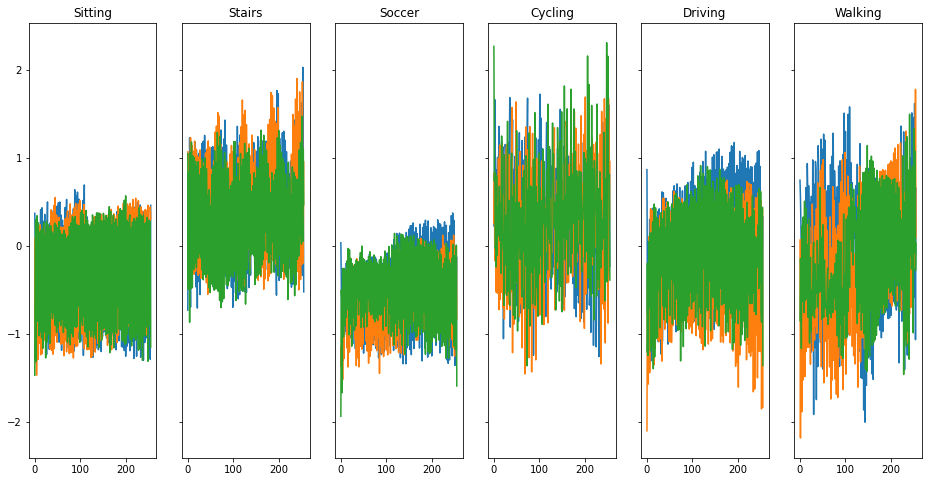

[[4246    0   28    0  263   34]
 [   3    2   17    6   30 3188]
 [  44    0 1949   20  227   72]
 [   0    0   24 3386   64    4]
 [ 217    0  131   15 6437   41]
 [  60    0   52    0   31 4553]]


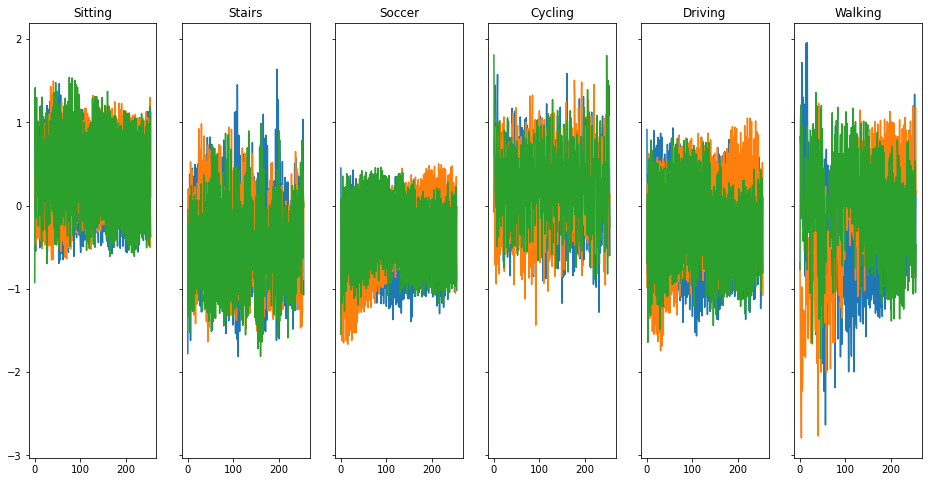

[[4234    0   54    1  249   33]
 [  14    3   21    4   49 3155]
 [  34    5 1899   43  226  105]
 [   1    1   16 3368   85    7]
 [ 227    1  177   24 6341   71]
 [  67    0   71    0   82 4476]]


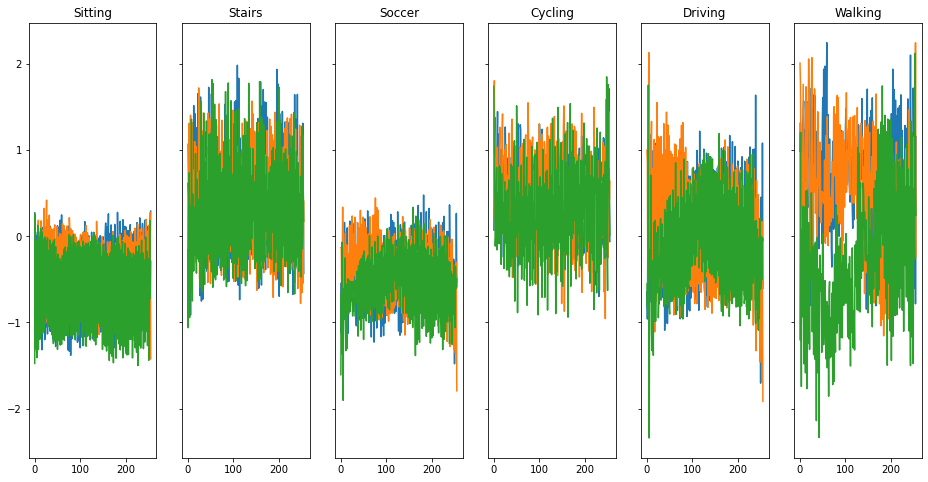

[[4249    0   37    0  245   40]
 [   2    4   30    9   36 3165]
 [  31    0 1954   19  236   72]
 [   1    0   25 3365   85    2]
 [ 184    0  117   11 6501   28]
 [  55    2   51    2   54 4532]]


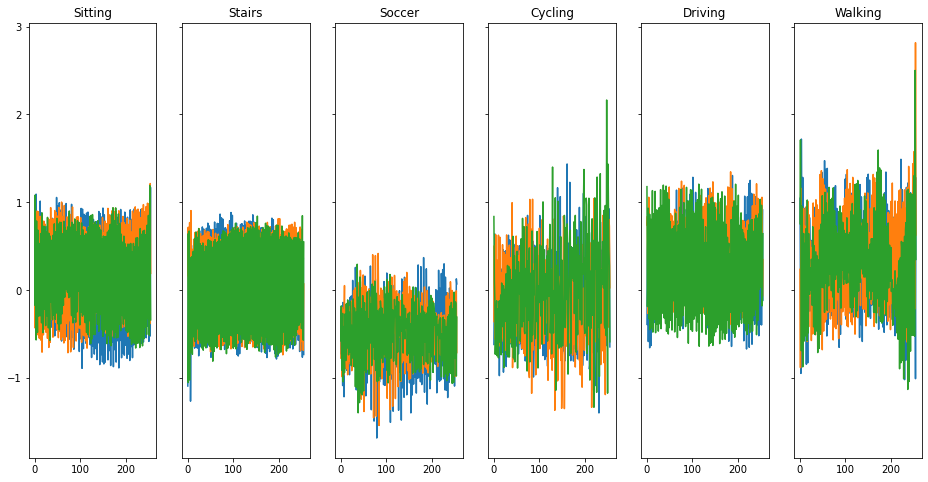

[[4276    0   33    0  226   36]
 [   3   30   30    2   35 3146]
 [  31    1 1982   16  213   69]
 [   0    1   33 3387   53    4]
 [ 145    1  158   19 6470   48]
 [  41   10   50    0   43 4552]]


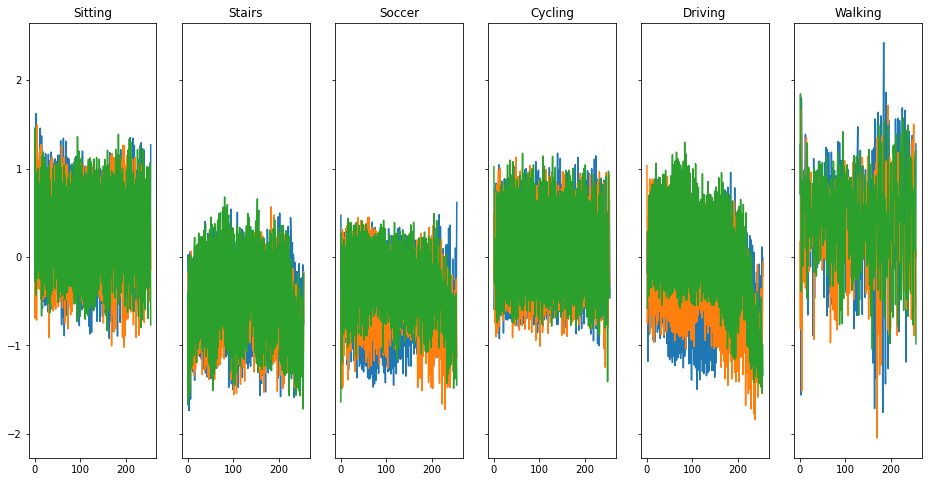

[[4242    0   43    0  244   42]
 [   2    6   30    6   33 3169]
 [  27    0 2006   13  185   81]
 [   0    1   25 3393   55    4]
 [ 206    0  159   16 6401   59]
 [  49    2   63    0   49 4533]]


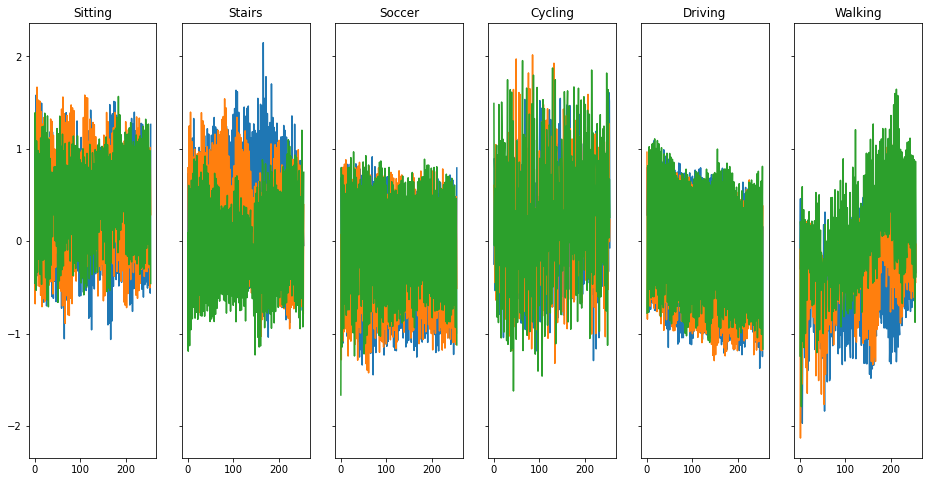

[[4350    0   22    0  163   36]
 [   5   13   23    5   40 3160]
 [  47    3 2017   18  163   64]
 [   0    1   23 3390   55    9]
 [ 205    0  144   19 6445   28]
 [  64    1   56    0   46 4529]]


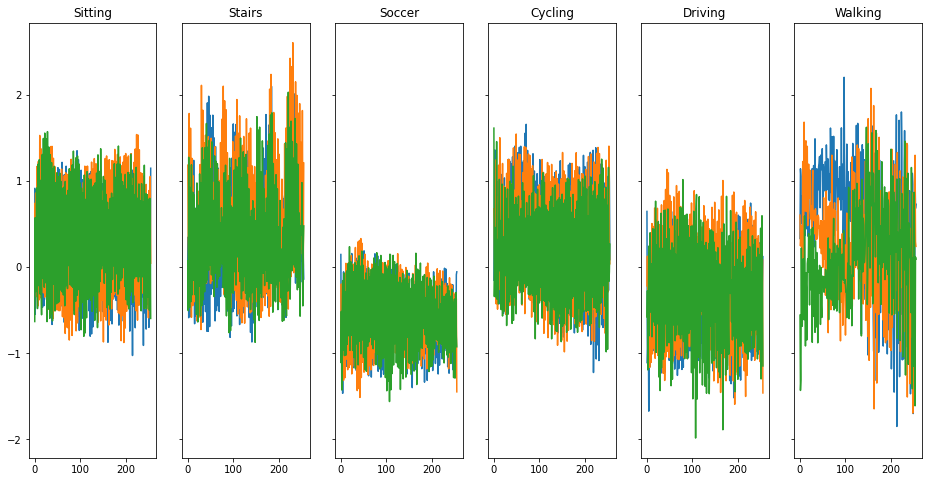

[[4235    0   27    0  270   39]
 [   2   10   28    4   36 3166]
 [  37    1 1946   16  235   77]
 [   0    1   20 3379   76    2]
 [ 253    0  157   15 6382   34]
 [  79    2   49    1   39 4526]]


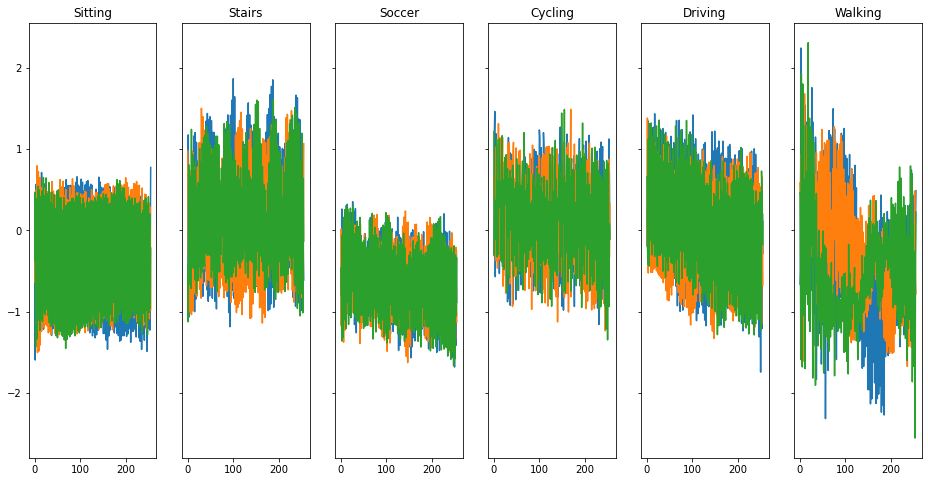

[[4286    0   42    0  206   37]
 [   4   12   38    7   50 3135]
 [  37    2 1992   16  217   48]
 [   0    1   29 3373   70    5]
 [ 154    0  134   15 6520   18]
 [  47    9   64    0   58 4518]]


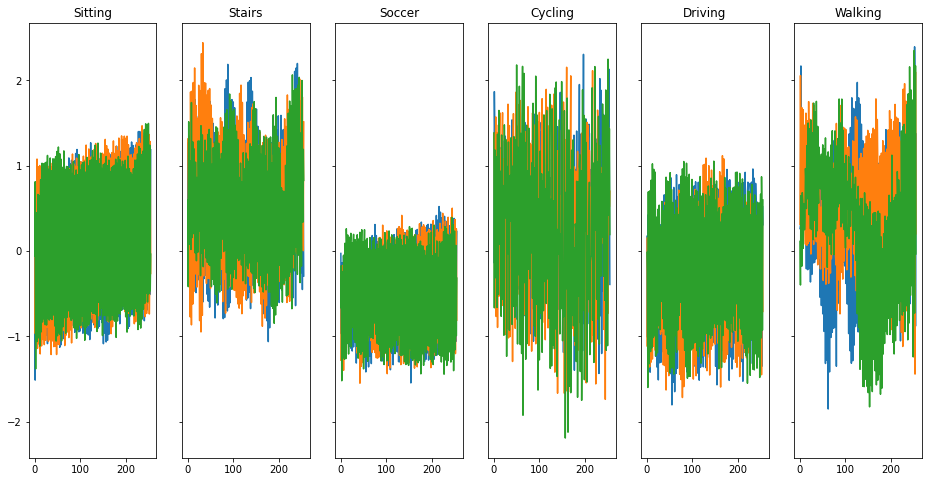

[[4309    0   26    0  199   37]
 [   4   11   24    6   32 3169]
 [  35    0 2042   10  157   68]
 [   0    2   26 3391   57    2]
 [ 188    1  207    9 6409   27]
 [  47    2   50    0   33 4564]]


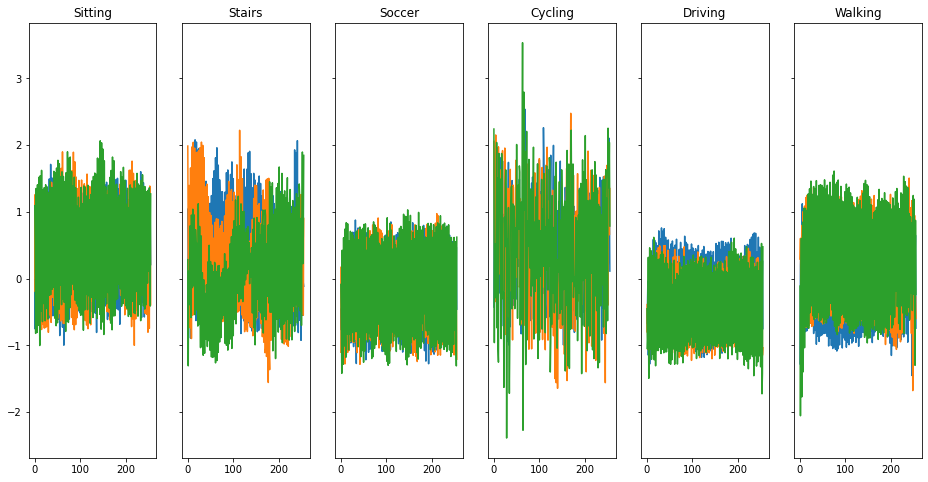

[[4322    0   33    0  179   37]
 [   3   22   15    6   36 3164]
 [  26    5 2036   18  177   50]
 [   0    3   19 3395   59    2]
 [ 198    2  144   16 6466   15]
 [  73    1   46    0   49 4527]]


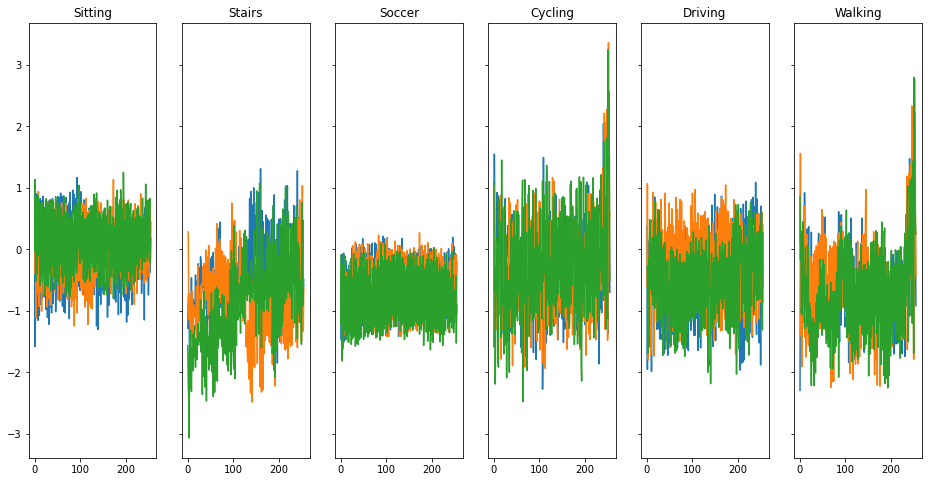

[[4282    0   54    0  196   39]
 [   1   22   20    5   35 3163]
 [  22    6 2075   16  139   54]
 [   0    3   15 3393   62    5]
 [ 135    2  154   10 6516   24]
 [  48    3   56    0   39 4550]]


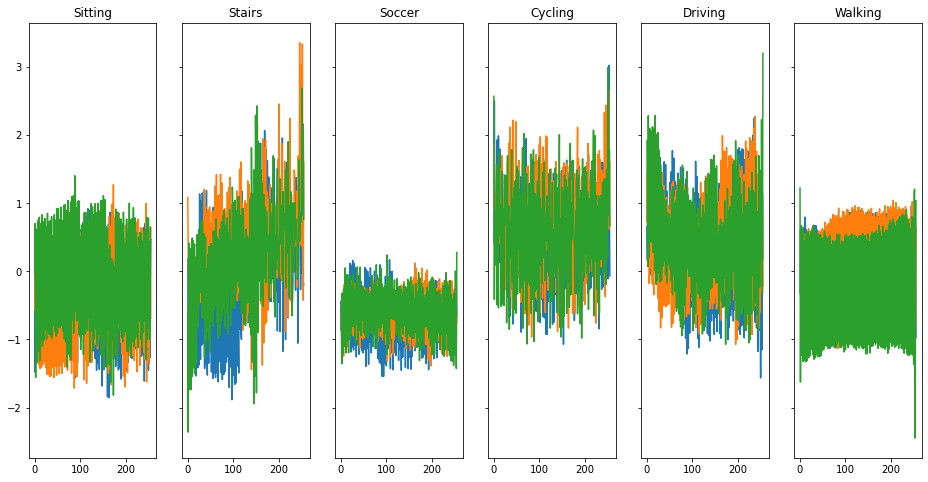

[[3716    0   32    0  757   66]
 [   4   83   18    5   50 3086]
 [  13   15 1844   35  341   64]
 [   0    6    8 3425   38    1]
 [  51    5  119   26 6625   15]
 [  23   15   39    0  123 4496]]


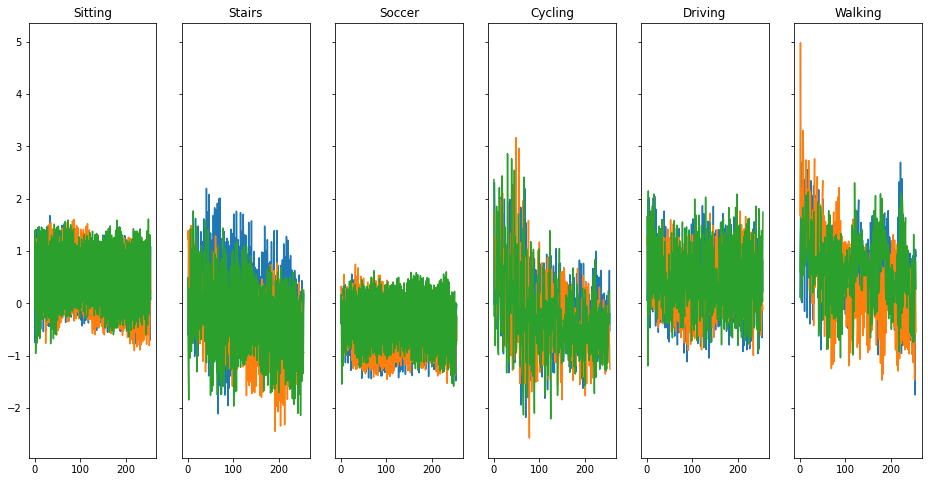

[[1467   11   35    0 2600  458]
 [  15   82   43    3   97 3006]
 [ 361   23 1123    8  568  229]
 [ 241    3   29 3005  155   45]
 [1704   15  194    6 4684  238]
 [  19  106   61    0  505 4005]]


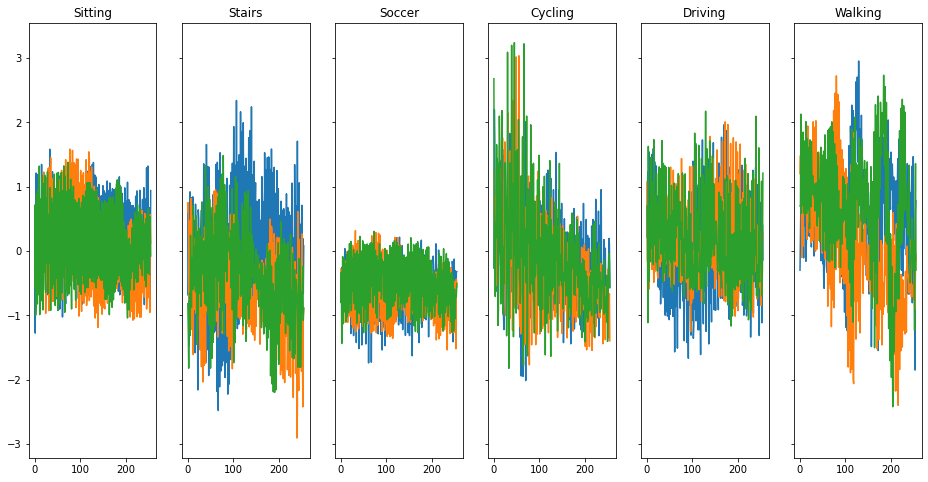

[[1740    0   13    0 2627  191]
 [ 208    0  248    8  184 2598]
 [  93    0 1282   45  398  494]
 [ 218    0   29 2504  534  193]
 [2073    0  186   17 4012  553]
 [ 336    0  481   13  892 2974]]


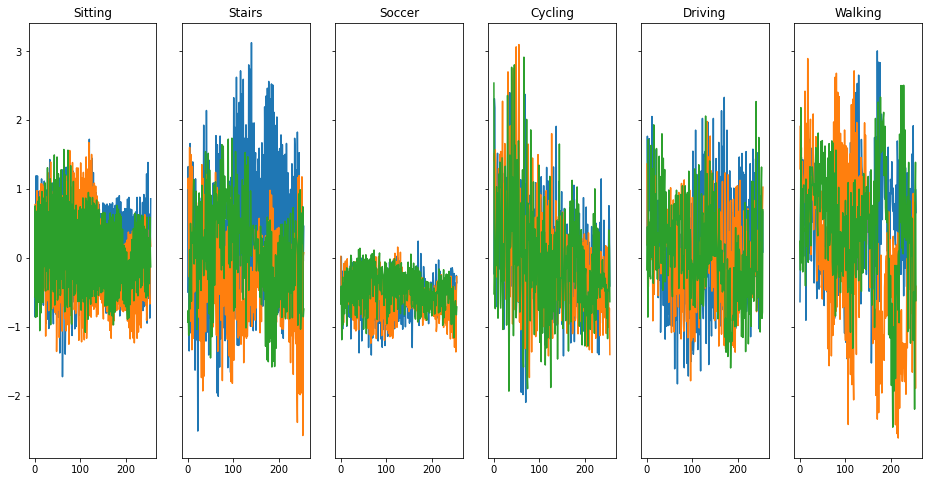

[[1664    0    4   65 2795   43]
 [ 723    1   42   52  544 1884]
 [ 653    0  719   42  791  107]
 [2061    0   31 1194  190    2]
 [1818    0   60  175 4693   95]
 [ 992    0  138   24 1641 1901]]


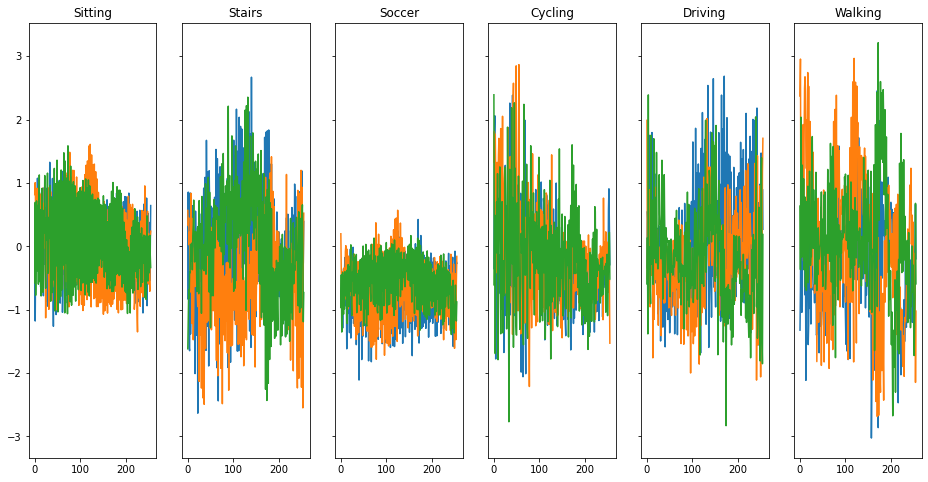

[[3638    0   15   21  833   64]
 [ 494    0  112    2  144 2494]
 [ 700    1  989   16  485  121]
 [1012    0   61 2102  296    7]
 [1754    0  103    6 4899   79]
 [1001    0  242    7  591 2855]]


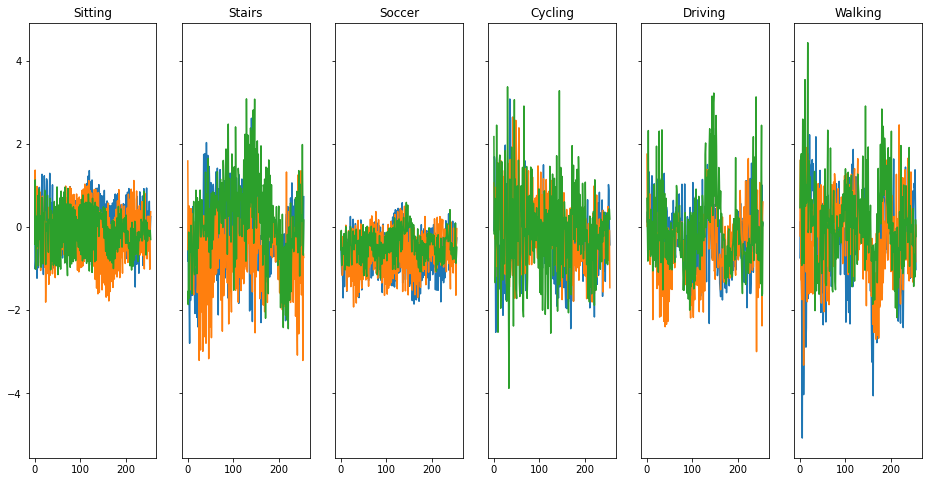

[[4192    0   41    0  290   48]
 [   2    1   36    7   33 3167]
 [  31    0 1903   24  261   93]
 [   0    0   32 3348   90    8]
 [ 270    0  165   19 6331   56]
 [  33    0   75    1   52 4535]]


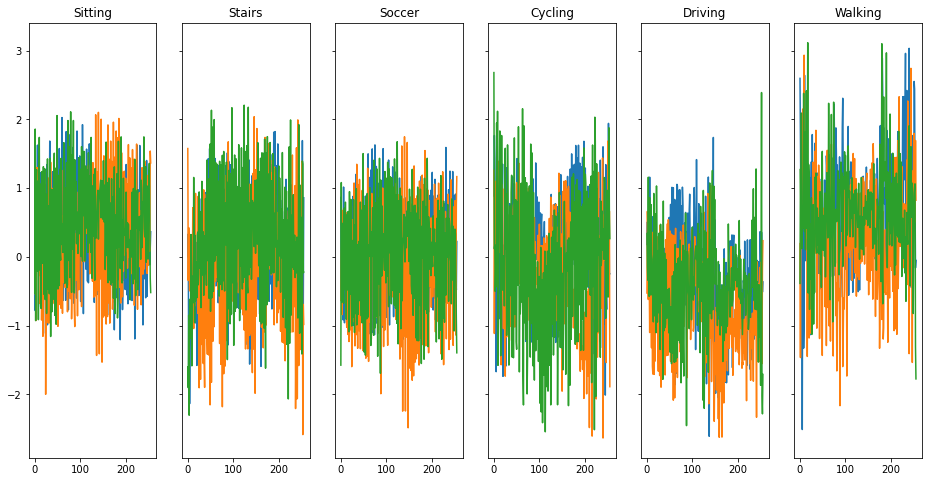

[[4310    0   35    0  189   37]
 [   2    6   26   10   39 3163]
 [  34    0 2045   14  167   52]
 [   0    0   23 3372   77    6]
 [ 179    0  154   15 6470   23]
 [  28    0   66    0   48 4554]]


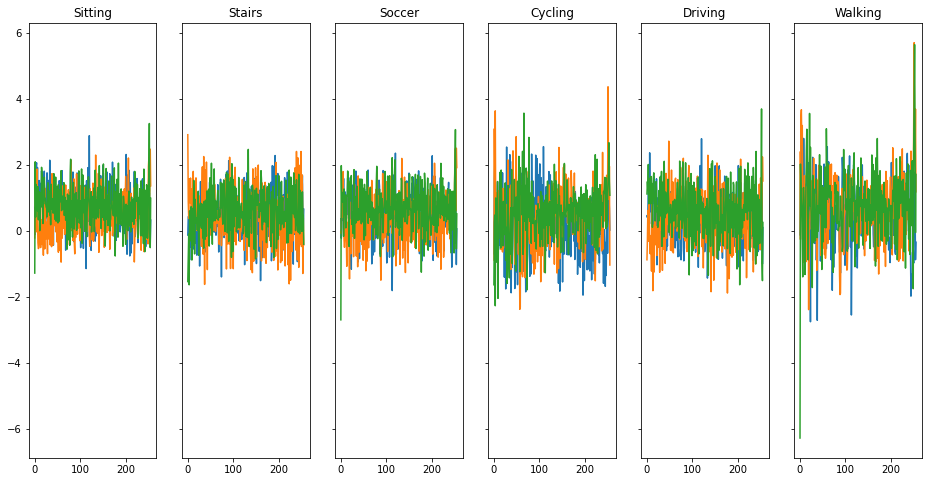

[[4319    0   34    0  179   39]
 [   1   35   18    3   31 3158]
 [  32    1 2076   11  139   53]
 [   0    2   19 3371   79    7]
 [ 144    0  144    7 6521   25]
 [  39    1   53    0   35 4568]]


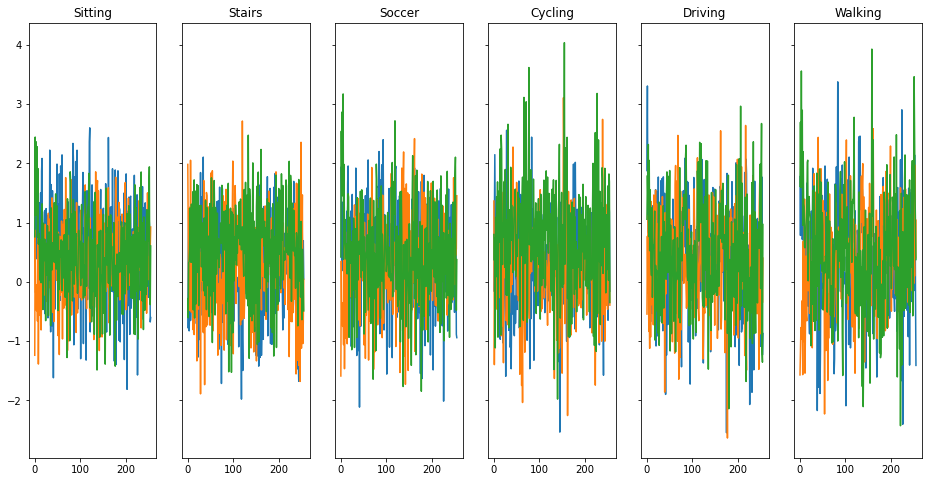

[[4347    2   28    0  160   34]
 [   5   82   16    2   47 3094]
 [  37    7 2050   11  159   48]
 [   0    4   15 3403   53    3]
 [ 172    1  104   15 6525   24]
 [  50   11   46    0   32 4557]]


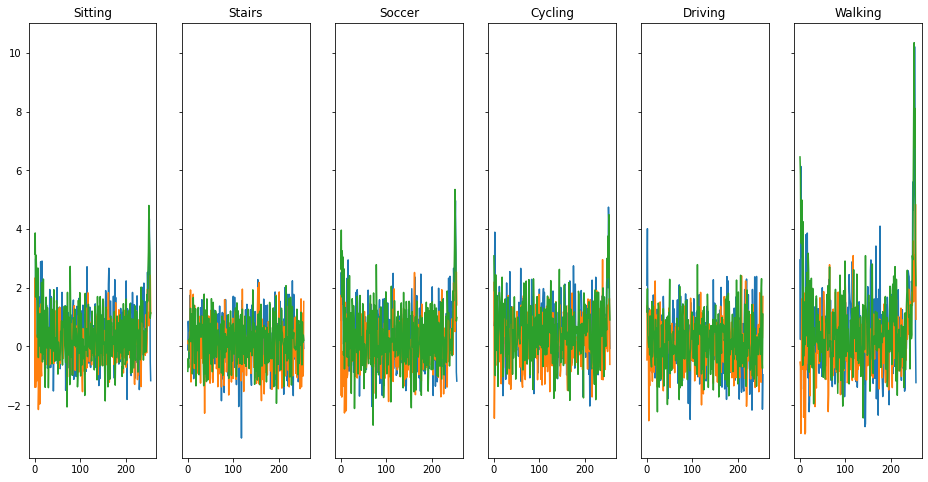

[[4350    2   39    0  152   28]
 [   3   68   22    8   33 3112]
 [  36    0 2061   13  162   40]
 [   0    2   29 3402   43    2]
 [ 174    0   90   11 6550   16]
 [  51   10   41    0   37 4557]]


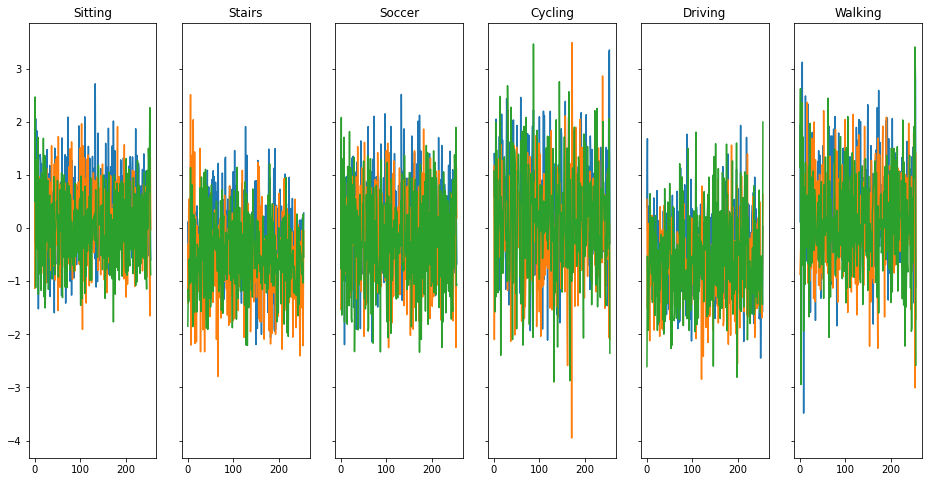

[[4367    8   22    0  146   28]
 [   4  219   17    3   38 2965]
 [  36    7 2073   11  148   37]
 [   0    3   20 3402   51    2]
 [ 130    1  113   12 6575   10]
 [  48   27   45    0   32 4544]]


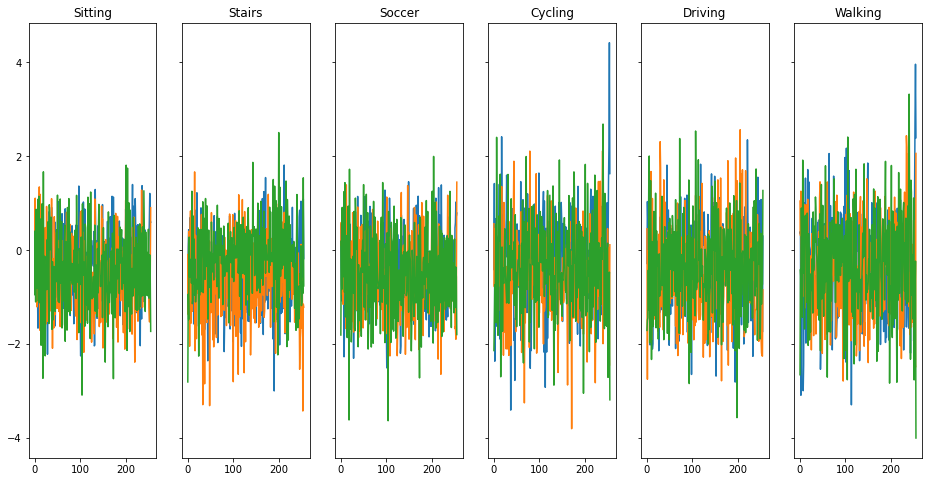

[[4330    5   32    0  176   28]
 [   1  283   18    3   40 2901]
 [  22    7 2139    9  104   31]
 [   0    2   16 3409   50    1]
 [ 103    3  105    6 6612   12]
 [  29   55   45    0   38 4529]]


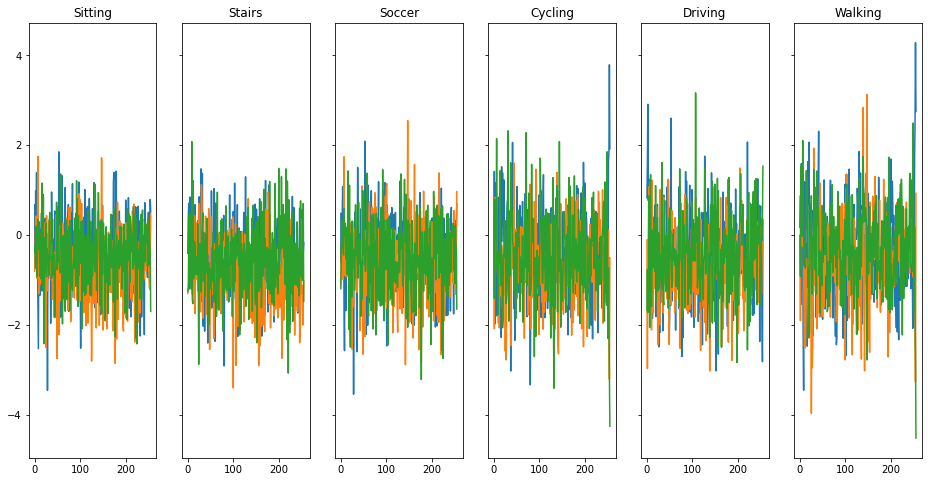

[[4331    3   39    0  163   35]
 [   0  267   15    6   24 2934]
 [  31    6 2092   16  119   48]
 [   0    3    9 3426   38    2]
 [ 142    1   96   14 6565   23]
 [  42   41   38    1   27 4547]]


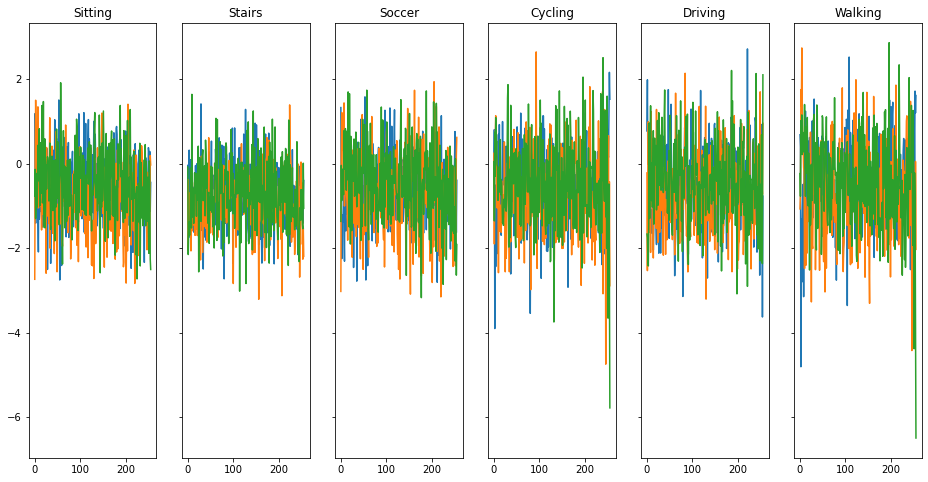

[[4334    6   35    0  170   26]
 [   3  380   15    1   27 2820]
 [  24    5 2114    9  115   45]
 [   0    2   18 3420   37    1]
 [ 113    2  127    8 6581   10]
 [  37   51   50    0   40 4518]]


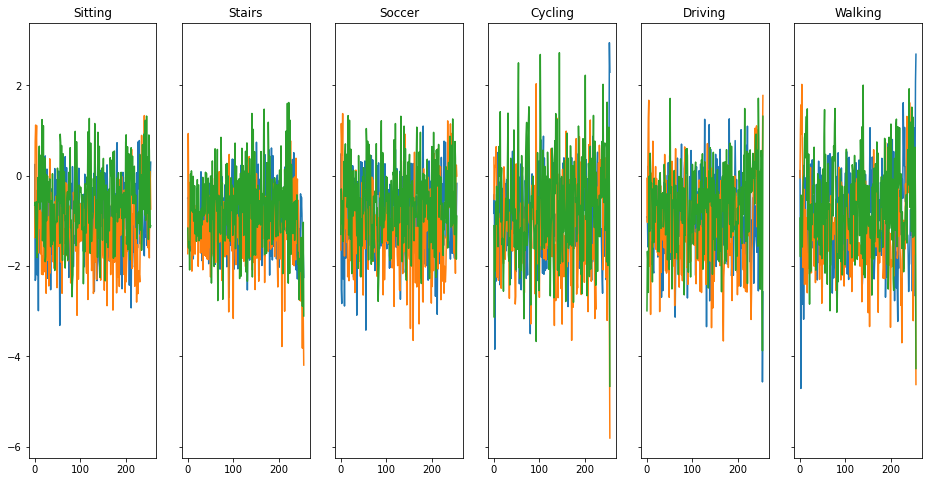

[[4386    3   25    0  118   39]
 [   4  338   22    6   20 2856]
 [  30    4 2068   10  141   59]
 [   0    2   14 3432   29    1]
 [ 121    4   87   11 6586   32]
 [  26   55   37    0   26 4552]]


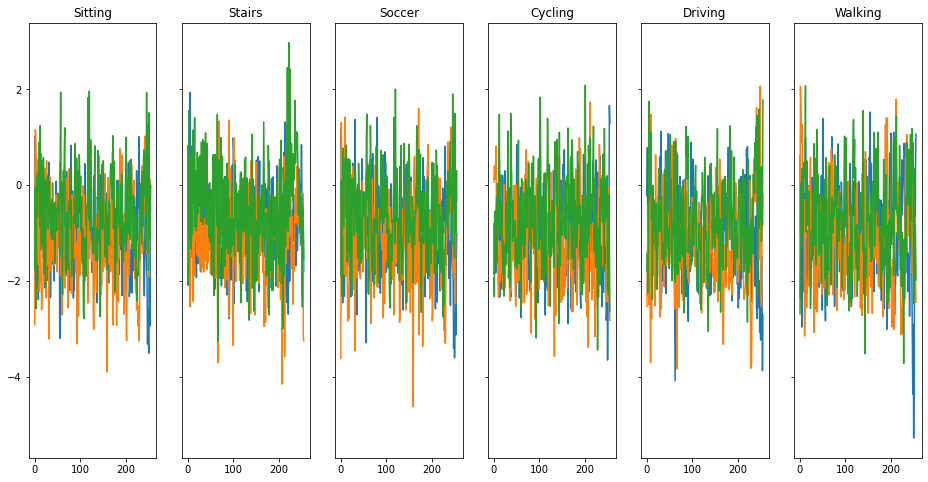

[[4379    6   33    0  127   26]
 [   2  438   17    6   15 2768]
 [  25    6 2109    8  114   50]
 [   0    3    7 3429   38    1]
 [ 181    0  104    7 6527   22]
 [  40   49   35    0   26 4546]]


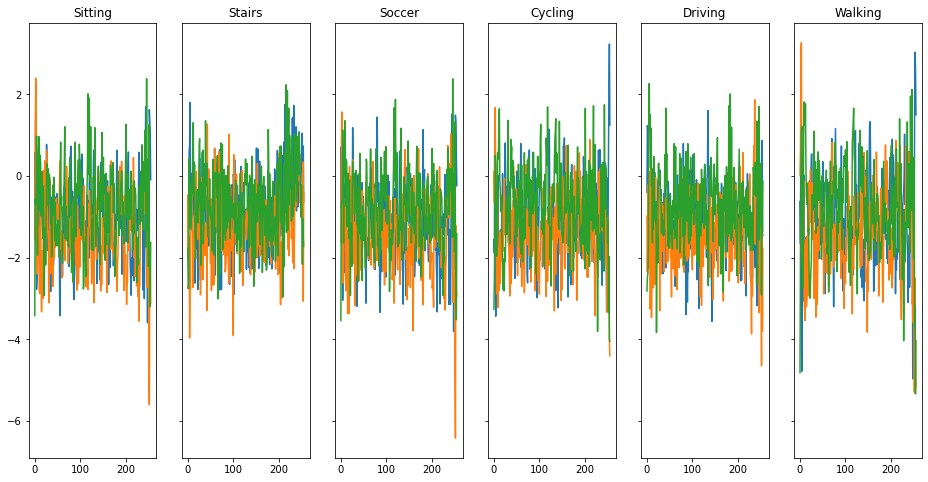

[[4342   11   29    0  166   23]
 [   2  575   18    0   20 2631]
 [  21    7 2136    8  106   34]
 [   0    3    8 3441   25    1]
 [ 194    1  101   11 6514   20]
 [  41   63   41    0   26 4525]]


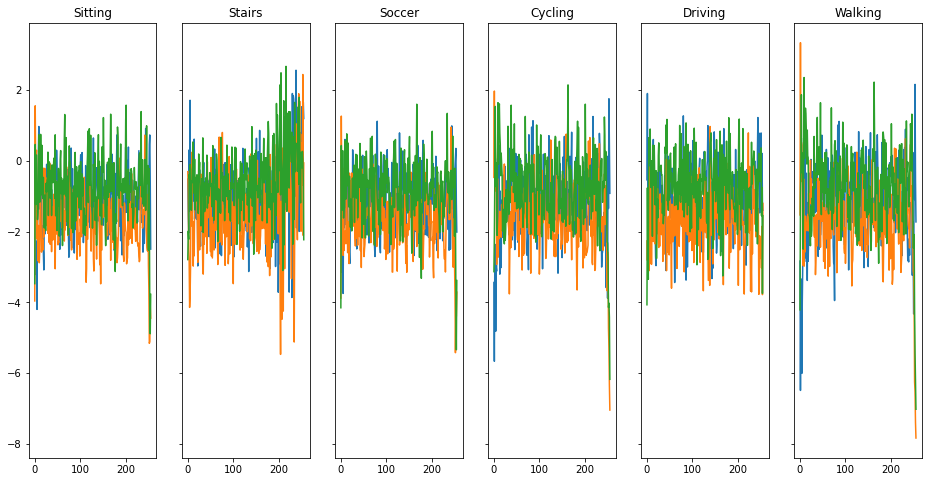

[[4359   10   27    0  147   28]
 [   2  613   20    3   28 2580]
 [  19    5 2114    7  129   38]
 [   0    2   10 3442   24    0]
 [  88    3   72   12 6644   22]
 [  27   80   40    0   24 4525]]


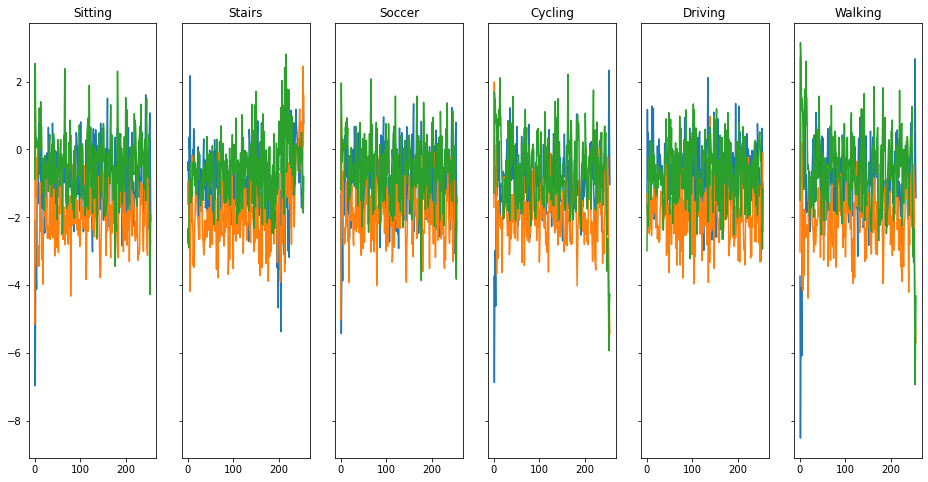

[[4388   11   30    0  111   31]
 [   0  785   24    4   17 2416]
 [  17    1 2136    8  114   36]
 [   0    4   16 3430   27    1]
 [ 141    1   76    8 6605   10]
 [  27   78   39    0   26 4526]]


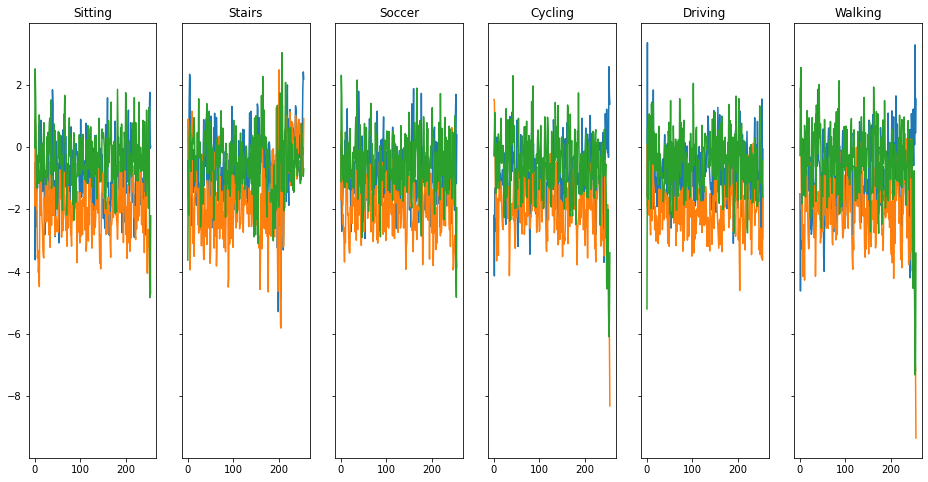

[[4408   12   33    0   97   21]
 [   4  814    9    5   14 2400]
 [  23    6 2146    8   92   37]
 [   0    3    8 3435   30    2]
 [ 184    2   80    7 6565    3]
 [  52   69   23    1   17 4534]]


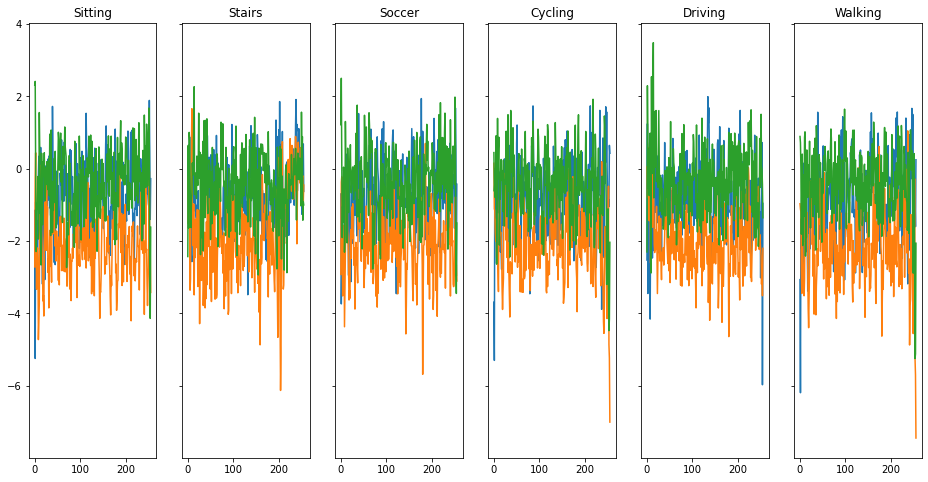

[[4384    9   30    0  130   18]
 [   1  747   12    4   24 2458]
 [  24    7 2180    5   74   22]
 [   0    3    7 3439   27    2]
 [ 103    3  112   18 6601    4]
 [  34   55   58    0   30 4519]]


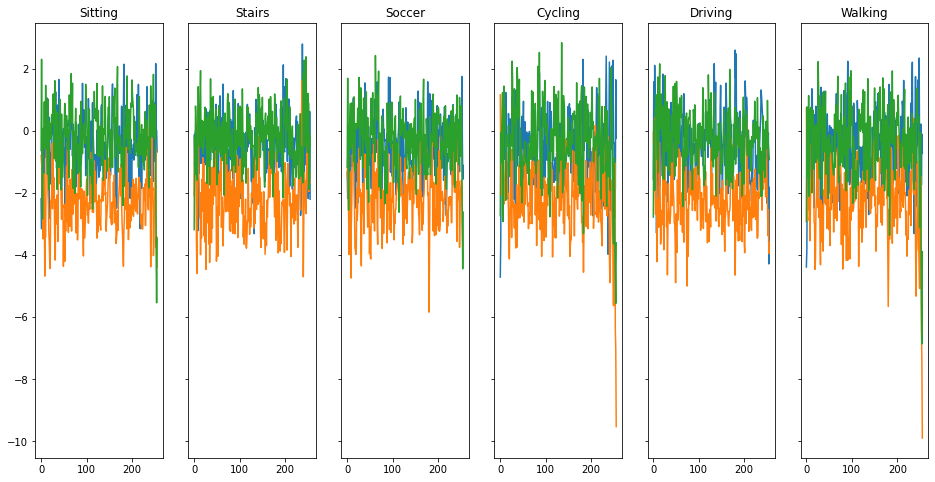

[[4379   15   26    0  135   16]
 [   4 1137    8    2   23 2072]
 [  20    8 2155    5   94   30]
 [   0    3    8 3437   26    4]
 [  95    0   68    8 6665    5]
 [  36   58   44    0   35 4523]]


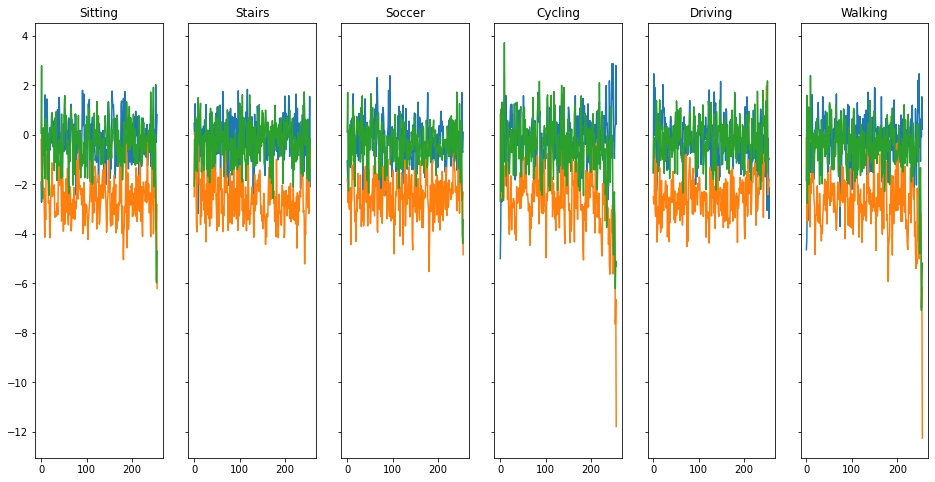

[[4406   10   30    0  101   24]
 [   3 1019   20    4   16 2184]
 [  24    4 2150   10  100   24]
 [   0    3    9 3441   23    2]
 [ 125    1   73   10 6622   10]
 [  30   62   46    0   24 4534]]


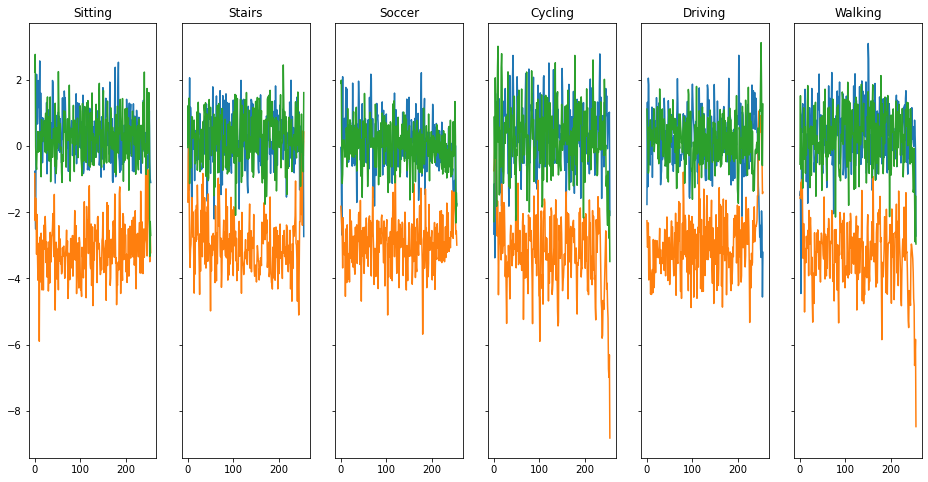

[[4352   16   30    0  159   14]
 [   2 1487   13    3   10 1731]
 [  20   12 2134    4  110   32]
 [   0    5    9 3440   23    1]
 [  83    5   73   10 6658   12]
 [  26  125   47    0   20 4478]]


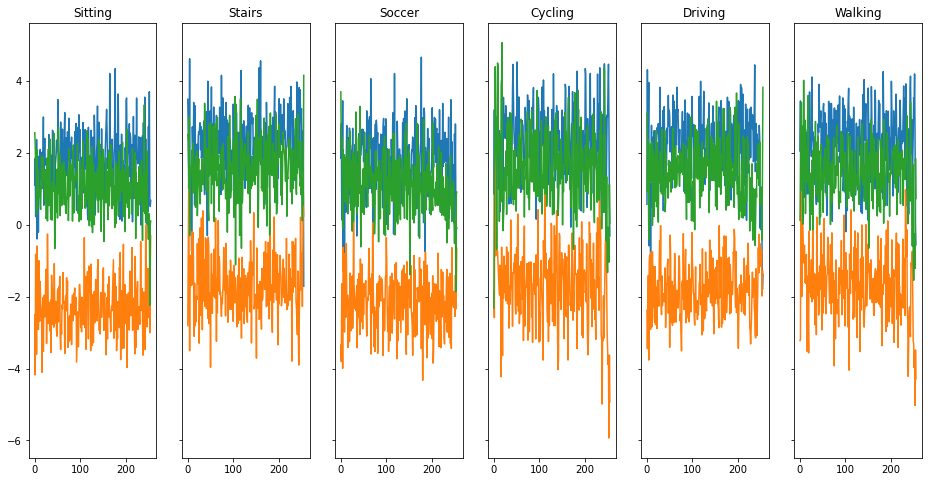

[[4387   10   27    0  121   26]
 [   2 1084   18    3   17 2122]
 [  27   12 2162    9   81   21]
 [   0    1    7 3442   27    1]
 [ 103    4   67    8 6654    5]
 [  36   81   45    0   28 4506]]


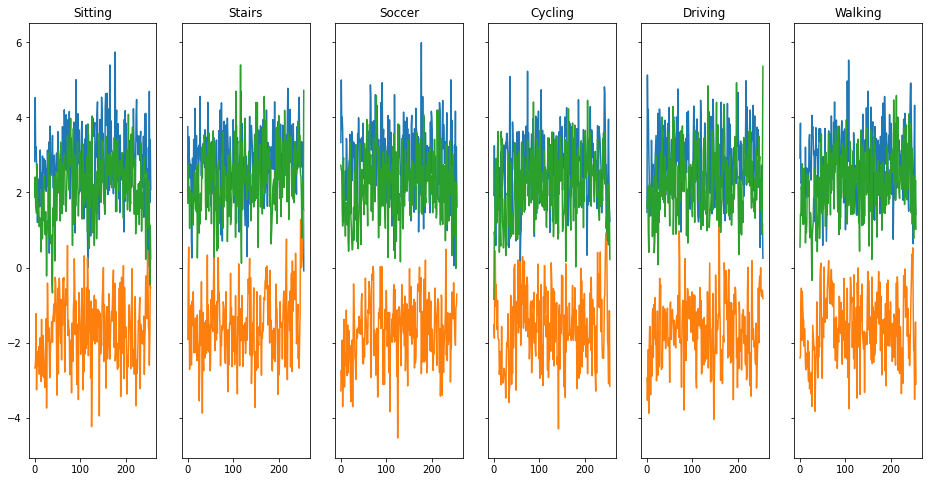

[[4386   12   28    0  122   23]
 [   0 1000   17    6   13 2210]
 [  20    8 2138    7  103   36]
 [   0    3   13 3436   25    1]
 [ 143    1   70   11 6594   22]
 [  32   69   27    0   21 4547]]


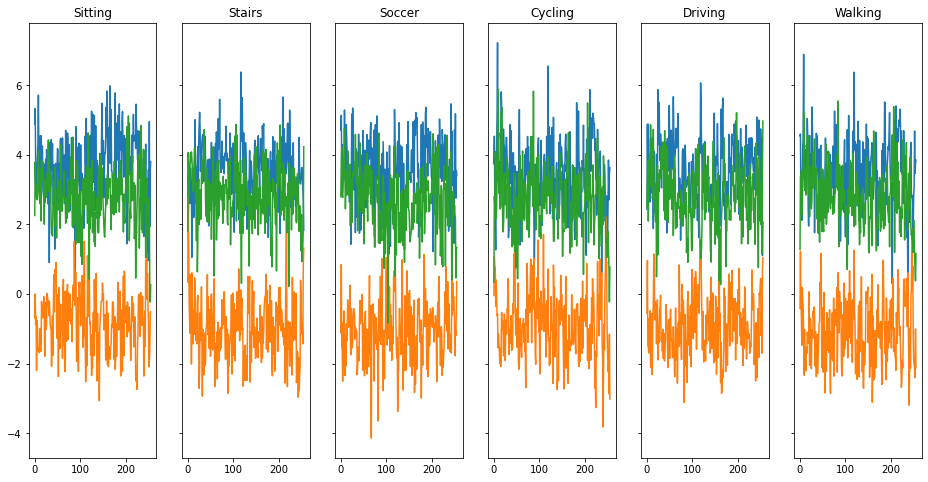

[[4396   13   25    0  119   18]
 [   3  877    9    6   14 2337]
 [  24    8 2136    5  102   37]
 [   0    4    4 3445   24    1]
 [ 117    3   85   11 6615   10]
 [  38   50   29    0   17 4562]]


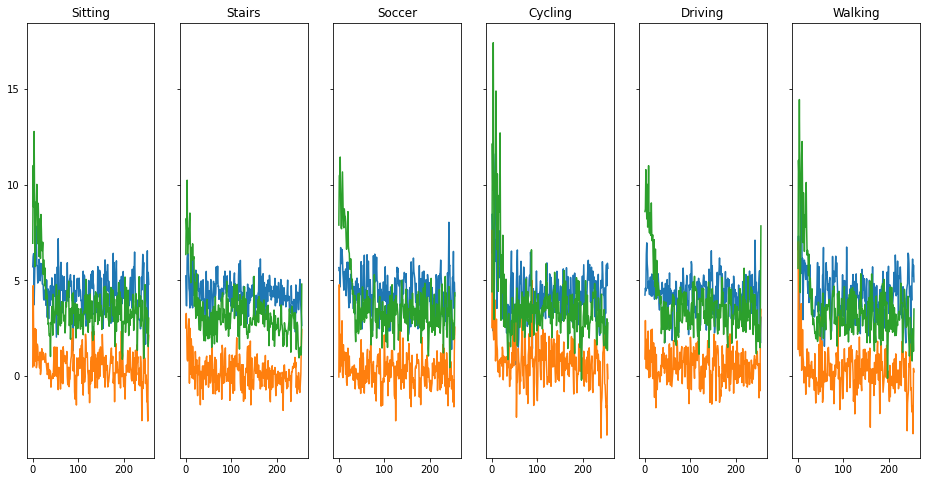

[[4404   10   24    0  114   19]
 [   4 1236   18    3   14 1971]
 [  33    5 2154    5   94   21]
 [   0    1    7 3442   26    2]
 [ 140    4  112   10 6573    2]
 [  42   77   52    0   24 4501]]


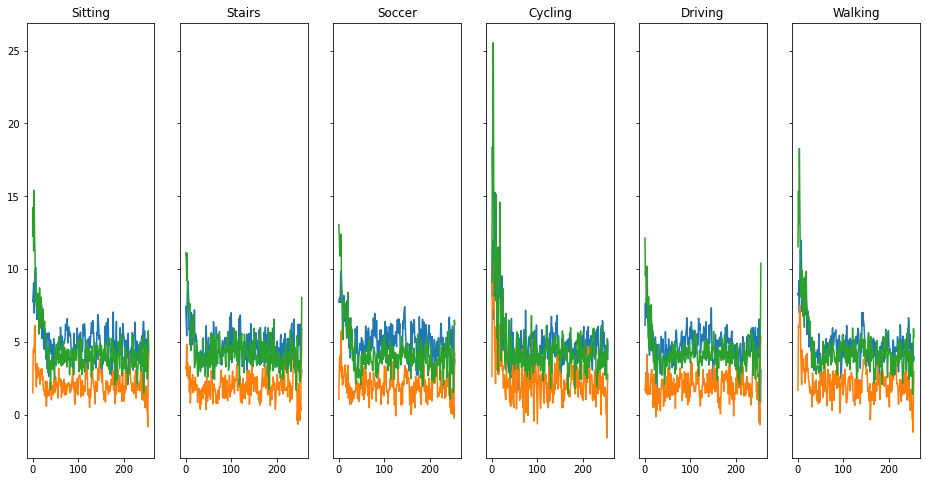

[[4388   11   19    0  131   22]
 [   5 1091   11    1   15 2123]
 [  31    4 2139    5  101   32]
 [   0    0    6 3439   30    3]
 [ 119    4   82   13 6615    8]
 [  37   53   30    0   22 4554]]


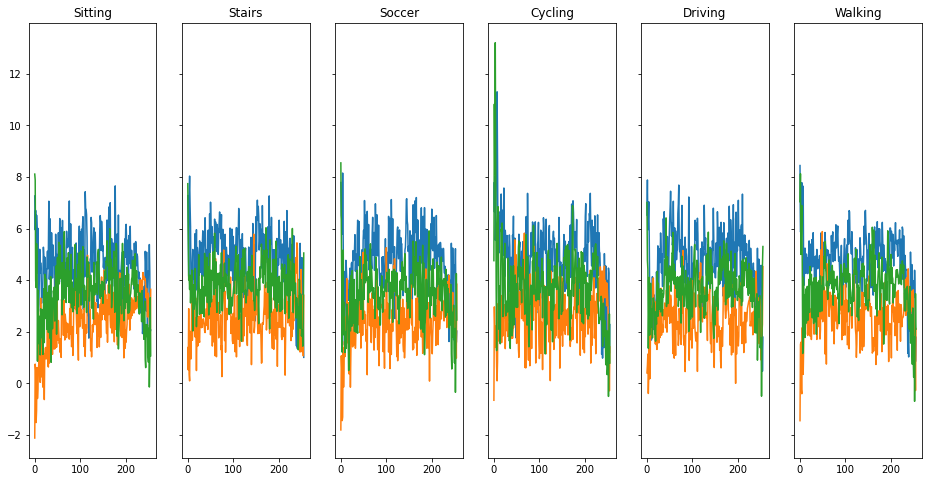

[[4382   14   28    0  131   16]
 [   1 1189   13    1   25 2017]
 [  30    7 2184    1   65   25]
 [   0    5   11 3438   23    1]
 [ 105    1  110   12 6605    8]
 [  35   49   51    0   24 4537]]


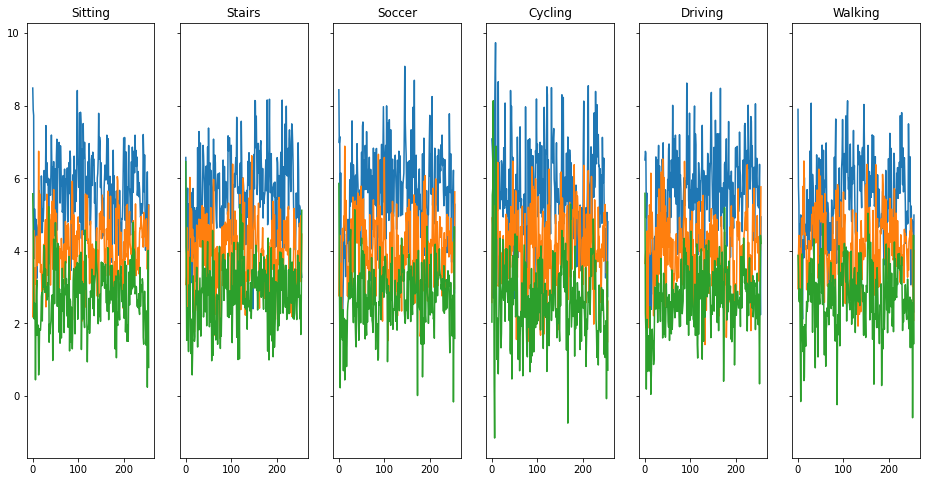

[[4369   14   23    0  147   18]
 [   6 1303    6    2   22 1907]
 [  33    7 2146    5   93   28]
 [   0    4   10 3447   16    1]
 [ 126   10   96   12 6590    7]
 [  33   47   41    0   33 4542]]


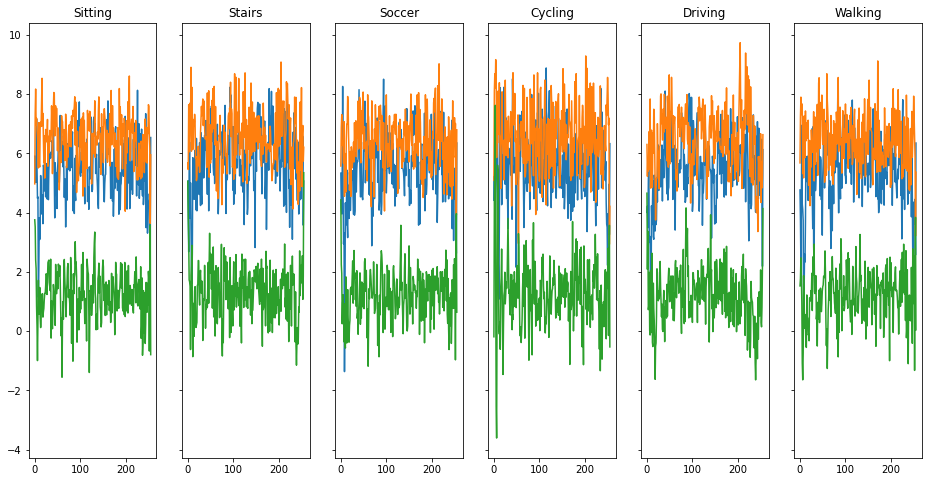

[[4370   10   30    0  139   22]
 [   4  861   11    3   18 2349]
 [  17    3 2185    5   72   30]
 [   0    2    4 3446   24    2]
 [  88    1   94   12 6635   11]
 [  41   47   28    1   20 4559]]


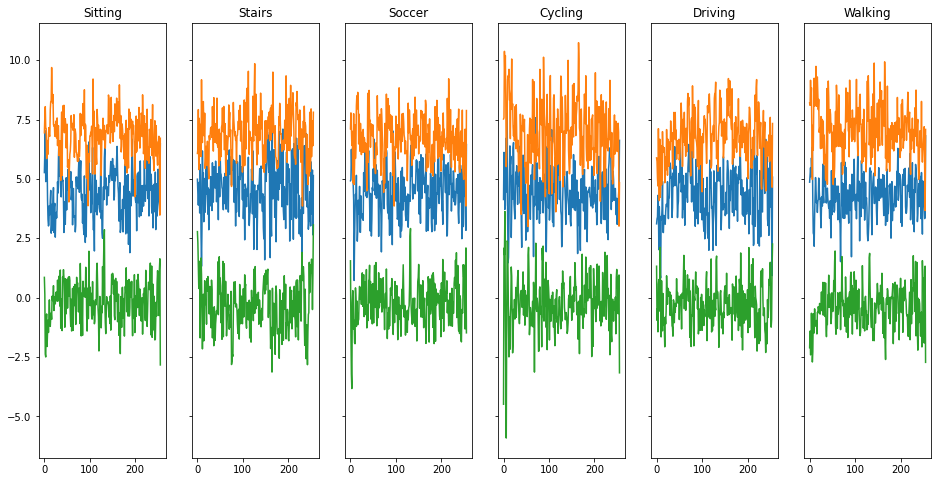

[[4367   19   34    0  138   13]
 [   1 1426    8    1   20 1790]
 [  25    4 2169    1   82   31]
 [   0    3    6 3452   14    3]
 [ 108    3   68   19 6638    5]
 [  30   62   60    0   25 4519]]


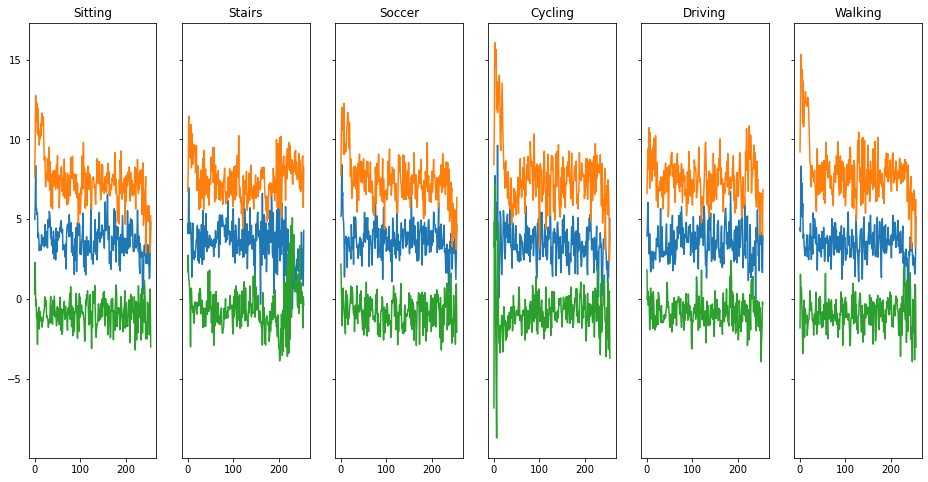

[[4421   12   23    0   97   18]
 [   2 1336   12    2   16 1878]
 [  23    3 2173    2   85   26]
 [   0    1   15 3438   22    2]
 [ 122    4   81   12 6615    7]
 [  49   76   32    0   17 4522]]


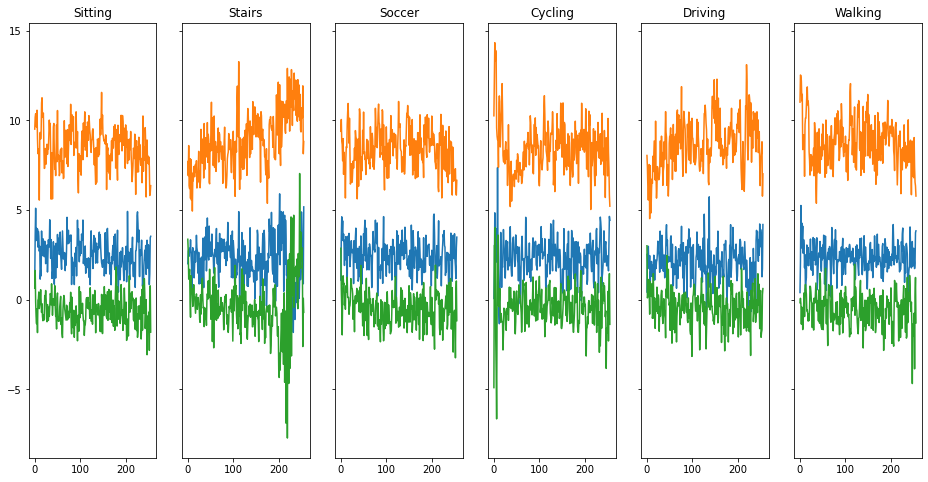

[[4425   10   18    0  100   18]
 [   2 1192   12    1   12 2027]
 [  27    3 2185    3   72   22]
 [   0    1   10 3449   17    1]
 [ 132    0   69   11 6617   12]
 [  45   41   28    0   16 4566]]


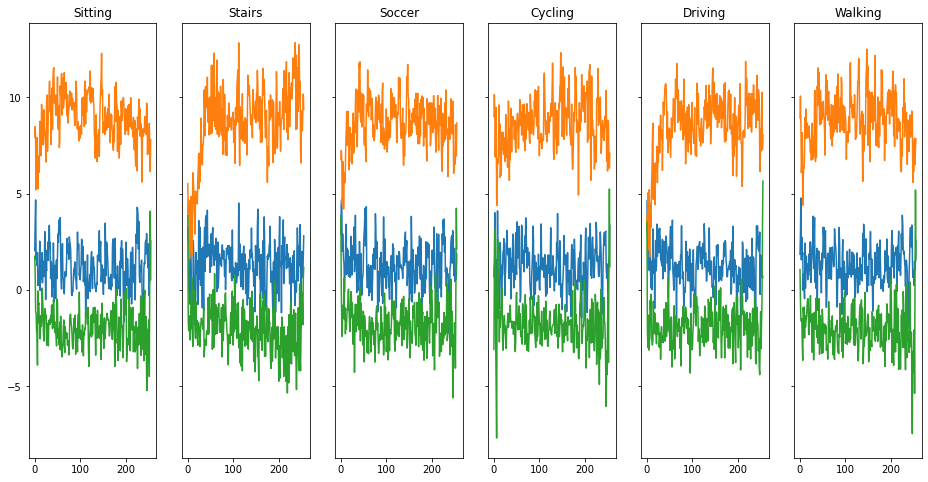

[[4406   13   29    0   99   24]
 [   2 1433   14    1   12 1784]
 [  18    4 2190    8   71   21]
 [   0    1    8 3450   18    1]
 [ 106    2   83   11 6632    7]
 [  25   66   30    0   17 4558]]


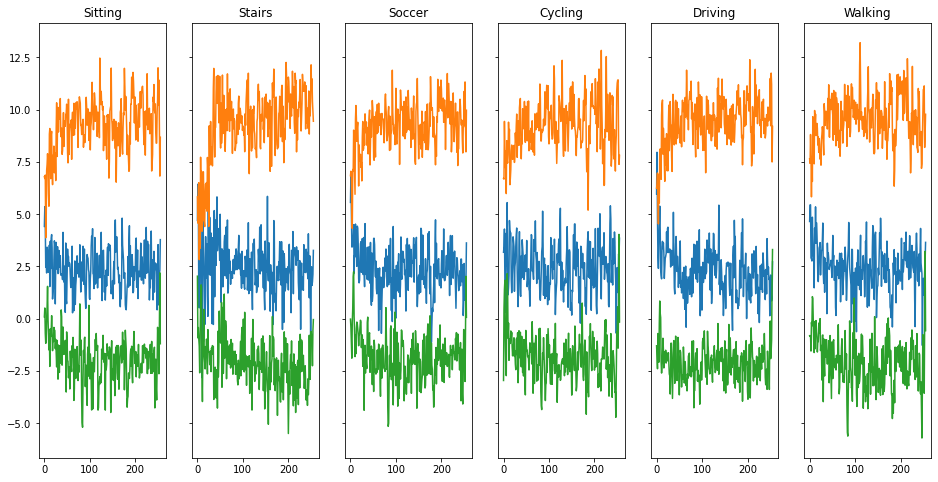

[[4397   17   20    0  128    9]
 [   2 1731    7    0   14 1492]
 [  27    7 2170    7   81   20]
 [   0    2    7 3446   22    1]
 [ 104    5   67    7 6656    2]
 [  29  101   31    0   21 4514]]


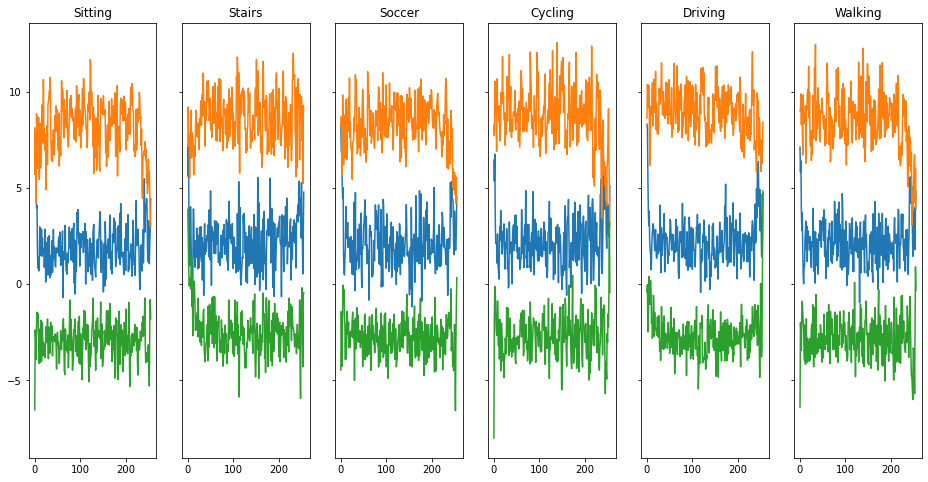

[[4396   19   25    0  120   11]
 [   5 1736    8    1   19 1477]
 [  23    4 2196    4   61   24]
 [   0    3    6 3444   25    0]
 [ 101    5   76   15 6639    5]
 [  45   94   39    0   16 4502]]


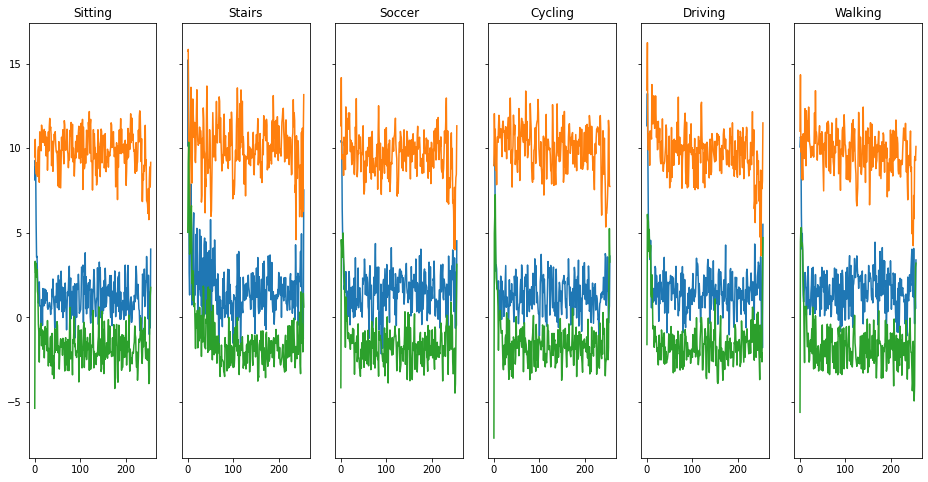

[[4328   12   40    0  169   22]
 [   0 1569   16    0    5 1656]
 [  21    1 2214    2   53   21]
 [   0    2    4 3453   17    2]
 [  95    4   90   10 6638    4]
 [  18   61   41    0   15 4561]]


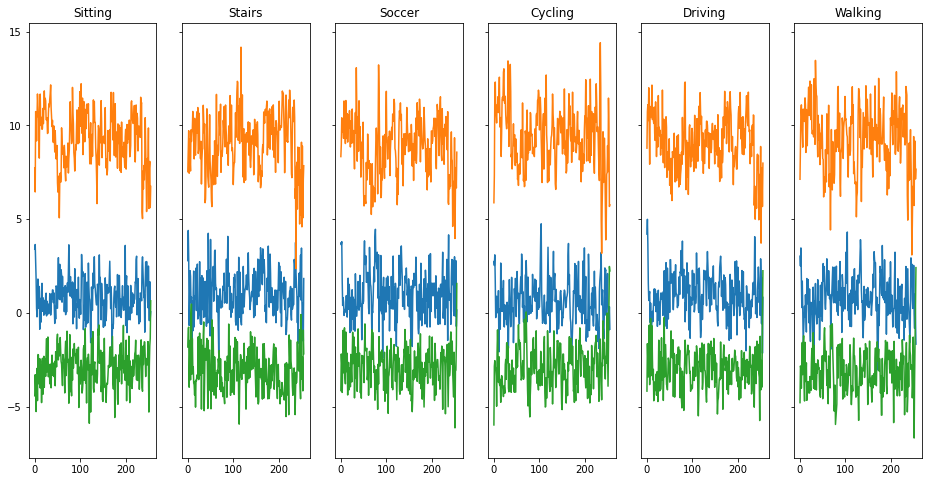

[[4401   13   16    0  123   18]
 [   3 1643   16    1    7 1576]
 [  31    5 2164    8   85   19]
 [   0    3    5 3452   15    3]
 [  87    4   55   11 6679    5]
 [  30   70   29    0   16 4551]]


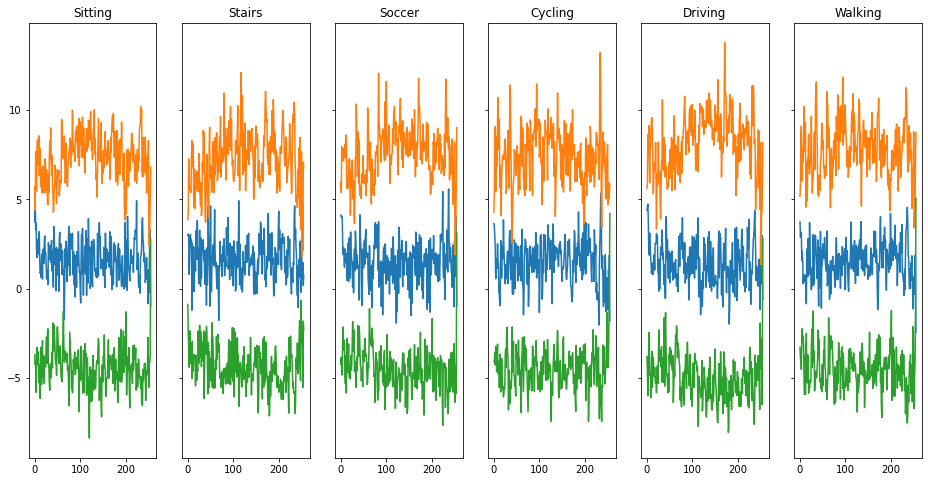

[[4438   18   22    0   83   10]
 [   2 2301    9    0   11  923]
 [  28   10 2190    4   60   20]
 [   0    6    8 3446   17    1]
 [  87    4   68    9 6668    5]
 [  34  144   26    0   14 4478]]


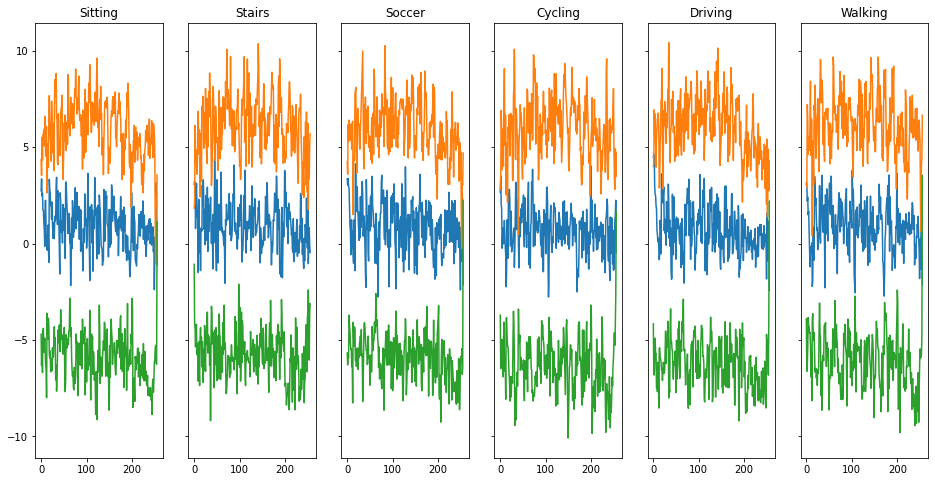

[[4367   14   31    0  149   10]
 [   4 1726    7    1   16 1492]
 [  28   14 2172    5   65   28]
 [   2    3    9 3442   22    0]
 [  77    2   81    8 6667    6]
 [  40   83   47    0   32 4494]]


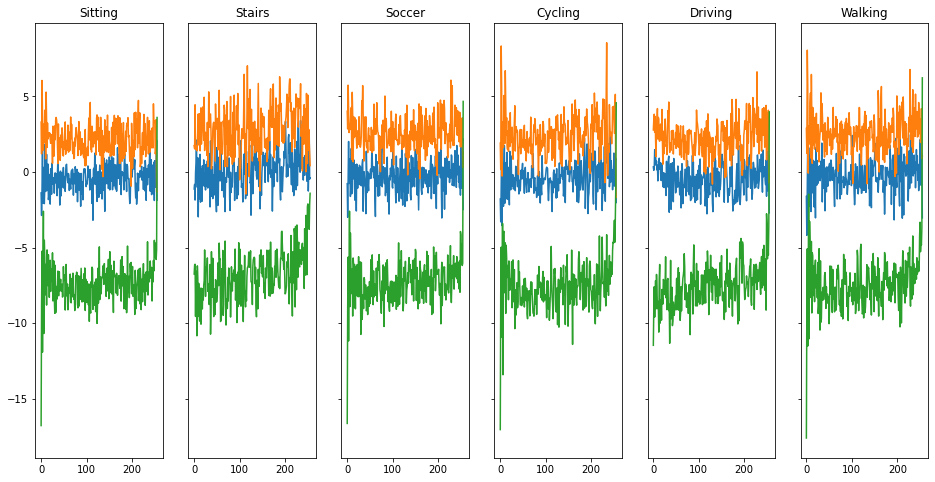

[[4380   17   29    0  133   12]
 [   2 1847   15    1    8 1373]
 [  21    5 2180    5   76   25]
 [   0    5    5 3446   22    0]
 [  78   11   72   17 6659    4]
 [  23  106   35    0   21 4511]]


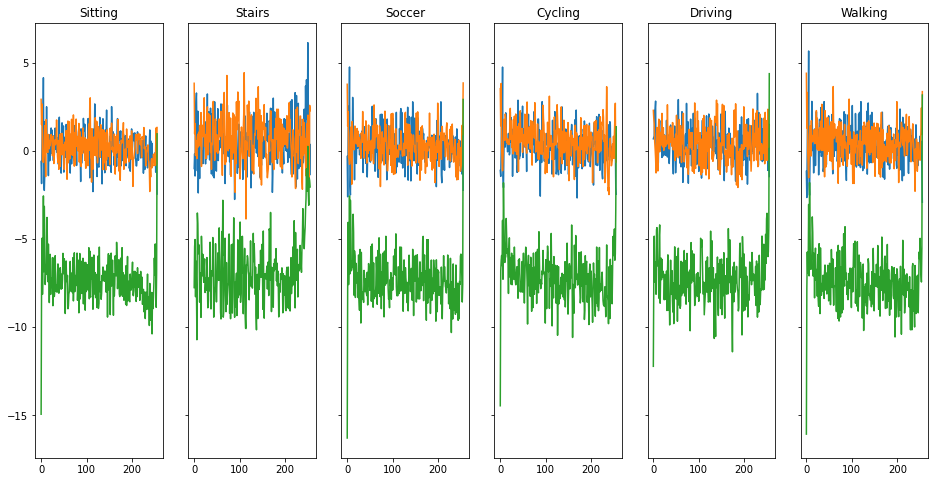

[[4379   16   19    0  138   19]
 [   3 2052   21    4    6 1160]
 [  25    7 2153    9   92   26]
 [   0    3    4 3454   17    0]
 [ 111    0   64   12 6645    9]
 [  26  140   34    0   20 4476]]


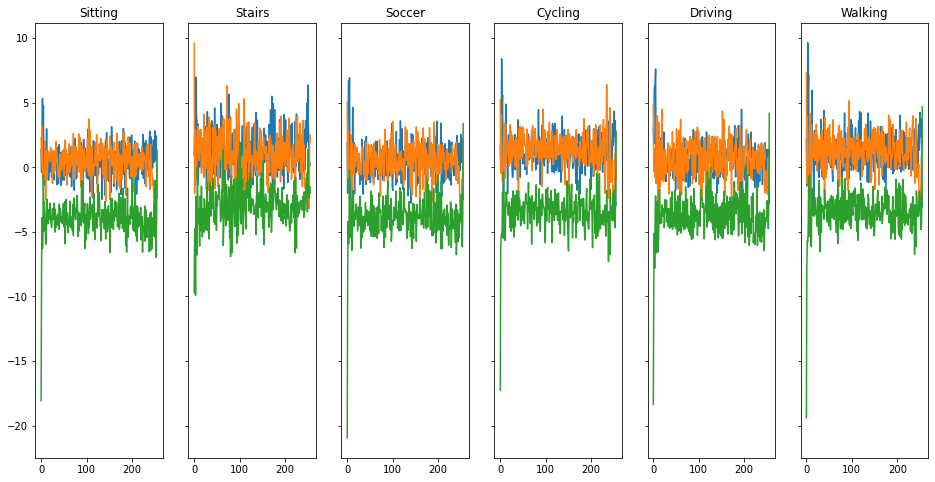

[[4395   14   34    0  113   15]
 [   2 1844   10    2    9 1379]
 [  34    8 2166    7   75   22]
 [   0    3    6 3453   16    0]
 [  94    3   82   17 6643    2]
 [  32  113   35    0   23 4493]]


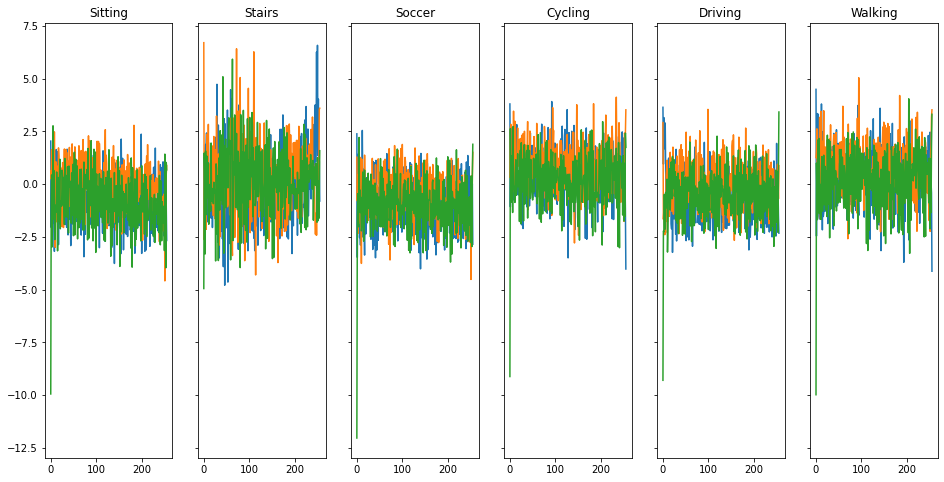

[[4428   20   22    0   85   16]
 [   8 2323   11    4   10  890]
 [  36   12 2131    5   96   32]
 [   0    4   13 3439   22    0]
 [ 167    2   78    8 6578    8]
 [  45  189   28    1   17 4416]]


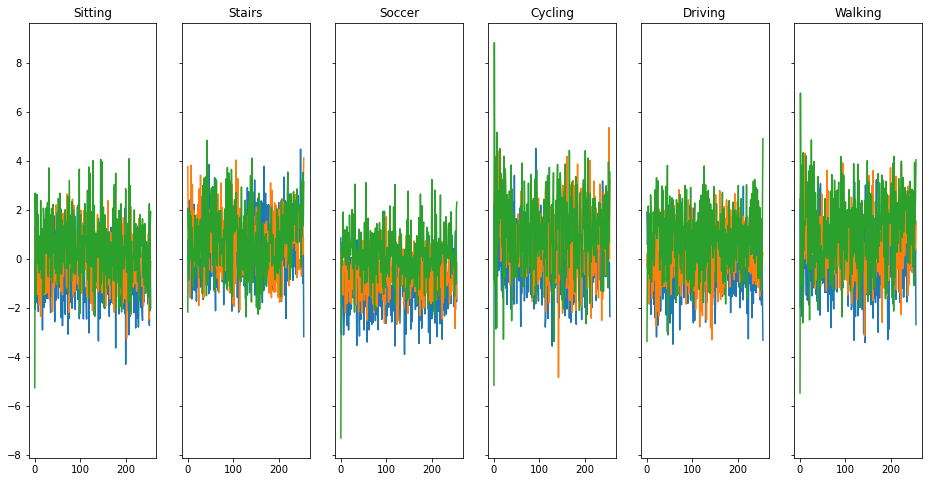

[[4318   15   45    0  169   24]
 [   4 1809    8    4   14 1407]
 [  17   14 2128   12  105   36]
 [   0    5    3 3433   37    0]
 [ 103    3   58   16 6645   16]
 [  34  124   29    0   14 4495]]


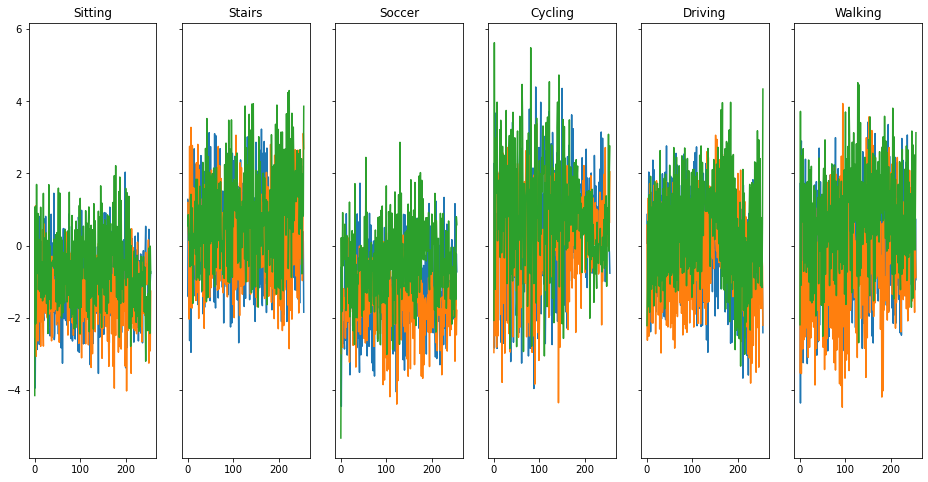

[[4409   11   18    0  120   13]
 [   6 1589   12    3    7 1629]
 [  33    5 2162    6   87   19]
 [   0    2    5 3448   22    1]
 [ 120    1   75   10 6630    5]
 [  36   83   40    0   22 4515]]


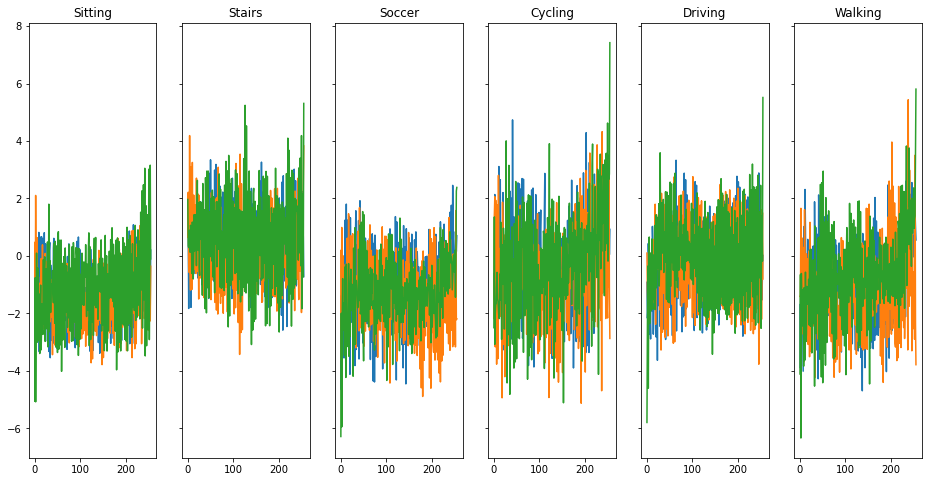

[[4391   10   28    0  123   19]
 [   5 1933   12    2   16 1278]
 [  30    5 2132    3  103   39]
 [   0    2    9 3434   31    2]
 [ 152    3   72    9 6593   12]
 [  38  129   36    0   19 4474]]


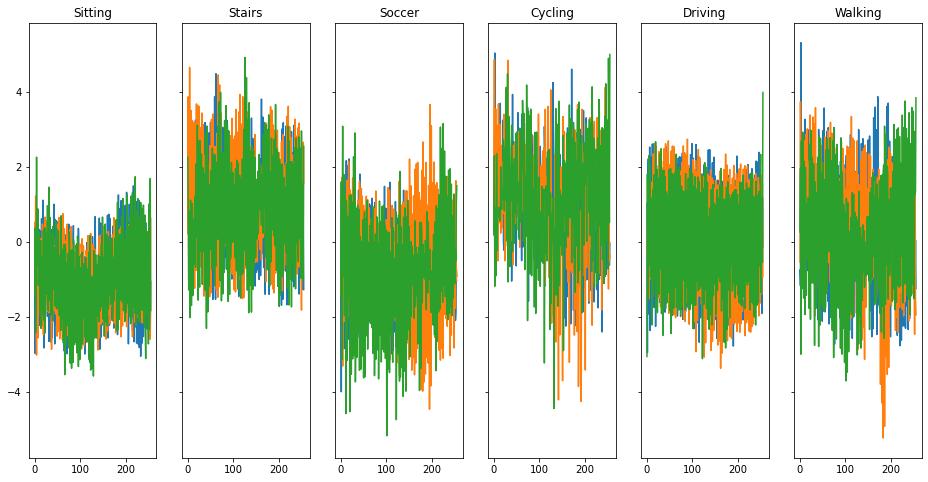

[[4336   17   19    0  179   20]
 [  10 1988    8    1   20 1219]
 [  44   20 2076   13  124   35]
 [   0    8    3 3444   23    0]
 [ 129    8  115   16 6554   19]
 [  45  150   33    0   24 4444]]


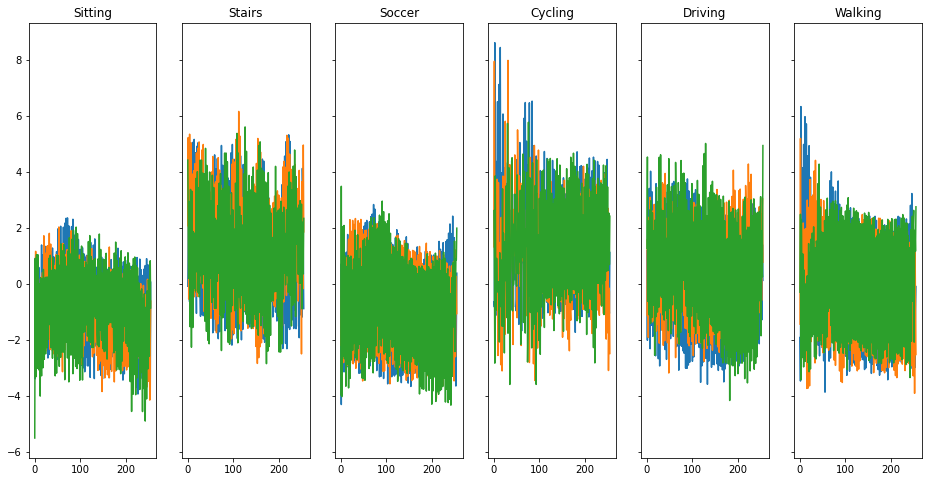

[[4298   23   19    0  222    9]
 [   9 2045    9    3   37 1143]
 [  25   21 2061    9  171   25]
 [   0    5   17 3416   39    1]
 [ 136    4  121   19 6540   21]
 [  42  188   37    0   57 4372]]


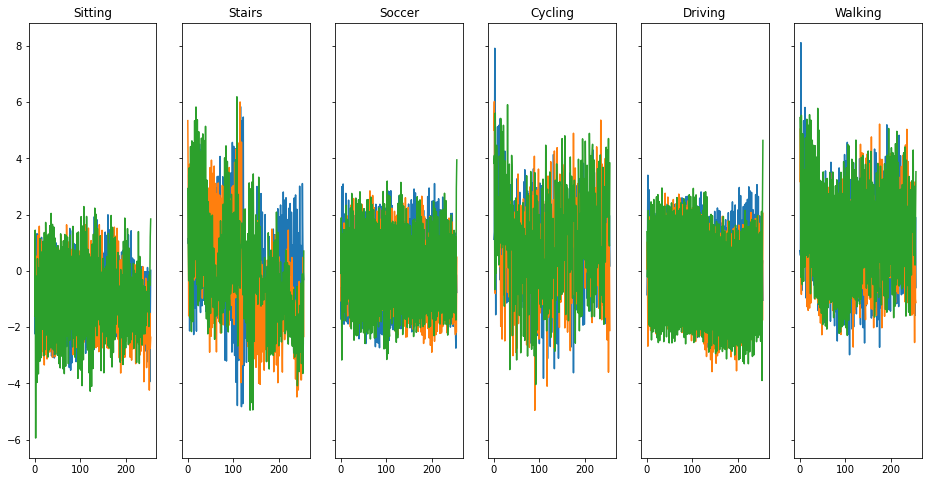

[[4368   22   28    0  137   16]
 [   2 1906   16    6   10 1306]
 [  31   10 2116   12  105   38]
 [   0    3    5 3442   28    0]
 [ 162    7   84   16 6564    8]
 [  41  132   31    1   22 4469]]


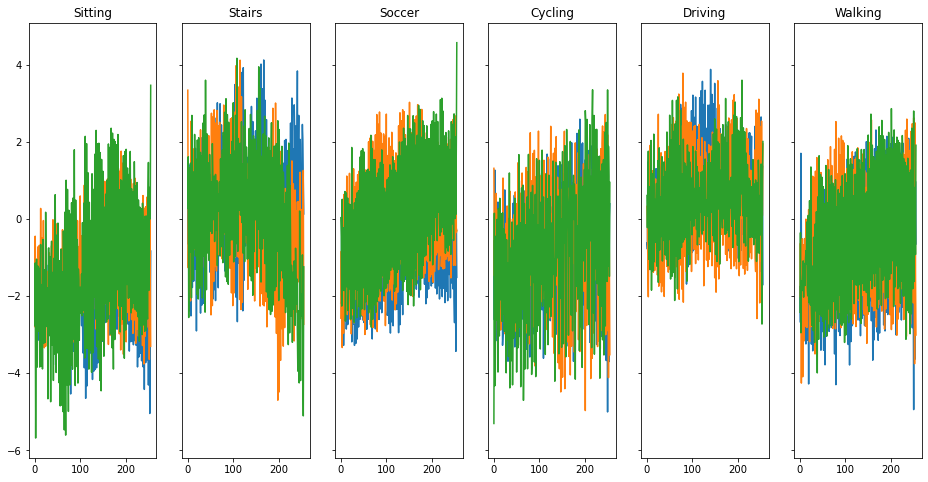

[[4376   21   25    0  138   11]
 [   0 1965    8    1   17 1255]
 [  20    9 2162    8   91   22]
 [   0    2    7 3448   21    0]
 [  97    5   71   11 6653    4]
 [  26  127   27    0   26 4490]]


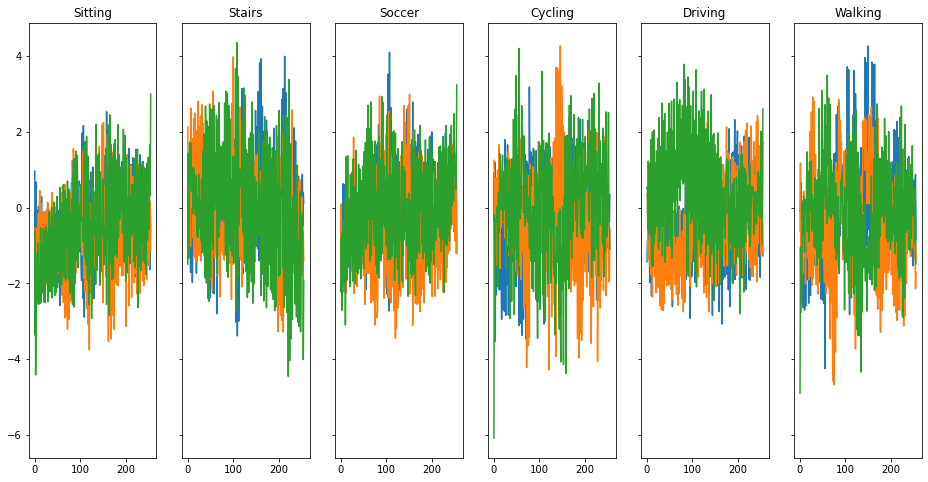

[[4382   20   23    0  129   17]
 [   2 2156    9    2   10 1067]
 [  46   13 2089    6  114   44]
 [   0    9   19 3407   41    2]
 [ 147    5  115   17 6543   14]
 [  39  172   29    0   23 4433]]


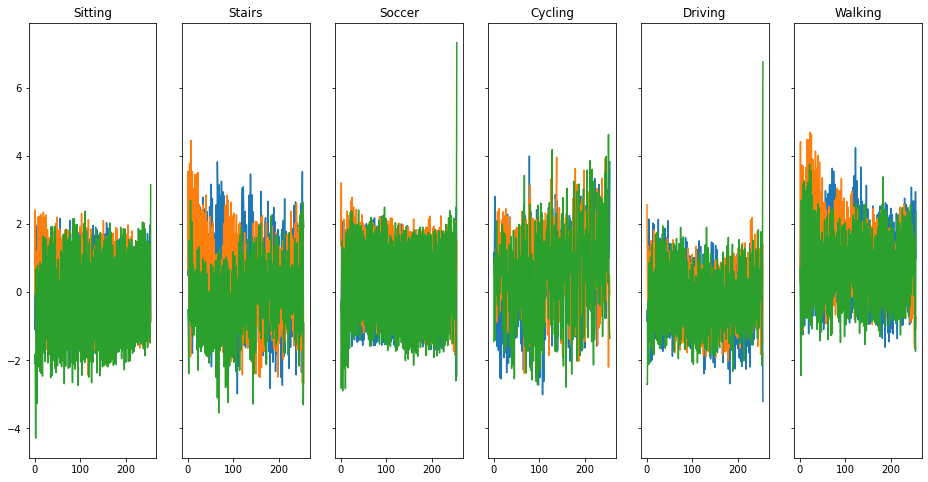

[[3529   13   23    0  994   12]
 [  19 1818    9    1   15 1384]
 [ 119    9 2021    9  121   33]
 [   3    6   34 3399   31    5]
 [ 202    5  139   20 6447   28]
 [  62  123   37    0   20 4454]]


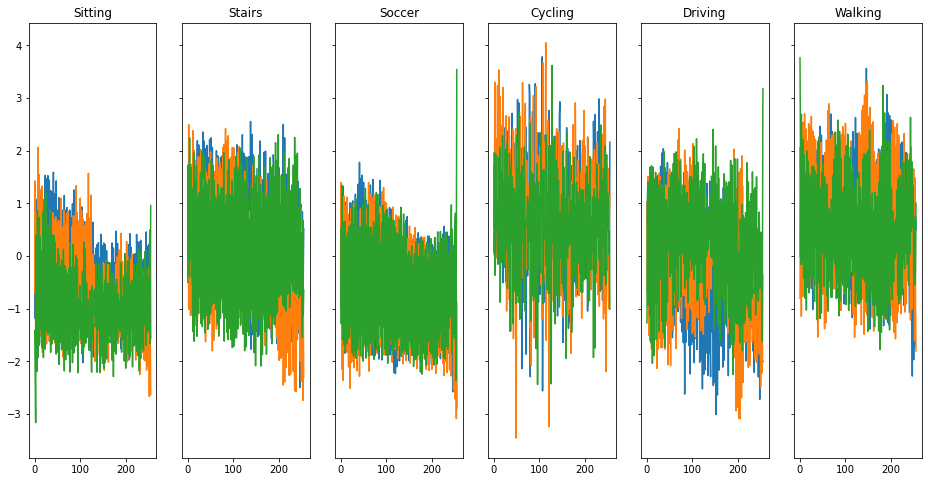

[[4306   14   37    0  194   20]
 [   6 1942   13    4   19 1262]
 [  32   16 2058    9  165   32]
 [   0    5    4 3428   40    1]
 [ 162   13  119   16 6514   17]
 [  47  151   32    0   32 4434]]


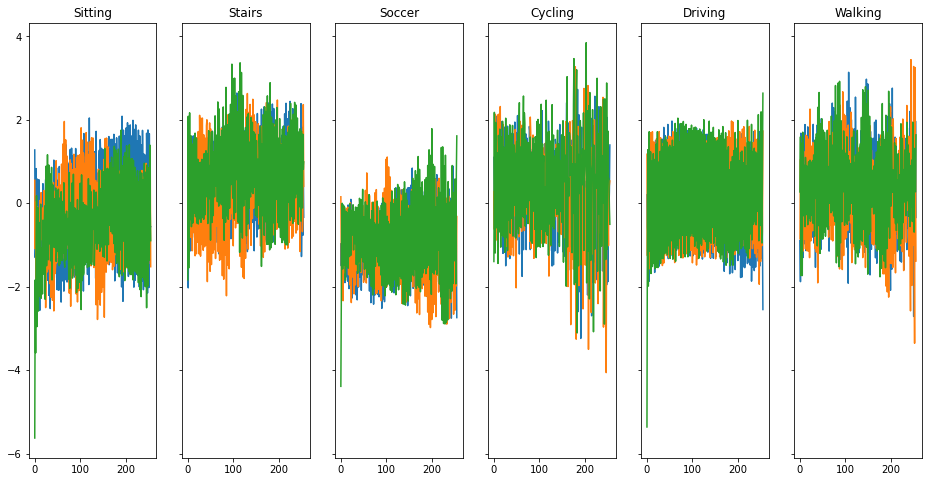

[[4336   25   35    0  158   17]
 [   2 1941   12    1   21 1269]
 [  34   16 2097   15  115   35]
 [   0    7   17 3424   29    1]
 [ 104    8  116   14 6588   11]
 [  27  153   39    0   20 4457]]


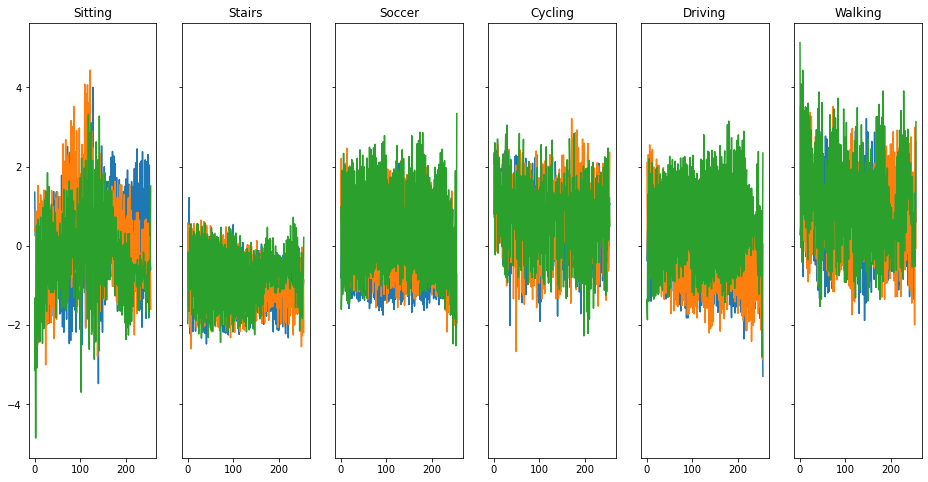

[[4322   15   29    0  193   12]
 [   4 2393   15    2   25  807]
 [  42    6 2106   10  126   22]
 [   0    4    6 3427   40    1]
 [ 112    8  102   15 6596    8]
 [  27  242   54    0   35 4338]]


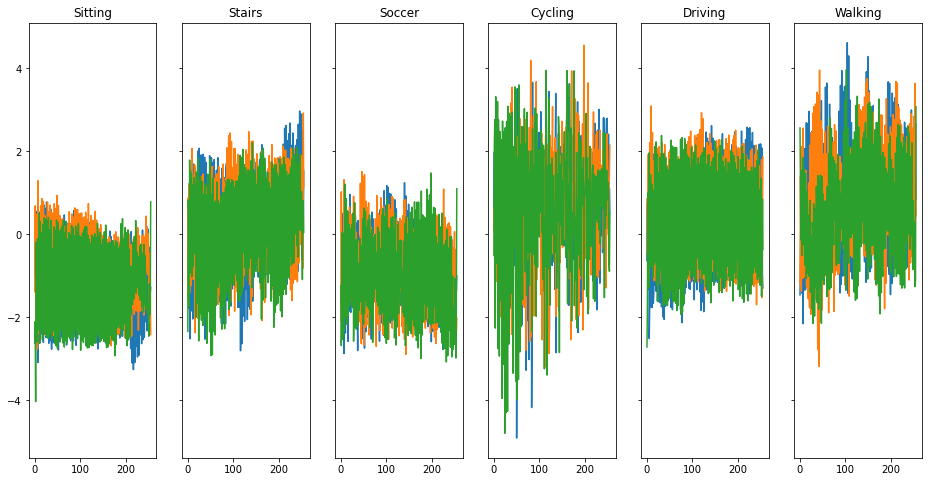

[[4359   19   40    0  142   11]
 [   9 2149   13    4   18 1053]
 [  25   12 2088   11  158   18]
 [   0    2    3 3429   44    0]
 [ 129    5   86   16 6598    7]
 [  59  220   44    0   25 4348]]


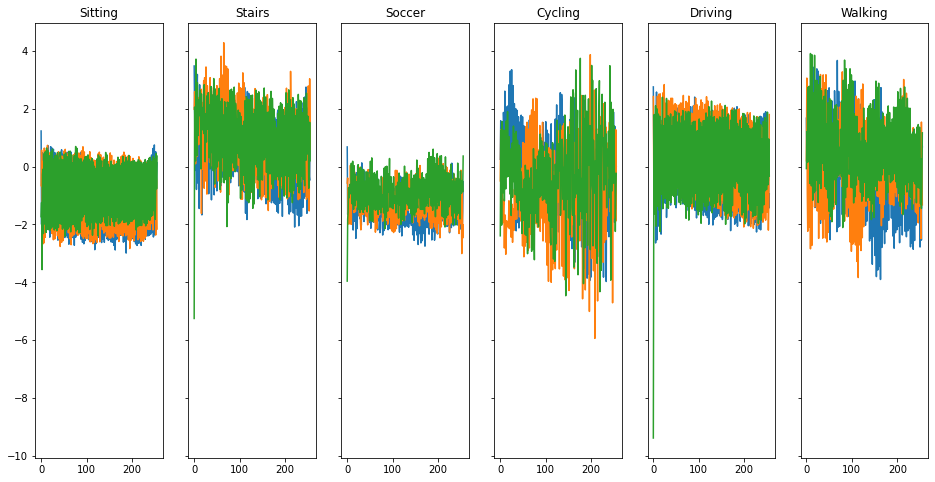

[[4357   22   48    0  130   14]
 [   3 1989   20    3   14 1217]
 [  13    8 2121    6  129   35]
 [   0    3   11 3439   25    0]
 [ 130    3   79   18 6606    5]
 [  39  169   36    2   28 4422]]


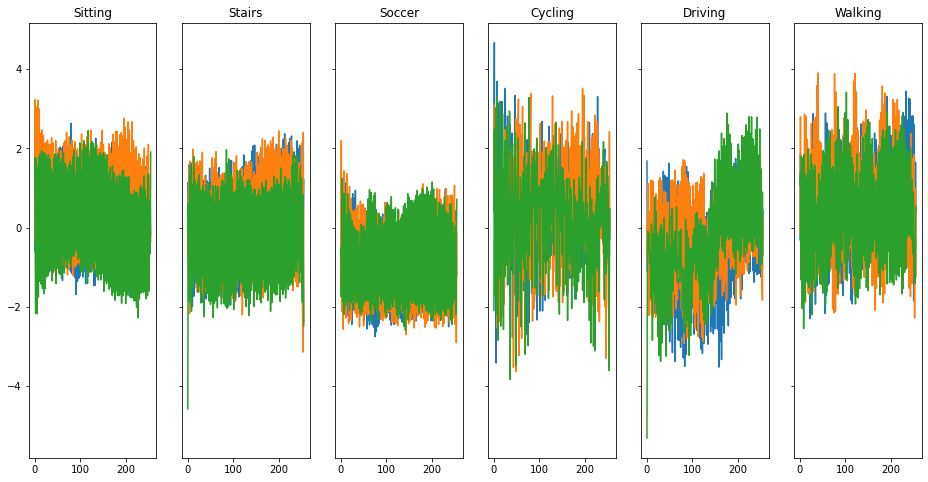

[[4366   17   36    0  132   20]
 [   1 2348   15    0   15  867]
 [  17   17 2111    6  131   30]
 [   1    2   12 3426   36    1]
 [ 108   16   83   10 6603   21]
 [  32  202   33    0   25 4404]]


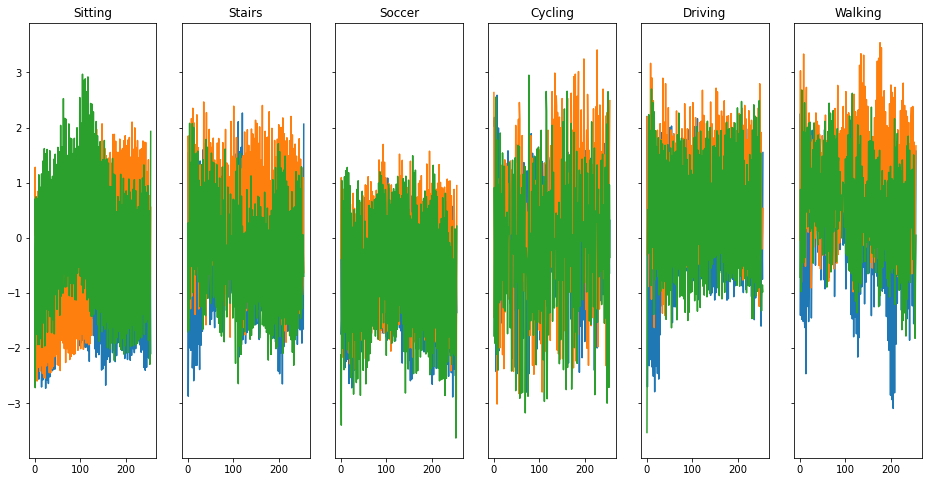

[[4394   25   28    0  114   10]
 [   2 2975    8    1   16  244]
 [  33   21 2140   10   95   13]
 [   0    7    8 3436   27    0]
 [ 130    6   93   15 6590    7]
 [  40  480   44    0   18 4114]]


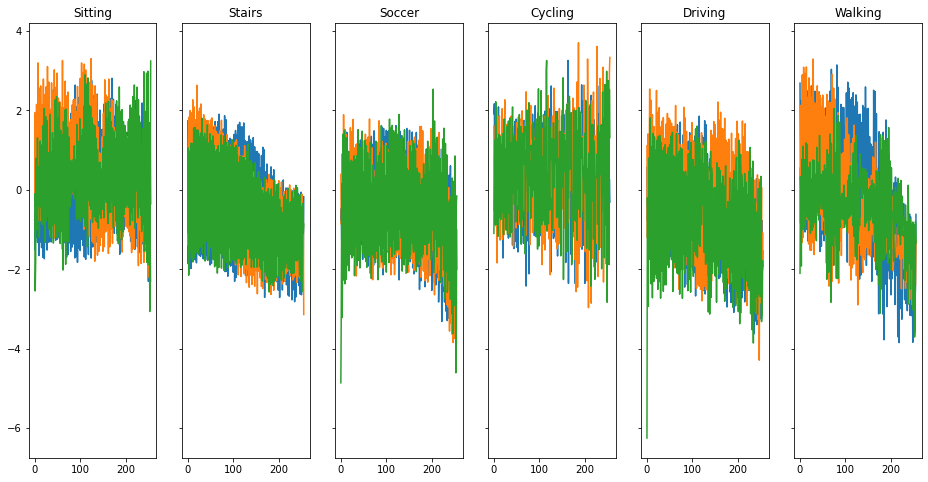

[[4365   21   38    0  140    7]
 [   3 2858   12    2   21  350]
 [  28   18 2137    7  104   18]
 [   0    4    9 3435   29    1]
 [ 135   10  115   10 6563    8]
 [  30  338   41    0   35 4252]]


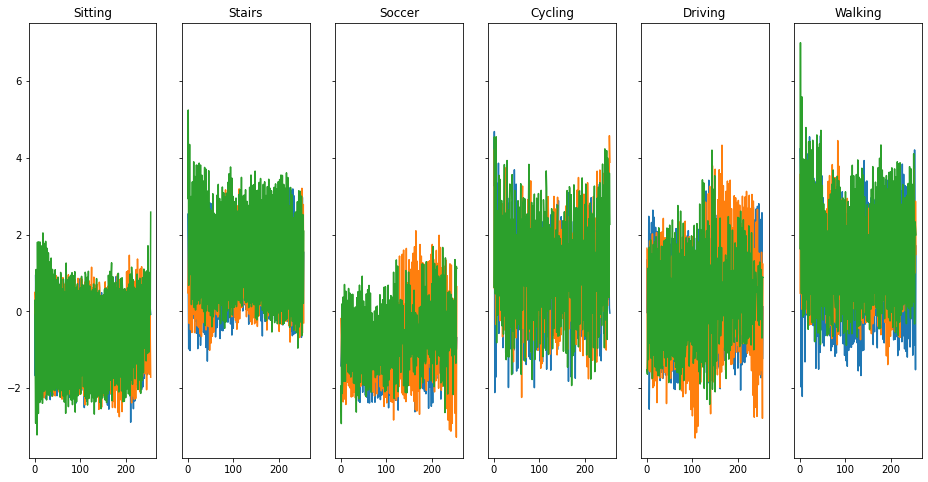

[[4381   21   32    0  127   10]
 [   3 2937    3    1   14  288]
 [  58   21 2101    5   87   40]
 [   0    3   18 3413   42    2]
 [ 148   12   93    9 6570    9]
 [  33  379   35    0   20 4229]]


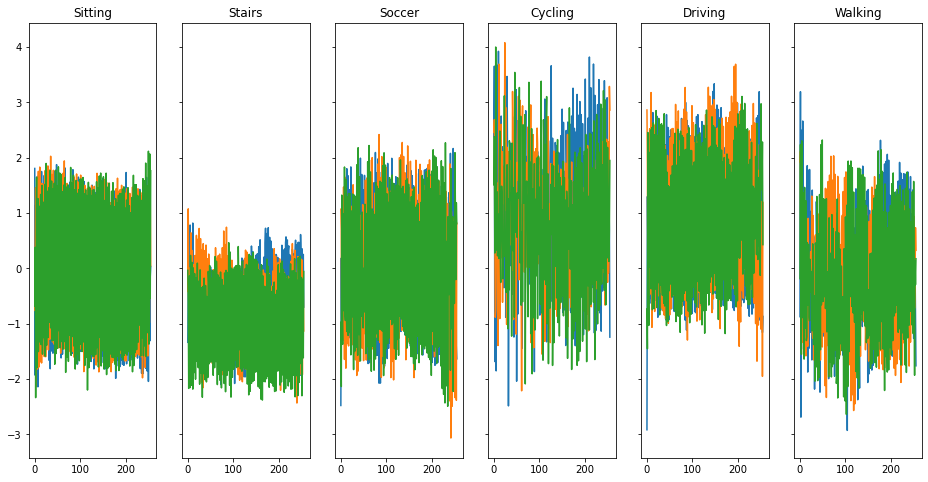

[[4383   20   19    0  138   11]
 [   6 2982   11    0   17  230]
 [  35   19 2122   10  108   18]
 [   0    2   10 3435   29    2]
 [ 130   12   95   15 6584    5]
 [  42  404   33    0   34 4183]]


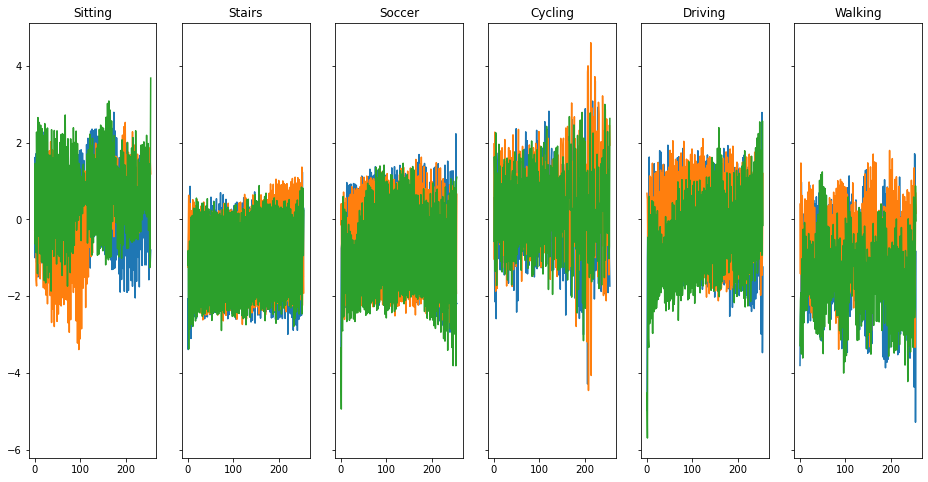

[[4393   21   30    0  116   11]
 [   3 2949   20    2   20  252]
 [  34   13 2167    4   75   19]
 [   0    3   11 3438   25    1]
 [ 111    6   90   14 6610   10]
 [  37  316   35    0   21 4287]]


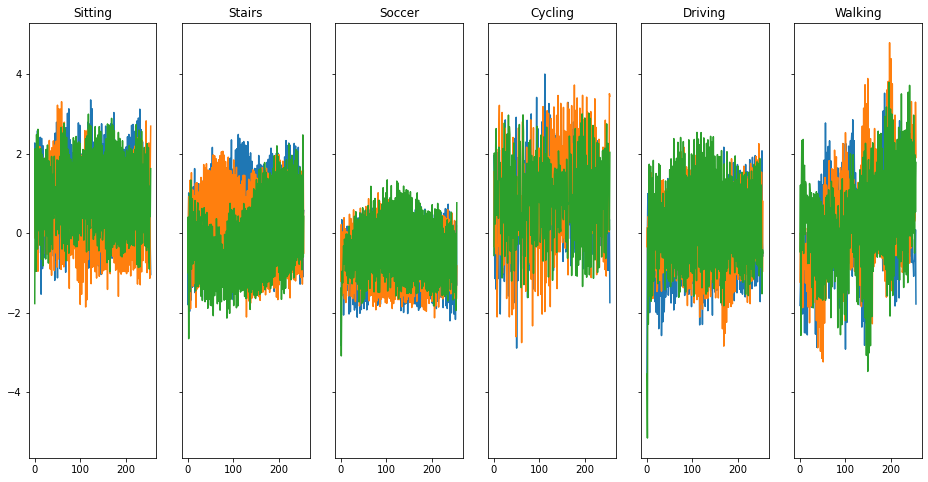

[[4374   28   41    0  123    5]
 [   4 3034    8    0   30  170]
 [  23   26 2111   13  116   23]
 [   0    9    6 3420   43    0]
 [ 131    8   66    7 6619   10]
 [  42  455   35    0   31 4133]]


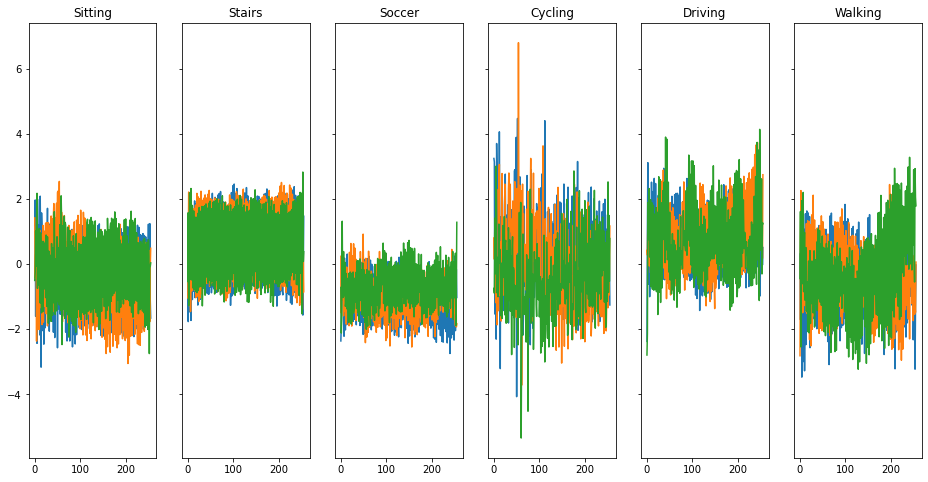

[[4364   21   27    0  146   13]
 [   3 3015   14    4   17  193]
 [  35   18 2139   15   89   16]
 [   0    4    9 3441   24    0]
 [ 133    9   93   10 6587    9]
 [  40  491   30    1   16 4118]]


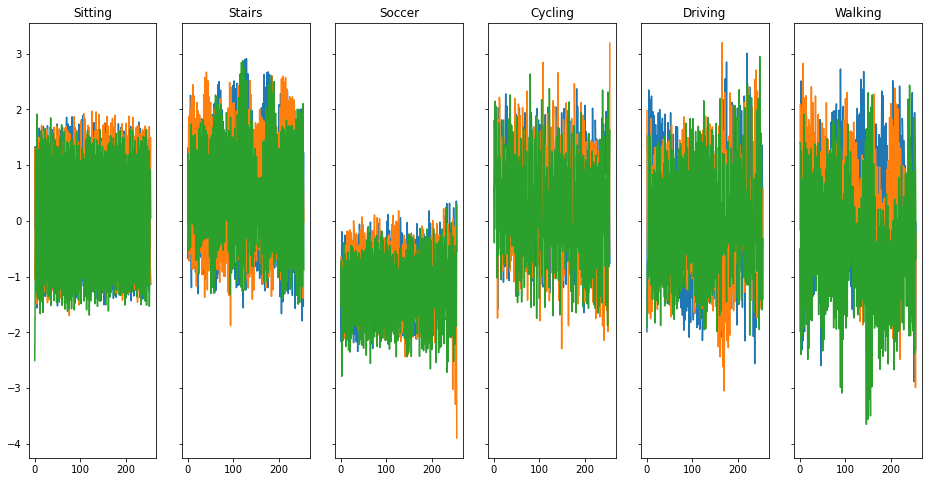

[[4369   21   32    0  143    6]
 [   2 3012   13    1   17  201]
 [  28   14 2114    6  132   18]
 [   0    2   12 3437   26    1]
 [ 136    7   83    7 6600    8]
 [  35  391   36    0   29 4205]]


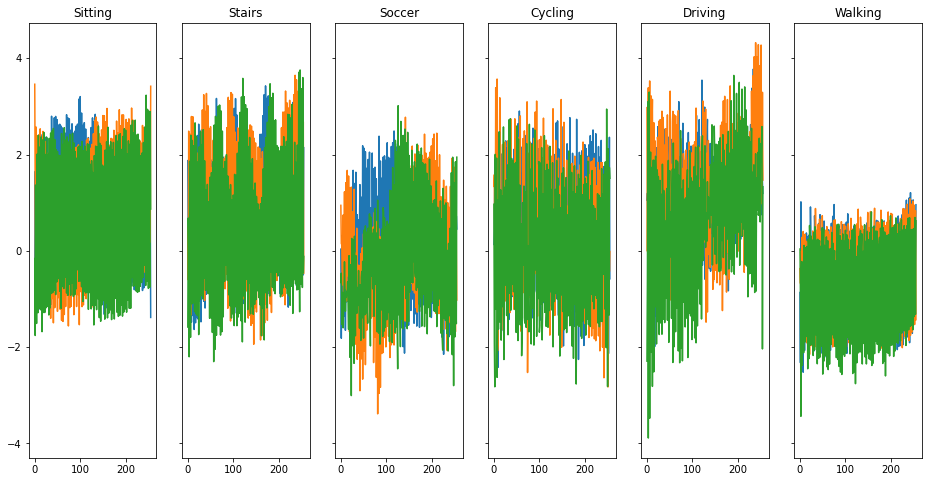

[[4386   33   28    0  119    5]
 [   1 3052    9    3   18  163]
 [  24   15 2163    7   77   26]
 [   0    2   10 3442   24    0]
 [ 121    3   92   11 6606    8]
 [  31  390   24    0   21 4230]]


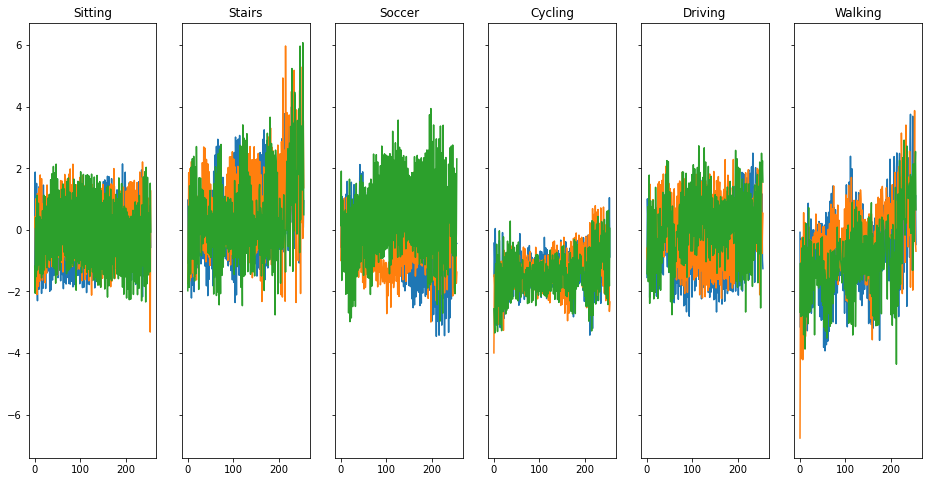

[[4411   22   21    0  109    8]
 [   3 3048    9    3    7  176]
 [  25   15 2177    4   75   16]
 [   0    2    8 3450   18    0]
 [  94    7   74    9 6650    7]
 [  43  304   34    0   19 4296]]


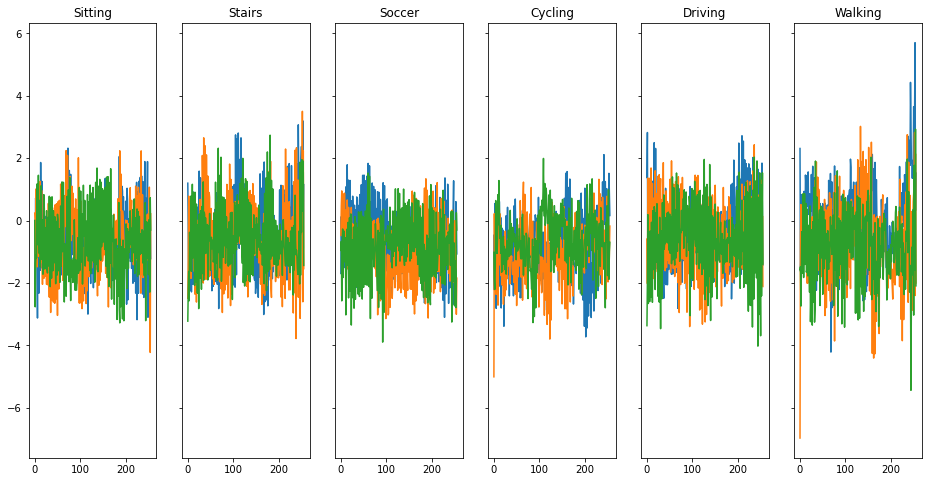

[[4412   18   22    0  108   11]
 [   2 3057    6    1   10  170]
 [  23   18 2197    2   56   16]
 [   0    3    4 3440   30    1]
 [ 127    4  103   10 6595    2]
 [  25  267   26    0   19 4359]]


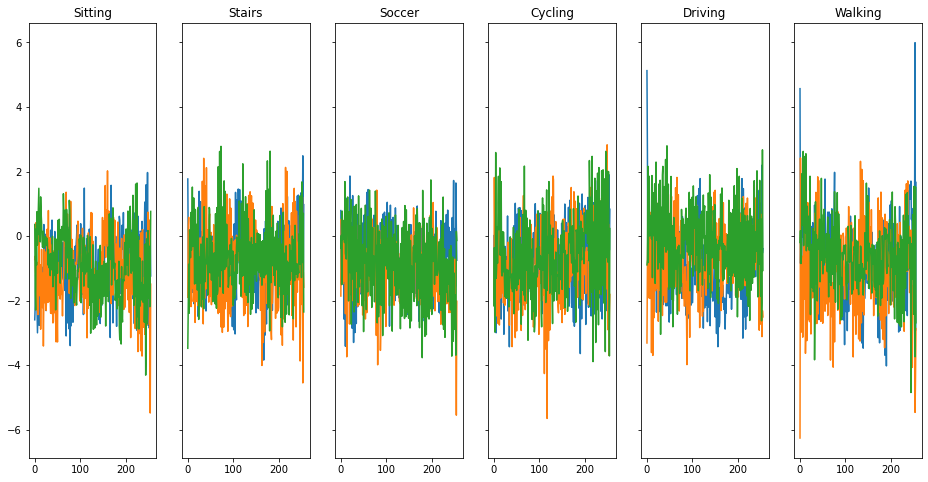

[[4446   21   21    0   76    7]
 [   3 3053    9    1    5  175]
 [  30   12 2165    6   76   23]
 [   0    4    7 3446   21    0]
 [ 152    6   63    4 6611    5]
 [  33  212   28    0   14 4409]]


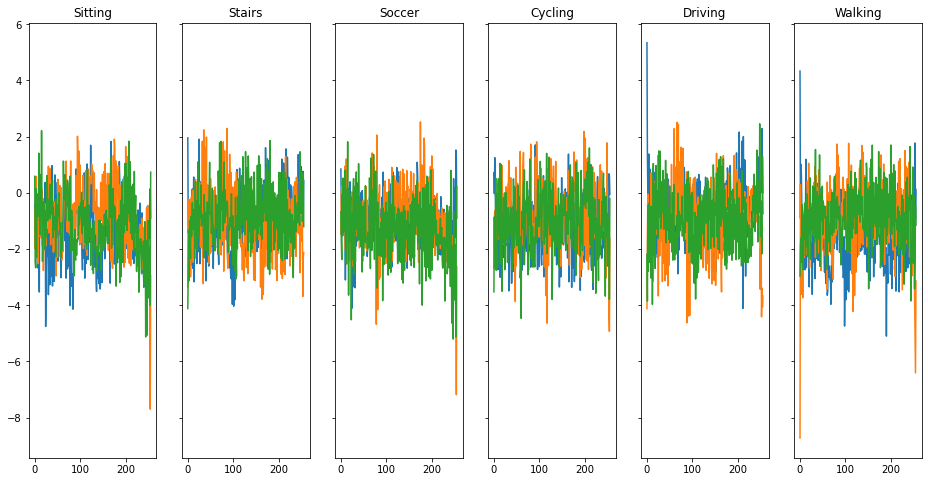

[[4400   24   21    0  118    8]
 [   1 3133    3    1   10   98]
 [  30   16 2172    2   75   17]
 [   0    3    4 3455   16    0]
 [ 127    5   65   12 6624    8]
 [  48  322   18    1   20 4287]]


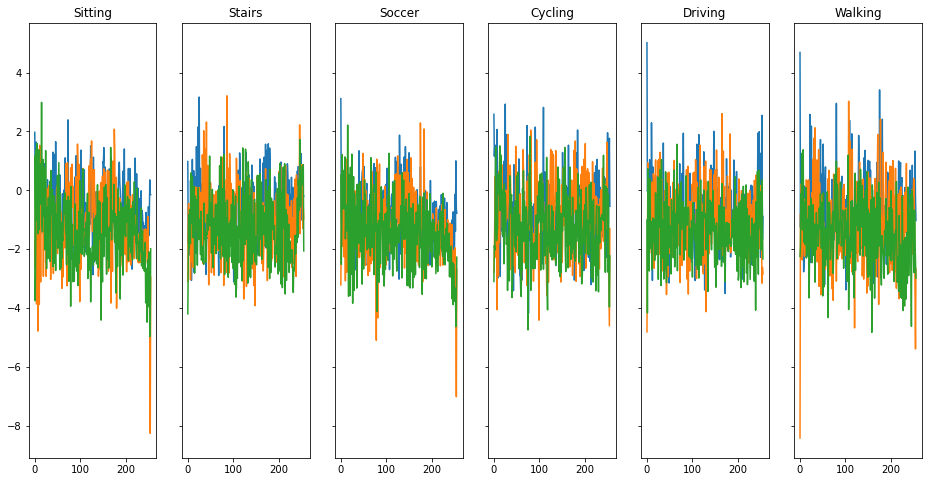

[[4334   19   23    0  186    9]
 [   3 3045    6    0   24  168]
 [  38   23 2128    4  102   17]
 [   0    4    8 3453   12    1]
 [ 101    2   96    7 6633    2]
 [  27  251   41    0   37 4340]]


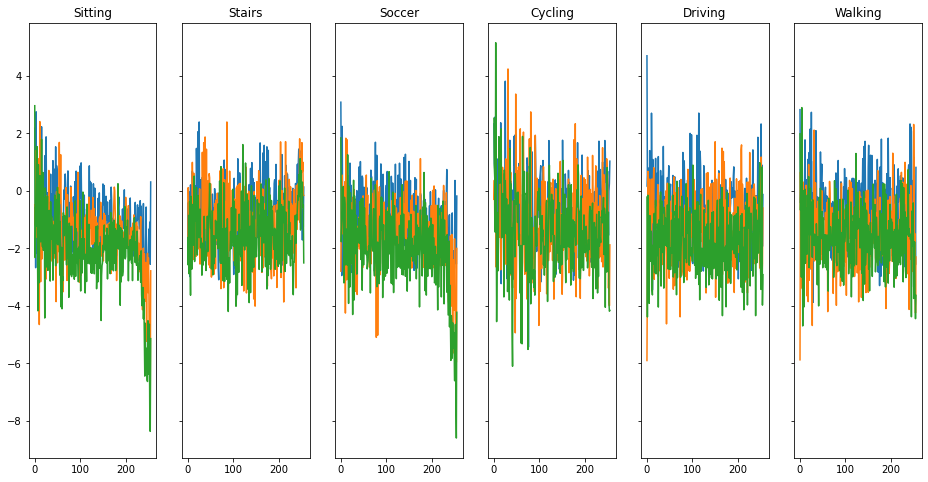

[[4414   21   26    0  102    8]
 [   3 3083   14    1    6  139]
 [  23    8 2169    4   88   20]
 [   0    0    6 3440   30    2]
 [ 104    5   47   11 6670    4]
 [  32  258   24    0   12 4370]]


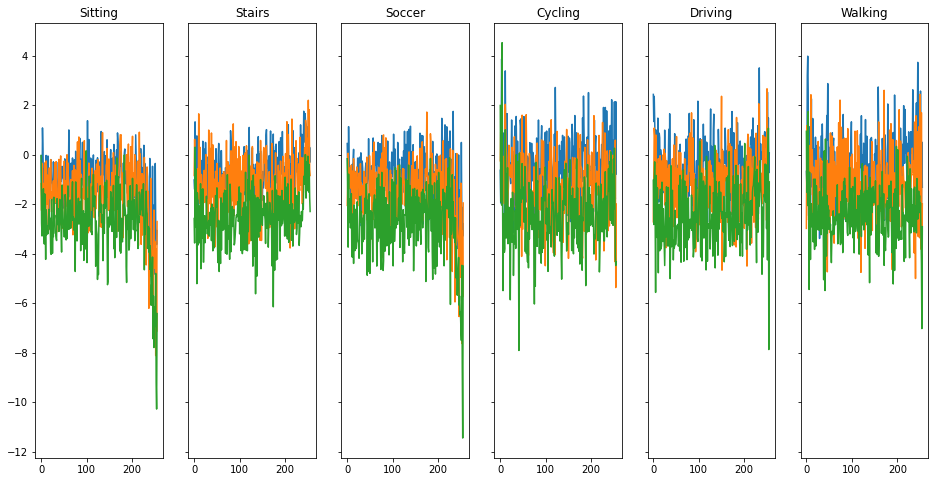

[[4394   18   29    0  120   10]
 [   2 3125    7    1    9  102]
 [  23   13 2203    2   56   15]
 [   0    4    7 3451   15    1]
 [  68    3   53    8 6707    2]
 [  23  260   27    0   16 4370]]


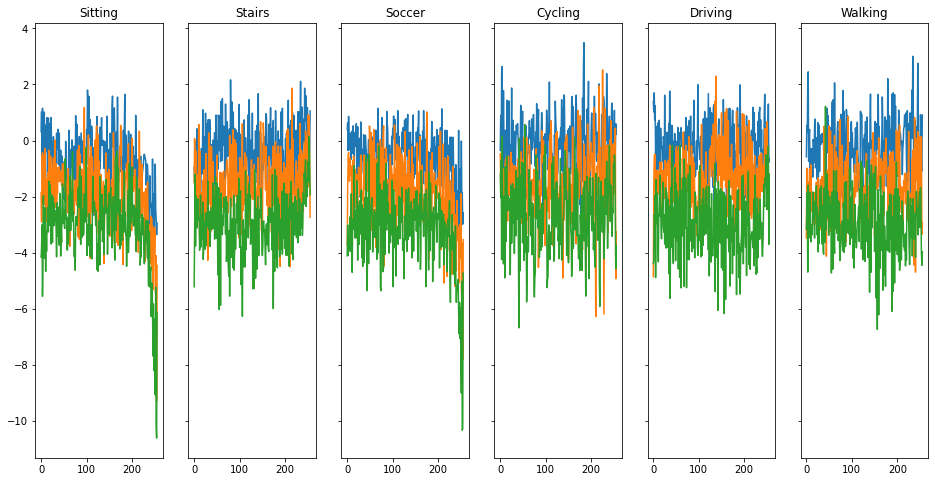

[[4426   15   17    0  104    9]
 [   2 3032   11    3    6  192]
 [  28    7 2179    6   76   16]
 [   0    2    8 3453   14    1]
 [  88    1   48    7 6693    4]
 [  33  177   23    0   21 4442]]


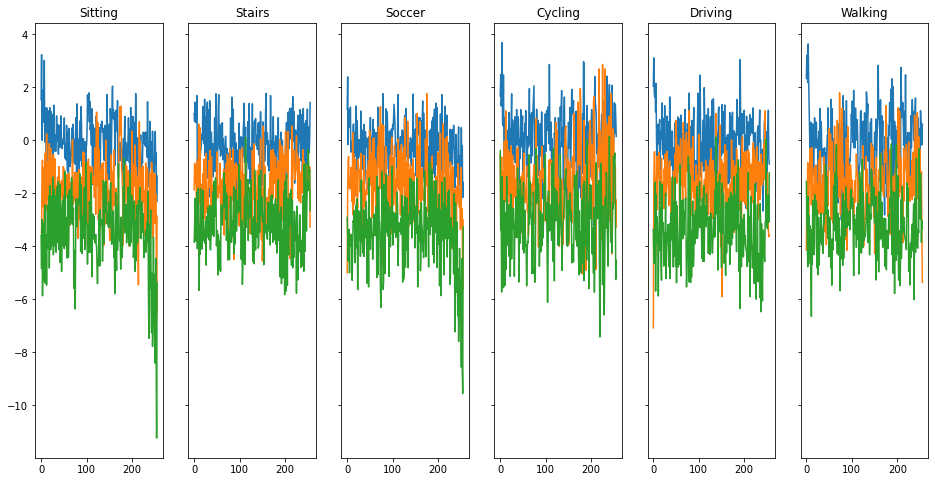

[[4425   19   32    0   87    8]
 [   1 3121    4    0    7  113]
 [  16   13 2193    7   66   17]
 [   0    3    2 3455   18    0]
 [ 100    3   59   16 6653   10]
 [  24  226   23    1   14 4408]]


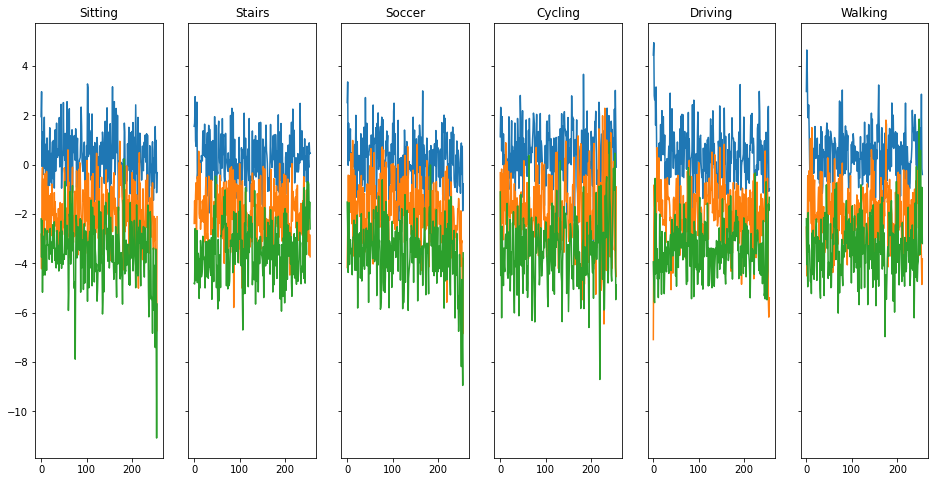

[[4423   18   25    0   90   15]
 [   3 3141    4    0    7   91]
 [  26   10 2201    1   63   11]
 [   0    1    6 3449   22    0]
 [ 108    4   48    7 6673    1]
 [  26  251   30    0   18 4371]]


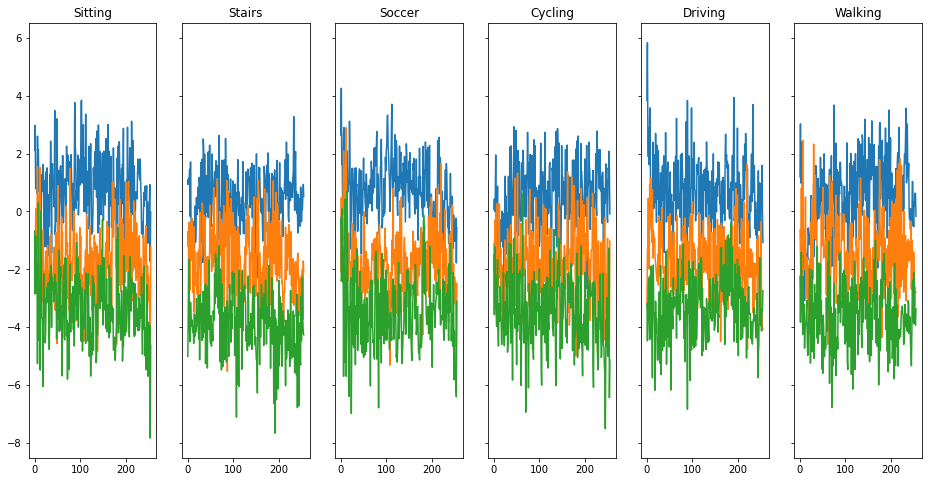

[[4442   15   27    0   81    6]
 [   5 3162    7    0    7   65]
 [  26   11 2211    2   51   11]
 [   0    3    8 3454   12    1]
 [  97    2   57   11 6671    3]
 [  27  269   26    0   16 4358]]


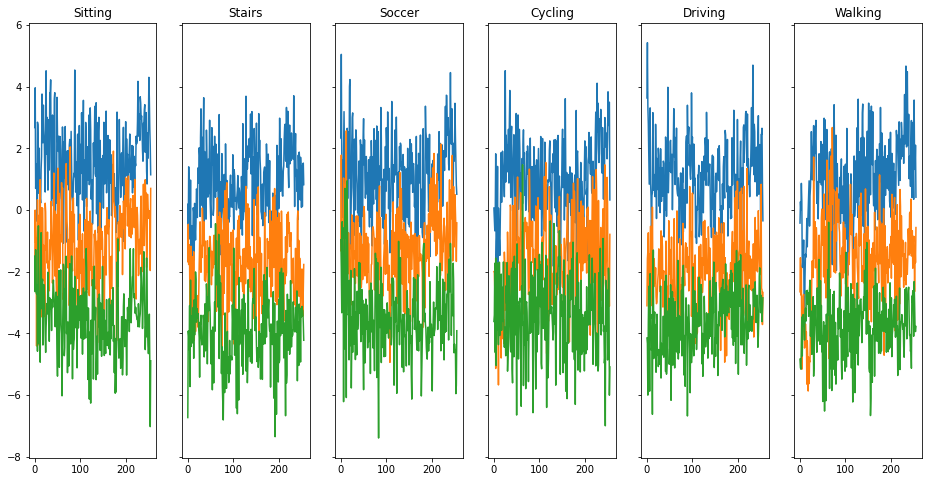

[[4350   18   28    0  165   10]
 [   2 3115    5    0    8  116]
 [  22   18 2203    3   55   11]
 [   0    1    5 3454   16    2]
 [  73    1   68    5 6687    7]
 [  25  224   25    0   20 4402]]


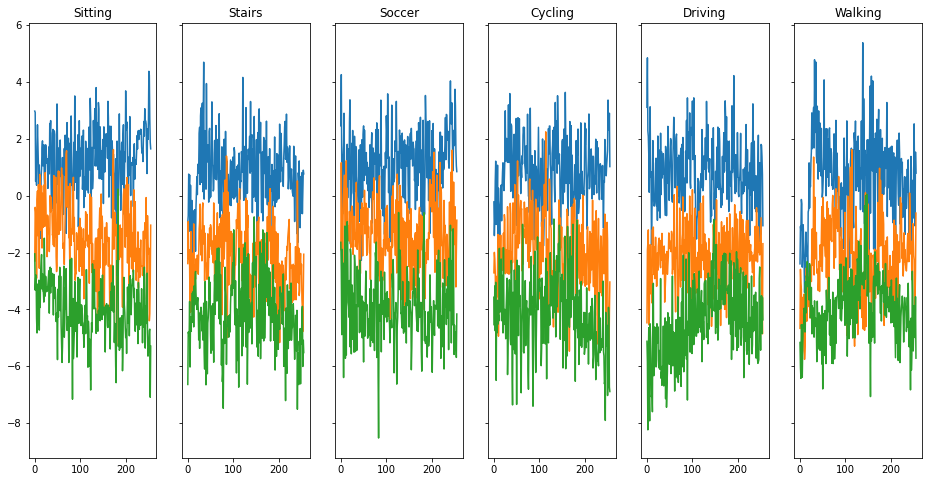

[[4423   16   19    0  102   11]
 [   5 3111    2    0    7  121]
 [  26    9 2216    4   52    5]
 [   0    0    5 3450   21    2]
 [  94    0   73    6 6666    2]
 [  26  163   28    0   19 4460]]


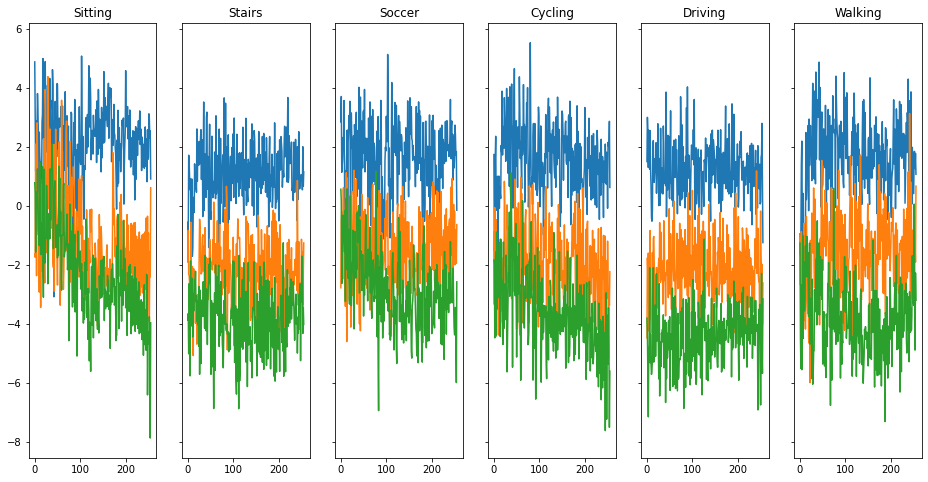

[[4391   14   37    0  121    8]
 [   6 3086   10    1   14  129]
 [  27    6 2198    3   68   10]
 [   0    1    3 3450   22    2]
 [ 135    1   65    7 6627    6]
 [  17  181   48    1   23 4426]]


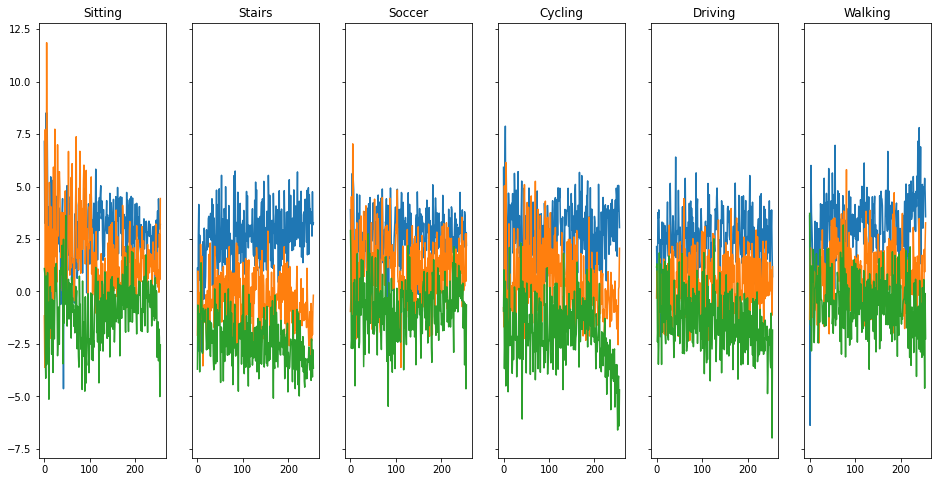

[[4440   14   25    0   76   16]
 [   2 3124   11    0    4  105]
 [  19   15 2202    4   59   13]
 [   0    2    7 3454   14    1]
 [ 110    4   49    3 6673    2]
 [  27  229   31    0   14 4395]]


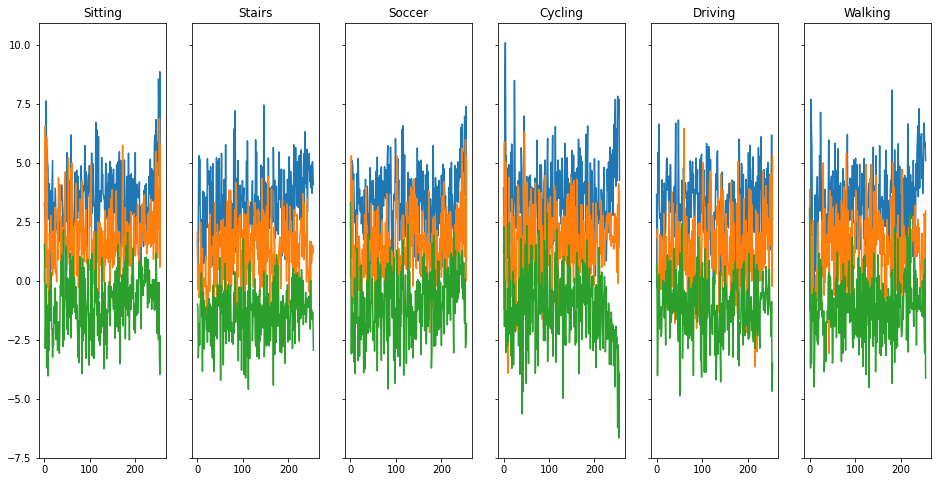

[[4456   14   18    0   69   14]
 [   3 3107   10    1    6  119]
 [  26   12 2142    2  111   19]
 [   0    2    5 3447   23    1]
 [ 147    2   40    9 6633   10]
 [  27  182   22    1   18 4446]]


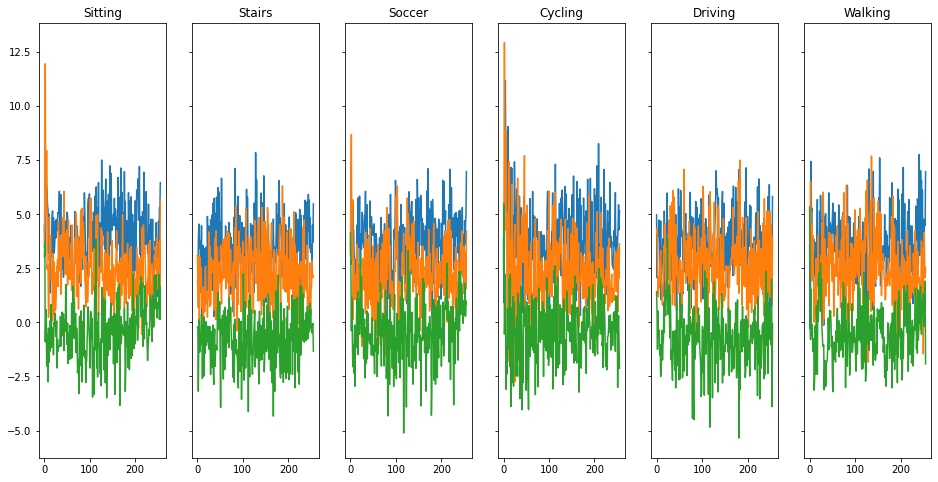

[[4451   18   22    0   68   12]
 [   2 3165    4    1    2   72]
 [  19    8 2174    5   80   26]
 [   0    3    8 3442   23    2]
 [ 141    0   48    9 6636    7]
 [  34  310   23    3   15 4311]]


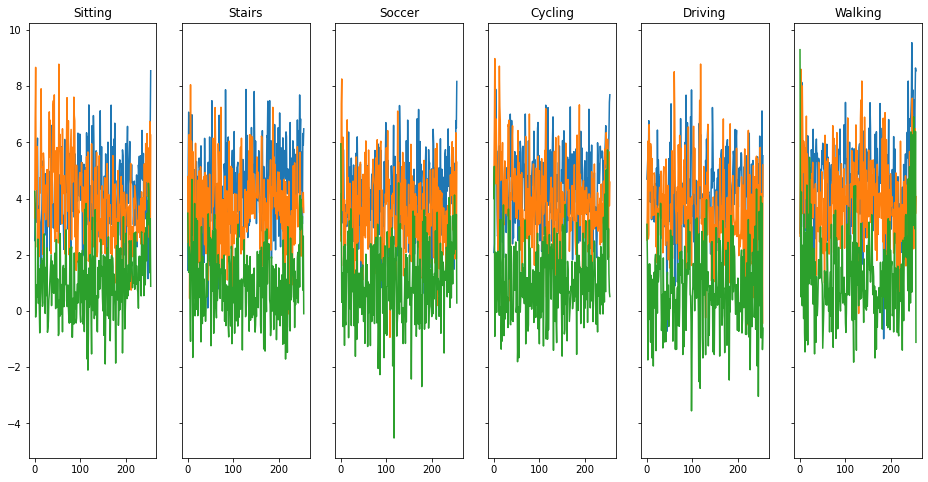

[[4410   12   37    0   94   18]
 [   1 3111    4    0   11  119]
 [  20   12 2176    6   76   22]
 [   0    3    5 3450   20    0]
 [ 123    3   57    9 6643    6]
 [  31  187   21    1   21 4435]]


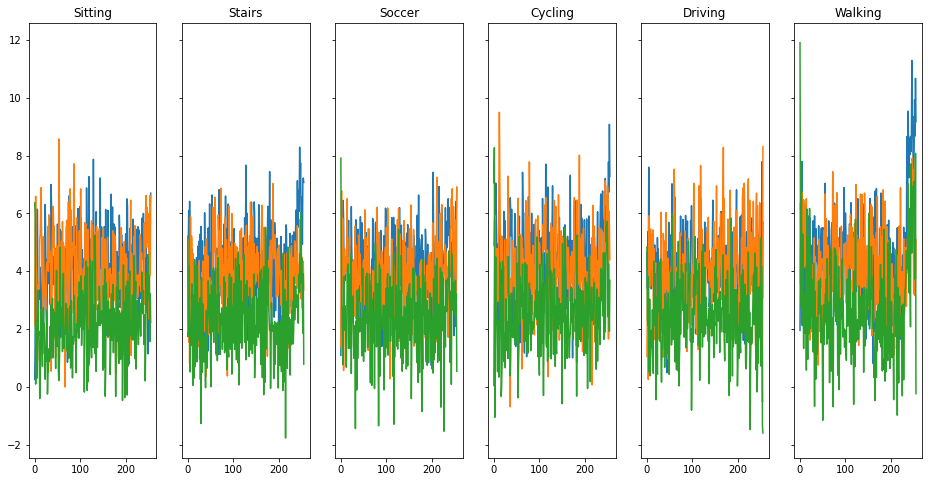

[[4445   13   23    0   80   10]
 [   7 3083   10    1    6  139]
 [  25    9 2194    4   70   10]
 [   0    2    7 3445   23    1]
 [ 121    1   57   12 6647    3]
 [  40  170   33    0   20 4433]]


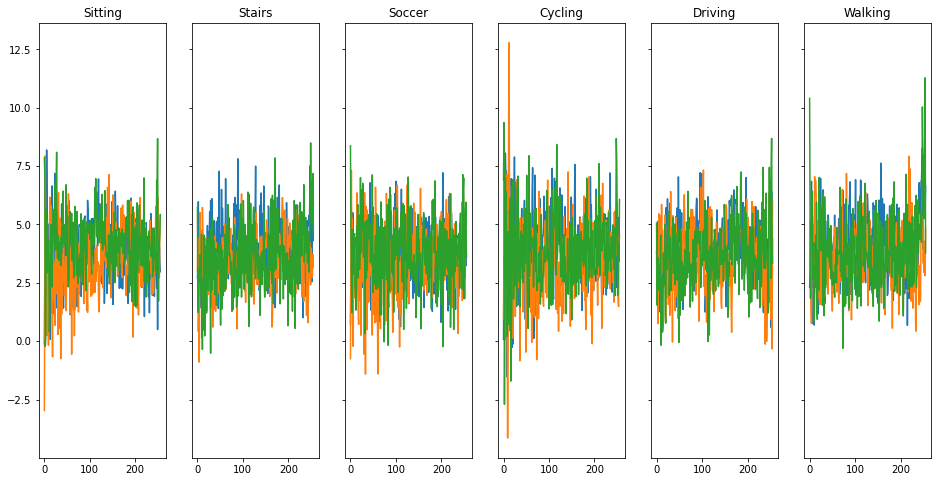

[[4426   15   22    0   98   10]
 [   2 3162    7    0    6   69]
 [  37   19 2179    2   54   21]
 [   0    4    8 3452   12    2]
 [  93    5   58   15 6661    9]
 [  41  304   18    0   22 4311]]


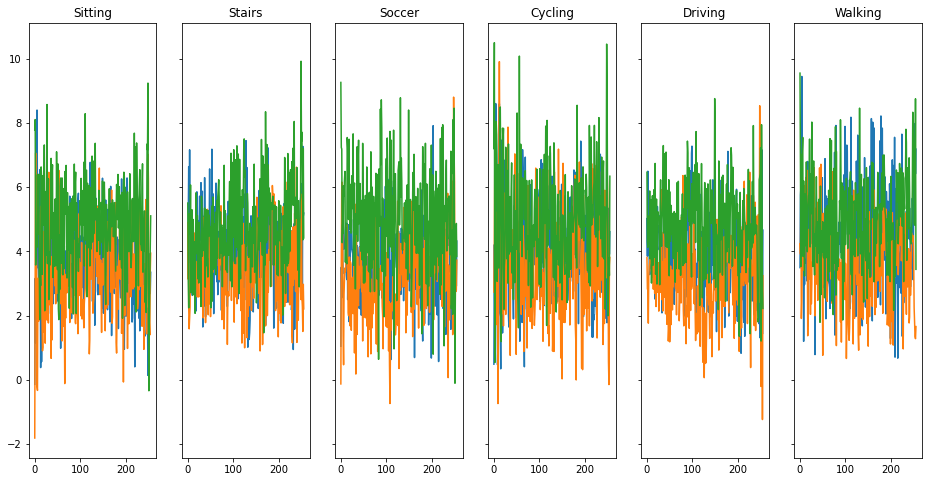

[[4443   12   22    0   72   22]
 [   6 3102   11    2    2  123]
 [  23    6 2188    4   62   29]
 [   0    2    6 3449   20    1]
 [ 139    7   63    7 6612   13]
 [  21  167   31    1   14 4462]]


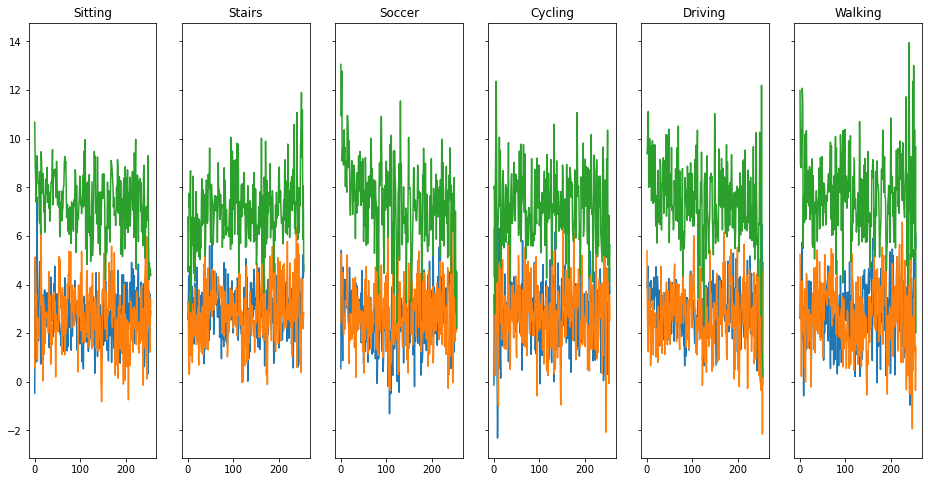

[[4437   12   22    0   90   10]
 [   4 3128    4    1    3  106]
 [  29   13 2177    8   71   14]
 [   0    3    6 3443   26    0]
 [ 115    1   46    8 6669    2]
 [  39  200   28    0   18 4411]]


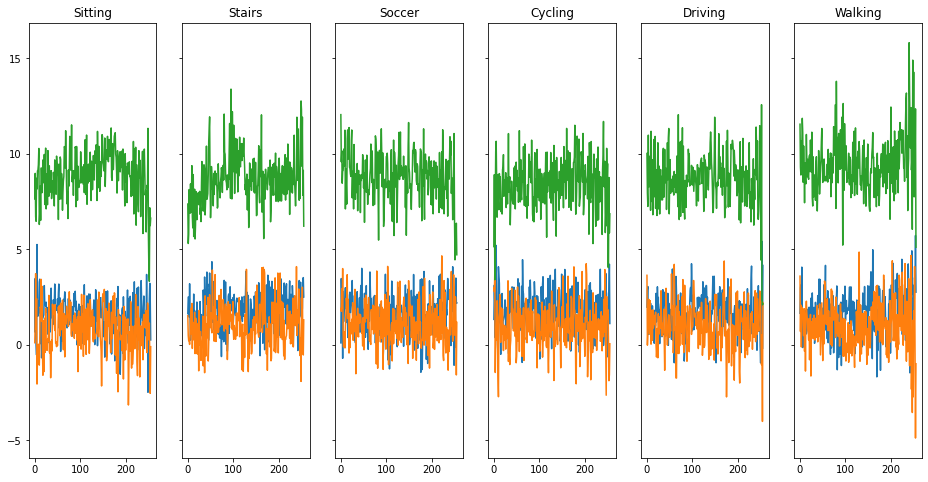

[[4451   10   26    0   78    6]
 [   3 3153    8    2    6   74]
 [  21    7 2190    4   73   17]
 [   0    2   12 3441   20    3]
 [ 122    2   55    8 6651    3]
 [  36  189   18    0   17 4436]]


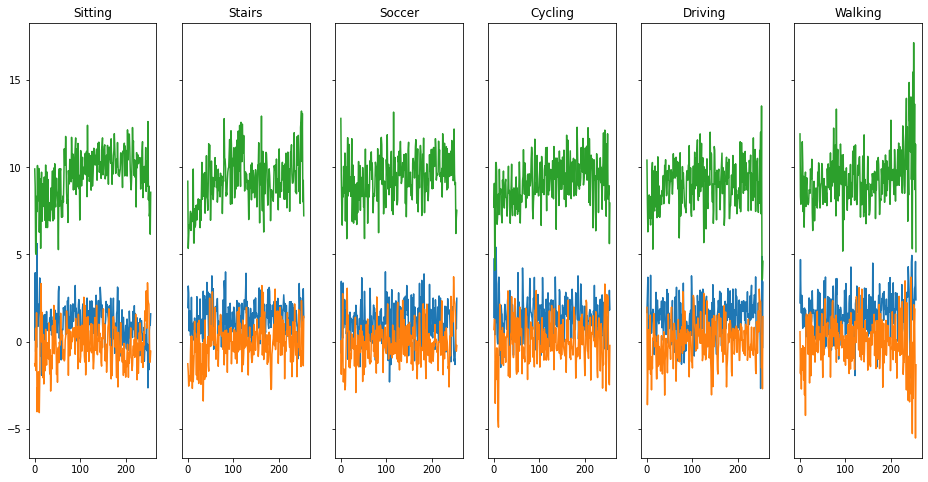

[[4438   12   28    0   82   11]
 [   2 3133    8    0    2  101]
 [  15    9 2197    4   75   12]
 [   0    3    3 3461   11    0]
 [ 103    2   42   14 6675    5]
 [  25  181   19    0   17 4454]]


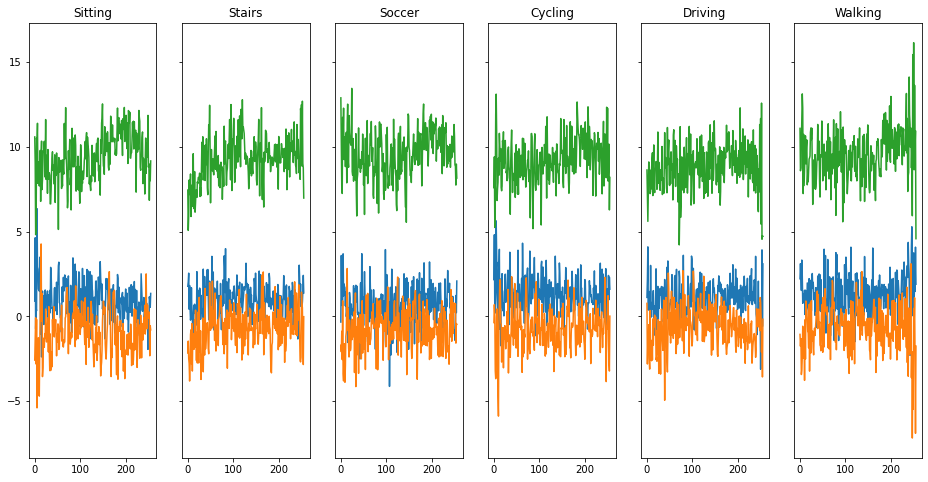

[[4460   15   22    0   65    9]
 [   7 3099    5    0    8  127]
 [  29    9 2188    4   64   18]
 [   0    1    3 3457   16    1]
 [ 135    3   46    5 6643    9]
 [  39  136   17    0   16 4488]]


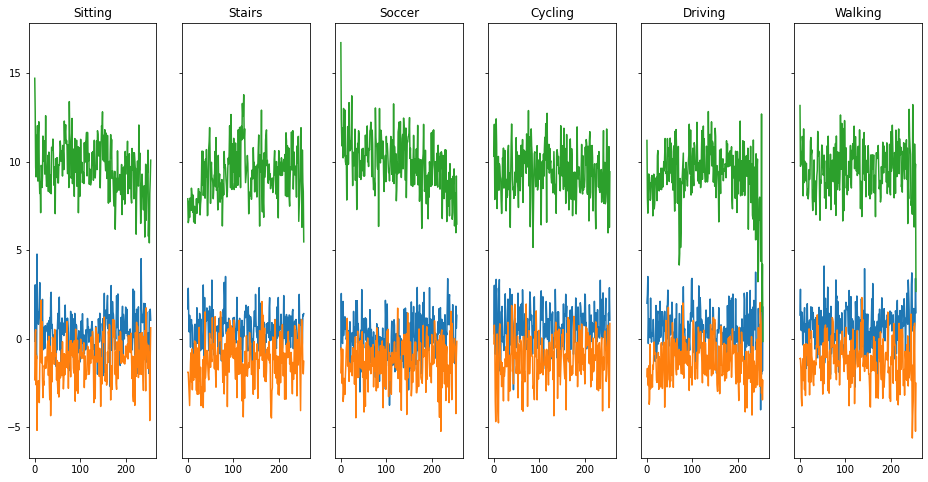

[[4461   14   18    0   69    9]
 [   4 3138    3    0    4   97]
 [  29    5 2208    3   56   11]
 [   0    1    5 3455   15    2]
 [ 120    3   40    7 6668    3]
 [  31  176   18    0   11 4460]]


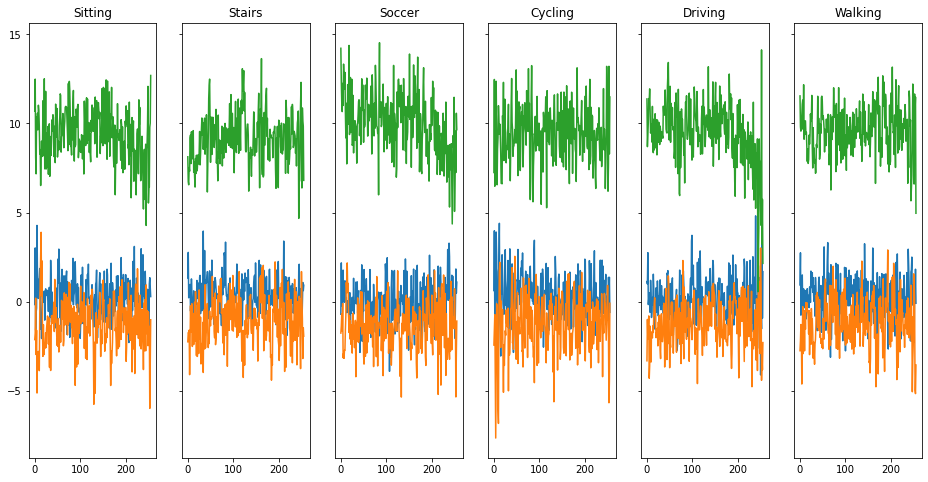

[[4454    7   26    0   67   17]
 [   4 3114   11    0    4  113]
 [  12    5 2212    1   68   14]
 [   0    2    5 3459   12    0]
 [ 105    3   41    7 6682    3]
 [  19  136   27    0   16 4498]]


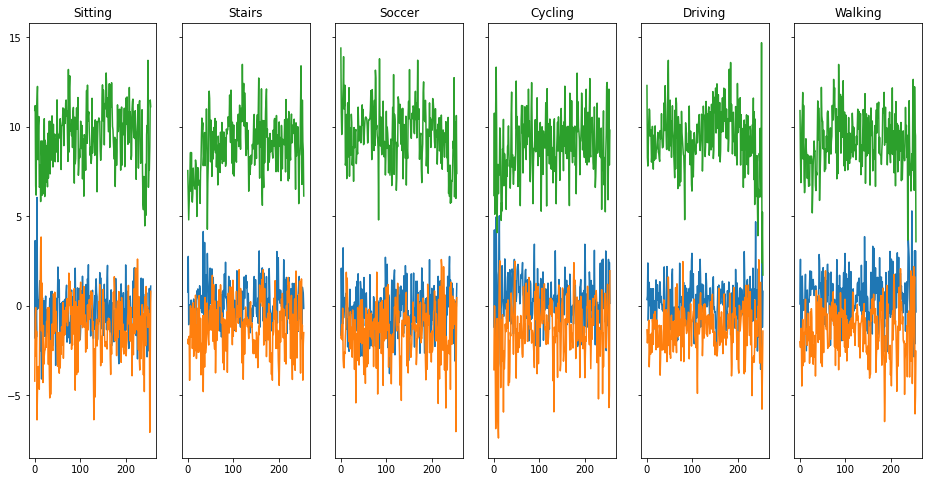

[[4443    5   23    0   89   11]
 [   4 3108    9    2    5  118]
 [  35    8 2192    2   57   18]
 [   0    1    5 3453   19    0]
 [ 151    1   47    3 6629   10]
 [  26  100   24    0   14 4532]]


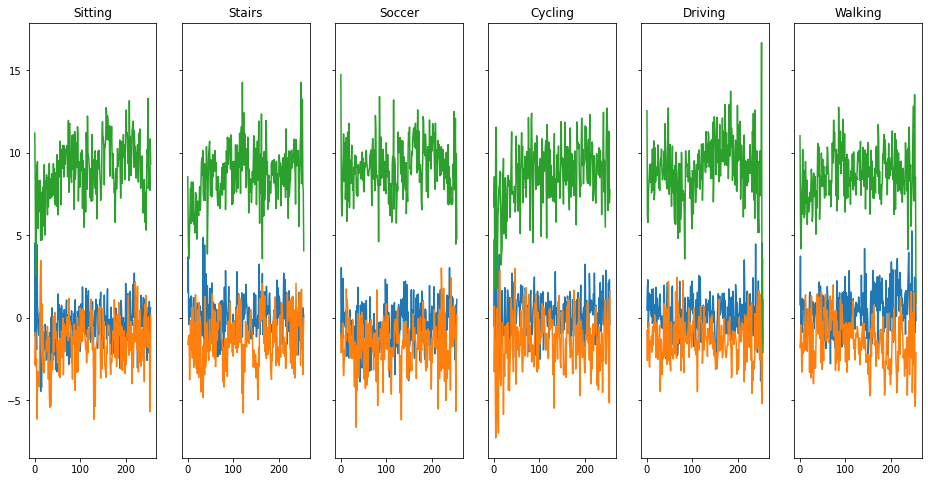

[[4450   11   28    0   68   14]
 [   1 3112    7    0    4  122]
 [  12    6 2193    3   72   26]
 [   0    1    2 3462   13    0]
 [ 112    1   53    8 6658    9]
 [  21  125   20    0   10 4520]]


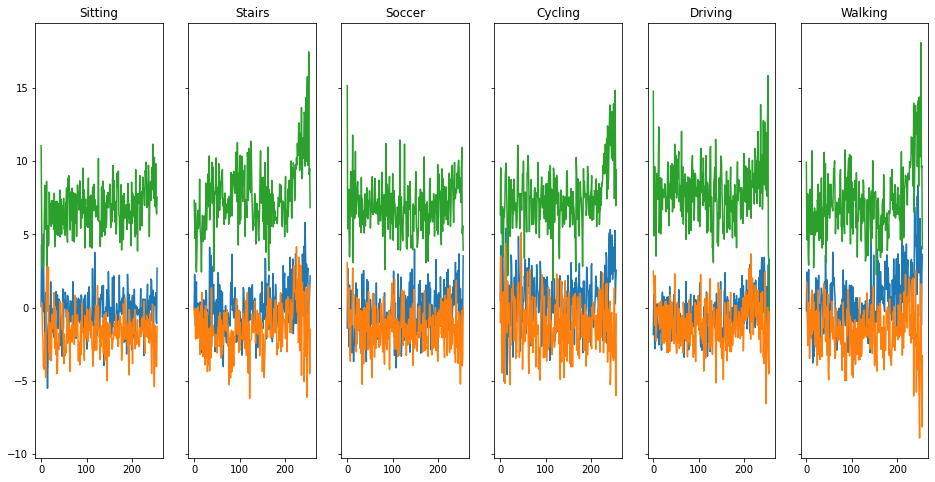

[[4457    8   24    0   73    9]
 [   5 3163    5    0    2   71]
 [  23   11 2221    3   43   11]
 [   0    1    4 3459   13    1]
 [ 137    2   68   11 6617    6]
 [  42  155   18    1    8 4472]]


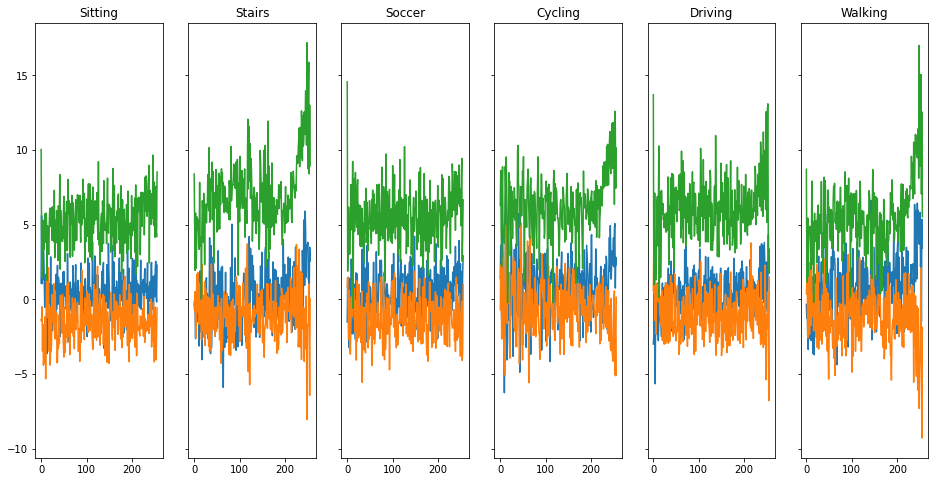

[[4452    9   20    0   78   12]
 [   6 3099    7    1    9  124]
 [  22    6 2212    2   52   18]
 [   0    1    6 3456   13    2]
 [ 111    1   50    9 6665    5]
 [  31  137   16    0   12 4500]]


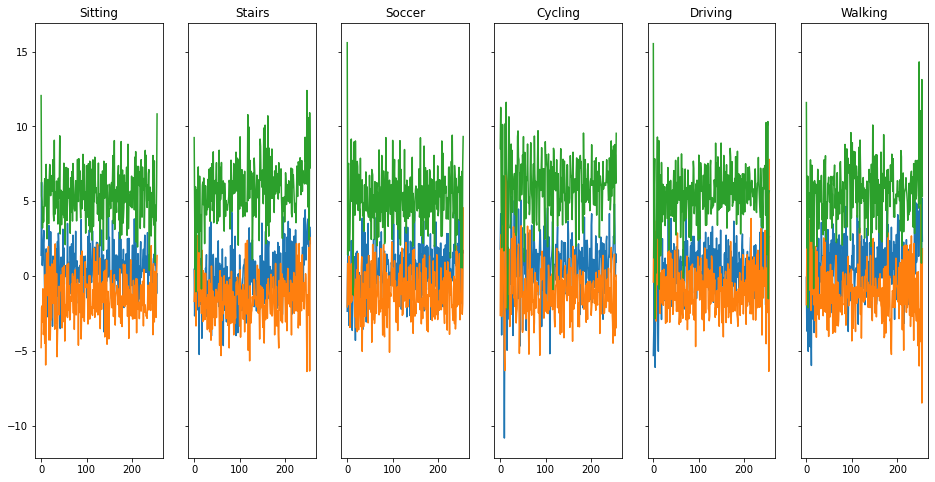

[[4476   10   31    0   44   10]
 [   2 3153    7    3    4   77]
 [  15    7 2219    4   56   11]
 [   0    1    3 3452   22    0]
 [ 145    1   39    4 6645    7]
 [  29  146   18    1   12 4490]]


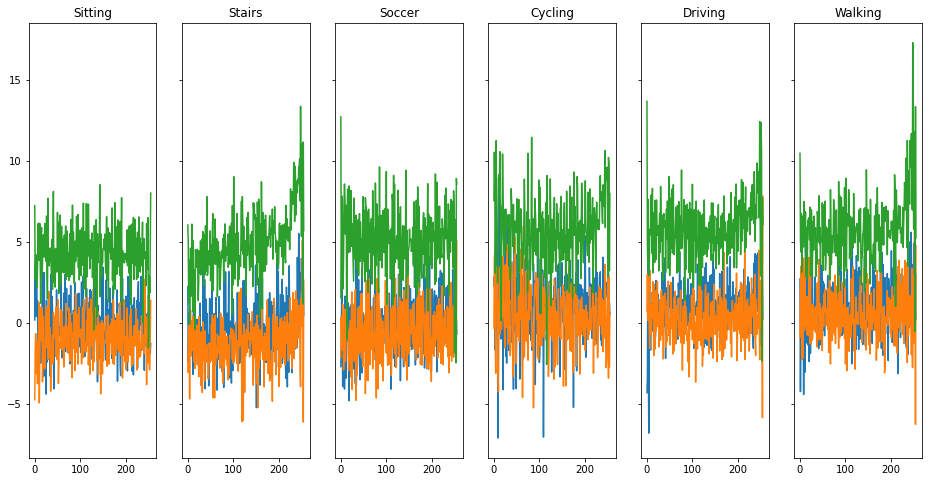

[[4290    2   37    0  233    9]
 [   8 3109    4    0    9  116]
 [  46   14 2200    3   40    9]
 [   0    1    4 3451   20    2]
 [ 108    3   73    7 6646    4]
 [  28  147   36    0   29 4456]]


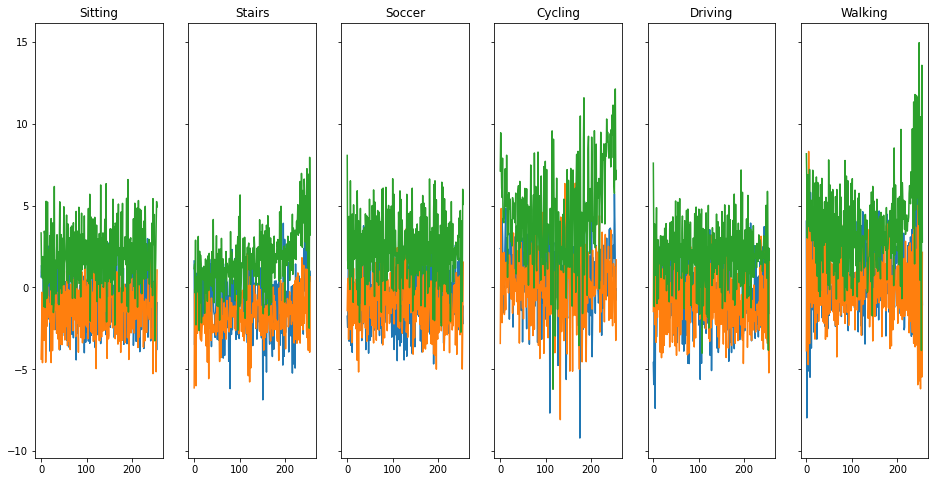

[[4371    7   19    0  157   17]
 [   8 3095    6    0   18  119]
 [  41   15 2166    3   74   13]
 [   0    1    9 3449   18    1]
 [  83    0   73   23 6653    9]
 [  30  197   28    1   38 4402]]


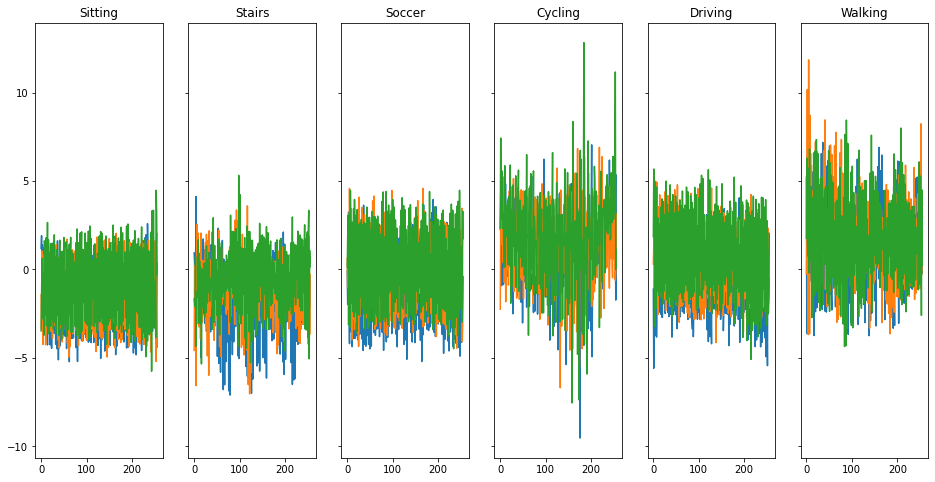

[[4410   10   28    0  111   12]
 [   5 3106    8    0    9  118]
 [  27   18 2156    4   87   20]
 [   0    5   16 3419   37    1]
 [ 128    5   74    3 6627    4]
 [  25  214   29    0   13 4415]]


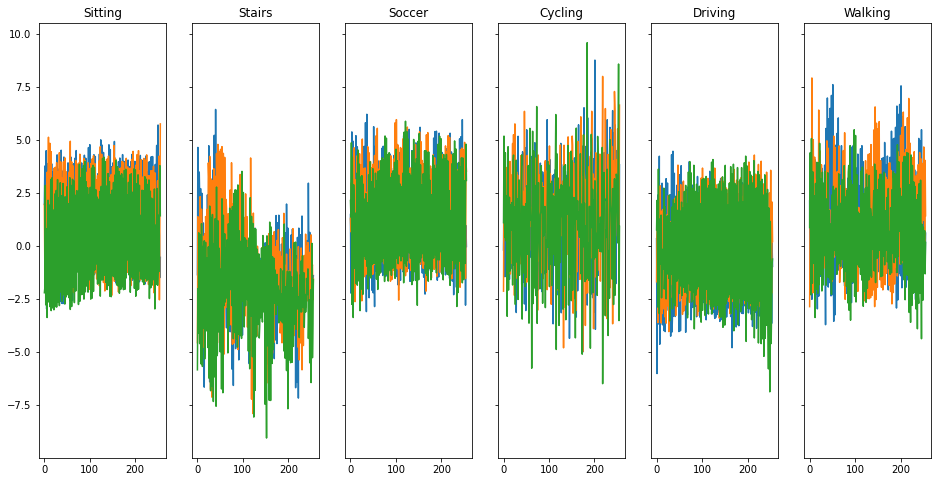

[[3683   25   39   24  791    9]
 [  51 2980   14    0   17  184]
 [ 109   11 2082    6   74   30]
 [  16    6  151 3222   77    6]
 [ 762   13  330    4 5713   19]
 [  67  439   77    5   26 4082]]


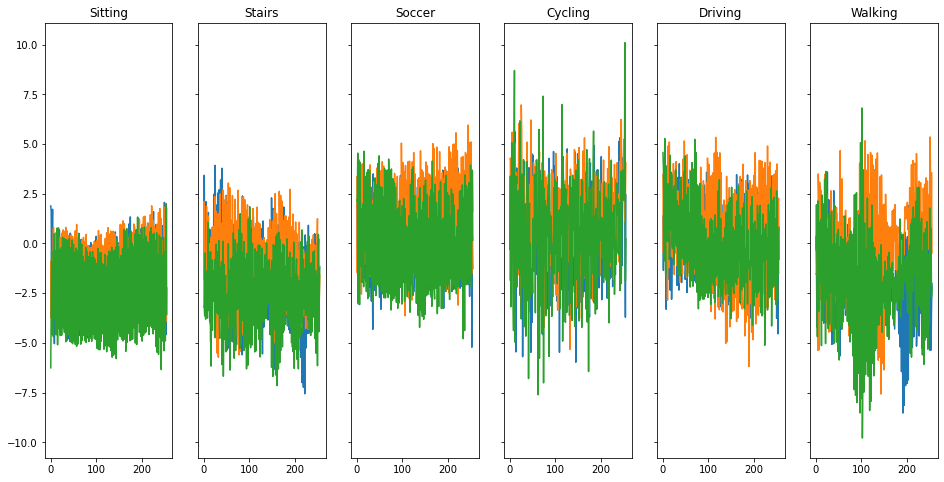

[[4400   13   30    0  111   17]
 [  13 3112    6    1    4  110]
 [  30   14 2178    4   76   10]
 [   0    4    9 3441   24    0]
 [  93    4   60    5 6662   17]
 [  29  205   33    0   14 4415]]


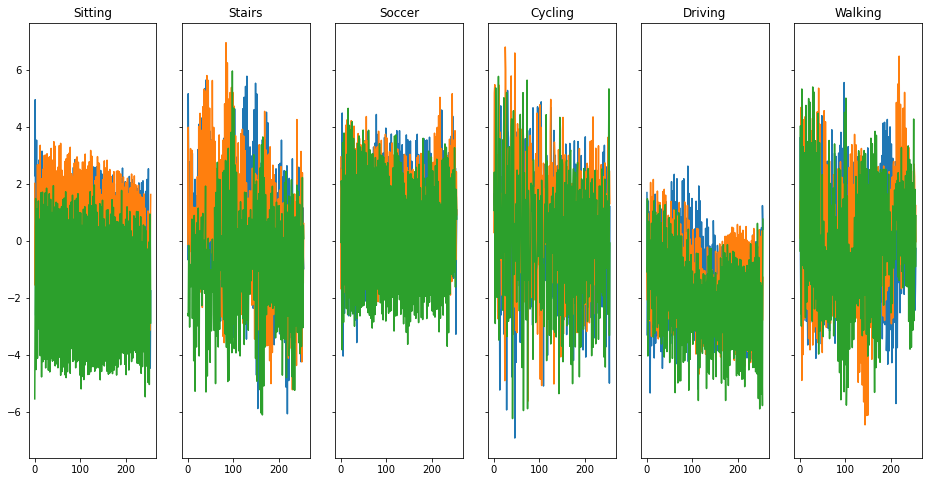

[[4390   12   37    0  124    8]
 [   7 3108    8    2   11  110]
 [  20   12 2205    6   57   12]
 [   0    0    8 3444   23    3]
 [  74    2   74   11 6675    5]
 [  27  238   40    0   19 4372]]


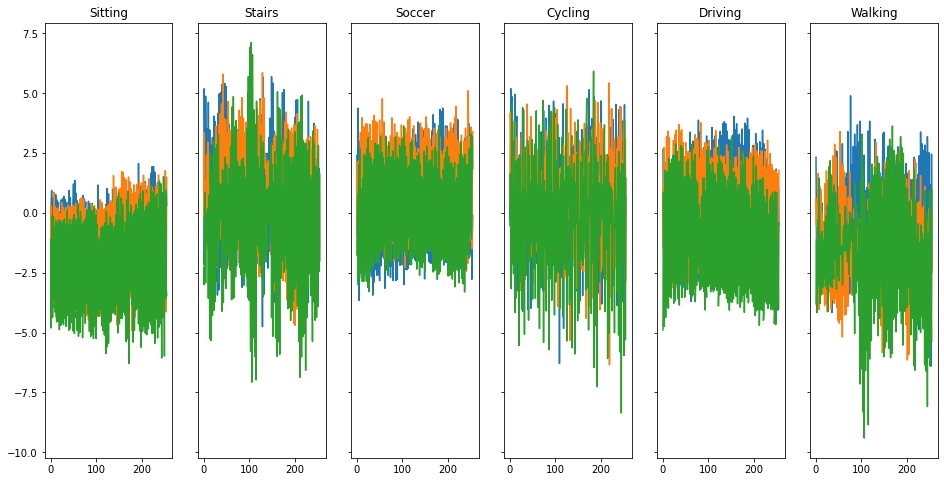

[[4406   14   34    0  108    9]
 [   7 3067    9    1   10  152]
 [  19   11 2204    5   65    8]
 [   0    0   10 3448   19    1]
 [ 101    0   73    8 6656    3]
 [  25  162   42    0   19 4448]]


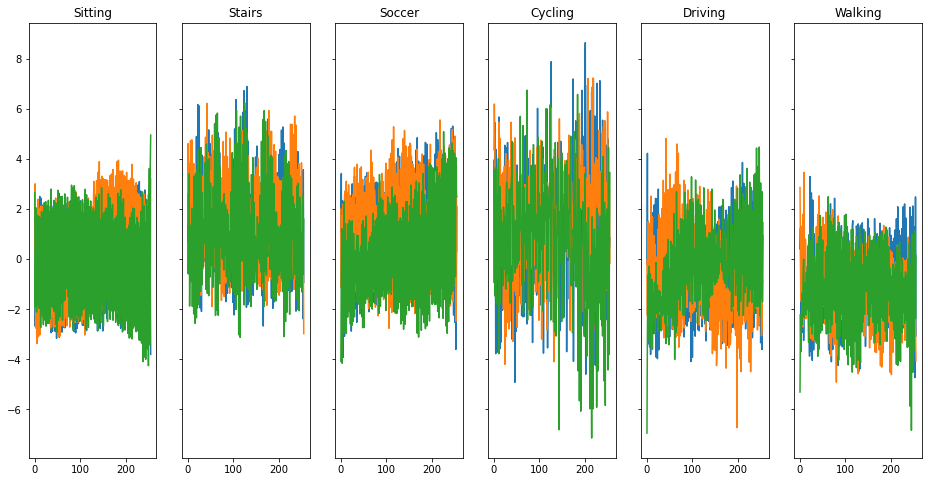

[[4445    9   21    0   80   16]
 [   3 3046   12    0   11  174]
 [  27   13 2189    4   68   11]
 [   0    2    4 3455   15    2]
 [ 127    2   79   19 6610    4]
 [  49  122   32    0   18 4475]]


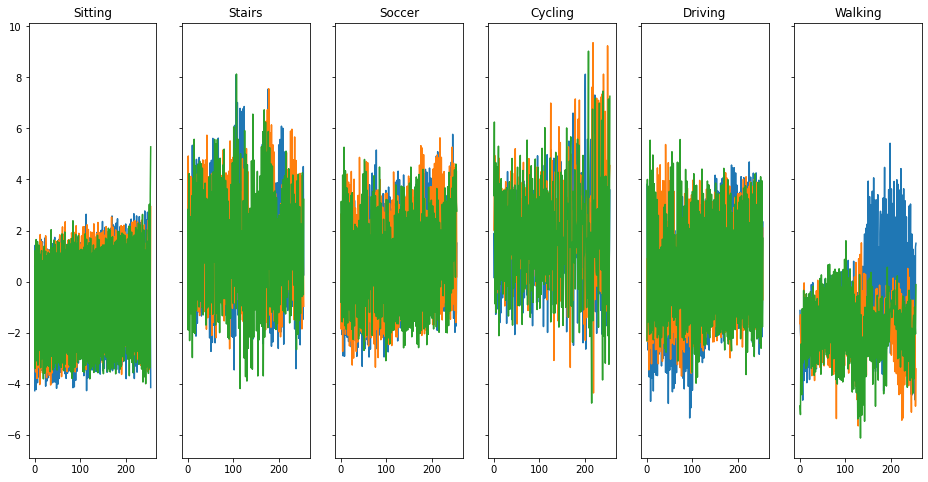

[[4410   16   23    0  114    8]
 [   7 3134    6    0    9   90]
 [  35   15 2181    6   65   10]
 [   0    3    6 3448   18    3]
 [  83    6   50    7 6692    3]
 [  42  220   32    0   14 4388]]


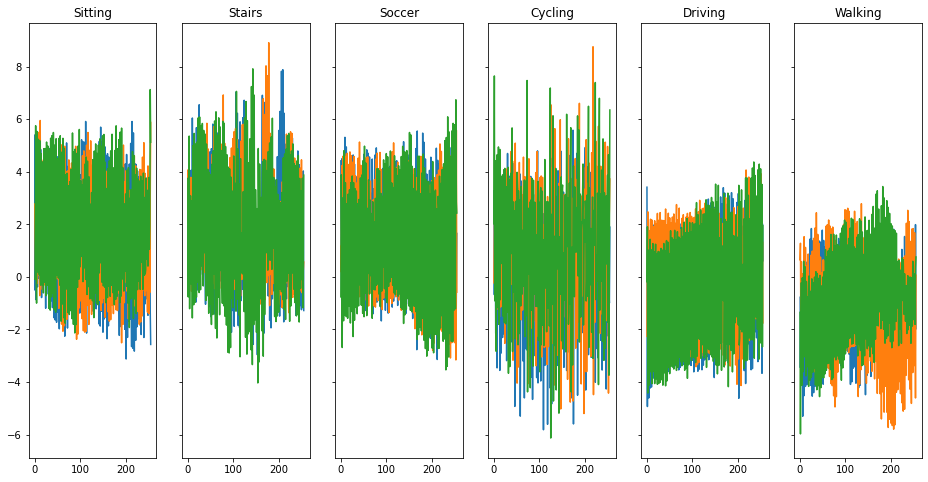

[[4439   15   25    0   80   12]
 [   6 3102    6    1    9  122]
 [  24    6 2190    2   71   19]
 [   0    1    8 3448   20    1]
 [  96    3   65    7 6665    5]
 [  35  159   29    0   16 4457]]


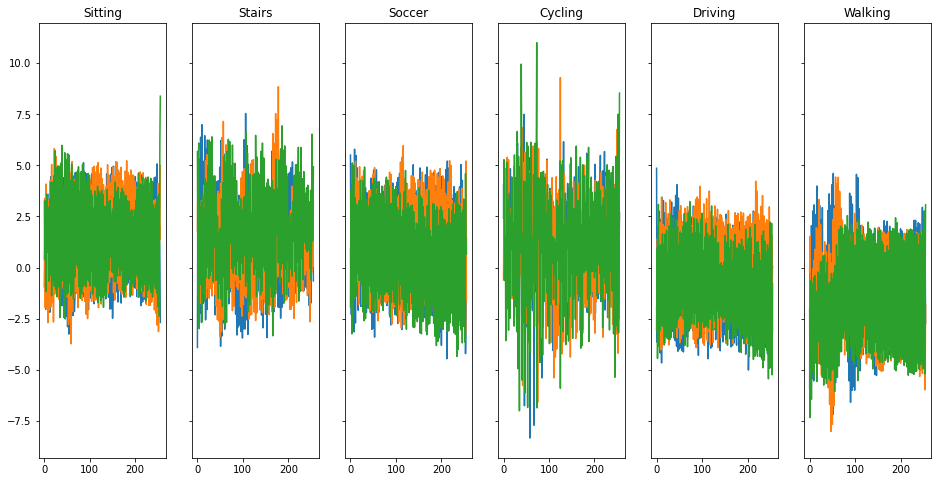

[[4400   27   21    0  106   17]
 [   2 3135   10    1    4   94]
 [  19   12 2163    4   86   28]
 [   0    3   10 3452   13    0]
 [ 111    7   71    9 6637    6]
 [  25  268   19    0   14 4370]]


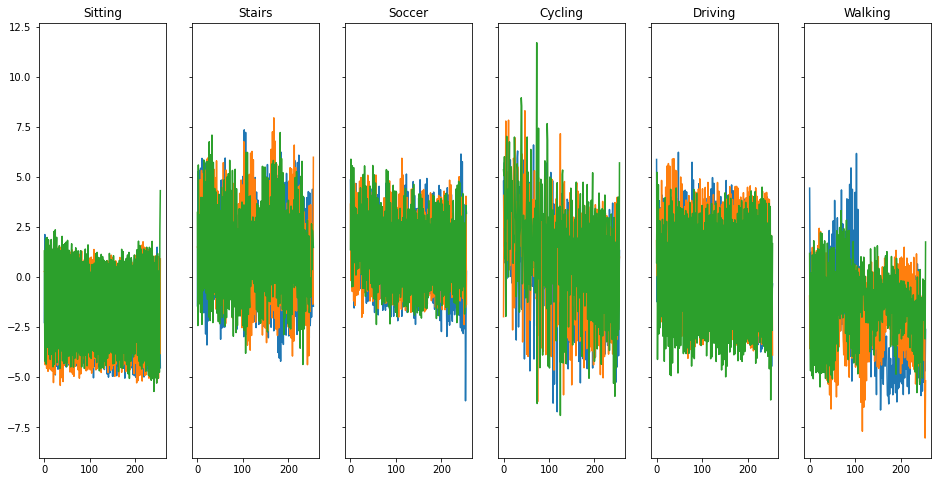

[[4413   18   20    0   95   25]
 [   1 3126   17    2    7   93]
 [  17    6 2185    3   86   15]
 [   0    0    9 3449   20    0]
 [  84    8   68    9 6656   16]
 [  22  185   33    0   11 4445]]


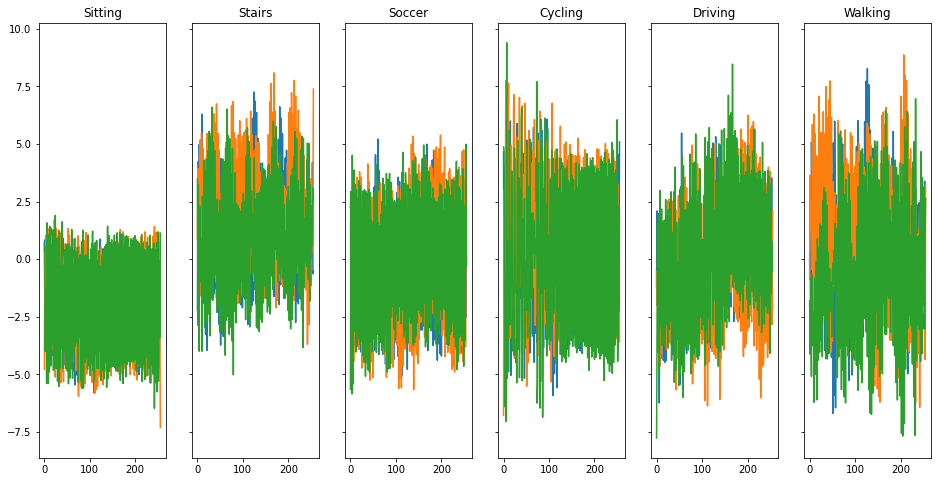

[[4434   13   22    0   86   16]
 [   5 3064   10    2   11  154]
 [  24    8 2212    2   57    9]
 [   0    0   10 3449   18    1]
 [ 107    0   93    6 6627    8]
 [  29  151   34    0   24 4458]]


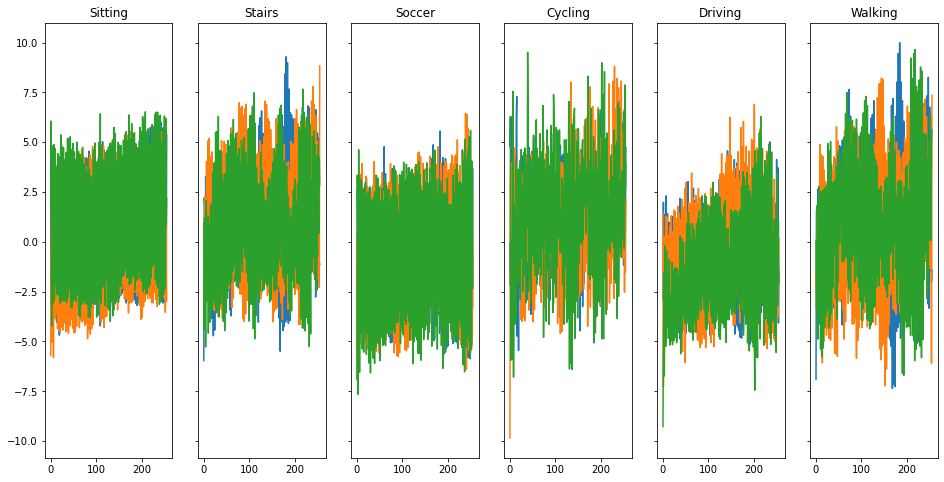

[[4435   18   19    0   88   11]
 [   9 3107    5    2    6  117]
 [  29   12 2181    4   72   14]
 [   0    1   11 3446   19    1]
 [ 132    6   76    6 6612    9]
 [  38  196   33    0   19 4410]]


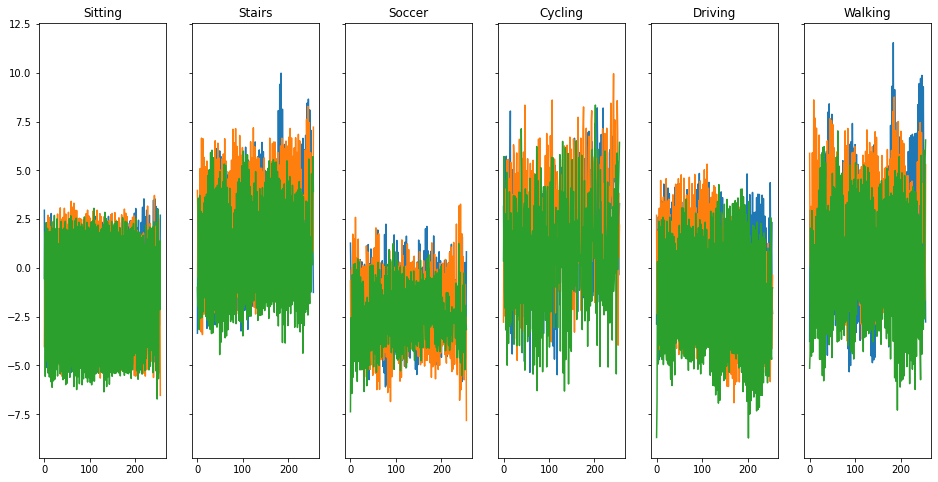

[[4445   16   28    0   69   13]
 [   6 3116    9    0    4  111]
 [  21    9 2220    2   47   13]
 [   0    0   11 3440   27    0]
 [ 132    2   90   10 6596   11]
 [  33  172   44    1   16 4430]]


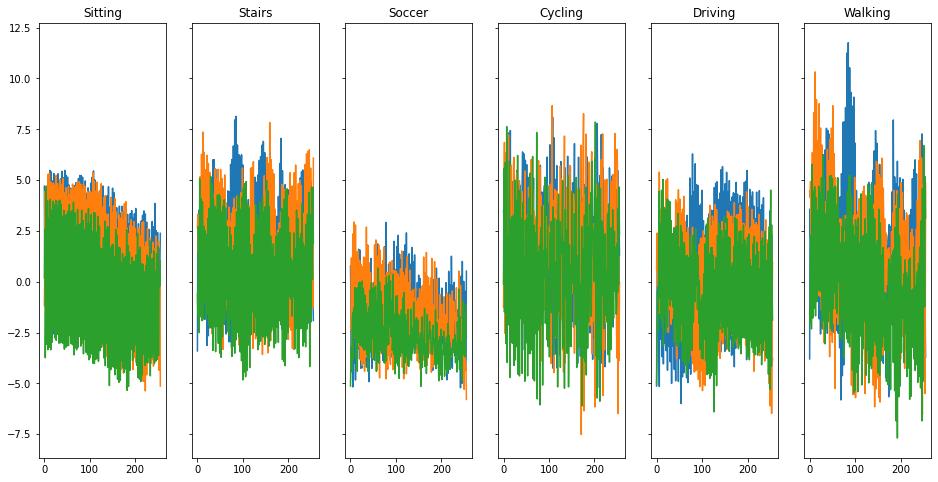

[[4384   13   33    0  133    8]
 [   3 3113    6    1   11  112]
 [  19    5 2212    6   63    7]
 [   0    2    4 3454   18    0]
 [  77    0   69   13 6676    6]
 [  26  146   33    0   32 4459]]


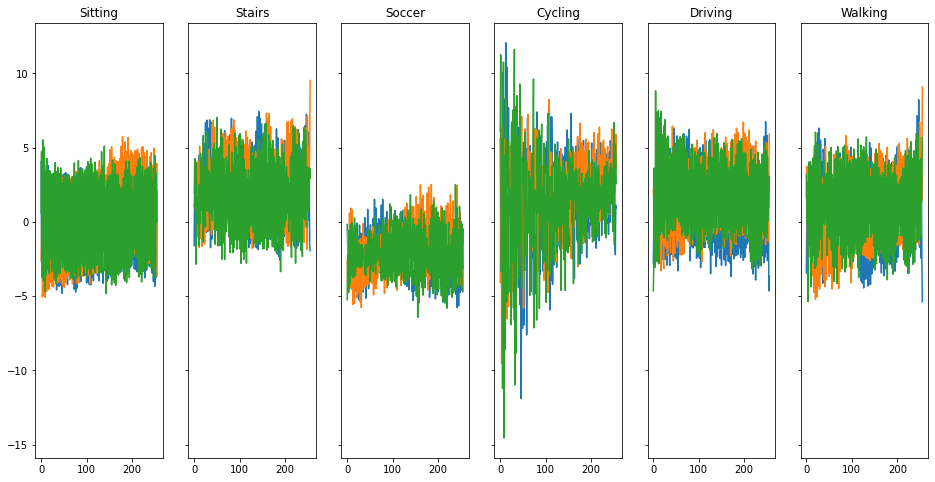

[[4039   20   43    1  456   12]
 [  21 3075   17    0    4  129]
 [  33   20 2035    8  177   39]
 [  10    7   23 3394   40    4]
 [ 346   28  216   24 6191   36]
 [  39  447   25    1   62 4122]]


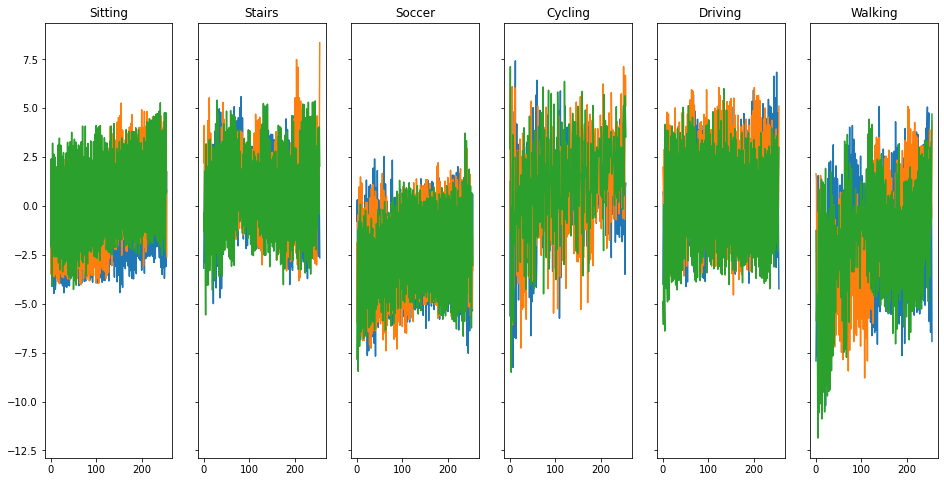

[[4425   19   21    0   97    9]
 [   3 3067   10    1   13  152]
 [  36   12 2163    9   83    9]
 [   0    0   10 3434   33    1]
 [ 137    7   71    6 6618    2]
 [  50  240   32    0   15 4359]]


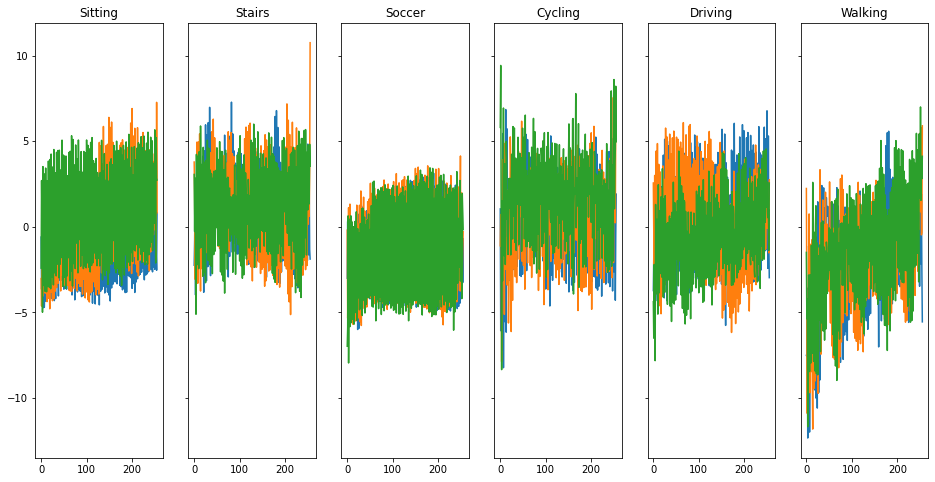

[[4411   16   16    0  120    8]
 [   6 3091    5    2   13  129]
 [  43   18 2134    7   97   13]
 [   0    1    6 3450   21    0]
 [ 103    3   69   10 6652    4]
 [  42  218   31    0   22 4383]]


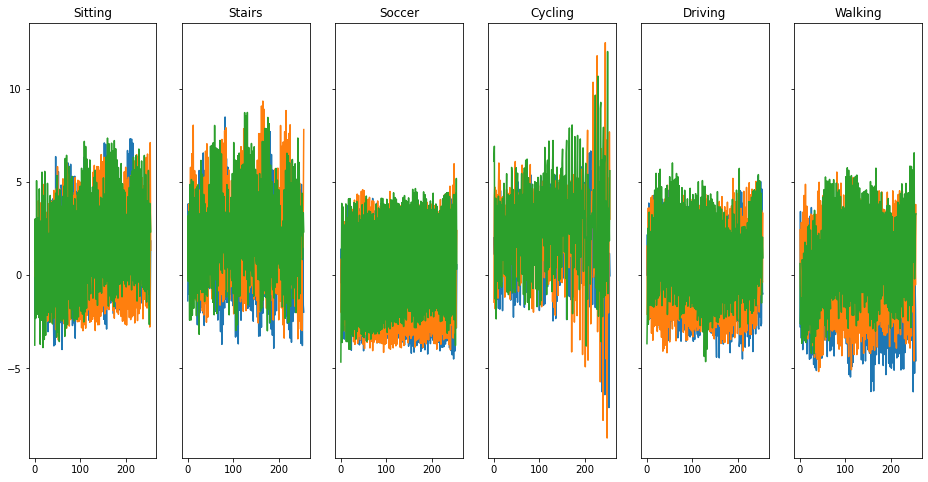

[[4407   12   33    0  106   13]
 [   6 3073   11    0   10  146]
 [  18   13 2196    2   68   15]
 [   1    6   10 3444   17    0]
 [ 117    9   78   10 6615   12]
 [  30  188   35    0   20 4423]]


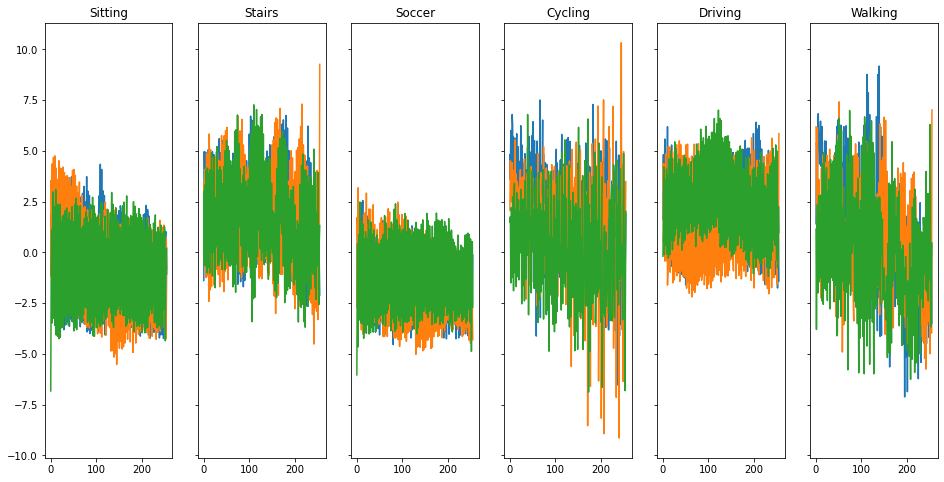

[[4371   13   28    0  151    8]
 [   4 3116    7    1    3  115]
 [  26   15 2203    2   53   13]
 [   0    2    9 3442   25    0]
 [ 111    4   74    6 6642    4]
 [  29  159   38    0   23 4447]]


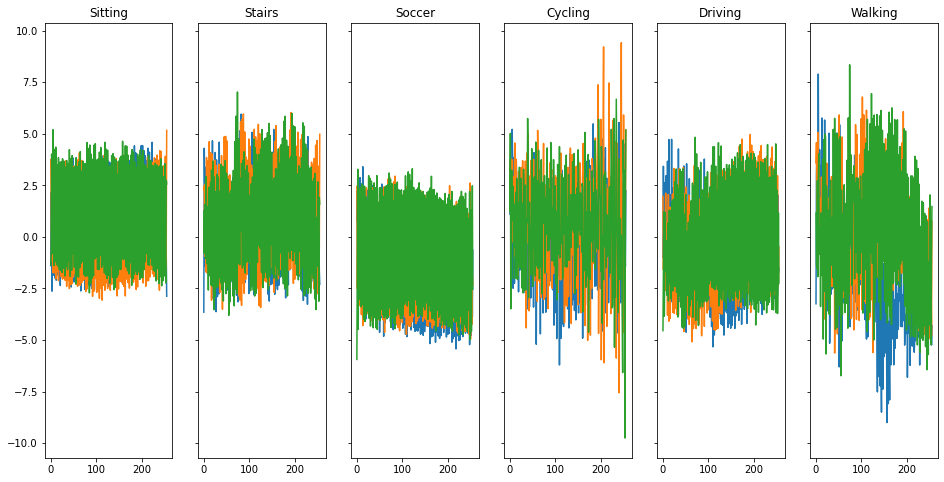

[[3957   11   31    6  557    9]
 [  33 2981   21    0   12  199]
 [ 111    7 2129    1   54   10]
 [  10    2   38 3331   96    1]
 [ 348    4  108   12 6363    6]
 [  36  235   73    1   50 4301]]


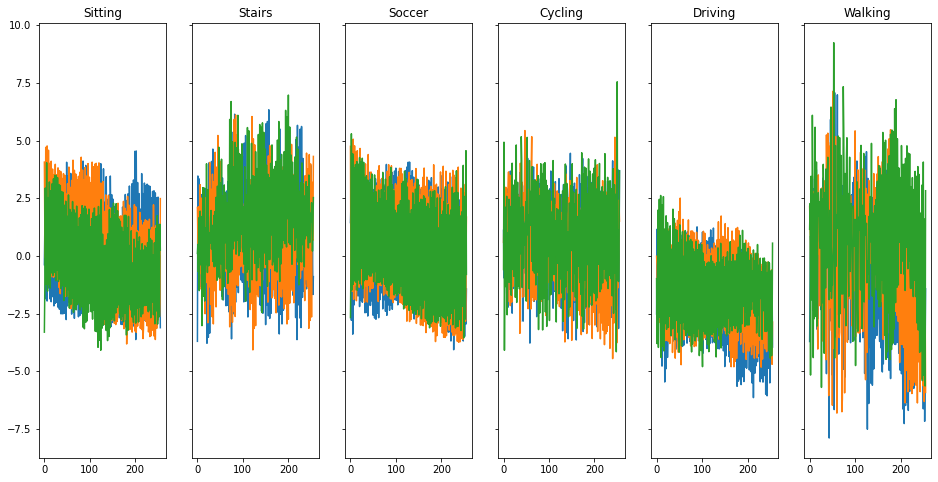

[[4422    9   33    0   96   11]
 [   7 3078   12    2    7  140]
 [  25    9 2180   14   60   24]
 [   0    1    4 3451   22    0]
 [ 139    2   71   14 6602   13]
 [  33  194   34    0   23 4412]]


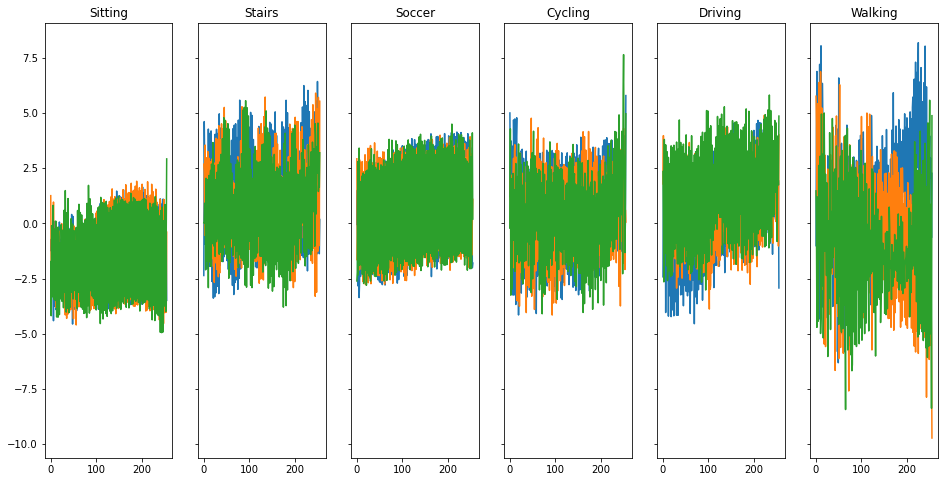

[[4407   20   33    0  101   10]
 [   4 3135   12    2    6   87]
 [  22   11 2192    4   69   14]
 [   0    2    4 3444   27    1]
 [ 118    3   59    8 6644    9]
 [  36  207   28    1   18 4406]]


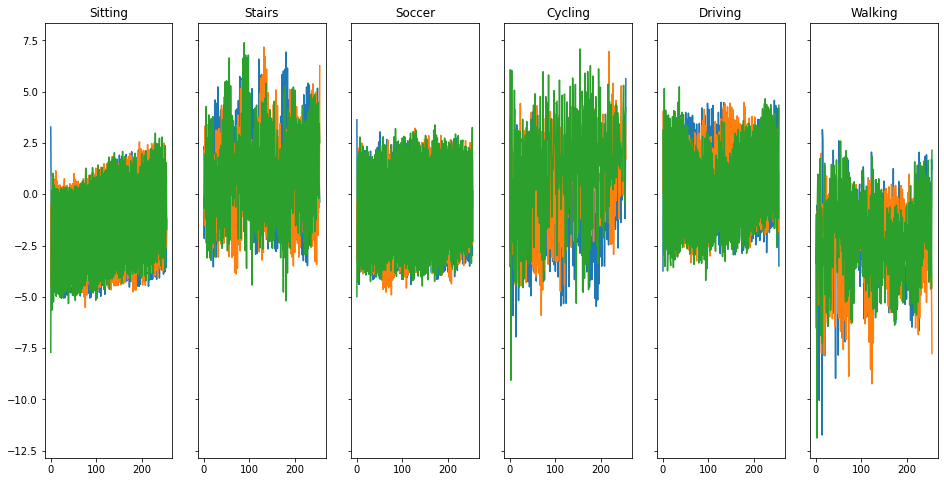

[[4333   15   42    0  163   18]
 [   4 3107    9    0   18  108]
 [  25   16 2143   12   96   20]
 [   0    1   14 3429   32    2]
 [ 213    9  112   14 6483   10]
 [  34  192   31    0   21 4418]]


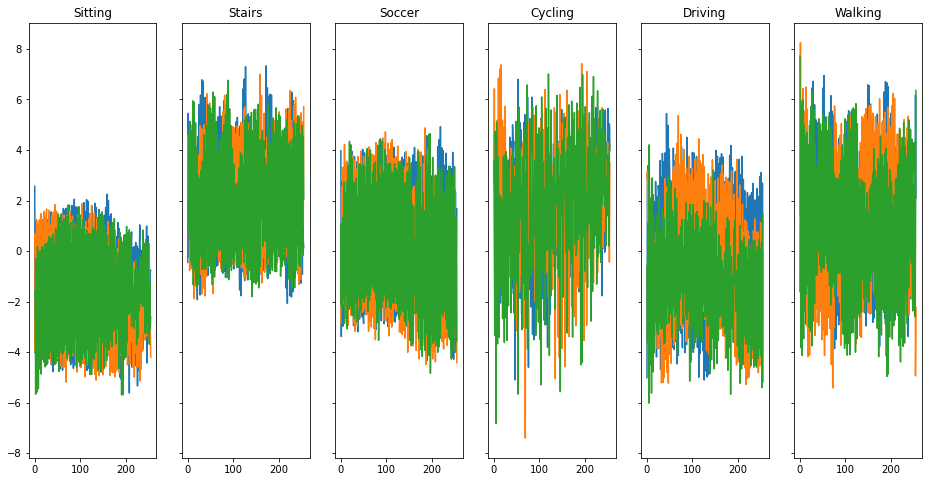

[[4445   16   23    0   75   12]
 [   1 3089   10    1    9  136]
 [  16   10 2165    4   97   20]
 [   0    2    8 3439   29    0]
 [ 130    1   62    6 6631   11]
 [  32  134   25    2   13 4490]]


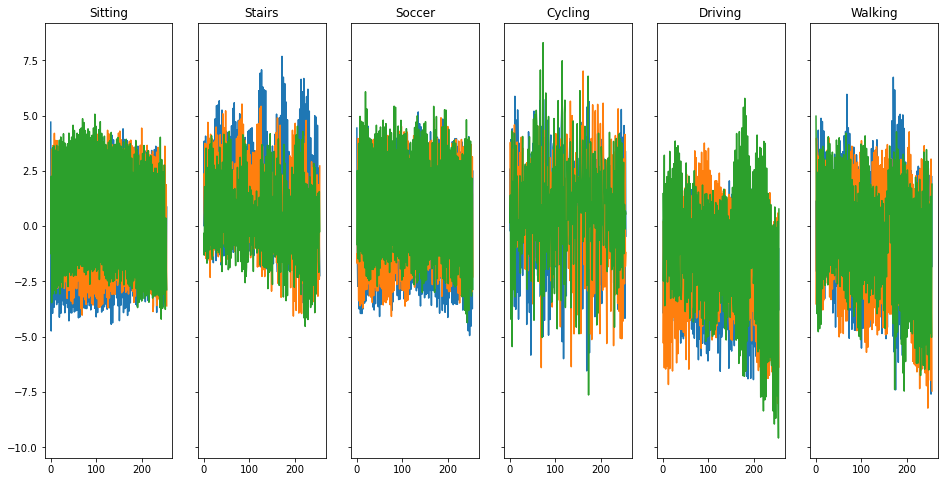

[[4411    9   21    0  114   16]
 [   4 3064    2    1    8  167]
 [  27   16 2184    9   57   19]
 [   0    1   11 3439   26    1]
 [ 108    0   95    6 6622   10]
 [  30  102   21    0   12 4531]]


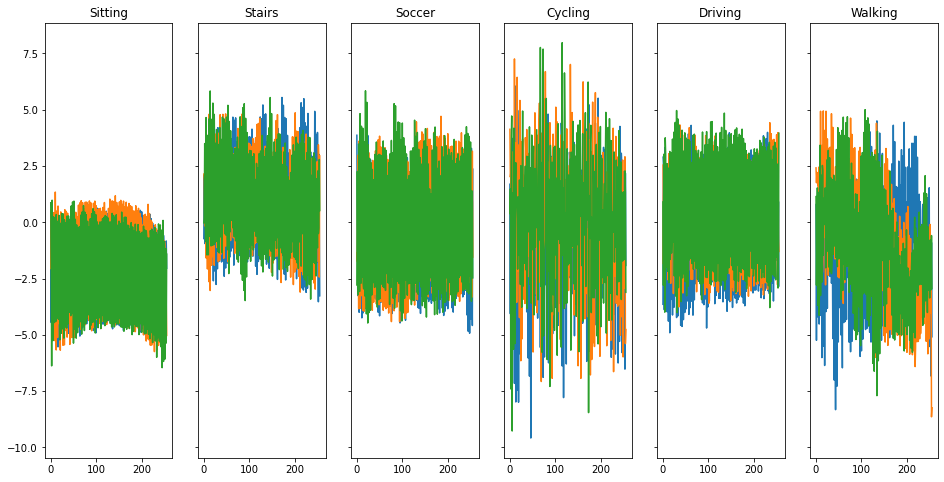

[[4385   17   34    0  129    6]
 [   4 3110    4    0    7  121]
 [  18   23 2181    1   72   17]
 [   0    0    7 3442   26    3]
 [ 109   10   58    6 6648   10]
 [  31  169   37    0   16 4443]]


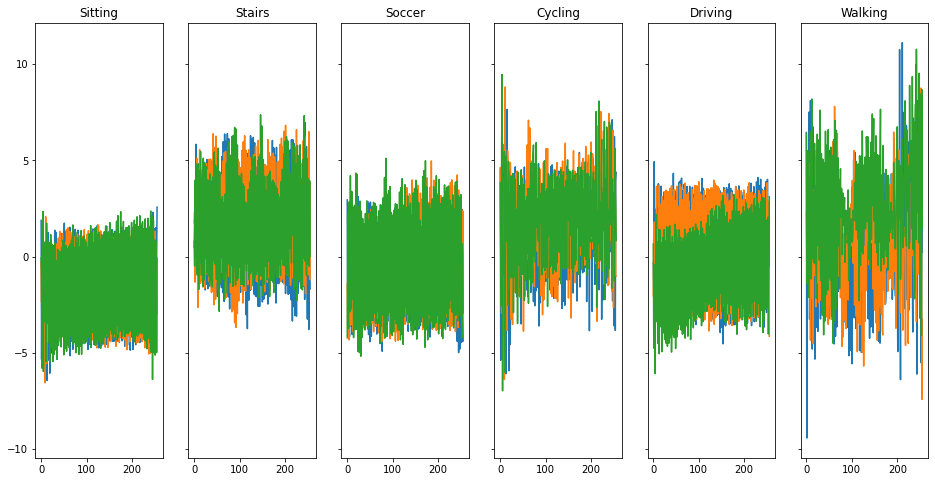

[[4382   17   32    0  124   16]
 [   4 3132    7    1    4   98]
 [  21   15 2197    5   55   19]
 [   0    3    7 3448   19    1]
 [  85   13   72    8 6655    8]
 [  22  234   22    0   18 4400]]


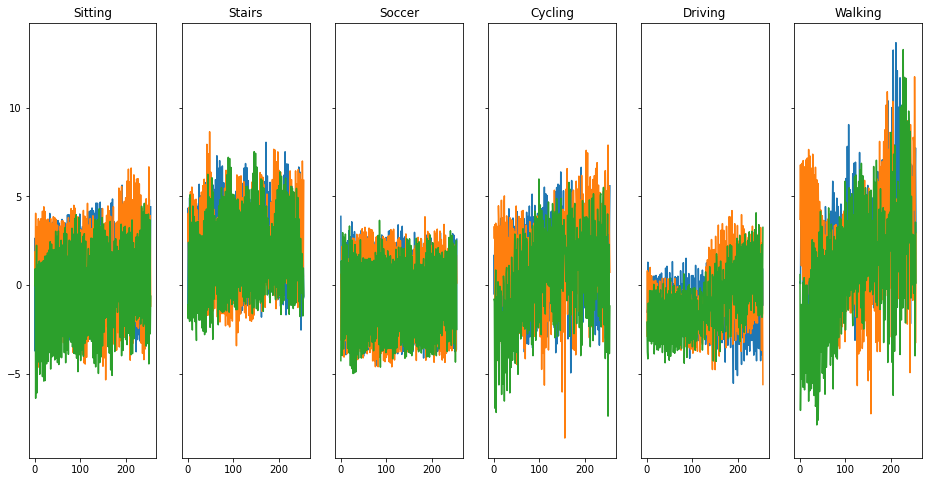

[[4420   10   23    0  103   15]
 [   4 3058   11    3    8  162]
 [  23   10 2161    6   80   32]
 [   0    1   12 3429   34    2]
 [ 123    4   51    8 6644   11]
 [  34  163   20    1   17 4461]]


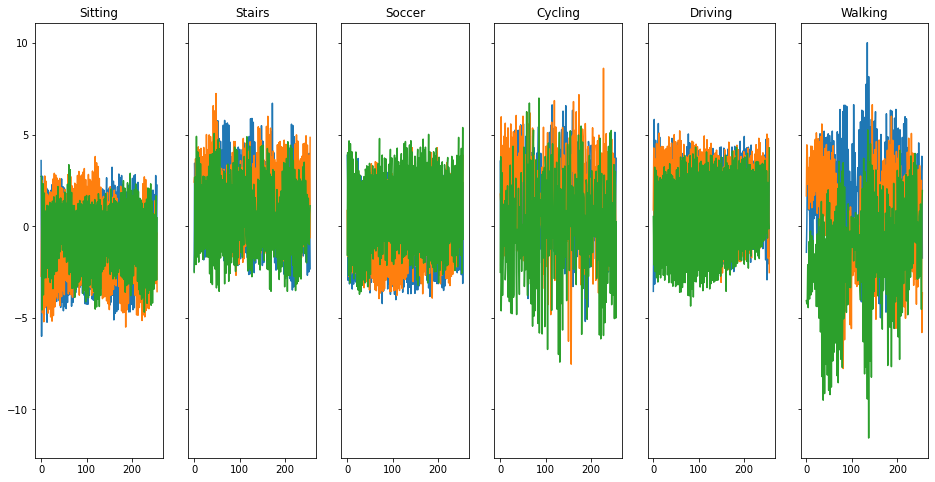

[[4333   40   43    0   96   59]
 [   0 3105   15    0    8  118]
 [  22   11 2213    5   50   11]
 [   1    3    6 3429   37    2]
 [ 119    5  109    8 6587   13]
 [  16  187   43    0   18 4432]]


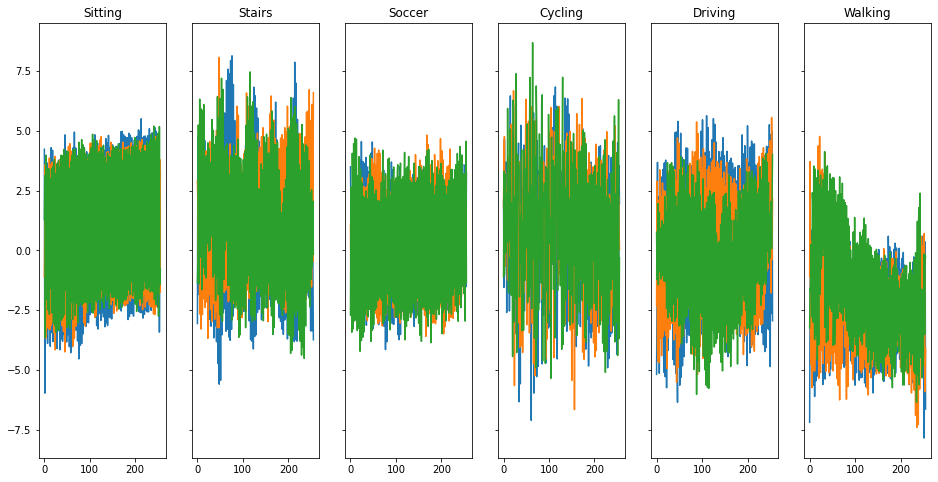

[[4406   14   32    0  105   14]
 [   5 3122    6    0    8  105]
 [  12   10 2207    3   67   13]
 [   0    1    9 3447   21    0]
 [  72    2   53    2 6709    3]
 [  21  187   25    0   14 4449]]


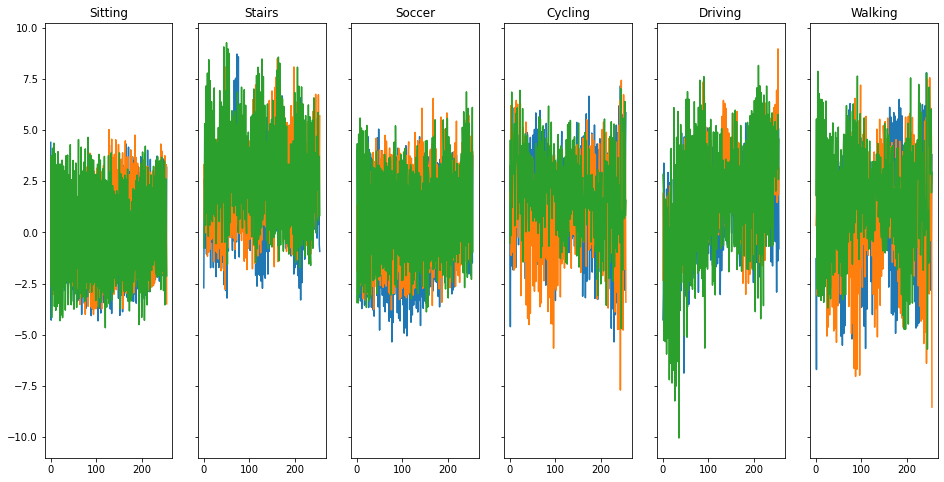

[[4423   12   36    0   93    7]
 [   6 3137    4    0    6   93]
 [  13   11 2221    8   48   11]
 [   0    0    5 3455   17    1]
 [  99    3   61    7 6669    2]
 [  36  169   27    0   22 4442]]


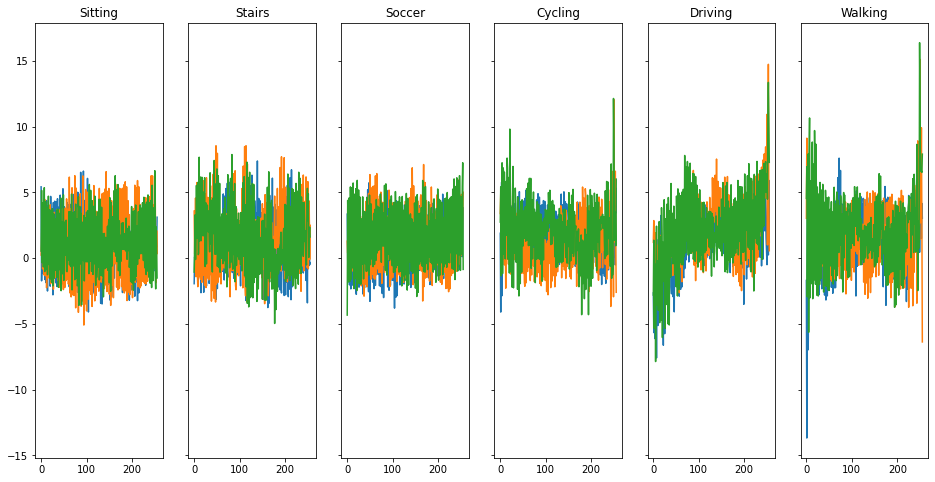

[[4440   21   24    0   79    7]
 [   5 3162    4    1    6   68]
 [  18   11 2211    4   59    9]
 [   0    5    5 3455   13    0]
 [  90    3   48   10 6684    6]
 [  33  177   27    0   14 4445]]


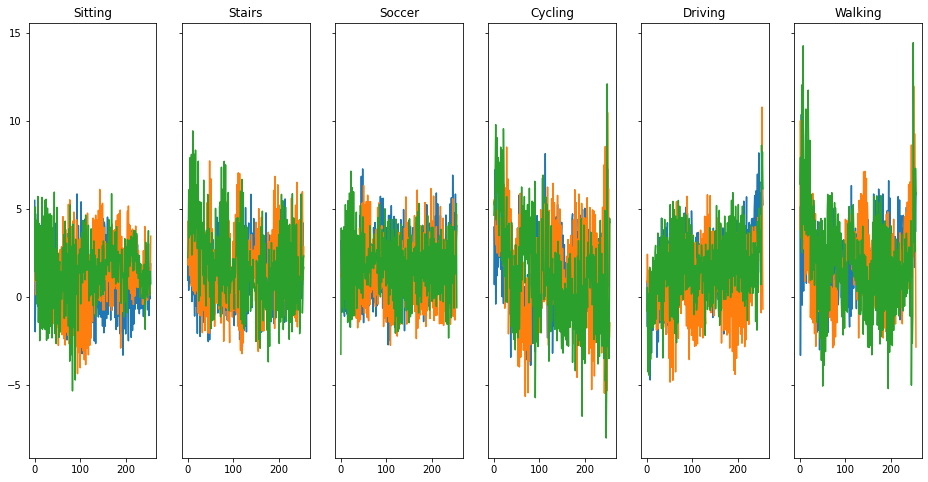

[[4431    6   28    1   97    8]
 [   4 3112    9    0    4  117]
 [  13    7 2233    3   45   11]
 [   0    0    4 3452   20    2]
 [  72    5   79    6 6676    3]
 [  28   88   31    0   16 4533]]


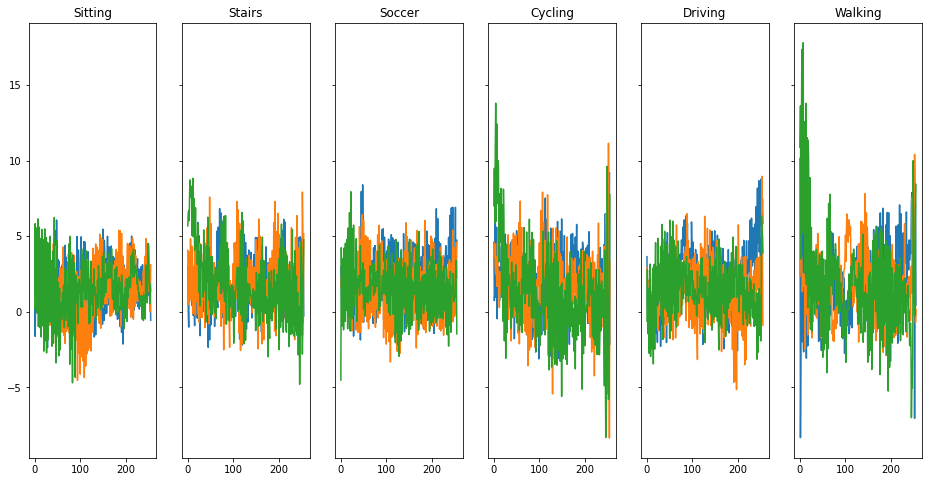

[[4449   11   21    0   80   10]
 [   4 3154    5    0    7   76]
 [  14    9 2216    2   53   18]
 [   0    3    7 3449   19    0]
 [  93    1   49    6 6689    3]
 [  28  115   26    0   14 4513]]


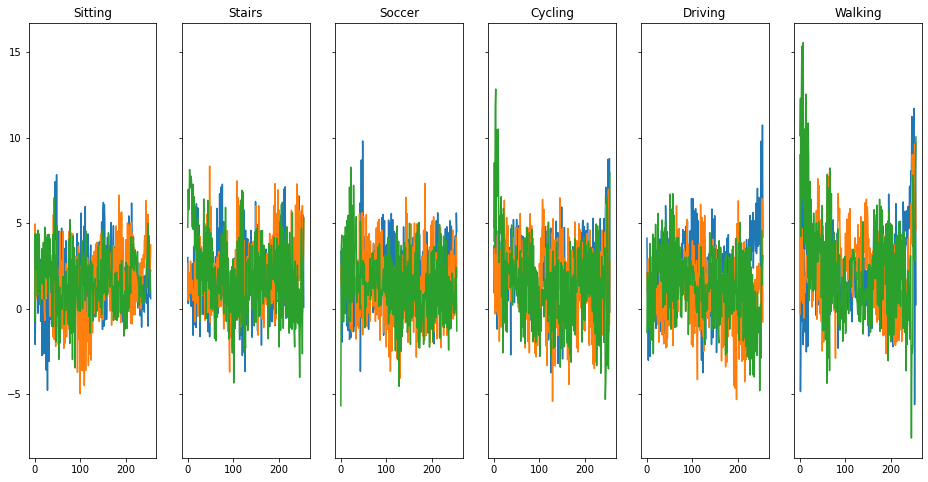

[[4172   12   40    1  327   19]
 [   7 3000    4    5    3  227]
 [  31   11 2083   23  123   41]
 [   0    7    3 3448   19    1]
 [ 256   19  173   71 6278   44]
 [  36  183   15    1   55 4406]]


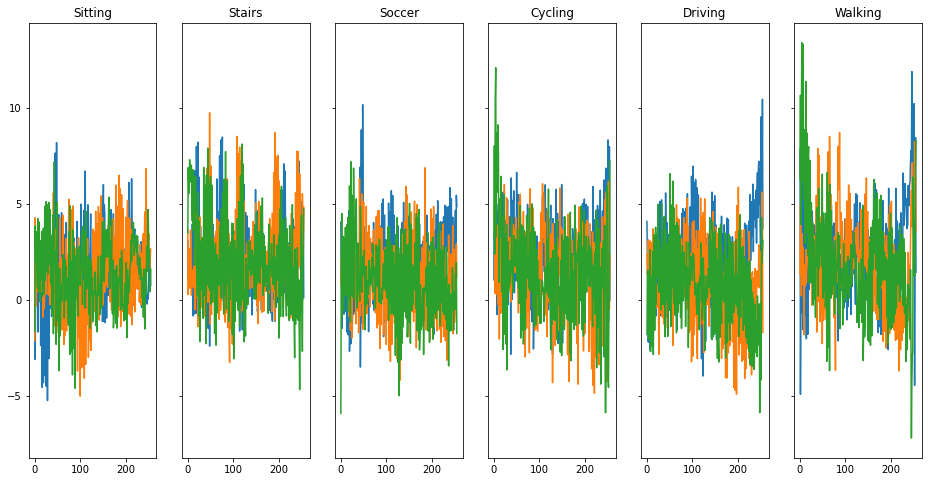

[[4312   16   51    0  176   16]
 [   3 3009   12    2   16  204]
 [  15   22 2135   10  103   27]
 [   2   10   22 3350   93    1]
 [ 202   34  124   17 6418   46]
 [  38  265   37    0   40 4316]]


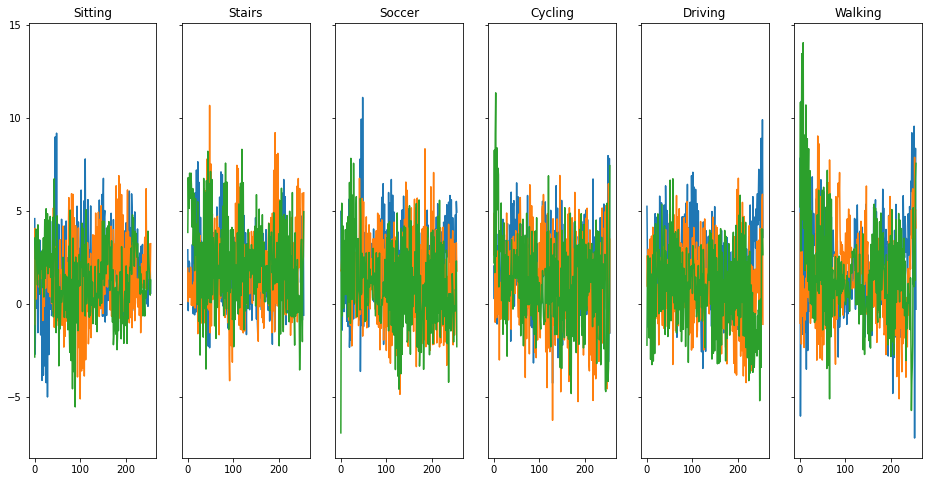

[[4392    9   23    0  140    7]
 [   6 3127    3    0   10  100]
 [  21   22 2194    9   57    9]
 [   0    2    9 3445   21    1]
 [  66    2   70   10 6685    8]
 [  31  149   26    0   14 4476]]


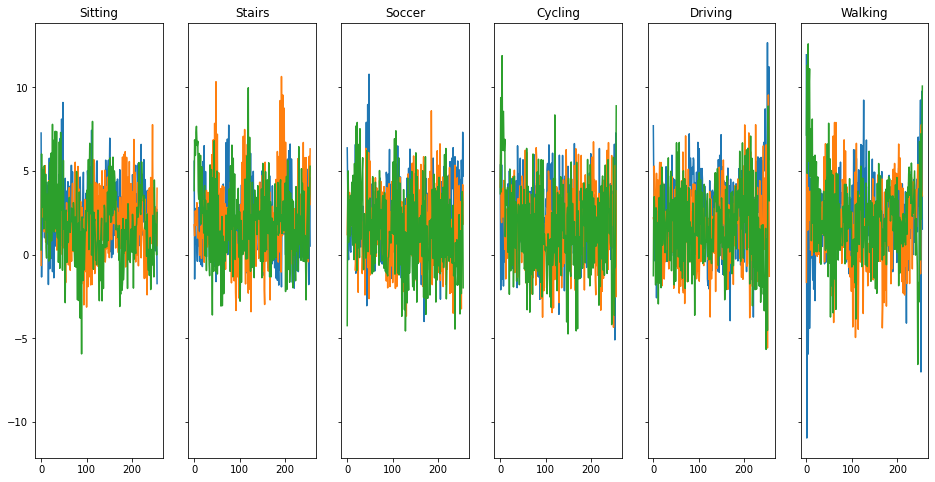

[[4457    8   29    0   66   11]
 [   2 3157    8    2    5   72]
 [  11    4 2241    1   47    8]
 [   0    1    4 3448   24    1]
 [ 110    2   67    8 6648    6]
 [  17  155   25    0   15 4484]]


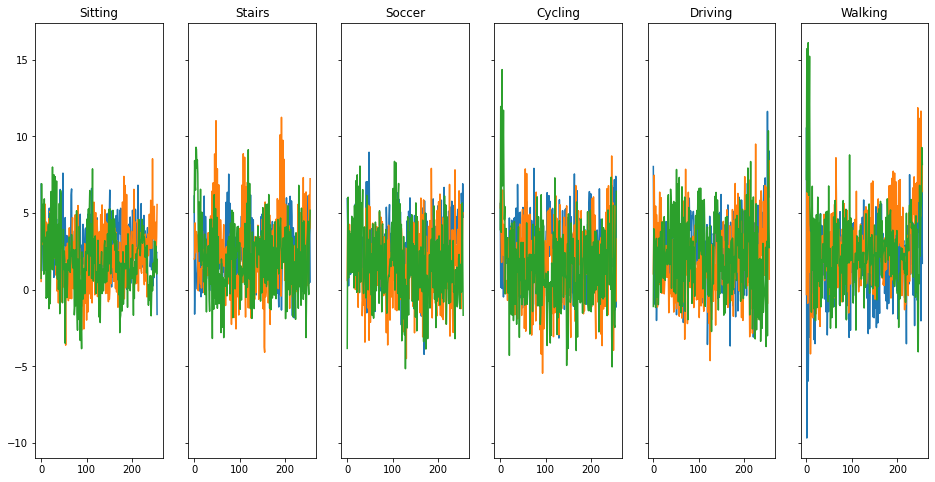

[[4451    6   22    0   81   11]
 [   7 3157    3    2    7   70]
 [  18    8 2235    6   40    5]
 [   0    2    6 3449   18    3]
 [  75    2   61    8 6690    5]
 [  23  146   26    0   13 4488]]


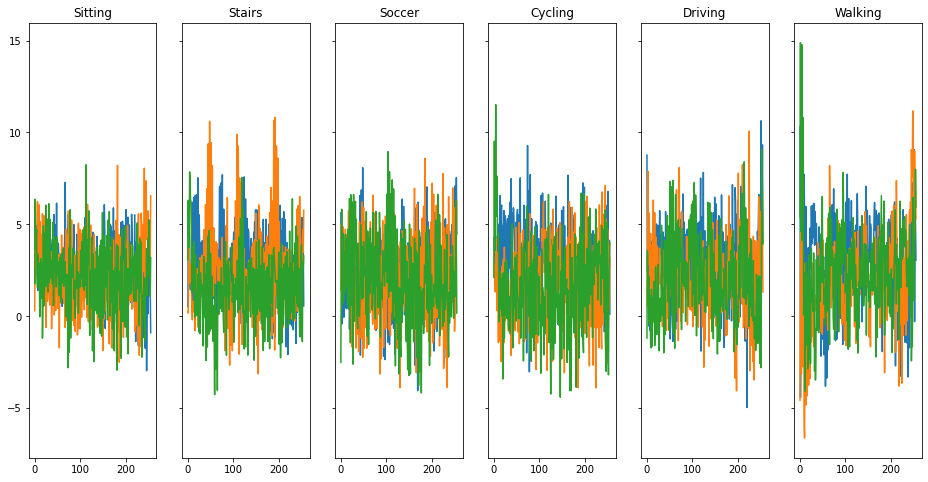

[[4462    9   17    0   74    9]
 [   5 3136    7    1    7   90]
 [  18    7 2224    2   47   14]
 [   0    1    7 3444   25    1]
 [ 104    4   52    8 6668    5]
 [  25  152   27    0   13 4479]]


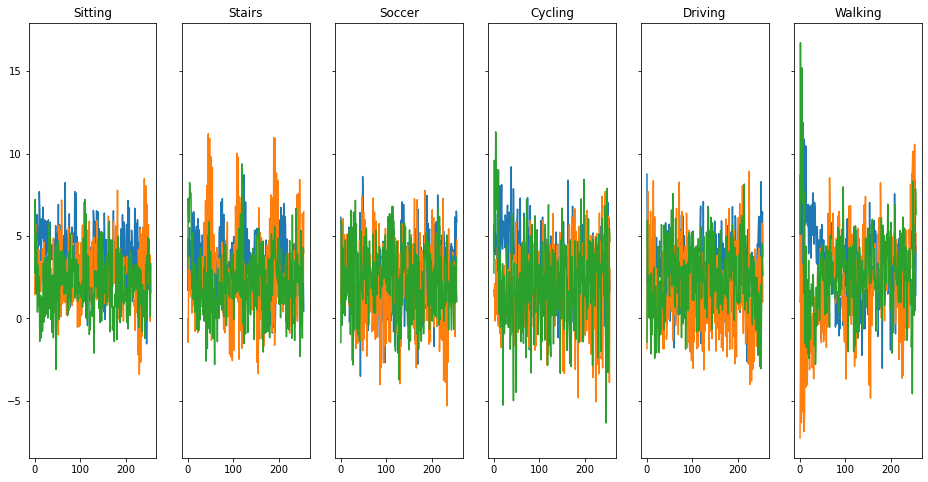

[[4426    7   29    0  104    5]
 [   3 3147    3    0   14   79]
 [  15    8 2232    3   48    6]
 [   0    0    2 3456   19    1]
 [  54    0   44    4 6733    6]
 [  21  103   43    0   21 4508]]


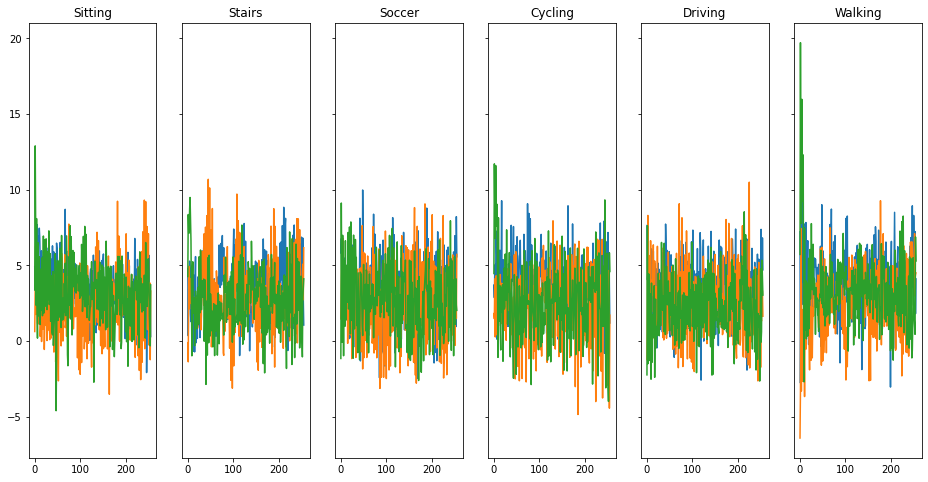

[[2928    4   32    6 1596    5]
 [  29 3065    5    0    5  142]
 [  41    9 2165    2   82   13]
 [   1    1   33 3378   61    4]
 [ 214    1   90    7 6513   16]
 [  39  127   48    0   42 4440]]


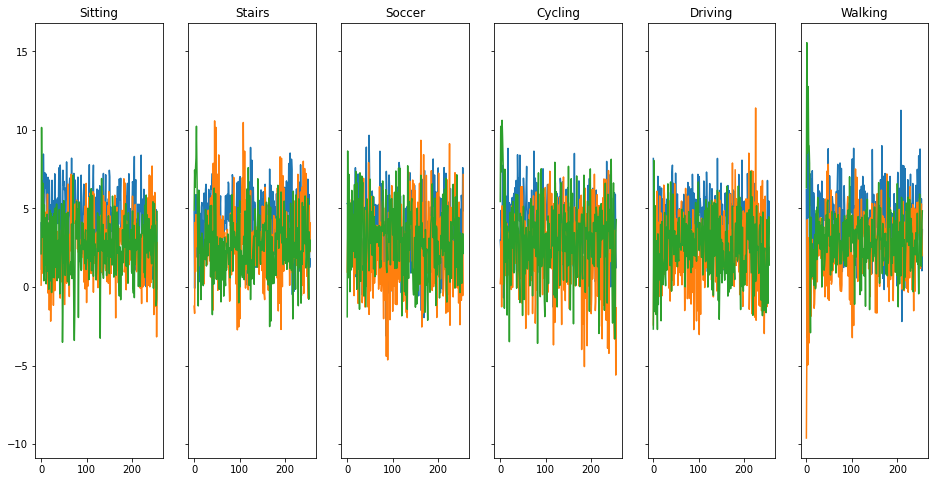

[[1921  297  101   29 2209   14]
 [ 313 2597   19    3    5  309]
 [ 185   16 1877    0  211   23]
 [ 342   12   54 2781  279   10]
 [ 950   39  795    6 4978   73]
 [ 284  530  209    1   38 3634]]


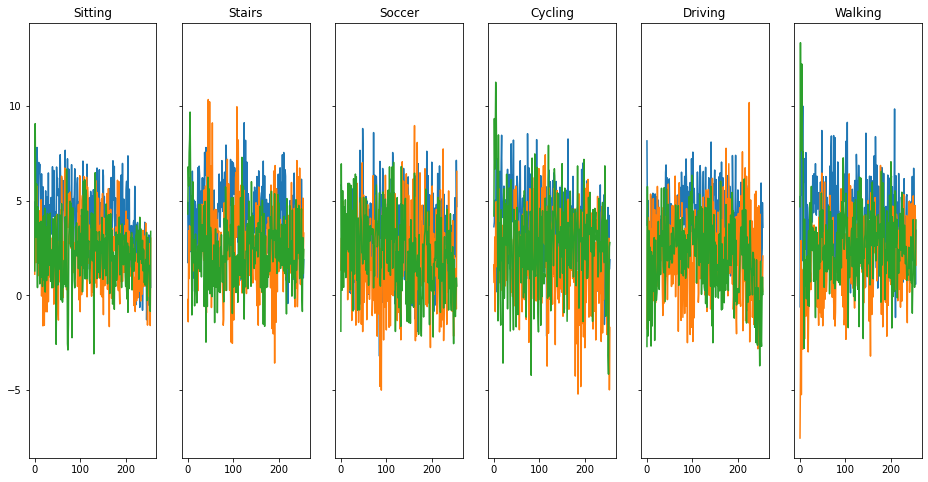

[[3127  108   34    3 1214   85]
 [ 146 2122   57  129  448  344]
 [  73   55 1657   18  382  127]
 [  20    1   39 3218  193    7]
 [1566  115  670    2 4263  225]
 [ 168  400   83   46  382 3617]]


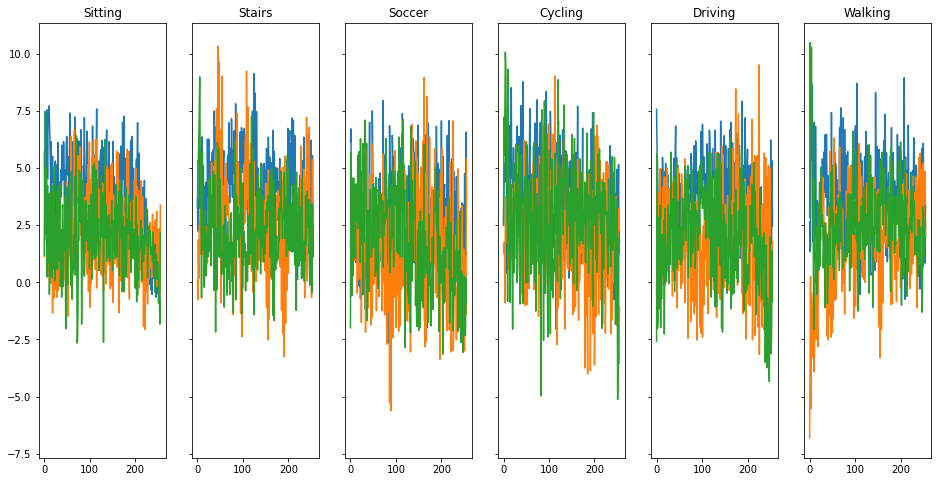

[[2829   51   82    3 1583   23]
 [  73 2102   79   46  173  773]
 [  85   30 1721   33  402   41]
 [  18    3   38 3158  233   28]
 [ 470   64  338   24 5884   61]
 [  99  501  106   16  149 3825]]


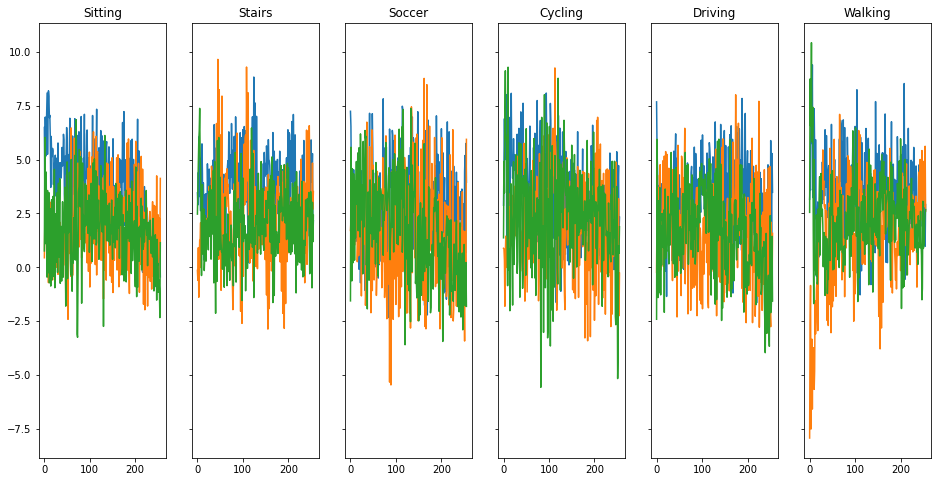

[[2916   41  267    6 1334    7]
 [  84 1967   61   33  385  716]
 [ 157  185 1368   23  515   64]
 [  13   30   30 3038  321   46]
 [ 364  110  437    4 5897   29]
 [ 169  822  258   33  319 3095]]


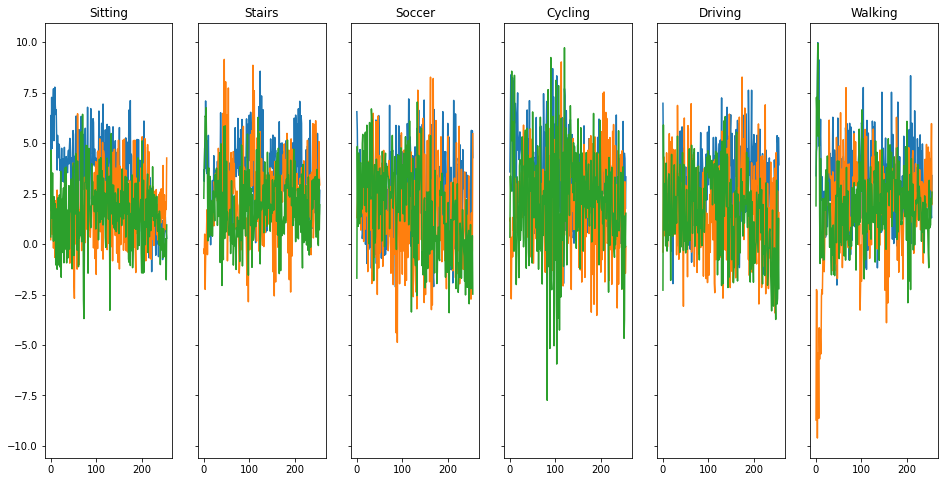

[[3583   37   32    0  912    7]
 [  63 2225   18    2  130  808]
 [ 170  185 1328   17  560   52]
 [  48   47   20 3134  224    5]
 [ 507   94  124   19 6075   22]
 [ 129  431   39    3  284 3810]]


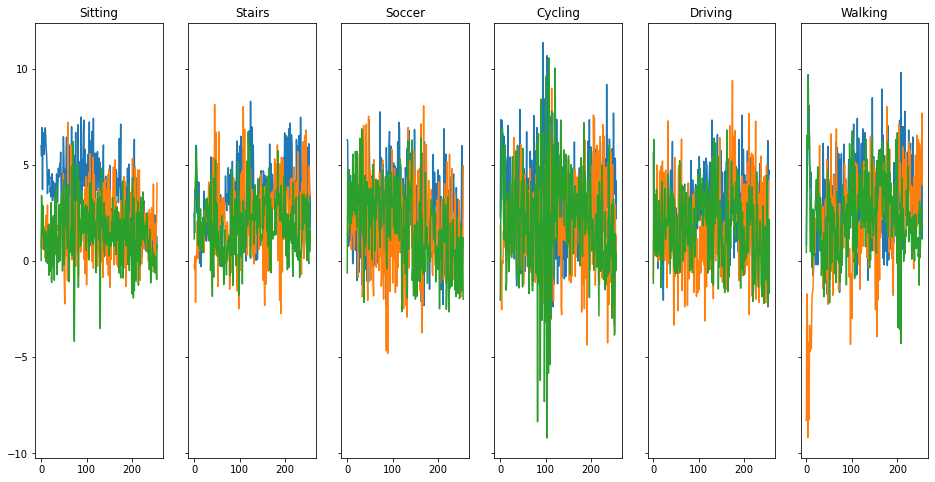

[[4196   26  152    0  185   12]
 [  64 2322  454   19  126  261]
 [  65   79 1969   19  125   55]
 [  76   14   46 3168  173    1]
 [ 757   90  477   13 5423   81]
 [  89  438  200    8   62 3899]]


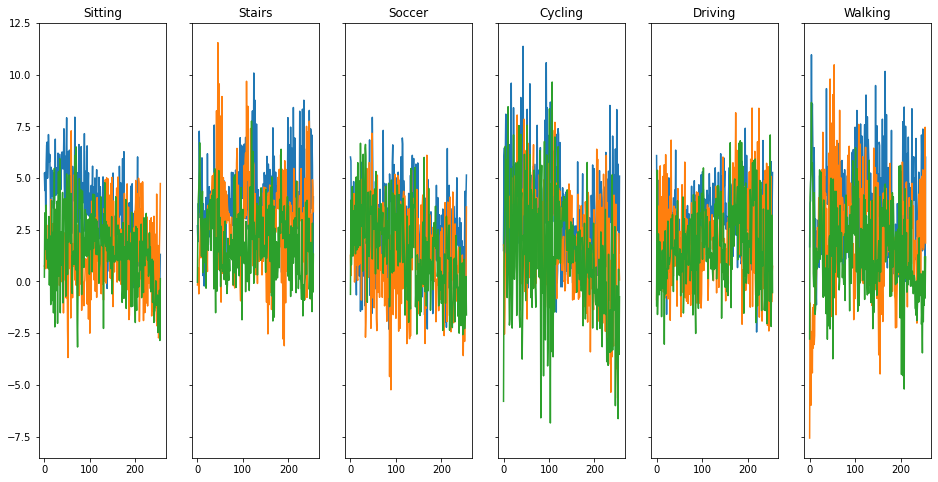

[[3858   15  106   10  424  158]
 [  32 1808   24    8   85 1289]
 [ 228   75 1493   66  371   79]
 [  32    7   19 3265  133   22]
 [1032   35  199   61 5386  128]
 [ 112  104   25    8   52 4395]]


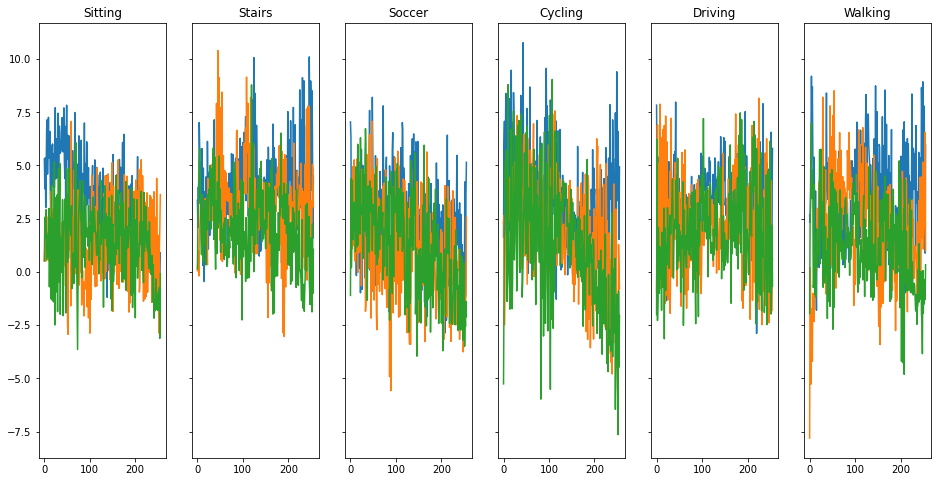

[[4098   15  174   13  243   28]
 [  23 1994   63  113  233  820]
 [  87  147 1490  155  305  128]
 [  41   21   68 3144  200    4]
 [ 948  148  511  104 5047   83]
 [  95  378   45   36   81 4061]]


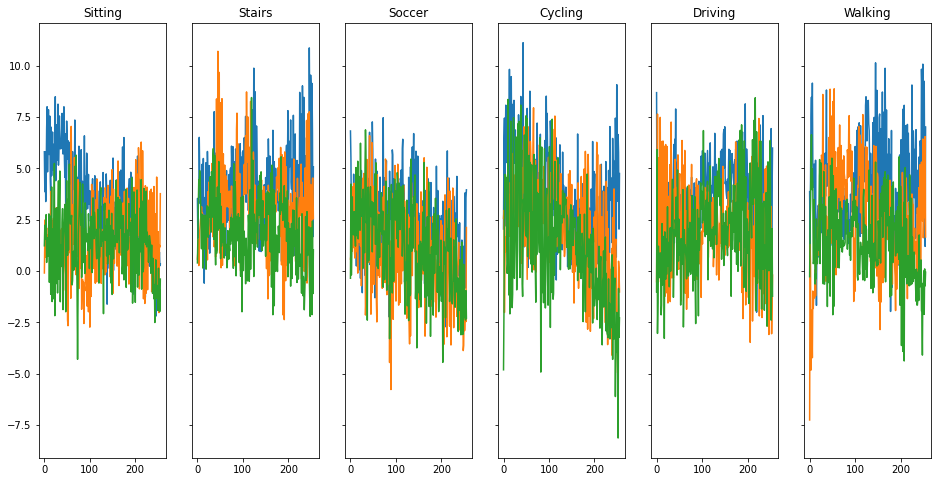

[[4026    7  141   15  360   22]
 [  60 1941   38  149  468  590]
 [ 140  111 1406  134  418  103]
 [  48    8   63 3120  238    1]
 [1172   72  501  131 4908   57]
 [ 123  379   72   88  272 3762]]


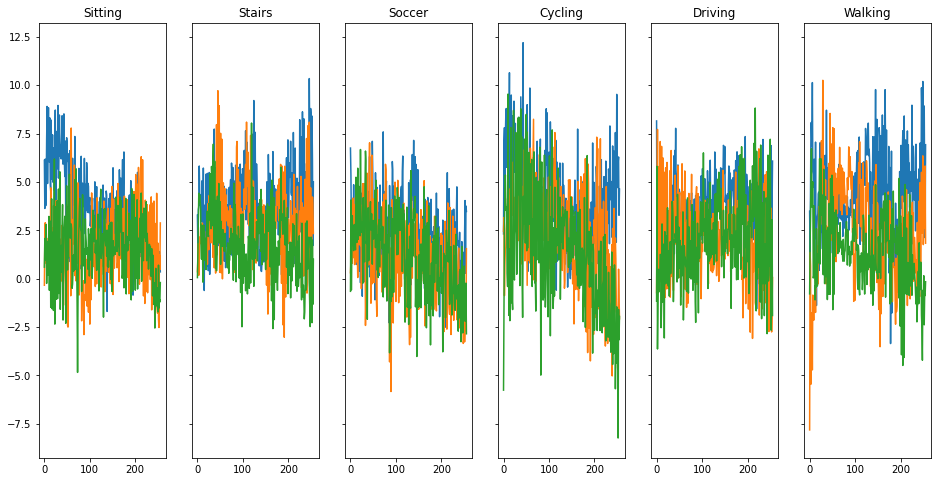

[[4322    9   40   37  136   27]
 [ 553 1487    9   61   54 1082]
 [ 732   56  965  157  141  261]
 [ 137   12   24 3155  118   32]
 [2498  150  216  257 3599  121]
 [ 834  237    9   66   67 3483]]


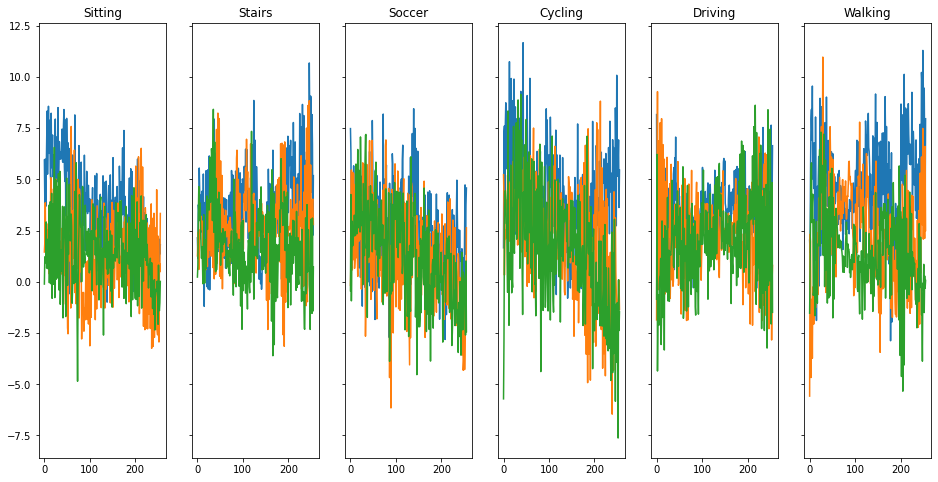

[[4387    6   35   37   93   13]
 [1336 1129   14    4   26  737]
 [ 941  105 1005   45   73  143]
 [ 347   37  128 2821  103   42]
 [2970  242  140  134 3264   91]
 [2089  365   24   13   33 2172]]


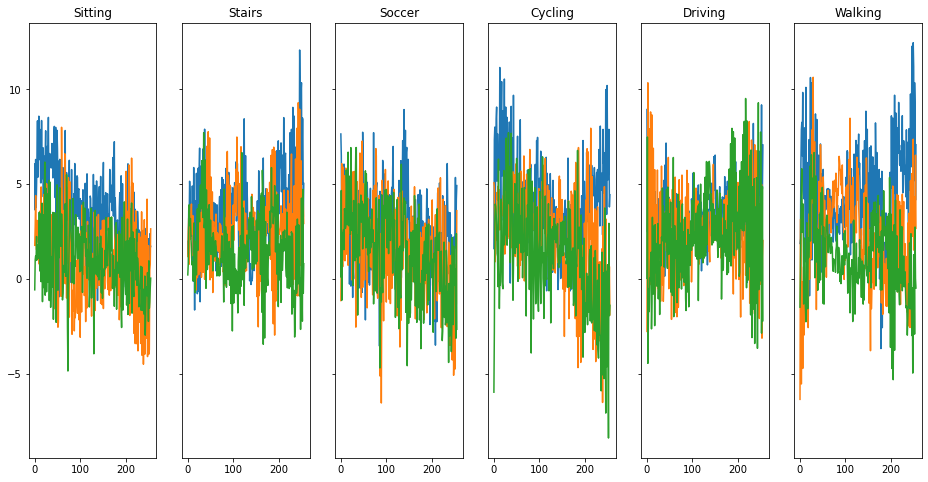

[[4201   24   60   12  127  147]
 [ 418 1757   26   32   69  944]
 [ 761   90 1024   45  106  286]
 [ 155   16   47 3167   71   22]
 [3129  355  207  123 2739  288]
 [1037  543   22   33   86 2975]]


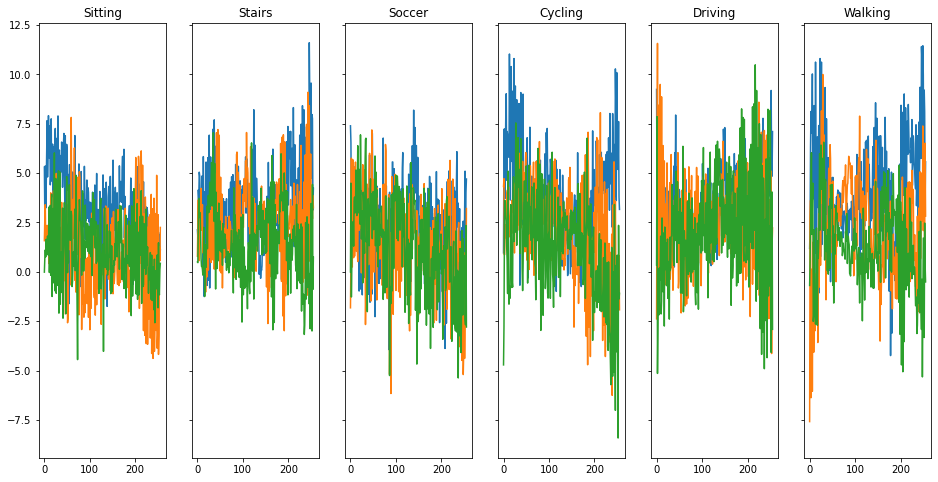

[[2528  539  214    8  139 1143]
 [1070  874   87   37  549  629]
 [ 889  143  832   41   61  346]
 [ 292  155   27 2956   18   30]
 [4422  373  252   91 1036  667]
 [1421  344   53   63  702 2113]]


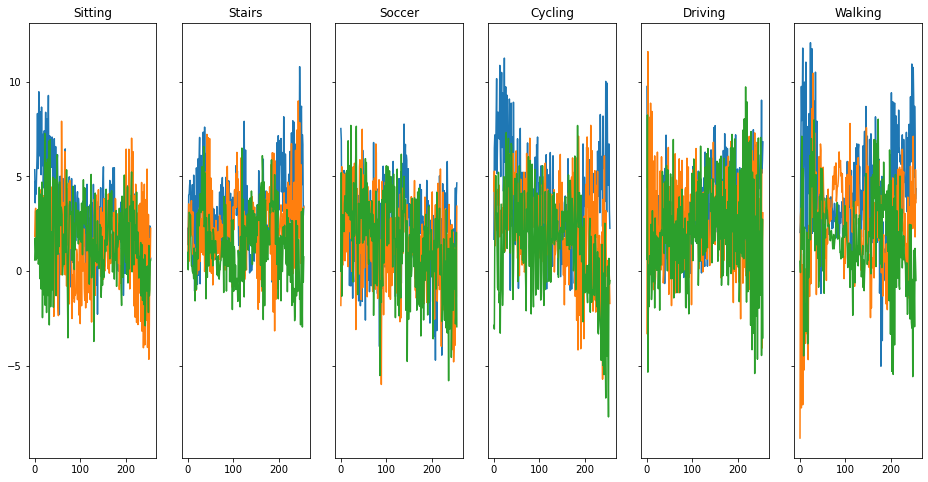

[[3908   22   98    8  463   72]
 [ 522 1494  174   31  337  688]
 [ 951   90  791   61  145  274]
 [ 247   16   23 3072  100   20]
 [3105   95  434   84 2878  245]
 [1110  546  138   75  446 2381]]


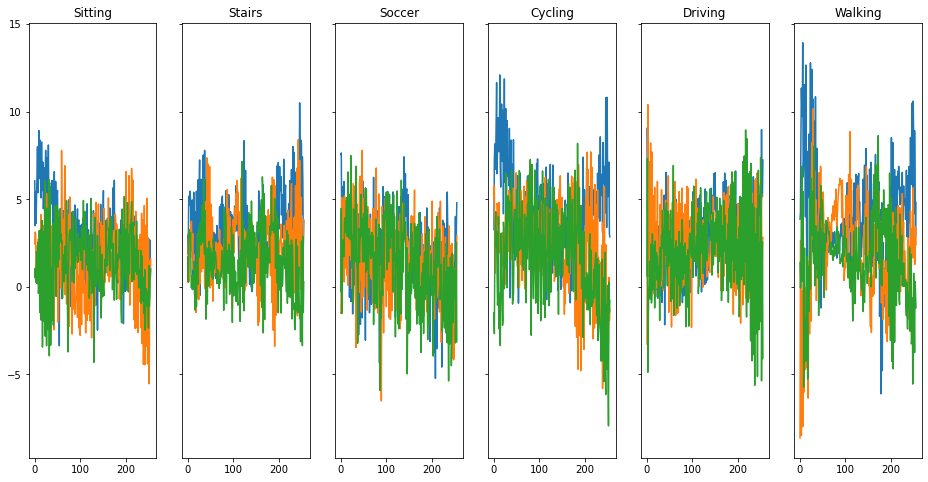

[[4014   15  214   56  159  113]
 [ 868 1441  170    8   82  677]
 [1055   98  887   71  141   60]
 [ 351   31   26 2872  163   35]
 [2172  195  396   66 3734  278]
 [1631  317  237   23  166 2322]]


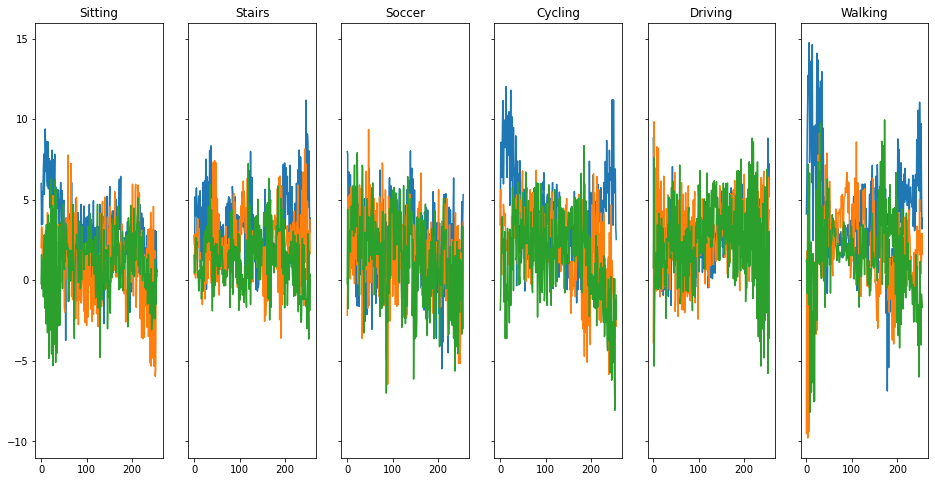

[[3269   18   28   51 1204    1]
 [ 791 2201   64    8   67  115]
 [1378   69  515  102  239    9]
 [ 590   25    5 2648  195   15]
 [2250   89   55   64 4359   24]
 [2246 1130   59   13  224 1024]]


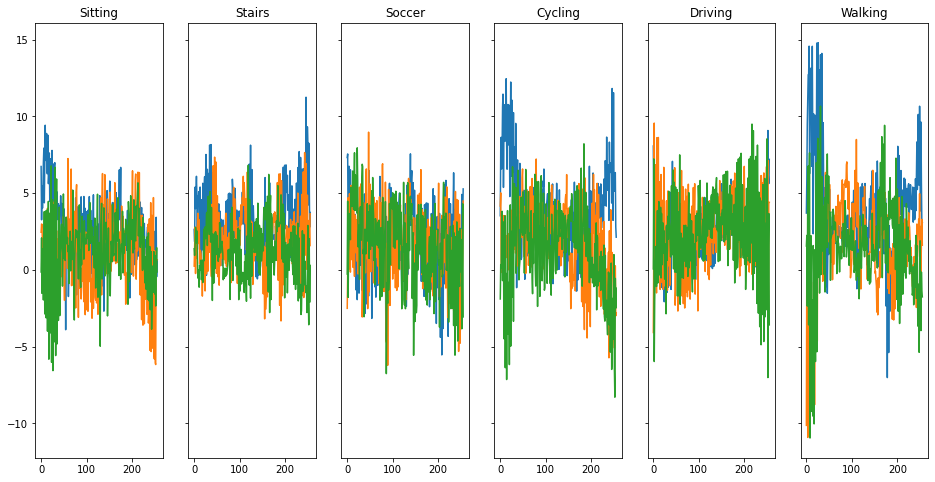

[[2663    3   28   13 1843   21]
 [1294 1371  233    0  153  195]
 [1711    6  308   29  226   32]
 [1417    0  159 1515  360   27]
 [2274   22   29   13 4271  232]
 [2339  480   78   10  226 1563]]


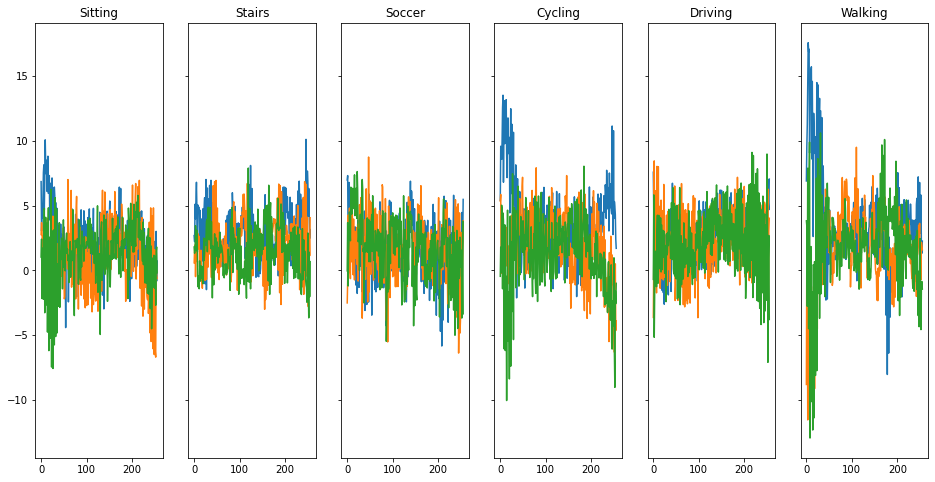

[[1779  206   14    4 2546   22]
 [1803  954  162   47  244   36]
 [1659   82  190   78  256   47]
 [1198    1   17 1997  235   30]
 [2839   46   16   41 3853   46]
 [3428  313   47   97  303  508]]


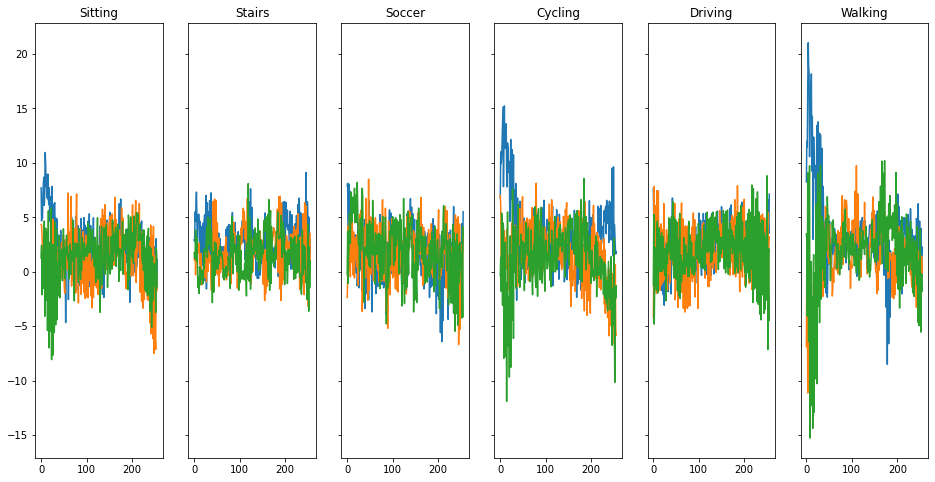

[[2849   17   30   26 1583   66]
 [1128 1767  112    7  121  111]
 [1412  118  315   90  313   64]
 [1464    3    5 1640  322   44]
 [2308   71   57   91 4216   98]
 [2689  726   39   22  256  964]]


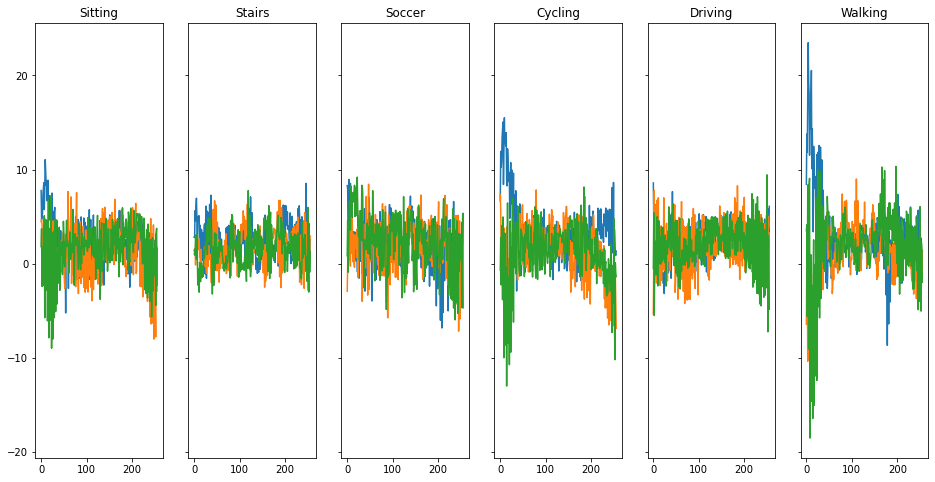

[[2293   27    2  583 1643   23]
 [1566 1377    8   53   73  169]
 [1151  244   35  440  388   54]
 [2547   19    0  537  346   29]
 [1233  202    3  409 4823  171]
 [2750  612   11  144  264  915]]


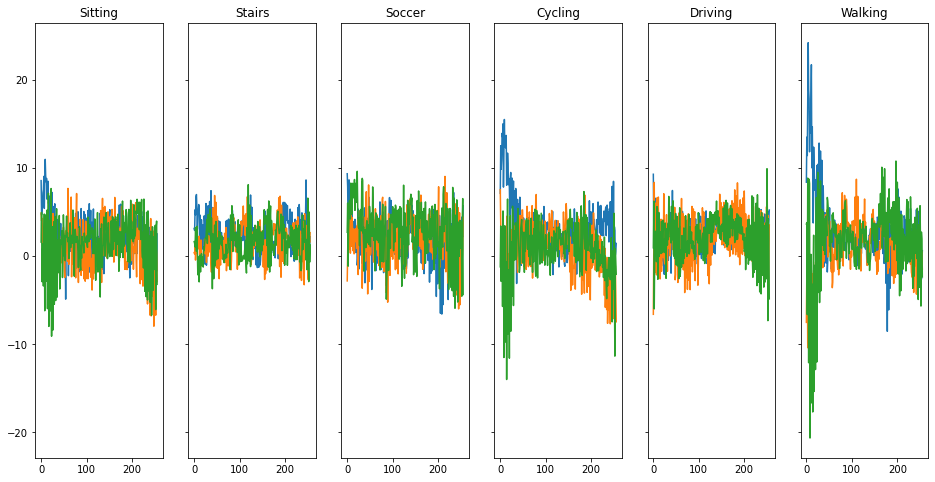

[[2136   83    1  701 1560   90]
 [1847 1164    1   61   62  111]
 [1186  231    5  437  374   79]
 [3030   29    0   70  333   16]
 [1442  243    1  468 4552  135]
 [2947  773    0  242  185  549]]


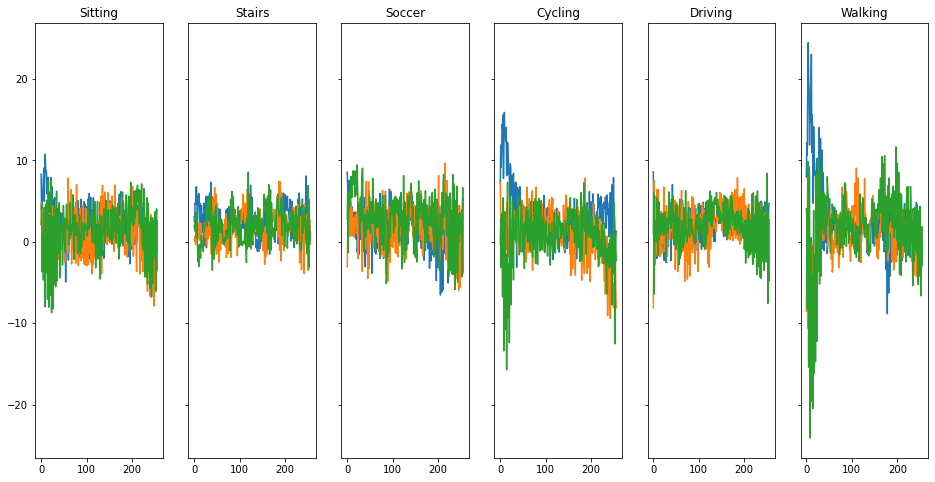

[[1889  263    2  474 1920   23]
 [2312  705    0   26   32  171]
 [1282  401   15  245  232  137]
 [3179   27    0   20  229   23]
 [1293  403    8  143 4559  435]
 [2942  752    7   96  109  790]]


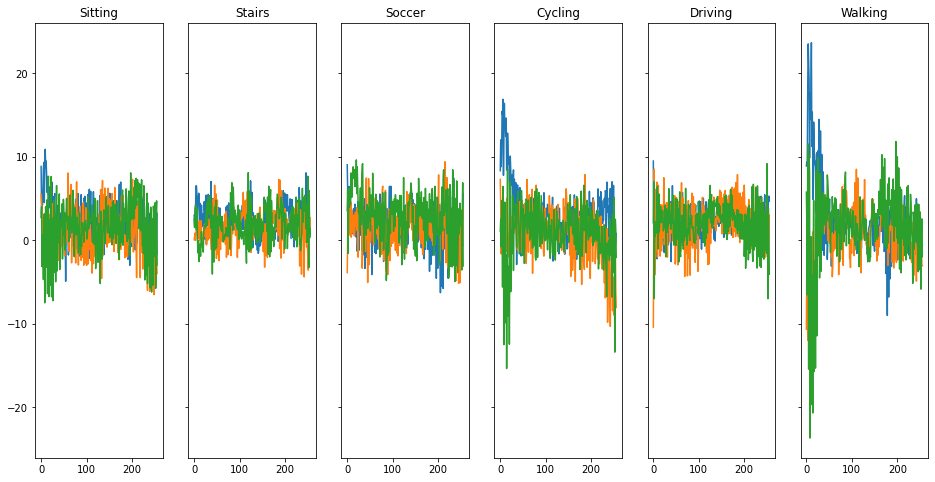

[[2581    9   59  156 1621  145]
 [2590  247  173   11   61  164]
 [1616   32   73   93  353  145]
 [3173    0    2   13  273   17]
 [2148  103   68  157 4003  362]
 [3309  162  275   36  345  569]]


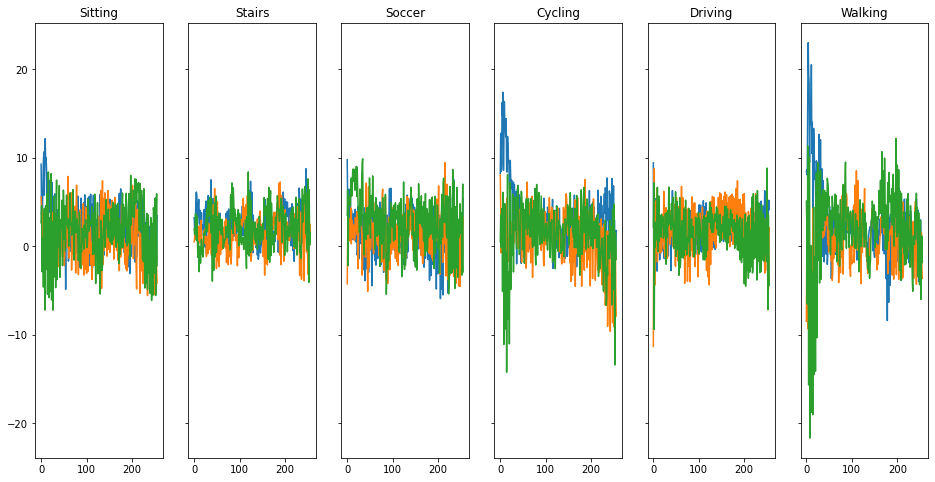

[[3779  217   16  200  214  145]
 [2772  215   66    5    8  180]
 [1962  142   38   24   28  118]
 [3352    0    0    2  108   16]
 [5754  109   36   61  380  501]
 [3602  338   81   26   31  618]]


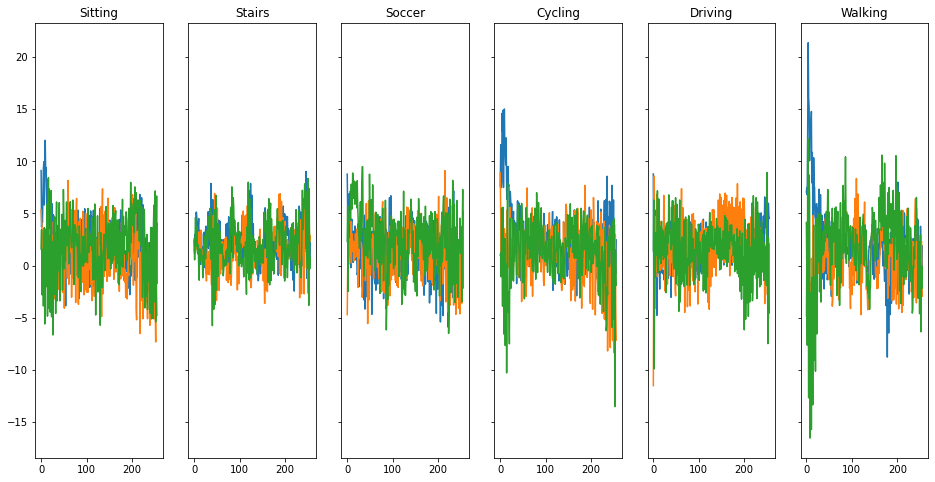

[[ 855   57    1    0  114 3544]
 [ 100   72   17    0   18 3039]
 [ 115   73    7    2   35 2080]
 [  16    0    1    0   60 3401]
 [ 328   45    4    1  176 6287]
 [ 147  115   10    0   29 4395]]


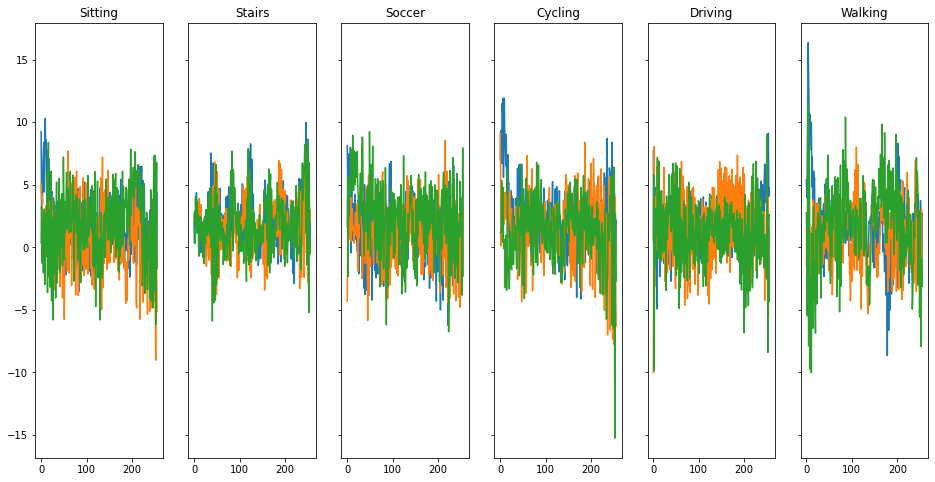

[[ 618   29    8    1 1062 2853]
 [  57  120    8    0   25 3036]
 [  85   50    7    0  132 2038]
 [  45    0    0    0  158 3275]
 [ 196   50   15    0  432 6148]
 [  89  108    4    0  112 4383]]


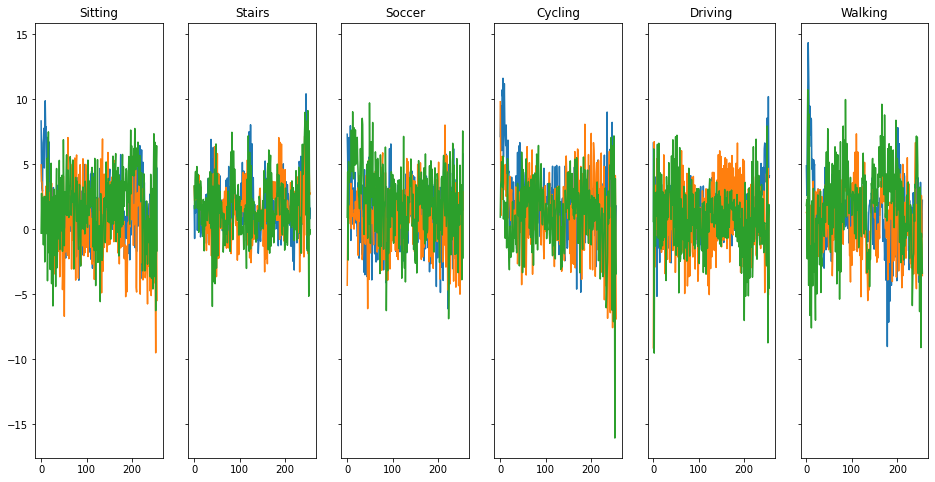

[[2460   27    0    0 1586  498]
 [2818  114    0    0   86  228]
 [1778  301    0    0   81  152]
 [3388   13    0    0   71    6]
 [3331  450    2    0 1590 1468]
 [3637  272    0    0  347  440]]


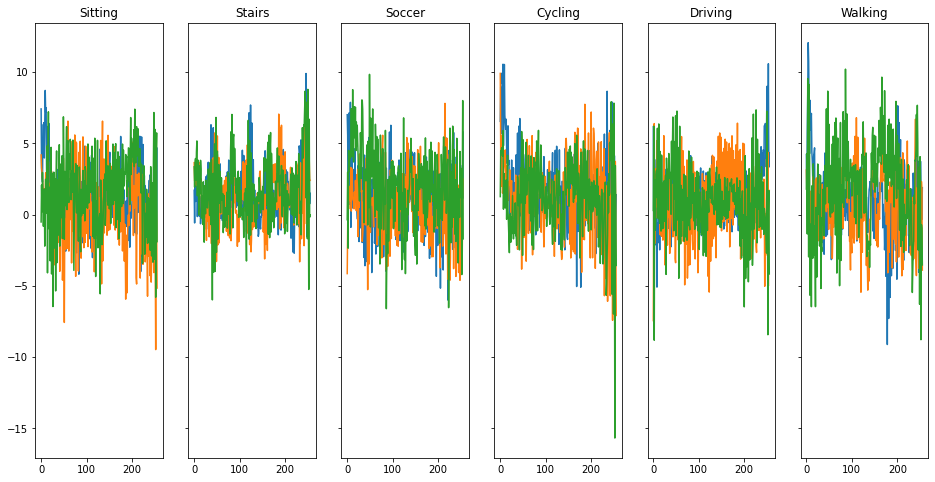

[[3439   11    7    0 1107    7]
 [3067   36   14    0   87   42]
 [1798   49   23    0  416   26]
 [3274    1    0    0  196    7]
 [4688  250   98    0 1660  145]
 [4160   82   38    0  268  148]]


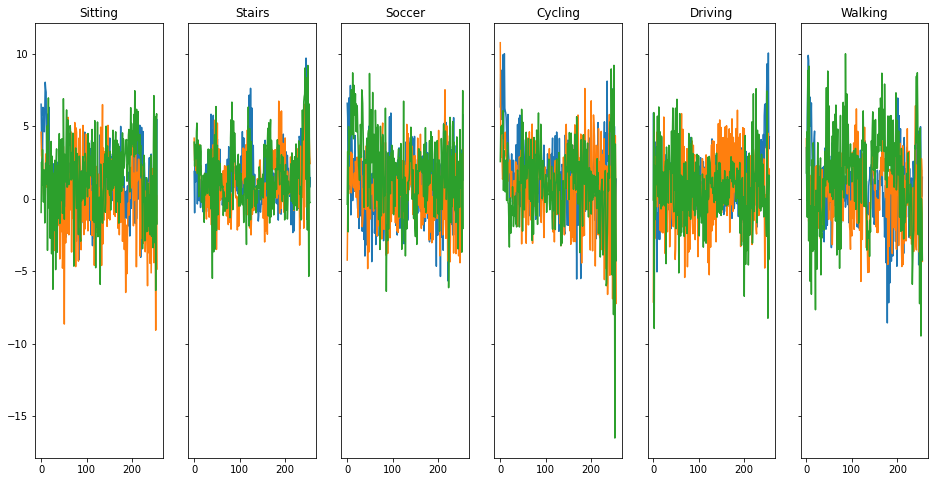

In [10]:
%matplotlib inline
from torch.autograd import Variable
from sklearn.metrics import confusion_matrix
# alpha = Variable(alpha,requires_grad=False)
losses = []
for epoch in range(n_epochs):
    loss_values = []
    for real_data, label_onehot in dataloader:
#         if real_data.shape[0]!=batch_size:
#             continue
        batch_size = real_data.shape[0]
        data_noise = torch.empty(batch_size, latent_size, device=device)
        real_label = torch.argmax(label_onehot,dim=1)
        real_label, real_data, label_onehot = real_label.cuda(), real_data.cuda(),label_onehot.cuda()
        
        ones = torch.ones(batch_size,requires_grad=False).cuda()
        zeros = torch.zeros(batch_size,requires_grad=False).cuda() + torch.abs(torch.normal(0, .1, size=(batch_size,))).cuda()
        
        
        doptimizer.zero_grad()
        discriminator_output_real, label_pred = dmodel(real_data)
#         discriminator_error_real = adversarial_loss(discriminator_output,zeros)
        classification_error_real = auxiliary_loss(label_pred,real_label)
#         real_loss = (discriminator_error_real*alpha + classification_error_real*(1-alpha)).mean()
#         real_loss.backward()
#         doptimizer.step()
        
#         doptimizer.zero_grad()
        data_noise.normal_()
        generated_data = gmodel(label_onehot,data_noise)
        discriminator_output_fake, label_pred = dmodel(generated_data)
#         discriminator_error_fake = adversarial_loss(discriminator_output,ones)
        classification_error_fake = auxiliary_loss(label_pred,real_label)
#         fake_loss = (discriminator_error_fake*alpha + classification_error_fake*(1-alpha)).mean()
        
        eps = torch.empty(batch_size, 1, 1, device=device)
        eps.uniform_(0, 1)
        gp_lambda = 20
        
        interp = (eps * real_data.detach() + (1 - eps) * generated_data.detach()).requires_grad_()
        ones_temp = torch.ones(batch_size).to(device)
        grad_d1 = grad(dmodel(interp)[0], interp, grad_outputs=ones_temp,create_graph=True)[0]
        grad_d1 = grad_d1.view(real_data.shape[0], -1)
        ones_temp = torch.ones(batch_size,6).to(device)
        grad_d2 = grad(dmodel(interp)[1], interp, grad_outputs=ones_temp,create_graph=True)[0]
        grad_d2 = grad_d2.view(real_data.shape[0], -1)
#         print(grad_d1.shape,grad_d2.shape)
        grad_d = grad_d1+grad_d2
        grad_penalty = ((grad_d.norm(dim=1) - 1)**2).mean() * gp_lambda
        w_dist = discriminator_output_fake.mean() - discriminator_output_real.mean()
        fake_loss = w_dist + grad_penalty + classification_error_real
        fake_loss.backward()
#         fake_loss.backward()
#         discriminator_error_fake.backward()
        doptimizer.step()
        
        goptimizer.zero_grad()
        doptimizer.zero_grad()
        for p in dmodel.parameters():
            p.requires_grad_(False)
        data_noise.normal_()
        generated_data = gmodel(label_onehot,data_noise)
        discriminator_output, label_pred = dmodel(generated_data)
        discriminator_error_real = adversarial_loss(discriminator_output,zeros)
        classification_error_real = auxiliary_loss(label_pred,real_label)
        real_loss1 = (discriminator_error_real*alpha + classification_error_real*(1-alpha)).mean()
        real_loss1.backward()
        goptimizer.step()
        for p in dmodel.parameters():
            p.requires_grad_(True)
        
        
        
        
#         d_loss = .5*fake_loss + .5*real_loss
        d_loss = fake_loss
        g_loss = real_loss1
        
        loss_values.append(np.array([d_loss.item(),g_loss.item()]))
    
    loss_values = np.mean(np.array(loss_values),axis=0)
    losses.append(np.array(loss_values))
    if epoch%10==0:
        for p in dmodel.parameters():
            p.requires_grad_(False)
        for p in gmodel.parameters():
            p.requires_grad_(False)
        y_orig = []
        y_pred = []
        for real_data, label_onehot in dataloader:
            batch_size = real_data.shape[0]
            data_noise = torch.empty(batch_size, latent_size, device=device)
            real_label = torch.argmax(label_onehot,dim=1)
            
            data_noise.normal_()
            generated_data = gmodel(label_onehot.cuda(),data_noise.cuda())
            generated_data = generated_data.detach().cpu().numpy()
            discriminator_output, label_pred = dmodel(real_data.cuda())
            pred = label_pred.detach().cpu().numpy()
            pred = np.argmax(pred,axis=1)
            y_orig.extend(list(real_label))
            y_pred.extend(list(pred))
        print(confusion_matrix(y_orig,y_pred))
        data_noise = torch.empty(6, latent_size, device=device)
        data_noise.normal_()
        label_onehot_temp = OneHotEncoder().fit_transform(np.array([0,1,2,3,4,5]).reshape(-1,1)).todense()
        label_onehot_temp = torch.Tensor(label_onehot_temp)
        generated_data = gmodel(label_onehot_temp.cuda(),data_noise.cuda())
        generated_data = generated_data.detach().cpu().numpy()
        
        fig,ax = plt.subplots(1,6,figsize=(16,8),sharey=True)
        for i in range(6):
            ax[i].plot(generated_data[i].T)
            ax[i].set_title(activity_dict_reverse[i])
        plt.show()
        
        for p in dmodel.parameters():
            p.requires_grad_(True)
        for p in gmodel.parameters():
            p.requires_grad_(True)
#         print(d_loss,g_loss)
#         print(real_loss,fake_loss,real_loss1)
#         print(discriminator_error_real,classification_error_real)
#         aux_errD_real = aux_criterion(aux_output, aux_label)
#         errD_real = dis_errD_real + aux_errD_real
        
#         print(real_data.shape,real_label.shape,label_onehot.shape)

In [ ]:
losses = np.array(losses)

In [ ]:
plt.figure()
plt.plot(losses[:,0],'r')
plt.plot(losses[:,1])
plt.show()

In [ ]:
data_noise.normal_()
generated_data = gmodel(label_onehot.cuda(),data_noise.cuda())

In [ ]:
data = generated_data.detach().cpu().numpy()

In [ ]:
for i,a in enumerate(data):
    plt.figure()
    plt.plot(a.T)
    plt.show()

In [ ]:
discriminator_output, label_pred = dmodel(real_data)

In [ ]:
pred = label_pred.detach().cpu().numpy()

In [ ]:
activity_dict_reverse[i]

In [ ]:
torch.Tensor(label_onehot_temp)

In [ ]:
zeros = 

In [ ]:
zeros